In [1]:
import adclasses
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import joblib
import math
from datetime import timedelta
import os
import warnings
warnings.filterwarnings('ignore')

Using TensorFlow backend.
/home/cfreeman/Documents/NextIT/adclasses2/adclasses2_venv/lib/python3.5/site-packages/tensorflow/python/framework/ops.py:939: DeprecationWarning: builtin type EagerTensor has no __module__ attribute
  EagerTensor = c_api.TFE_Py_InitEagerTensor(_EagerTensorBase)
/home/cfreeman/Documents/NextIT/adclasses2/adclasses2_venv/lib/python3.5/site-packages/tensorflow/python/util/tf_inspect.py:55: DeprecationWarning: inspect.getargspec() is deprecated, use inspect.signature() instead
  if d.decorator_argspec is not None), _inspect.getargspec(target))


In [2]:
dataset_name_list = ["nyc_taxi",
                     "exchange-2_cpm_results",
                     "exchange-3_cpm_results",
                     "all_data_gift_certificates",
                     "elb_request_count_8c0756",
                     "FARM_Bowling-Green-5-S_Warren",
                     "exchange-2_cpc_results",
                     "exchange-3_cpc_results",
                     "international-airline-passengers",
                     "ambient_temperature_system_failure"]
true_outlier_indices_dict = {}
ad_dict = {}

# nyc_taxi

In [3]:
dataset_name = "nyc_taxi"

path = "data/" + dataset_name + ".csv"

data = pd.read_csv(path, header=0)
start_date = data["timestamp"].values[0]
end_date = data["timestamp"].values[-1]
print("Start date: ", start_date)
print("End date: ", end_date)
data["timestamp"] = pd.to_datetime(data["timestamp"], format="%Y-%m-%d %H:%M:%S")

print("Missing time stamps: \n", adclasses.find_missing_time_steps(start_date, end_date, '30min', data))

data["timestamp"] = pd.to_datetime(data["timestamp"], format="%Y-%m-%d %H:%M:%S")
ad = adclasses.UnivariateAnomalyDetection(dataframe=data, timestep="30min", dateformat="%Y-%m-%d %H:%M:%S", name=dataset_name)
print("Length: ", ad.get_length())
print("Time step size: ", ad.get_timestep())
print("Date Format: ", ad.get_dateformat())
true_outlier_dates = ["2014-11-01 19:00:00",
                      "2014-11-27 15:30:00",
                      "2014-12-25 15:00:00",
                      "2015-01-01 01:00:00",
                      "2015-01-27 00:00:00"]
true_outlier_indices = ad.convert_true_outlier_date(true_outlier_dates)

true_outlier_indices_dict[dataset_name] = true_outlier_indices
ad_dict[dataset_name] = ad

Start date:  2014-07-01 00:00:00
End date:  2015-01-31 23:30:00
Missing time stamps: 
 DatetimeIndex([], dtype='datetime64[ns]', freq='30T')
Length:  10320
Time step size:  30min
Date Format:  %Y-%m-%d %H:%M:%S


# exchange-2_cpm_results

In [4]:
dataset_name = "exchange-2_cpm_results"
path = "data/" + dataset_name + ".csv"

data = pd.read_csv(path, header=0)
data = data.dropna()
start_date = data["timestamp"].values[0]
end_date = data["timestamp"].values[-1]
print("Start date: ", start_date)
print("End date: ", end_date)
data["timestamp"] = pd.to_datetime(data["timestamp"], format="%Y-%m-%d %H:%M:%S")

print("Missing time stamps: \n", adclasses.find_missing_time_steps(start_date, end_date, '1H', data))

# if you want to use a method that cannot take missing time steps
# into account, you need to fill in the missing time steps yourself
# this function also removes duplicates
print("Fill Missing Time Steps with Interpolation")
data = adclasses.fill_missing_time_steps(start_date, end_date, '1H', data, method="linear")

data["timestamp"] = pd.to_datetime(data["timestamp"], format="%Y-%m-%d %H:%M:%S")
ad = adclasses.UnivariateAnomalyDetection(dataframe=data, timestep="1H", dateformat="%Y-%m-%d %H:%M:%S", name=dataset_name)
print("Length: ", ad.get_length())
print("Time step size: ", ad.get_timestep())
print("Start Date: ", start_date)
print("End Date: ", end_date)
print("Date Format: ", ad.get_dateformat())
true_outlier_dates = ["2011-07-26 06:00:01",
                      "2011-08-10 17:00:01"]
true_outlier_indices = ad.convert_true_outlier_date(true_outlier_dates)

true_outlier_indices_dict[dataset_name] = true_outlier_indices
ad_dict[dataset_name] = ad

Start date:  2011-07-01 00:00:01
End date:  2011-09-07 15:00:01
Missing time stamps: 
 DatetimeIndex(['2011-07-21 05:00:01', '2011-08-08 18:00:01',
               '2011-08-10 16:00:01', '2011-08-15 22:00:01',
               '2011-08-15 23:00:01', '2011-09-01 19:00:01',
               '2011-09-01 20:00:01', '2011-09-01 21:00:01',
               '2011-09-01 22:00:01', '2011-09-01 23:00:01',
               '2011-09-02 00:00:01', '2011-09-02 01:00:01',
               '2011-09-02 02:00:01', '2011-09-02 03:00:01',
               '2011-09-02 04:00:01', '2011-09-02 05:00:01',
               '2011-09-02 06:00:01', '2011-09-02 07:00:01',
               '2011-09-02 08:00:01', '2011-09-02 09:00:01',
               '2011-09-02 10:00:01', '2011-09-02 11:00:01',
               '2011-09-02 12:00:01', '2011-09-02 13:00:01',
               '2011-09-02 14:00:01'],
              dtype='datetime64[ns]', freq=None)
Fill Missing Time Steps with Interpolation
Duplicate records found: 
                        

#  ambient_temperature_system_failure

In [5]:
dataset_name = "ambient_temperature_system_failure"
path = "data/" + dataset_name + ".csv"

data = pd.read_csv(path, header=0)
start_date = data["timestamp"].values[0]
end_date = data["timestamp"].values[-1]
print("Start date: ", start_date)
print("End date: ", end_date)
data["timestamp"] = pd.to_datetime(data["timestamp"], format="%Y-%m-%d %H:%M:%S")

print("Missing time stamps: \n", adclasses.find_missing_time_steps(start_date, end_date, '1H', data))

# if you want to use a method that cannot take missing time steps
# into account, you need to fill in the missing time steps yourself
# this function also removes duplicates
print("Fill Missing Time Steps with Interpolation")
data = adclasses.fill_missing_time_steps(start_date, end_date, '1H', data, method="linear")

data["timestamp"] = pd.to_datetime(data["timestamp"], format="%Y-%m-%d %H:%M:%S")
ad = adclasses.UnivariateAnomalyDetection(dataframe=data, timestep="1H", dateformat="%Y-%m-%d %H:%M:%S", name=dataset_name)
print("Length: ", ad.get_length())
print("Time step size: ", ad.get_timestep())
print("Date Format: ", ad.get_dateformat())
true_outlier_dates = ["2013-12-22 20:00:00",
                      "2014-04-13 09:00:00"]
true_outlier_indices = ad.convert_true_outlier_date(true_outlier_dates)

true_outlier_indices_dict[dataset_name] = true_outlier_indices
ad_dict[dataset_name] = ad

Start date:  2013-07-04 00:00:00
End date:  2014-05-28 15:00:00
Missing time stamps: 
 DatetimeIndex(['2013-07-28 02:00:00', '2013-07-28 05:00:00',
               '2013-07-28 06:00:00', '2013-07-28 07:00:00',
               '2013-07-28 08:00:00', '2013-07-28 09:00:00',
               '2013-07-28 10:00:00', '2013-07-28 11:00:00',
               '2013-07-28 12:00:00', '2013-07-28 13:00:00',
               ...
               '2014-04-10 05:00:00', '2014-04-10 06:00:00',
               '2014-04-10 07:00:00', '2014-04-10 08:00:00',
               '2014-04-10 09:00:00', '2014-04-10 10:00:00',
               '2014-04-10 11:00:00', '2014-04-10 12:00:00',
               '2014-04-10 13:00:00', '2014-04-10 14:00:00'],
              dtype='datetime64[ns]', length=621, freq=None)
Fill Missing Time Steps with Interpolation
Length:  7888
Time step size:  1H
Date Format:  %Y-%m-%d %H:%M:%S


# exchange-3_cpm_results

In [6]:
dataset_name = "exchange-3_cpm_results"
path = "data/" + dataset_name + ".csv"

data = pd.read_csv(path, header=0)
start_date = data["timestamp"].values[0]
end_date = data["timestamp"].values[-1]
print("Start date: ", start_date)
print("End date: ", end_date)

data["timestamp"] = pd.to_datetime(data["timestamp"], 
                                   format="%Y-%m-%d %H:%M:%S")

print("Missing time stamps: \n", adclasses.find_missing_time_steps(start_date, end_date, 
                                                                   '1H', data))
# if you want to use a method that cannot take missing time steps
# into account, you need to fill in the missing time steps yourself
# this function also removes duplicates
print("Fill Missing Time Steps with Interpolation")
data = adclasses.fill_missing_time_steps(start_date, end_date, '1H', data, method="linear")

ad = adclasses.UnivariateAnomalyDetection(dataframe=data, 
                                          timestep="1H", 
                                          dateformat="%Y-%m-%d %H:%M:%S", 
                                          name=dataset_name)
print("Length: ", ad.get_length())
print("Time step size: ", ad.get_timestep())
print("Start Date: ", start_date)
print("End Date: ", end_date)
print("Date Format: ", ad.get_dateformat())
true_outlier_dates = ["2011-08-19 18:15:01"]
true_outlier_indices = ad.convert_true_outlier_date(true_outlier_dates)

true_outlier_indices_dict[dataset_name] = true_outlier_indices
ad_dict[dataset_name] = ad

Start date:  2011-07-01 00:15:01
End date:  2011-09-07 14:15:01
Missing time stamps: 
 DatetimeIndex(['2011-07-07 03:15:01', '2011-07-07 04:15:01',
               '2011-07-08 03:15:01', '2011-07-08 04:15:01',
               '2011-07-08 05:15:01', '2011-07-08 07:15:01',
               '2011-07-08 08:15:01', '2011-07-08 11:15:01',
               '2011-07-08 12:15:01', '2011-07-08 13:15:01',
               ...
               '2011-09-01 14:15:01', '2011-09-01 15:15:01',
               '2011-09-01 16:15:01', '2011-09-01 17:15:01',
               '2011-09-04 18:15:01', '2011-09-04 20:15:01',
               '2011-09-05 14:15:01', '2011-09-05 16:15:01',
               '2011-09-06 00:15:01', '2011-09-06 13:15:01'],
              dtype='datetime64[ns]', length=109, freq=None)
Fill Missing Time Steps with Interpolation
Length:  1647
Time step size:  1H
Start Date:  2011-07-01 00:15:01
End Date:  2011-09-07 14:15:01
Date Format:  %Y-%m-%d %H:%M:%S


# elb_request_count_8c0756

In [7]:
dataset_name = "elb_request_count_8c0756"
path = "data/" + dataset_name + ".csv"

data = pd.read_csv(path, header=0)
start_date = data["timestamp"].values[0]
end_date = data["timestamp"].values[-1]
print("Start date: ", start_date)
print("End date: ", end_date)

data["timestamp"] = pd.to_datetime(data["timestamp"], 
                                   format="%Y-%m-%d %H:%M:%S")

print("Missing time stamps: \n", adclasses.find_missing_time_steps(start_date, end_date, 
                                                                   '5min', data))

# if you want to use a method that cannot take missing time steps
# into account, you need to fill in the missing time steps yourself
# this function also removes duplicates
print("Fill Missing Time Steps with Interpolation")
data = adclasses.fill_missing_time_steps(start_date, end_date, '5min', data, method="linear")

ad = adclasses.UnivariateAnomalyDetection(dataframe=data, 
                                          timestep="5min", 
                                          dateformat="%Y-%m-%d %H:%M:%S", 
                                          name=dataset_name)
print("Length: ", ad.get_length())
print("Time step size: ", ad.get_timestep())
print("Start Date: ", start_date)
print("End Date: ", end_date)
print("Date Format: ", ad.get_dateformat())
true_outlier_dates = ["2014-04-12 17:24:00",
                      "2014-04-22 19:34:00"]
true_outlier_indices = ad.convert_true_outlier_date(true_outlier_dates)

true_outlier_indices_dict[dataset_name] = true_outlier_indices
ad_dict[dataset_name] = ad

Start date:  2014-04-10 00:04:00
End date:  2014-04-24 00:39:00
Missing time stamps: 
 DatetimeIndex(['2014-04-10 11:34:00', '2014-04-13 03:44:00',
               '2014-04-14 00:04:00', '2014-04-16 05:04:00',
               '2014-04-16 11:04:00', '2014-04-17 15:14:00',
               '2014-04-18 07:54:00', '2014-04-20 04:14:00'],
              dtype='datetime64[ns]', freq=None)
Fill Missing Time Steps with Interpolation
Length:  4040
Time step size:  5min
Start Date:  2014-04-10 00:04:00
End Date:  2014-04-24 00:39:00
Date Format:  %Y-%m-%d %H:%M:%S


# all_data_gift_certificates

In [8]:
dataset_name = "all_data_gift_certificates"
path = "data/" + dataset_name + ".csv"

data = pd.read_csv(path, header=0)
data["timestamp"] = data["BeginTime"].values
del data["BeginTime"]
data["value"] = data["Count"].values
del data["Count"]
start_date = data["timestamp"].values[0]
end_date = data["timestamp"].values[-1]
print("Start date: ", start_date)
print("End date: ", end_date)

data["timestamp"] = pd.to_datetime(data["timestamp"], 
                                   format="%Y-%m-%d %H:%M:%S")

print("Missing time stamps: \n", adclasses.find_missing_time_steps(start_date, end_date, 
                                                                   '1H', data))

ad = adclasses.UnivariateAnomalyDetection(dataframe=data, 
                                          timestep="1H", 
                                          dateformat="%Y-%m-%d %H:%M:%S", 
                                          name=dataset_name)
print("Length: ", ad.get_length())
print("Time step size: ", ad.get_timestep())
print("Start Date: ", start_date)
print("End Date: ", end_date)
print("Date Format: ", ad.get_dateformat())
true_outlier_dates = ["2016-04-06 16:00:00",
                      "2016-07-25 19:00:00",
                      "2016-11-19 20:00:00"]
true_outlier_indices = ad.convert_true_outlier_date(true_outlier_dates)

true_outlier_indices_dict[dataset_name] = true_outlier_indices
ad_dict[dataset_name] = ad

Start date:  2016-01-01 00:00:00
End date:  2016-12-31 23:00:00
Missing time stamps: 
 DatetimeIndex([], dtype='datetime64[ns]', freq='H')
Length:  8784
Time step size:  1H
Start Date:  2016-01-01 00:00:00
End Date:  2016-12-31 23:00:00
Date Format:  %Y-%m-%d %H:%M:%S


# FARM_Bowling-Green-5-S_Warren

In [9]:
dataset_name = "FARM_Bowling-Green-5-S_Warren"
path = "data/" + dataset_name + ".csv"

data = pd.read_csv(path,header=0)
start_date = data["UTME"].values[0]
end_date = data["UTME"].values[-1]
print("Start date: ", start_date)
print("\nEnd date: ", end_date)
narrowed = []
for item in data["TAIR"].values:
    if not math.isnan(item):
        narrowed.append(item)
print("\nMedian:  ",np.median(narrowed), "\n")
print(data["TAIR"].describe())
display(data.head())

data["UTME"] = pd.to_datetime(data["UTME"],format="%Y-%m-%d %H:%M:%S UTC")
del data["NET"]
del data["STID"]
tair_data = pd.DataFrame({"UTME":data["UTME"],"TAIR":data["TAIR"]})
tair_data.set_index("UTME",inplace=True)
missing = tair_data[tair_data['TAIR'].isnull()].index
print("\n # of missing time steps using old granularity: ",len(missing))
tair_data = tair_data.interpolate()

resampled_tair_data = tair_data.resample('30Min', how={'TAIR': np.mean})

def round_2(num):
    return round(num,2)

resampled_tair_data["TAIR"]=resampled_tair_data["TAIR"].apply(round_2)

renamed_resampled_tair_data = pd.DataFrame({"timestamp": resampled_tair_data.index, "value":resampled_tair_data["TAIR"]})

data = renamed_resampled_tair_data

start_date = data["timestamp"].values[0]
end_date = data["timestamp"].values[-1]
print("Start date: ", start_date)
print("End date: ", end_date)


data["timestamp"] = pd.to_datetime(data["timestamp"], 
                                   format="%Y-%m-%d %H:%M:%S")

print("Missing time stamps: \n", adclasses.find_missing_time_steps(start_date, end_date, 
                                                                   '30min', data))

# if you want to use a method that cannot take missing time steps
# into account, you need to fill in the missing time steps yourself
# this function also removes duplicates
print("Fill Missing Time Steps with Interpolation")
data = adclasses.fill_missing_time_steps(start_date, end_date, '30min', data, method="linear")

ad = adclasses.UnivariateAnomalyDetection(dataframe=data, 
                                          timestep="30min", 
                                          dateformat="%Y-%m-%d %H:%M:%S", 
                                          name=dataset_name)
print("Length: ", ad.get_length())
print("Time step size: ", ad.get_timestep())
print("Start Date: ", start_date)
print("End Date: ", end_date)
print("Date Format: ", ad.get_dateformat())
true_outlier_dates = ["2016-03-15 21:00:00",
                      "2016-04-12 11:30:00",
                      "2016-05-01 21:30:00"]
true_outlier_indices = ad.convert_true_outlier_date(true_outlier_dates)

true_outlier_indices_dict[dataset_name] = true_outlier_indices
ad_dict[dataset_name] = ad

Start date:  2016-03-01 00:00:00 UTC

End date:  2016-05-31 23:55:00 UTC

Median:   15.455 

count    26465.000000
mean        14.830008
std          6.676933
min         -2.490000
25%         10.198000
50%         15.455000
75%         19.325000
max         30.304000
Name: TAIR, dtype: float64


,NET,STID,UTME,TAIR,RELH,TDPT,WSPD,WDIR,WSMX,WDMX,SRAD,PRCP
0,KYMN,FARM,2016-03-01 00:00:00 UTC,12.886,40.8,-0.14,1.15,183.9,1.31,180.0,0.33,0.0
1,KYMN,FARM,2016-03-01 00:05:00 UTC,13.217,40.8,0.18,1.02,196.8,1.11,192.3,0.17,0.0
2,KYMN,FARM,2016-03-01 00:10:00 UTC,12.901,41.5,0.10,0.82,211.2,0.92,202.8,0.17,0.0
3,KYMN,FARM,2016-03-01 00:15:00 UTC,11.200,48.2,0.63,0.73,220.5,0.92,220.4,0.00,0.0
4,KYMN,FARM,2016-03-01 00:20:00 UTC,10.414,49.8,0.37,0.44,220.5,0.69,220.5,0.00,0.0



 # of missing time steps using old granularity:  19
Start date:  2016-03-01T00:00:00.000000000
End date:  2016-05-31T23:30:00.000000000
Missing time stamps: 
 DatetimeIndex([], dtype='datetime64[ns]', freq='30T')
Fill Missing Time Steps with Interpolation
Length:  4416
Time step size:  30min
Start Date:  2016-03-01T00:00:00.000000000
End Date:  2016-05-31T23:30:00.000000000
Date Format:  %Y-%m-%d %H:%M:%S


# exchange-2_cpc_results

In [10]:
dataset_name = "exchange-2_cpc_results"
path = "data/" + dataset_name + ".csv"

data = pd.read_csv(path, header=0)
start_date = data["timestamp"].values[0]
end_date = data["timestamp"].values[-1]
print("Start date: ", start_date)
print("End date: ", end_date)

data["timestamp"] = pd.to_datetime(data["timestamp"], 
                                   format="%Y-%m-%d %H:%M:%S")

print("Missing time stamps: \n", adclasses.find_missing_time_steps(start_date, end_date, 
                                                                   '1H', data))

# if you want to use a method that cannot take missing time steps
# into account, you need to fill in the missing time steps yourself
# this function also removes duplicates
print("Fill Missing Time Steps with Interpolation")
data = adclasses.fill_missing_time_steps(start_date, end_date, '1H', data, method="linear")

ad = adclasses.UnivariateAnomalyDetection(dataframe=data, 
                                          timestep="1H", 
                                          dateformat="%Y-%m-%d %H:%M:%S", 
                                          name=dataset_name)
print("Length: ", ad.get_length())
print("Time step size: ", ad.get_timestep())
print("Start Date: ", start_date)
print("End Date: ", end_date)
print("Date Format: ", ad.get_dateformat())
true_outlier_dates = ["2011-07-14 13:00:01"]
true_outlier_indices = ad.convert_true_outlier_date(true_outlier_dates)

true_outlier_indices_dict[dataset_name] = true_outlier_indices
ad_dict[dataset_name] = ad

Start date:  2011-07-01 00:00:01
End date:  2011-09-07 15:00:01
Missing time stamps: 
 DatetimeIndex(['2011-07-21 05:00:01', '2011-08-08 18:00:01',
               '2011-08-10 16:00:01', '2011-08-15 22:00:01',
               '2011-08-15 23:00:01', '2011-09-01 19:00:01',
               '2011-09-01 20:00:01', '2011-09-01 21:00:01',
               '2011-09-01 22:00:01', '2011-09-01 23:00:01',
               '2011-09-02 00:00:01', '2011-09-02 01:00:01',
               '2011-09-02 02:00:01', '2011-09-02 03:00:01',
               '2011-09-02 04:00:01', '2011-09-02 05:00:01',
               '2011-09-02 06:00:01', '2011-09-02 07:00:01',
               '2011-09-02 08:00:01', '2011-09-02 09:00:01',
               '2011-09-02 10:00:01', '2011-09-02 11:00:01',
               '2011-09-02 12:00:01', '2011-09-02 13:00:01',
               '2011-09-02 14:00:01'],
              dtype='datetime64[ns]', freq=None)
Fill Missing Time Steps with Interpolation
Duplicate records found: 
                        

# exchange-3_cpc_results

In [11]:
dataset_name = "exchange-3_cpc_results"
path = "data/" + dataset_name + ".csv"

data = pd.read_csv(path, header=0)
start_date = data["timestamp"].values[0]
end_date = data["timestamp"].values[-1]
print("Start date: ", start_date)
print("End date: ", end_date)

data["timestamp"] = pd.to_datetime(data["timestamp"], 
                                   format="%Y-%m-%d %H:%M:%S")

print("Missing time stamps: \n", adclasses.find_missing_time_steps(start_date, end_date, 
                                                                   '1H', data))

# if you want to use a method that cannot take missing time steps
# into account, you need to fill in the missing time steps yourself
# this function also removes duplicates
print("Fill Missing Time Steps with Interpolation")
data = adclasses.fill_missing_time_steps(start_date, end_date, '1H', data, method="linear")

ad = adclasses.UnivariateAnomalyDetection(dataframe=data, 
                                          timestep="1H", 
                                          dateformat="%Y-%m-%d %H:%M:%S", 
                                          name=dataset_name)
print("Length: ", ad.get_length())
print("Time step size: ", ad.get_timestep())
print("Start Date: ", start_date)
print("End Date: ", end_date)
print("Date Format: ", ad.get_dateformat())
true_outlier_dates = ["2011-07-14 10:15:01",
                      "2011-07-20 10:15:01",
                      "2011-08-13 10:15:01"]
true_outlier_indices = ad.convert_true_outlier_date(true_outlier_dates)

true_outlier_indices_dict[dataset_name] = true_outlier_indices
ad_dict[dataset_name] = ad

Start date:  2011-07-01 00:15:01
End date:  2011-09-07 14:15:01
Missing time stamps: 
 DatetimeIndex(['2011-07-07 03:15:01', '2011-07-07 04:15:01',
               '2011-07-08 03:15:01', '2011-07-08 04:15:01',
               '2011-07-08 05:15:01', '2011-07-08 07:15:01',
               '2011-07-08 08:15:01', '2011-07-08 11:15:01',
               '2011-07-08 12:15:01', '2011-07-08 13:15:01',
               ...
               '2011-09-01 14:15:01', '2011-09-01 15:15:01',
               '2011-09-01 16:15:01', '2011-09-01 17:15:01',
               '2011-09-04 18:15:01', '2011-09-04 20:15:01',
               '2011-09-05 14:15:01', '2011-09-05 16:15:01',
               '2011-09-06 00:15:01', '2011-09-06 13:15:01'],
              dtype='datetime64[ns]', length=109, freq=None)
Fill Missing Time Steps with Interpolation
Length:  1647
Time step size:  1H
Start Date:  2011-07-01 00:15:01
End Date:  2011-09-07 14:15:01
Date Format:  %Y-%m-%d %H:%M:%S


# international-airline-passengers

In [12]:
dataset_name = "international-airline-passengers"
path = "data/" + dataset_name + ".csv"

data = pd.read_csv(path, header=0)
start_date = data["timestamp"].values[0]
end_date = data["timestamp"].values[-1]
print("Start date: ", start_date)
print("End date: ", end_date)

data["timestamp"] = pd.to_datetime(data["timestamp"], 
                                   format="%Y-%m")

print("Missing time stamps: \n", adclasses.find_missing_time_steps(start_date, end_date, 
                                                                   '1MS', data))

# if you want to use a method that cannot take missing time steps
# into account, you need to fill in the missing time steps yourself
# this function also removes duplicates
print("Fill Missing Time Steps with Interpolation")
data = adclasses.fill_missing_time_steps(start_date, end_date, '1MS', data, method="linear")

ad = adclasses.UnivariateAnomalyDetection(dataframe=data, 
                                          timestep="1MS", 
                                          dateformat="%Y-%m", 
                                          name=dataset_name)
print("Length: ", ad.get_length())
print("Time step size: ", ad.get_timestep())
print("Start Date: ", start_date)
print("End Date: ", end_date)
print("Date Format: ", ad.get_dateformat())
true_outlier_dates = ["1957-05"]
true_outlier_indices = ad.convert_true_outlier_date(true_outlier_dates)

true_outlier_indices_dict[dataset_name] = true_outlier_indices
ad_dict[dataset_name] = ad

Start date:  1949-01
End date:  1960-12
Missing time stamps: 
 DatetimeIndex([], dtype='datetime64[ns]', freq='MS')
Fill Missing Time Steps with Interpolation
Length:  144
Time step size:  1MS
Start Date:  1949-01
End Date:  1960-12
Date Format:  %Y-%m


In [13]:
weight_fp_list = []
for i in range(1,11):
    weight_fp_list.append(i/10)
print(weight_fp_list)

[0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0]


# SARIMA Results

everything except for elb_request_count_8c0756, FARM_Bowling-Green-5-S_Warren, nyc_taxi

In [14]:
sarima_dataset_name_list = ["exchange-2_cpm_results",
                            "exchange-3_cpm_results",
                            "all_data_gift_certificates",
                            "exchange-2_cpc_results",
                            "exchange-3_cpc_results",
                            "international-airline-passengers",
                            "ambient_temperature_system_failure"]

sarima_ad_dict = {}
for dataset_name in sarima_dataset_name_list:
    sarima_ad_dict[dataset_name] = ad_dict[dataset_name]
    
sarima_true_outlier_indices_dict = {}
for dataset_name in sarima_dataset_name_list:
    sarima_true_outlier_indices_dict[dataset_name] = true_outlier_indices_dict[dataset_name]

In [15]:
anomaly_scores_dict = {}

for dataset_name in sarima_dataset_name_list:
    output_dict_sarima = joblib.load("anomaly_scores/SARIMA_all/" + dataset_name)
    anomaly_scores_dict[dataset_name] = output_dict_sarima["Anomaly Scores"]

In [16]:
adclasses.precision_recall_curve_info(anomaly_scores_dict, sarima_true_outlier_indices_dict)

{0.1: {'precision': 0.1111111111111111, 'recall': 1.0},
 0.2: {'precision': 0.1111111111111111, 'recall': 1.0},
 0.3: {'precision': 0.1111111111111111, 'recall': 1.0},
 0.4: {'precision': 0.1111111111111111, 'recall': 1.0},
 0.5: {'precision': 0.1111111111111111, 'recall': 1.0},
 0.6: {'precision': 0.1111111111111111, 'recall': 1.0},
 0.7: {'precision': 0.1111111111111111, 'recall': 1.0},
 0.8: {'precision': 0.1111111111111111, 'recall': 1.0},
 0.9: {'precision': 0.1111111111111111, 'recall': 1.0},
 1.0: {'precision': 0.0, 'recall': 0.0}}

---------weight_fp=0.1, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  4.4
Best window threshold:  0.9996
Corresponding window overall precision:  0.22413793103448276
Corresponding window overall recall:  1.0
Corresponding window overall F score:  0.36619718309859156



--- exchange-3_cpm_results ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  1.0
Corresponding window false positives:  2
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1194, 1195, 1196, 1197, 1198, 1199, 1200, 1201, 1202, 1407, 1408, 1548, 1549, 1550, 1551, 1552, 1553, 1554]


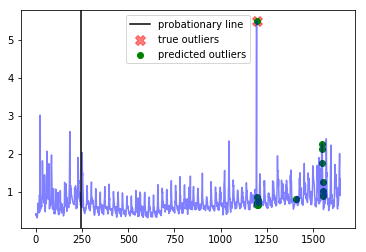




--- all_data_gift_certificates ---
Corresponding window precision:  0.125
Corresponding window recall:  1.0
Corresponding window false positives:  21
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1343, 1385, 1409, 1438, 1462, 1483, 1487, 1505, 1531, 1770, 1820, 1822, 1918, 2009, 2059, 2157, 2176, 2233, 2304, 2320, 2321, 2471, 2514, 2871, 2894, 2899, 2974, 3024, 3042, 3260, 3281, 3311, 3389, 3664, 3785, 3810, 3841, 3855, 4149, 4286, 4287, 4317, 4367, 4516, 4823, 4865, 4946, 4961, 4963, 4964, 4965, 4966, 4986, 4987, 4988, 4992, 4993, 5010, 5662, 6014, 6137, 6138, 6164, 6167, 6375, 6406, 6471, 6505, 6506, 6507, 6508, 6517, 6522, 6529, 6650, 6651, 6652, 6669, 7100, 7396, 7505, 7677, 7696, 7720, 7746, 7818, 7838, 7864, 7871, 7963, 7985, 7989, 7992, 8009, 8011, 8015, 8017, 8018, 8081, 8134, 8154, 8157, 8160, 8162, 8175, 8177, 8203, 8252, 8273, 8303, 8321, 8323, 8324, 8328, 8343, 8345, 8370, 8393, 8418, 8419, 8445, 8490, 8491, 8511, 85

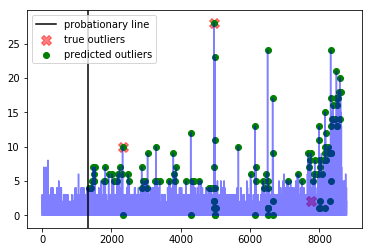




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.5
Corresponding window recall:  1.0
Corresponding window false positives:  2
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [4102, 4104, 4105, 4106, 4107, 4109, 4110, 4121, 4122, 4123, 4124, 4125, 4126, 4127, 4128, 4129, 4131, 5440, 5441, 5442, 5443, 5444, 5446, 5449, 5457, 5458, 5461, 5462, 5463, 5464, 5465, 5466, 5467, 5468, 5469, 5470, 5471, 5473, 5474, 5475, 5476, 5477, 5478, 5479, 5480, 5774, 5780, 5783, 5784, 5785, 5801, 5802, 5803, 5804, 6788, 6791, 6798, 6801]


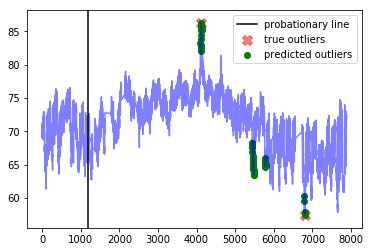




--- exchange-2_cpm_results ---
Corresponding window precision:  0.14285714285714285
Corresponding window recall:  1.0
Corresponding window false positives:  12
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [325, 355, 360, 365, 420, 492, 601, 664, 665, 689, 802, 876, 899, 923, 951, 975, 976, 977, 978, 1001, 1002, 1016, 1045, 1103, 1104, 1189, 1325, 1520, 1521, 1522, 1627]


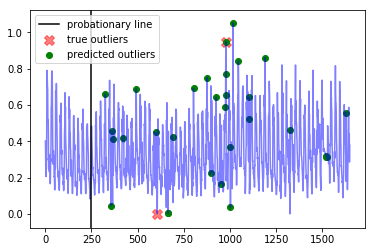




--- exchange-3_cpc_results ---
Corresponding window precision:  0.6
Corresponding window recall:  1.0
Corresponding window false positives:  2
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [322, 323, 466, 467, 1018, 1041, 1044, 1193, 1194, 1531]


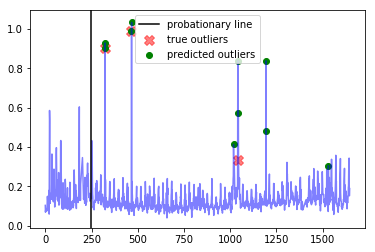




--- international-airline-passengers ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  1.0
Corresponding window false positives:  2
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [100, 101, 126, 138, 140, 142]


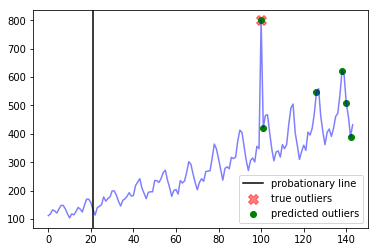




--- exchange-2_cpc_results ---
Corresponding window precision:  0.25
Corresponding window recall:  1.0
Corresponding window false positives:  3
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [325, 1046, 1134, 1135, 1136, 1142, 1256, 1484, 1485, 1486, 1487, 1492, 1493, 1494, 1495, 1520]


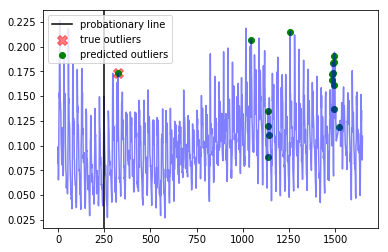

---------weight_fp=0.2, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  8.0
Best window threshold:  1.0
Corresponding window overall precision:  0.5454545454545454
Corresponding window overall recall:  0.46153846153846156
Corresponding window overall F score:  0.4999999999999999



--- exchange-3_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


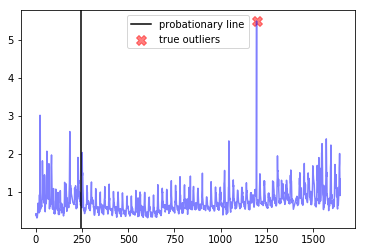




--- all_data_gift_certificates ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  4
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [2320, 4286, 4963, 4986, 4987, 6137, 6505, 6650]


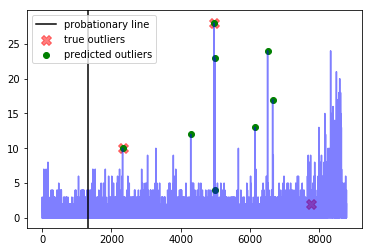




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


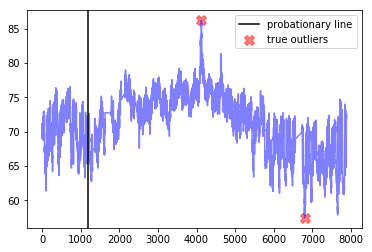




--- exchange-2_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


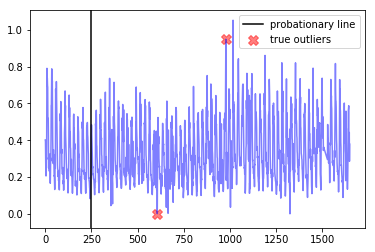




--- exchange-3_cpc_results ---
Corresponding window precision:  0.75
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [322, 466, 467, 1041, 1194]


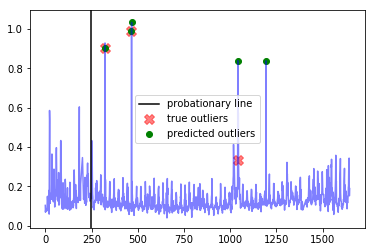




--- international-airline-passengers ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [100, 101]


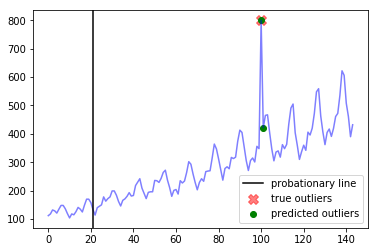




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


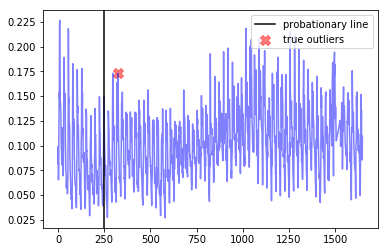

---------weight_fp=0.3, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  8.5
Best window threshold:  1.0
Corresponding window overall precision:  0.5454545454545454
Corresponding window overall recall:  0.46153846153846156
Corresponding window overall F score:  0.4999999999999999



--- exchange-3_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


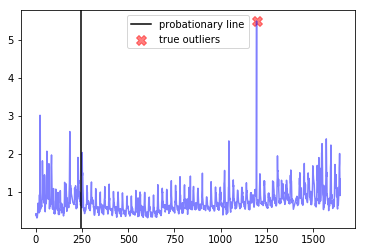




--- all_data_gift_certificates ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  4
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [2320, 4286, 4963, 4986, 4987, 6137, 6505, 6650]


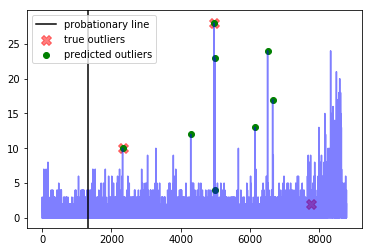




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


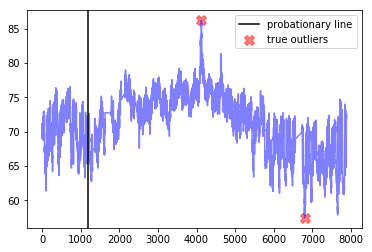




--- exchange-2_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


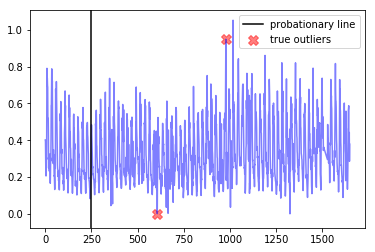




--- exchange-3_cpc_results ---
Corresponding window precision:  0.75
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [322, 466, 467, 1041, 1194]


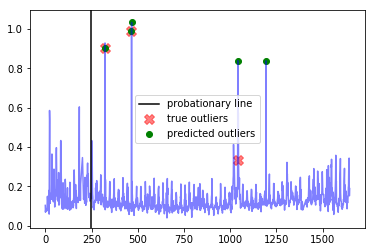




--- international-airline-passengers ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [100, 101]


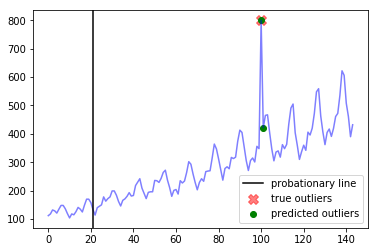




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


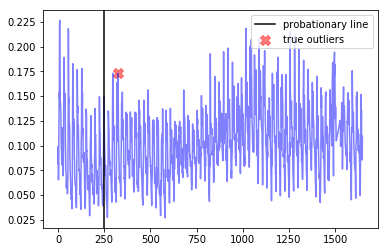

---------weight_fp=0.4, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  9.0
Best window threshold:  1.0
Corresponding window overall precision:  0.5454545454545454
Corresponding window overall recall:  0.46153846153846156
Corresponding window overall F score:  0.4999999999999999



--- exchange-3_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


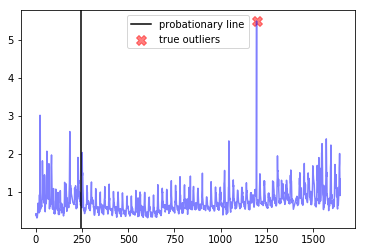




--- all_data_gift_certificates ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  4
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [2320, 4286, 4963, 4986, 4987, 6137, 6505, 6650]


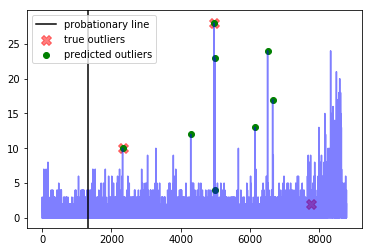




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


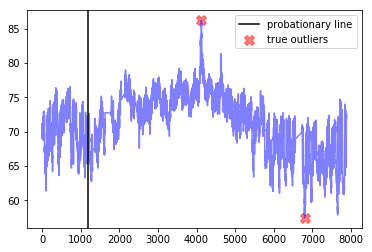




--- exchange-2_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


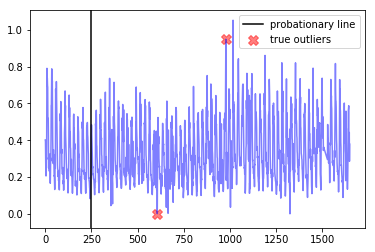




--- exchange-3_cpc_results ---
Corresponding window precision:  0.75
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [322, 466, 467, 1041, 1194]


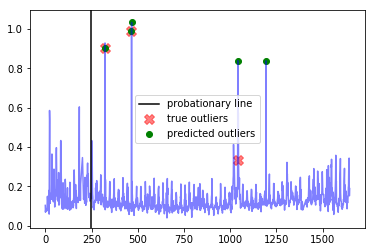




--- international-airline-passengers ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [100, 101]


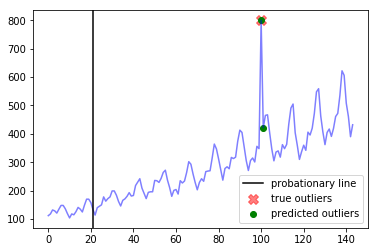




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


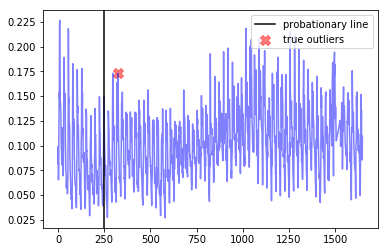

---------weight_fp=0.5, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  9.5
Best window threshold:  1.0
Corresponding window overall precision:  0.5454545454545454
Corresponding window overall recall:  0.46153846153846156
Corresponding window overall F score:  0.4999999999999999



--- exchange-3_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


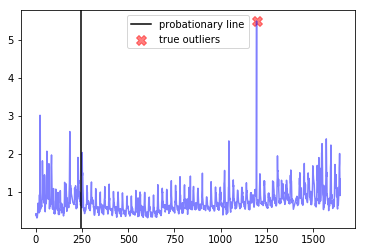




--- all_data_gift_certificates ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  4
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [2320, 4286, 4963, 4986, 4987, 6137, 6505, 6650]


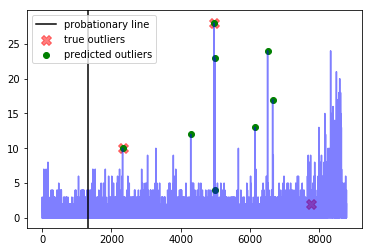




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


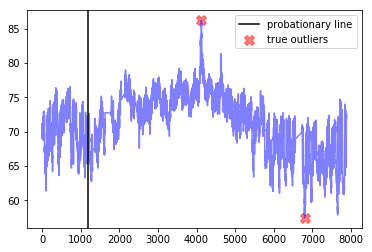




--- exchange-2_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


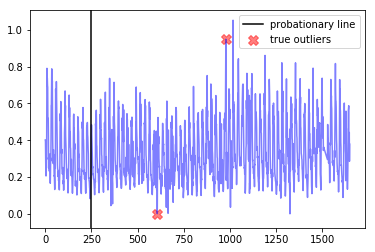




--- exchange-3_cpc_results ---
Corresponding window precision:  0.75
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [322, 466, 467, 1041, 1194]


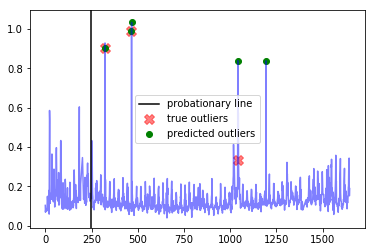




--- international-airline-passengers ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [100, 101]


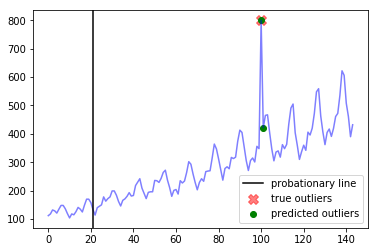




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


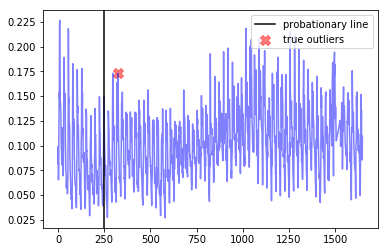

---------weight_fp=0.6, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  10.0
Best window threshold:  1.0
Corresponding window overall precision:  0.5454545454545454
Corresponding window overall recall:  0.46153846153846156
Corresponding window overall F score:  0.4999999999999999



--- exchange-3_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


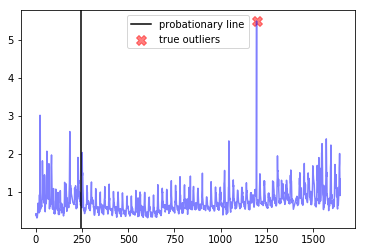




--- all_data_gift_certificates ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  4
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [2320, 4286, 4963, 4986, 4987, 6137, 6505, 6650]


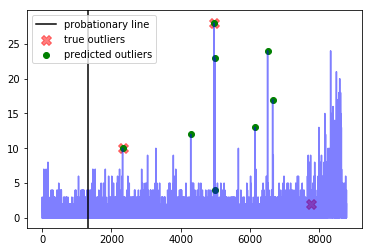




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


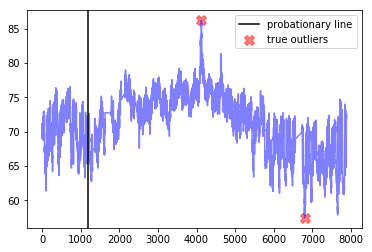




--- exchange-2_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


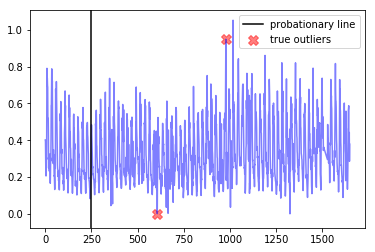




--- exchange-3_cpc_results ---
Corresponding window precision:  0.75
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [322, 466, 467, 1041, 1194]


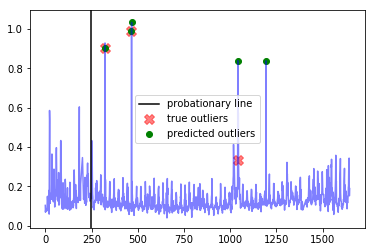




--- international-airline-passengers ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [100, 101]


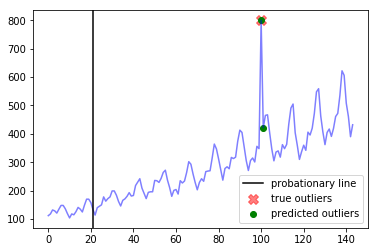




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


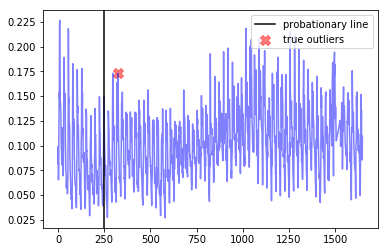

---------weight_fp=0.7, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  10.5
Best window threshold:  1.0
Corresponding window overall precision:  0.5454545454545454
Corresponding window overall recall:  0.46153846153846156
Corresponding window overall F score:  0.4999999999999999



--- exchange-3_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


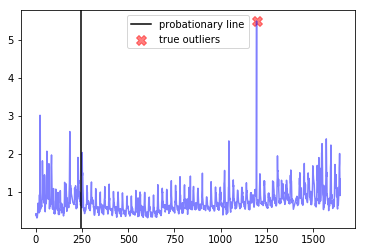




--- all_data_gift_certificates ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  4
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [2320, 4286, 4963, 4986, 4987, 6137, 6505, 6650]


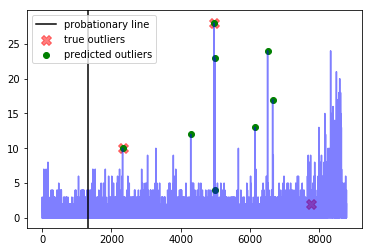




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


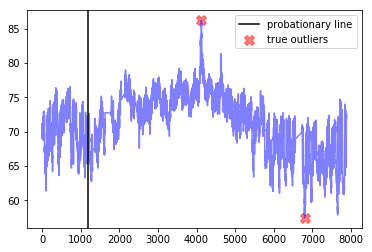




--- exchange-2_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


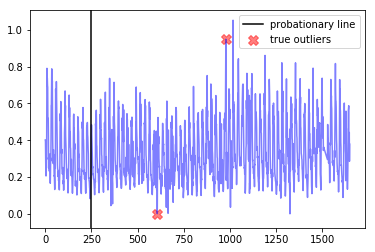




--- exchange-3_cpc_results ---
Corresponding window precision:  0.75
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [322, 466, 467, 1041, 1194]


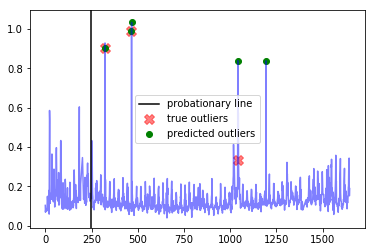




--- international-airline-passengers ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [100, 101]


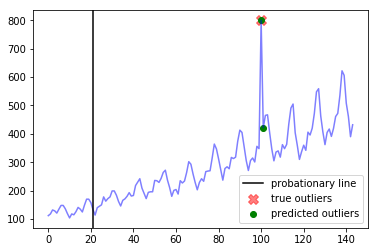




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


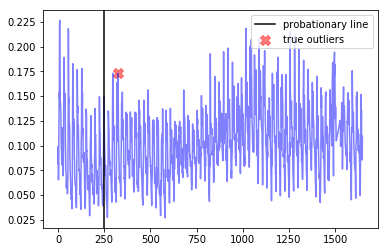

---------weight_fp=0.8, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  11.0
Best window threshold:  1.0
Corresponding window overall precision:  0.5454545454545454
Corresponding window overall recall:  0.46153846153846156
Corresponding window overall F score:  0.4999999999999999



--- exchange-3_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


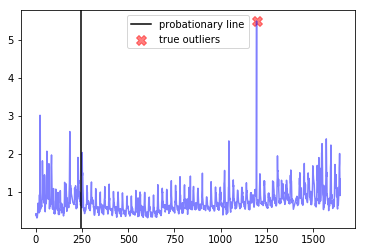




--- all_data_gift_certificates ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  4
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [2320, 4286, 4963, 4986, 4987, 6137, 6505, 6650]


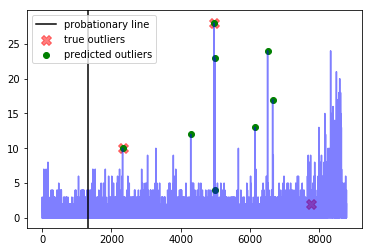




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


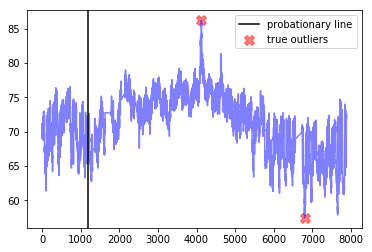




--- exchange-2_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


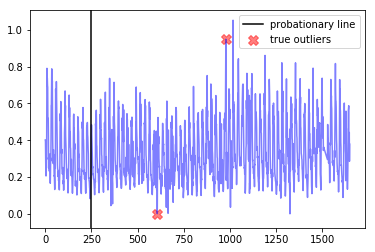




--- exchange-3_cpc_results ---
Corresponding window precision:  0.75
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [322, 466, 467, 1041, 1194]


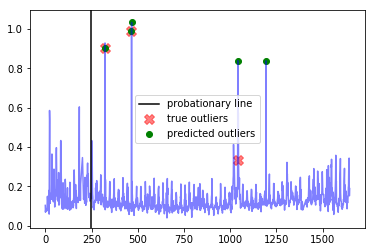




--- international-airline-passengers ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [100, 101]


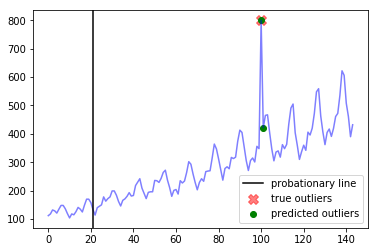




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


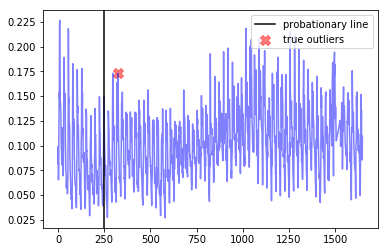

---------weight_fp=0.9, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  11.5
Best window threshold:  1.0
Corresponding window overall precision:  0.5454545454545454
Corresponding window overall recall:  0.46153846153846156
Corresponding window overall F score:  0.4999999999999999



--- exchange-3_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


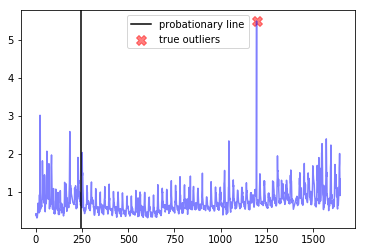




--- all_data_gift_certificates ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  4
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [2320, 4286, 4963, 4986, 4987, 6137, 6505, 6650]


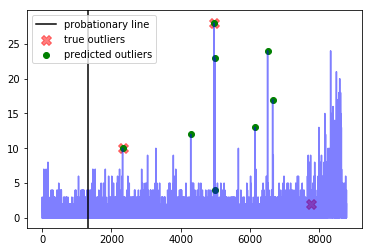




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


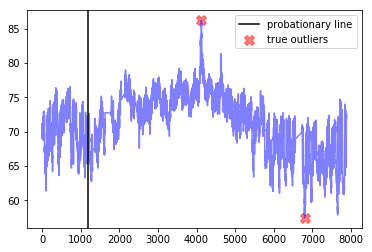




--- exchange-2_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


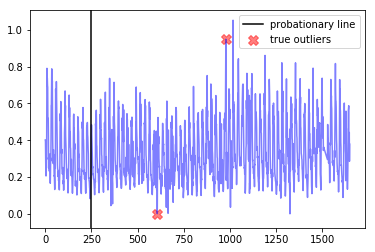




--- exchange-3_cpc_results ---
Corresponding window precision:  0.75
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [322, 466, 467, 1041, 1194]


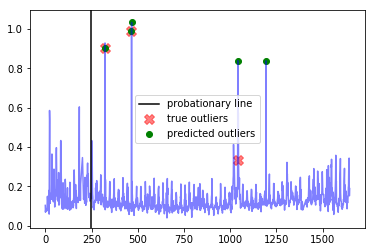




--- international-airline-passengers ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [100, 101]


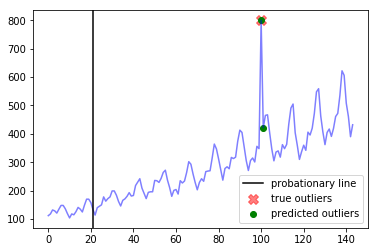




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


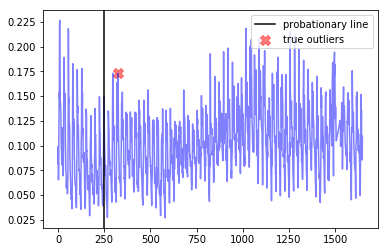

---------weight_fp=1.0, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  12.0
Best window threshold:  1.0
Corresponding window overall precision:  0.5454545454545454
Corresponding window overall recall:  0.46153846153846156
Corresponding window overall F score:  0.4999999999999999



--- exchange-3_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


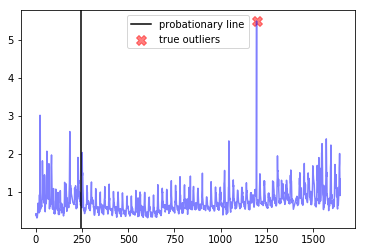




--- all_data_gift_certificates ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  4
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [2320, 4286, 4963, 4986, 4987, 6137, 6505, 6650]


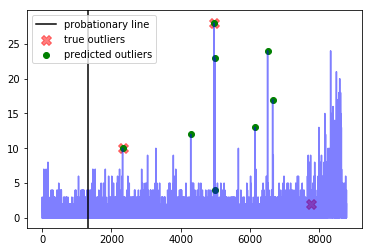




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


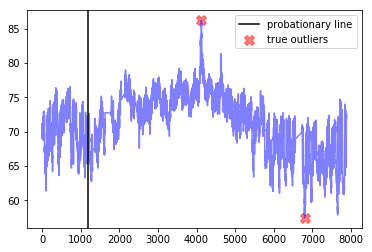




--- exchange-2_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


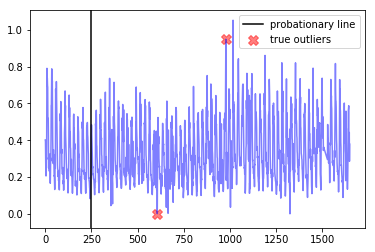




--- exchange-3_cpc_results ---
Corresponding window precision:  0.75
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [322, 466, 467, 1041, 1194]


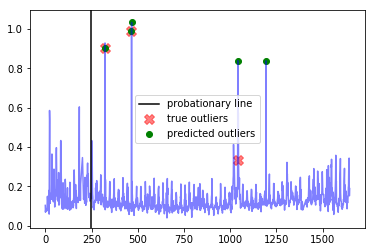




--- international-airline-passengers ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [100, 101]


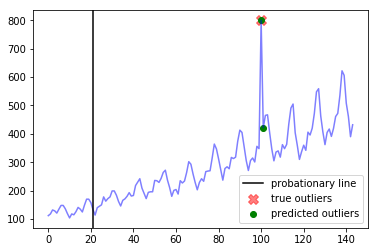




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


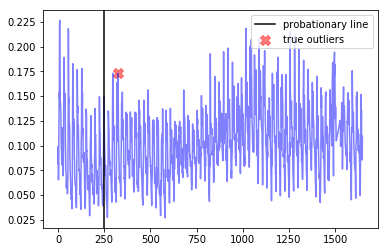

------------
False Positive Weight:  0.1
	 Minimum number of mistakes : 4.4
	 Corresponding window overall recall : 1.0
	 Corresponding window overall precision : 0.22413793103448276
	 Corresponding window overall F score : 0.36619718309859156
	 Best window threshold : 0.9996
False Positive Weight:  0.2
	 Minimum number of mistakes : 8.0
	 Corresponding window overall recall : 0.46153846153846156
	 Corresponding window overall precision : 0.5454545454545454
	 Corresponding window overall F score : 0.4999999999999999
	 Best window threshold : 1.0
False Positive Weight:  0.3
	 Minimum number of mistakes : 8.5
	 Corresponding window overall recall : 0.46153846153846156
	 Corresponding window overall precision : 0.5454545454545454
	 Corresponding window overall F score : 0.4999999999999999
	 Best window threshold : 1.0
False Positive Weight:  0.6
	 Minimum number of mistakes : 10.0
	 Corresponding window overall recall : 0.46153846153846156
	 Corresponding window overall precision : 0.5454

In [17]:
end_results = {}
for weight_fp in weight_fp_list:  
    print("---------weight_fp=" + str(weight_fp) + ", weight_fn=1----------")
    weight_result = adclasses.pretty_print_results(sarima_ad_dict, anomaly_scores_dict, sarima_true_outlier_indices_dict, weight_fp=weight_fp, weight_fn=1)
    end_results[weight_fp] = weight_result

print("------------")
adclasses.pretty_print_end_results(end_results)

# Facebook Prophet Results

In [18]:
anomaly_scores_dict = {}

for dataset_name in dataset_name_list:
    output_dict_prophet = joblib.load("anomaly_scores/Prophet/" + dataset_name)
    anomaly_scores_dict[dataset_name] = output_dict_prophet["Anomaly Scores"]

In [19]:
adclasses.precision_recall_curve_info(anomaly_scores_dict, true_outlier_indices_dict)

{0.1: {'precision': 0.11538461538461539, 'recall': 1.0},
 0.2: {'precision': 0.11538461538461539, 'recall': 1.0},
 0.3: {'precision': 0.11538461538461539, 'recall': 1.0},
 0.4: {'precision': 0.11538461538461539, 'recall': 1.0},
 0.5: {'precision': 0.11538461538461539, 'recall': 1.0},
 0.6: {'precision': 0.11538461538461539, 'recall': 1.0},
 0.7: {'precision': 0.11538461538461539, 'recall': 1.0},
 0.8: {'precision': 0.125, 'recall': 1.0},
 0.9: {'precision': 0.15, 'recall': 1.0},
 1.0: {'precision': 0.75, 'recall': 1.0}}

---------weight_fp=0.1, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  9.4
Best window threshold:  0.9996
Corresponding window overall precision:  0.23684210526315788
Corresponding window overall recall:  0.782608695652174
Corresponding window overall F score:  0.3636363636363636



--- elb_request_count_8c0756 ---
Corresponding window precision:  0.16666666666666666
Corresponding window recall:  1.0
Corresponding window false positives:  10
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [741, 783, 786, 790, 791, 926, 1403, 1586, 1763, 1978, 1979, 2556, 2595, 3069, 3087, 3327, 3378, 3427, 3455, 3465, 3499, 3529, 3658, 3677, 3690, 3691, 3693, 3707, 3719, 3767, 3918, 3957, 4026]


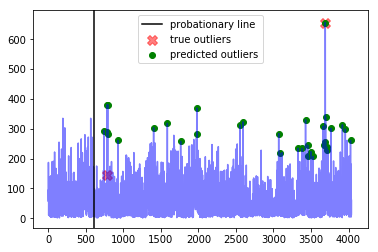




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  [950]


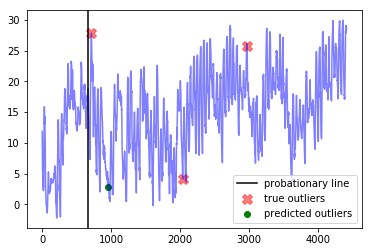




--- exchange-3_cpm_results ---
Corresponding window precision:  0.25
Corresponding window recall:  1.0
Corresponding window false positives:  3
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [836, 1044, 1193, 1194, 1307, 1531, 1546, 1548, 1571, 1596]


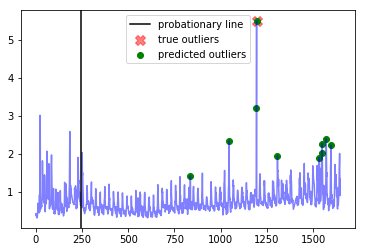




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  1.0
Corresponding window false positives:  4
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1859, 1860, 1861, 1862, 1863, 1864, 1865, 1866, 1867, 1868, 1869, 1870, 1871, 1887, 1888, 1890, 2518, 3600, 3603, 3604, 3605, 3606, 4101, 4102, 4103, 4104, 4105, 4106, 4107, 4108, 4109, 4110, 4111, 4112, 4113, 4114, 4115, 4117, 4118, 4119, 4120, 4121, 4122, 4123, 4124, 4125, 4126, 4127, 4128, 4129, 4130, 4131, 4132, 4133, 4134, 4135, 4136, 4137, 5910, 5911, 5912, 5913, 6816]


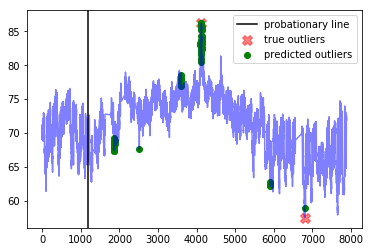




--- all_data_gift_certificates ---
Corresponding window precision:  0.13043478260869565
Corresponding window recall:  1.0
Corresponding window false positives:  20
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1438, 1462, 1483, 1487, 1505, 1531, 1634, 1702, 1820, 1822, 1918, 2009, 2059, 2157, 2176, 2233, 2304, 2320, 2471, 2871, 2894, 2899, 2905, 2974, 3014, 3016, 3042, 3053, 3260, 3281, 3311, 3389, 3664, 3688, 3785, 3805, 3810, 3841, 3855, 4286, 4317, 4367, 4516, 4946, 4961, 4963, 4986, 4992, 5662, 6014, 6137, 6164, 6167, 6375, 6471, 6505, 6517, 6522, 6650, 6669, 7396, 7677, 7680, 7696, 7720, 7746, 7838, 7864, 7985, 7987, 7989, 8009, 8015, 8017, 8059, 8060, 8134, 8157, 8162, 8175, 8177, 8208, 8252, 8253, 8273, 8301, 8302, 8322, 8323, 8324, 8325, 8326, 8327, 8345, 8346, 8347, 8351, 8370, 8371, 8372, 8375, 8378, 8393, 8394, 8395, 8418, 8419, 8443, 8445, 8446, 8469, 8470, 8490, 8491, 8511, 8512, 8515, 8521, 8538, 8562, 8563, 8564, 

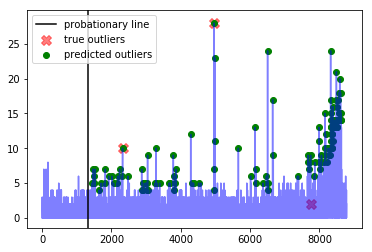




--- nyc_taxi ---
Corresponding window precision:  1.0
Corresponding window recall:  0.8
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [5954, 5955, 8512, 8513, 8514, 8515, 8535, 8536, 8537, 8538, 8833, 8834, 8835, 8836, 8837, 8838, 8839, 8840, 10069, 10070, 10071, 10072, 10073, 10074, 10075, 10076, 10077, 10078, 10079, 10080, 10097, 10098, 10099]


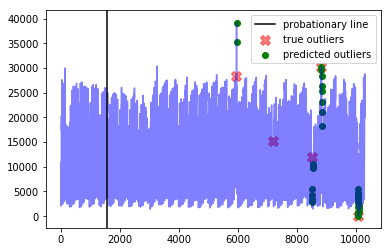




--- exchange-2_cpm_results ---
Corresponding window precision:  0.16666666666666666
Corresponding window recall:  1.0
Corresponding window false positives:  10
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [348, 355, 360, 365, 424, 601, 606, 655, 664, 665, 753, 801, 896, 899, 951, 976, 977, 978, 1002, 1016, 1045, 1103, 1104, 1118, 1189, 1280, 1522, 1523]


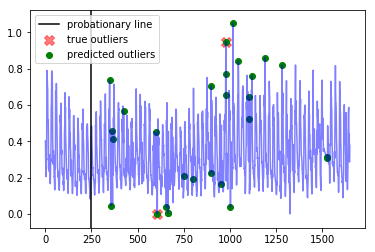




--- exchange-2_cpc_results ---
Corresponding window precision:  0.2
Corresponding window recall:  1.0
Corresponding window false positives:  4
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [325, 655, 1016, 1046, 1118, 1256, 1280, 1484, 1485, 1486, 1487, 1492, 1493, 1494]


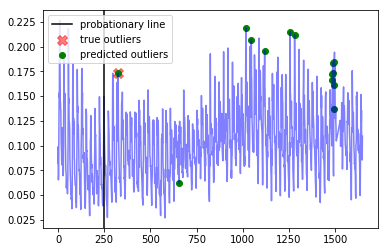




--- international-airline-passengers ---
Corresponding window precision:  0.5
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [100, 138]


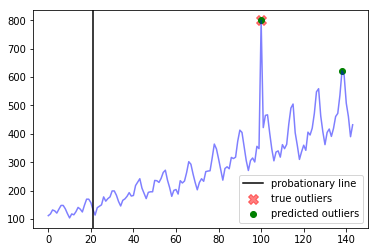




--- exchange-3_cpc_results ---
Corresponding window precision:  0.75
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [322, 323, 466, 467, 1041, 1044, 1193, 1194]


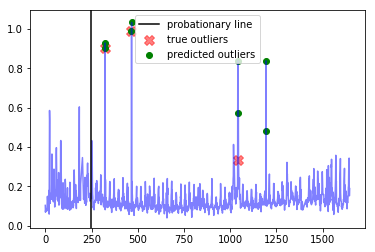

---------weight_fp=0.2, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  14.8
Best window threshold:  0.9996
Corresponding window overall precision:  0.23684210526315788
Corresponding window overall recall:  0.782608695652174
Corresponding window overall F score:  0.3636363636363636



--- elb_request_count_8c0756 ---
Corresponding window precision:  0.16666666666666666
Corresponding window recall:  1.0
Corresponding window false positives:  10
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [741, 783, 786, 790, 791, 926, 1403, 1586, 1763, 1978, 1979, 2556, 2595, 3069, 3087, 3327, 3378, 3427, 3455, 3465, 3499, 3529, 3658, 3677, 3690, 3691, 3693, 3707, 3719, 3767, 3918, 3957, 4026]


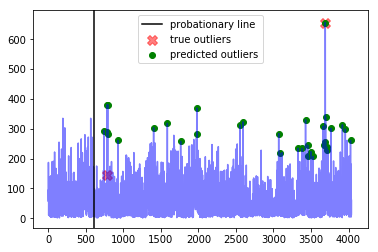




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  [950]


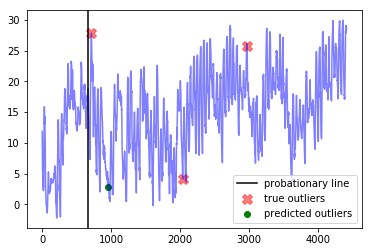




--- exchange-3_cpm_results ---
Corresponding window precision:  0.25
Corresponding window recall:  1.0
Corresponding window false positives:  3
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [836, 1044, 1193, 1194, 1307, 1531, 1546, 1548, 1571, 1596]


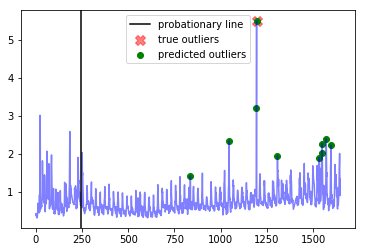




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  1.0
Corresponding window false positives:  4
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1859, 1860, 1861, 1862, 1863, 1864, 1865, 1866, 1867, 1868, 1869, 1870, 1871, 1887, 1888, 1890, 2518, 3600, 3603, 3604, 3605, 3606, 4101, 4102, 4103, 4104, 4105, 4106, 4107, 4108, 4109, 4110, 4111, 4112, 4113, 4114, 4115, 4117, 4118, 4119, 4120, 4121, 4122, 4123, 4124, 4125, 4126, 4127, 4128, 4129, 4130, 4131, 4132, 4133, 4134, 4135, 4136, 4137, 5910, 5911, 5912, 5913, 6816]


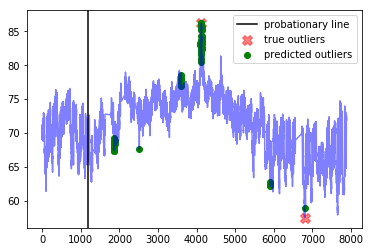




--- all_data_gift_certificates ---
Corresponding window precision:  0.13043478260869565
Corresponding window recall:  1.0
Corresponding window false positives:  20
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1438, 1462, 1483, 1487, 1505, 1531, 1634, 1702, 1820, 1822, 1918, 2009, 2059, 2157, 2176, 2233, 2304, 2320, 2471, 2871, 2894, 2899, 2905, 2974, 3014, 3016, 3042, 3053, 3260, 3281, 3311, 3389, 3664, 3688, 3785, 3805, 3810, 3841, 3855, 4286, 4317, 4367, 4516, 4946, 4961, 4963, 4986, 4992, 5662, 6014, 6137, 6164, 6167, 6375, 6471, 6505, 6517, 6522, 6650, 6669, 7396, 7677, 7680, 7696, 7720, 7746, 7838, 7864, 7985, 7987, 7989, 8009, 8015, 8017, 8059, 8060, 8134, 8157, 8162, 8175, 8177, 8208, 8252, 8253, 8273, 8301, 8302, 8322, 8323, 8324, 8325, 8326, 8327, 8345, 8346, 8347, 8351, 8370, 8371, 8372, 8375, 8378, 8393, 8394, 8395, 8418, 8419, 8443, 8445, 8446, 8469, 8470, 8490, 8491, 8511, 8512, 8515, 8521, 8538, 8562, 8563, 8564, 

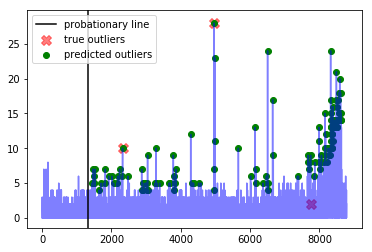




--- nyc_taxi ---
Corresponding window precision:  1.0
Corresponding window recall:  0.8
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [5954, 5955, 8512, 8513, 8514, 8515, 8535, 8536, 8537, 8538, 8833, 8834, 8835, 8836, 8837, 8838, 8839, 8840, 10069, 10070, 10071, 10072, 10073, 10074, 10075, 10076, 10077, 10078, 10079, 10080, 10097, 10098, 10099]


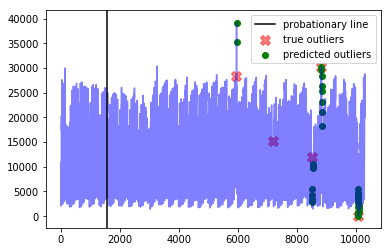




--- exchange-2_cpm_results ---
Corresponding window precision:  0.16666666666666666
Corresponding window recall:  1.0
Corresponding window false positives:  10
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [348, 355, 360, 365, 424, 601, 606, 655, 664, 665, 753, 801, 896, 899, 951, 976, 977, 978, 1002, 1016, 1045, 1103, 1104, 1118, 1189, 1280, 1522, 1523]


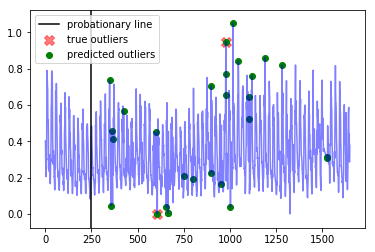




--- exchange-2_cpc_results ---
Corresponding window precision:  0.2
Corresponding window recall:  1.0
Corresponding window false positives:  4
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [325, 655, 1016, 1046, 1118, 1256, 1280, 1484, 1485, 1486, 1487, 1492, 1493, 1494]


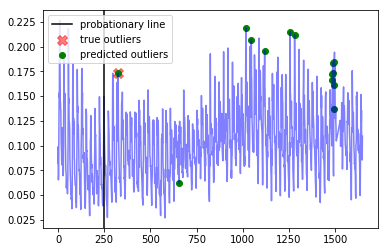




--- international-airline-passengers ---
Corresponding window precision:  0.5
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [100, 138]


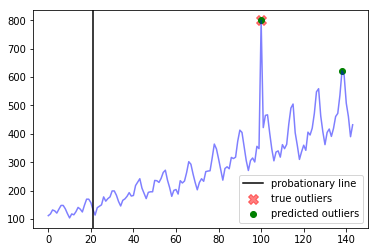




--- exchange-3_cpc_results ---
Corresponding window precision:  0.75
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [322, 323, 466, 467, 1041, 1044, 1193, 1194]


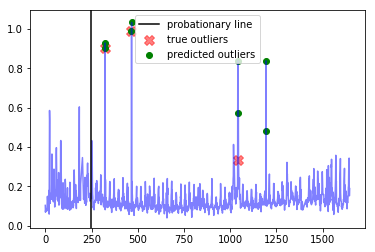

---------weight_fp=0.3, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  16.1
Best window threshold:  1.0
Corresponding window overall precision:  0.5294117647058824
Corresponding window overall recall:  0.391304347826087
Corresponding window overall F score:  0.45



--- elb_request_count_8c0756 ---
Corresponding window precision:  1.0
Corresponding window recall:  0.5
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [3690]


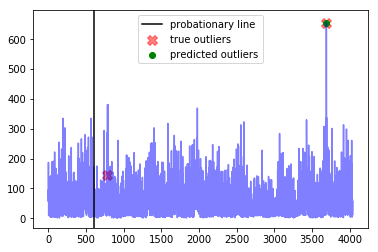




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


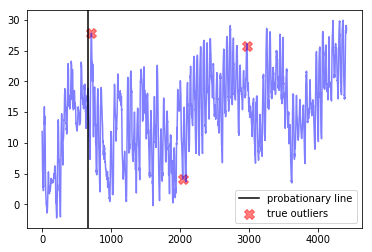




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1193, 1194]


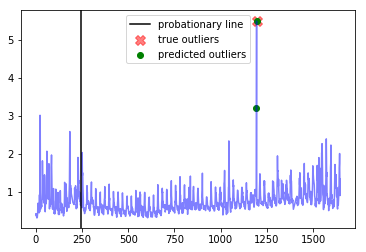




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


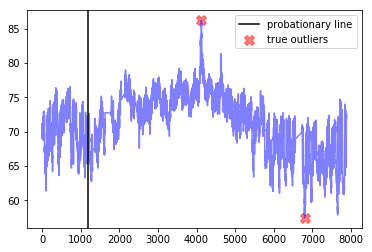




--- all_data_gift_certificates ---
Corresponding window precision:  0.25
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  6
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [2320, 4286, 4963, 4986, 4992, 6137, 6505, 6650, 8157, 8323, 8324]


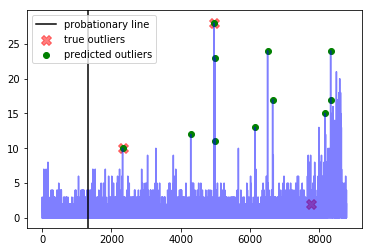




--- nyc_taxi ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  5


Outlier indices as determined by best window threshold:  []


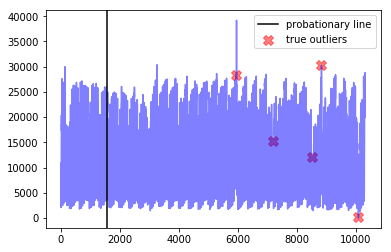




--- exchange-2_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  0.5
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [977]


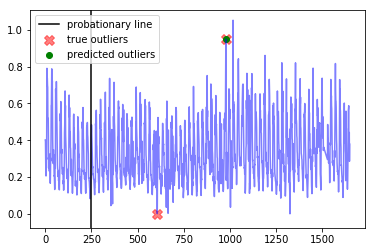




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


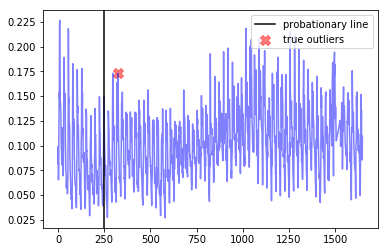




--- international-airline-passengers ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [100]


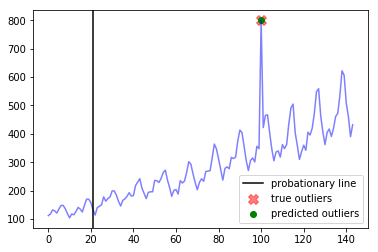




--- exchange-3_cpc_results ---
Corresponding window precision:  0.75
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [322, 323, 466, 467, 1041, 1194]


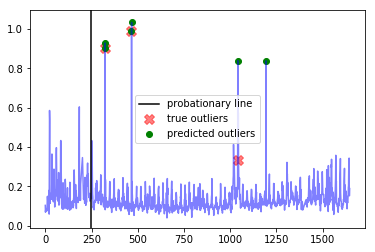

---------weight_fp=0.4, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  16.799999999999997
Best window threshold:  1.0
Corresponding window overall precision:  0.5294117647058824
Corresponding window overall recall:  0.391304347826087
Corresponding window overall F score:  0.45



--- elb_request_count_8c0756 ---
Corresponding window precision:  1.0
Corresponding window recall:  0.5
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [3690]


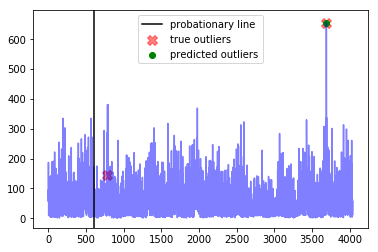




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


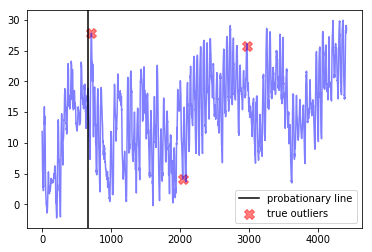




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1193, 1194]


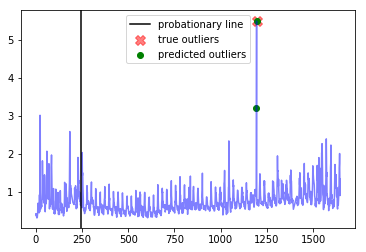




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


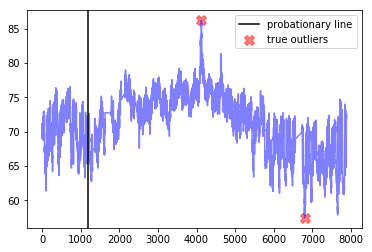




--- all_data_gift_certificates ---
Corresponding window precision:  0.25
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  6
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [2320, 4286, 4963, 4986, 4992, 6137, 6505, 6650, 8157, 8323, 8324]


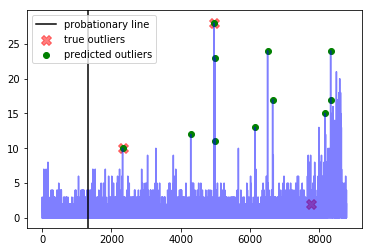




--- nyc_taxi ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  5


Outlier indices as determined by best window threshold:  []


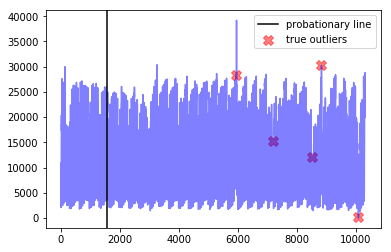




--- exchange-2_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  0.5
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [977]


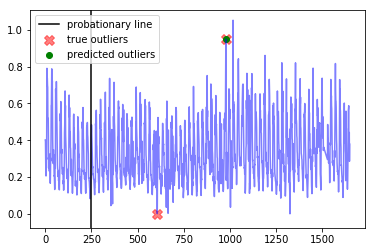




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


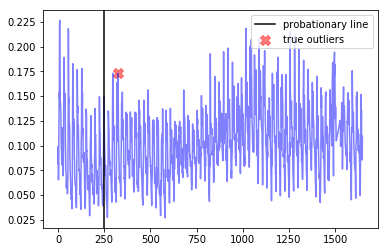




--- international-airline-passengers ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [100]


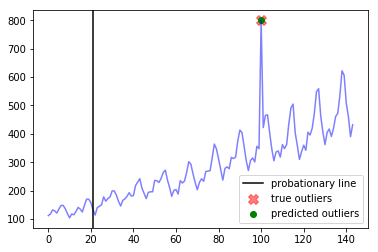




--- exchange-3_cpc_results ---
Corresponding window precision:  0.75
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [322, 323, 466, 467, 1041, 1194]


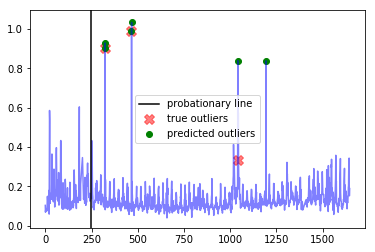

---------weight_fp=0.5, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  17.5
Best window threshold:  1.0
Corresponding window overall precision:  0.5294117647058824
Corresponding window overall recall:  0.391304347826087
Corresponding window overall F score:  0.45



--- elb_request_count_8c0756 ---
Corresponding window precision:  1.0
Corresponding window recall:  0.5
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [3690]


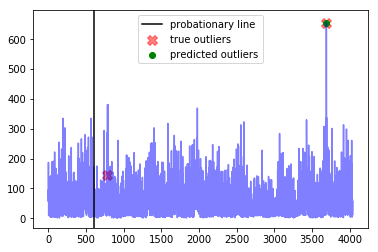




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


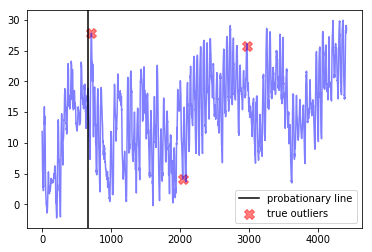




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1193, 1194]


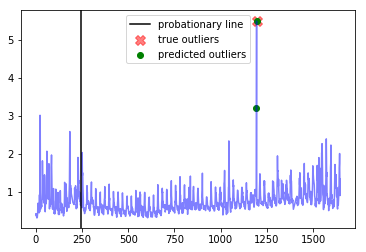




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


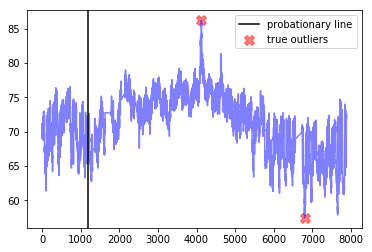




--- all_data_gift_certificates ---
Corresponding window precision:  0.25
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  6
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [2320, 4286, 4963, 4986, 4992, 6137, 6505, 6650, 8157, 8323, 8324]


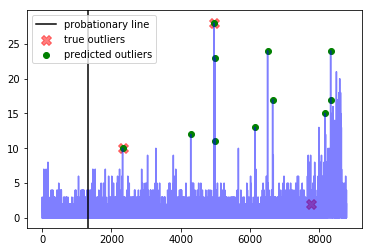




--- nyc_taxi ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  5


Outlier indices as determined by best window threshold:  []


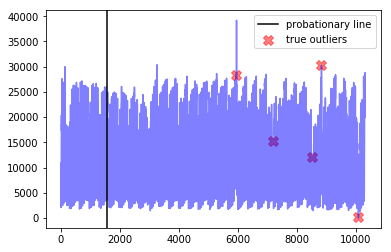




--- exchange-2_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  0.5
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [977]


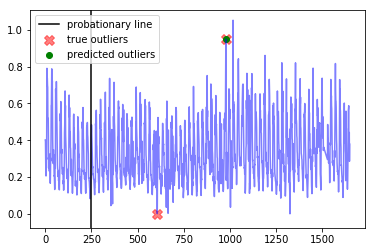




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


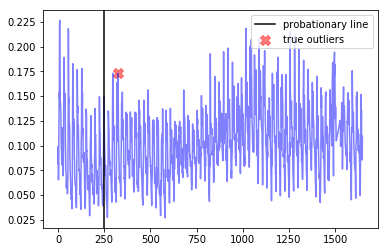




--- international-airline-passengers ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [100]


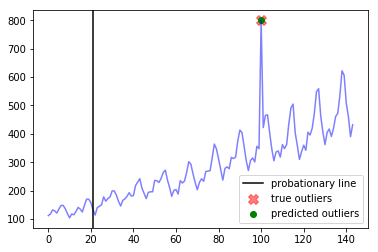




--- exchange-3_cpc_results ---
Corresponding window precision:  0.75
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [322, 323, 466, 467, 1041, 1194]


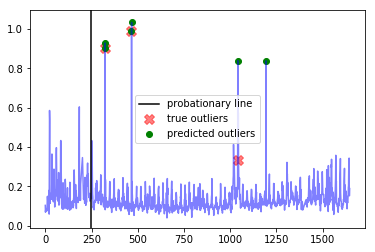

---------weight_fp=0.6, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  18.200000000000003
Best window threshold:  1.0
Corresponding window overall precision:  0.5294117647058824
Corresponding window overall recall:  0.391304347826087
Corresponding window overall F score:  0.45



--- elb_request_count_8c0756 ---
Corresponding window precision:  1.0
Corresponding window recall:  0.5
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [3690]


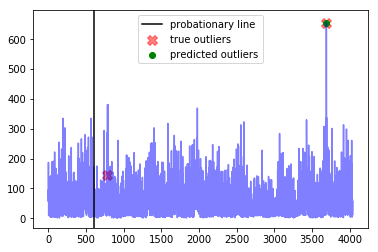




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


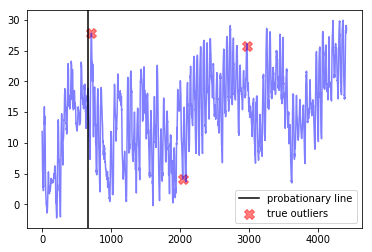




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1193, 1194]


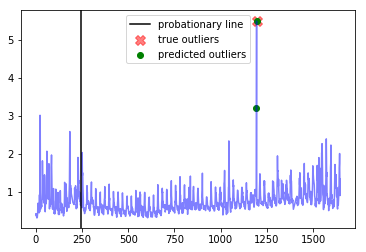




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


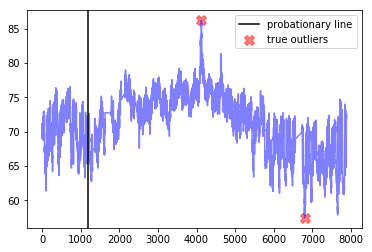




--- all_data_gift_certificates ---
Corresponding window precision:  0.25
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  6
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [2320, 4286, 4963, 4986, 4992, 6137, 6505, 6650, 8157, 8323, 8324]


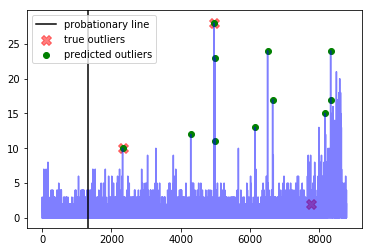




--- nyc_taxi ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  5


Outlier indices as determined by best window threshold:  []


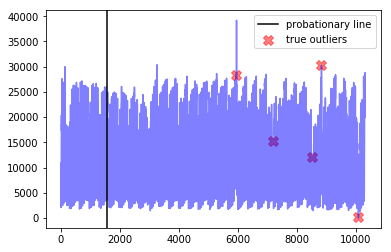




--- exchange-2_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  0.5
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [977]


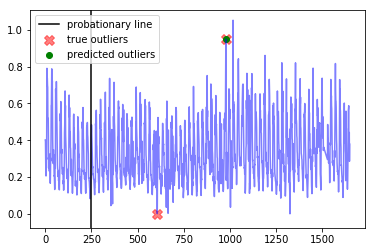




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


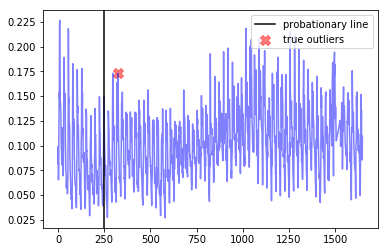




--- international-airline-passengers ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [100]


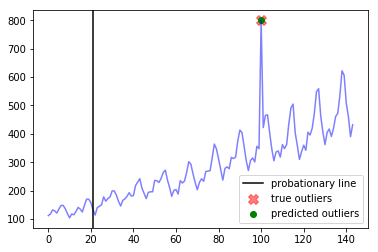




--- exchange-3_cpc_results ---
Corresponding window precision:  0.75
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [322, 323, 466, 467, 1041, 1194]


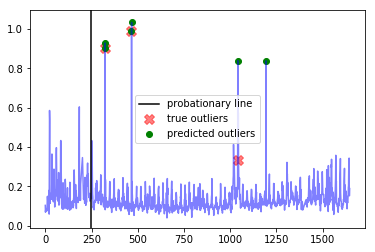

---------weight_fp=0.7, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  18.9
Best window threshold:  1.0
Corresponding window overall precision:  0.5294117647058824
Corresponding window overall recall:  0.391304347826087
Corresponding window overall F score:  0.45



--- elb_request_count_8c0756 ---
Corresponding window precision:  1.0
Corresponding window recall:  0.5
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [3690]


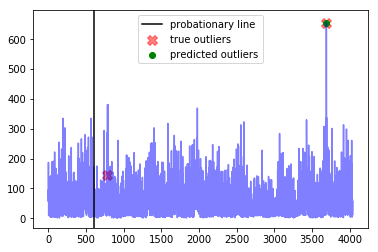




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


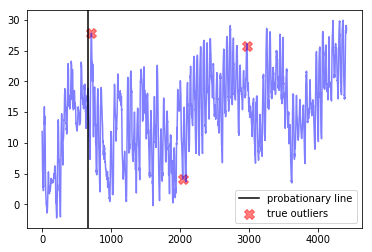




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1193, 1194]


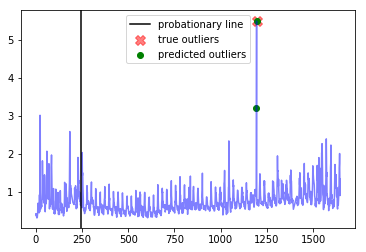




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


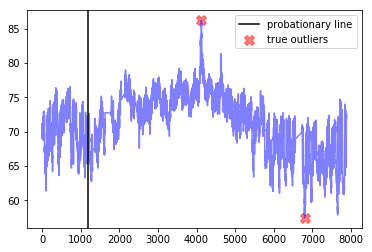




--- all_data_gift_certificates ---
Corresponding window precision:  0.25
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  6
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [2320, 4286, 4963, 4986, 4992, 6137, 6505, 6650, 8157, 8323, 8324]


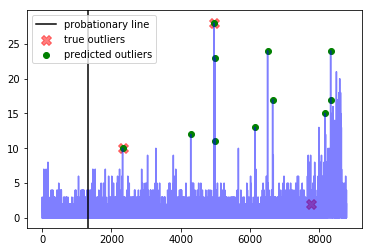




--- nyc_taxi ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  5


Outlier indices as determined by best window threshold:  []


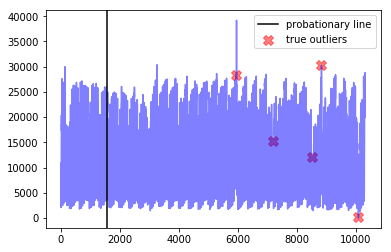




--- exchange-2_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  0.5
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [977]


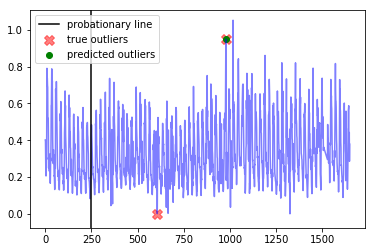




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


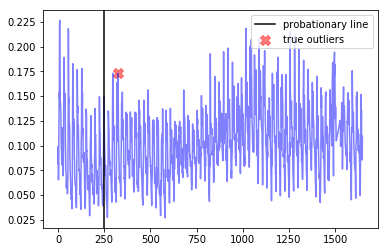




--- international-airline-passengers ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [100]


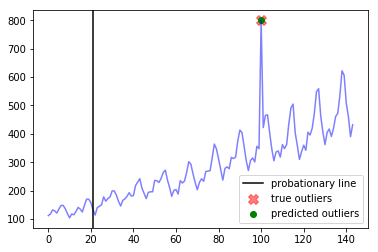




--- exchange-3_cpc_results ---
Corresponding window precision:  0.75
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [322, 323, 466, 467, 1041, 1194]


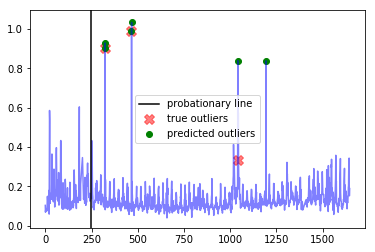

---------weight_fp=0.8, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  19.6
Best window threshold:  1.0
Corresponding window overall precision:  0.5294117647058824
Corresponding window overall recall:  0.391304347826087
Corresponding window overall F score:  0.45



--- elb_request_count_8c0756 ---
Corresponding window precision:  1.0
Corresponding window recall:  0.5
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [3690]


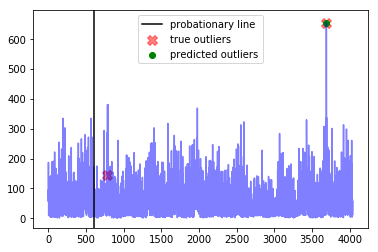




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


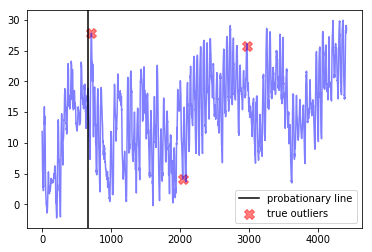




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1193, 1194]


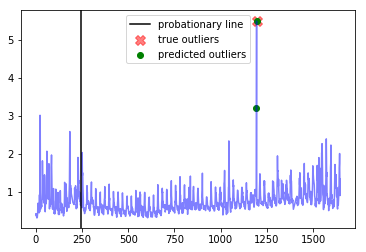




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


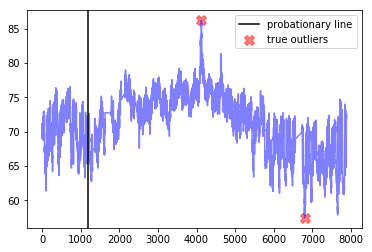




--- all_data_gift_certificates ---
Corresponding window precision:  0.25
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  6
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [2320, 4286, 4963, 4986, 4992, 6137, 6505, 6650, 8157, 8323, 8324]


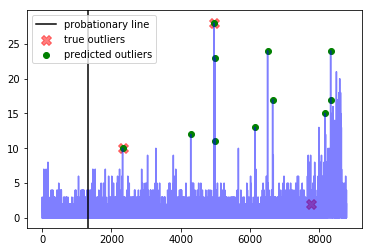




--- nyc_taxi ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  5


Outlier indices as determined by best window threshold:  []


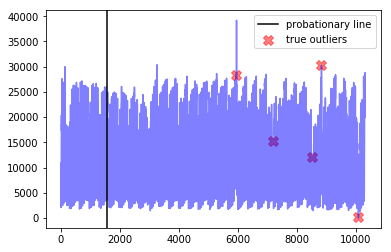




--- exchange-2_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  0.5
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [977]


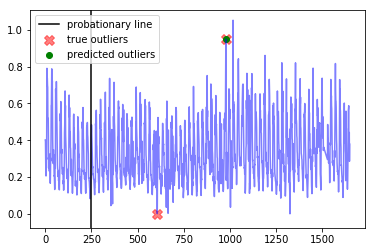




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


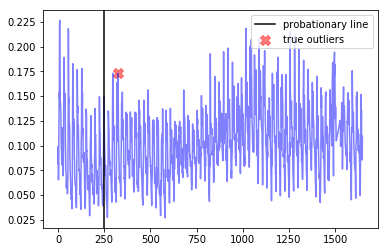




--- international-airline-passengers ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [100]


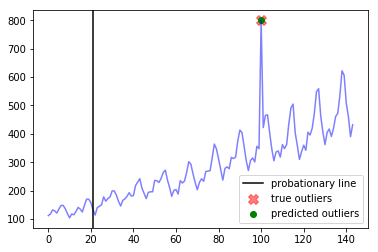




--- exchange-3_cpc_results ---
Corresponding window precision:  0.75
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [322, 323, 466, 467, 1041, 1194]


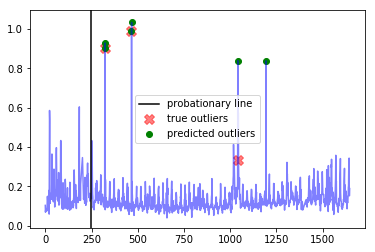

---------weight_fp=0.9, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  20.299999999999997
Best window threshold:  1.0
Corresponding window overall precision:  0.5294117647058824
Corresponding window overall recall:  0.391304347826087
Corresponding window overall F score:  0.45



--- elb_request_count_8c0756 ---
Corresponding window precision:  1.0
Corresponding window recall:  0.5
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [3690]


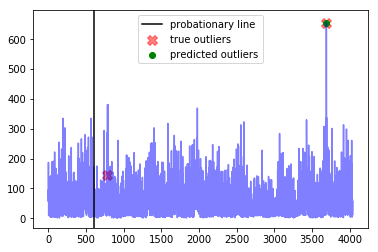




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


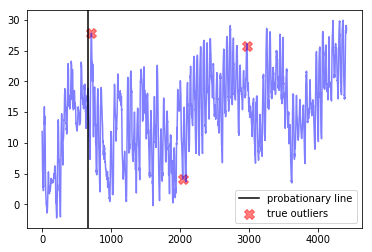




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1193, 1194]


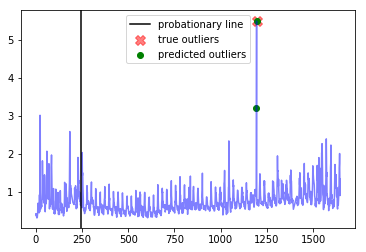




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


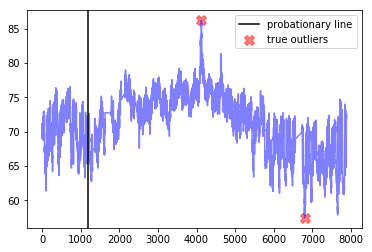




--- all_data_gift_certificates ---
Corresponding window precision:  0.25
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  6
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [2320, 4286, 4963, 4986, 4992, 6137, 6505, 6650, 8157, 8323, 8324]


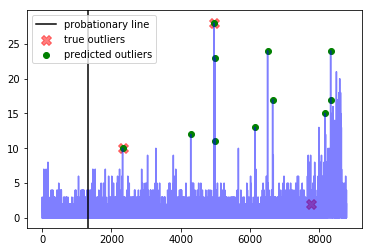




--- nyc_taxi ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  5


Outlier indices as determined by best window threshold:  []


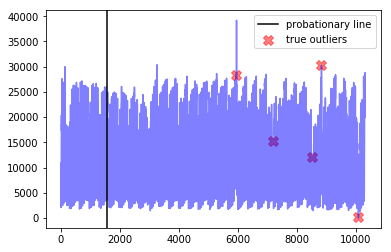




--- exchange-2_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  0.5
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [977]


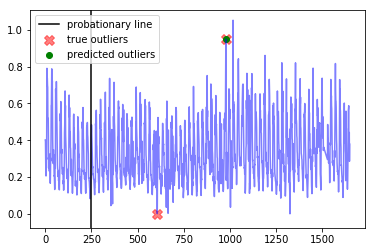




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


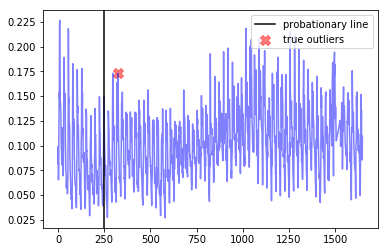




--- international-airline-passengers ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [100]


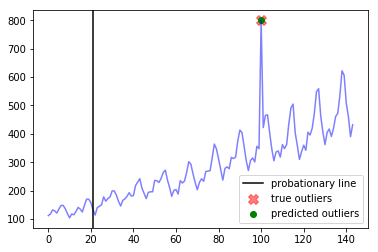




--- exchange-3_cpc_results ---
Corresponding window precision:  0.75
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [322, 323, 466, 467, 1041, 1194]


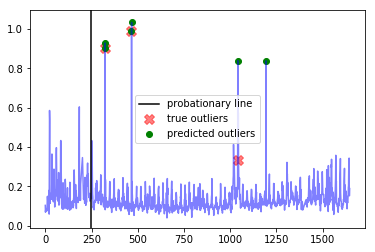

---------weight_fp=1.0, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  21.0
Best window threshold:  1.0
Corresponding window overall precision:  0.5294117647058824
Corresponding window overall recall:  0.391304347826087
Corresponding window overall F score:  0.45



--- elb_request_count_8c0756 ---
Corresponding window precision:  1.0
Corresponding window recall:  0.5
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [3690]


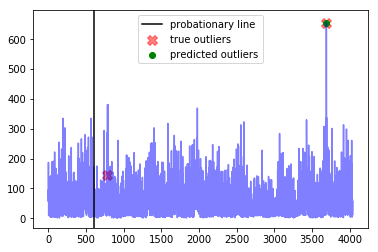




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


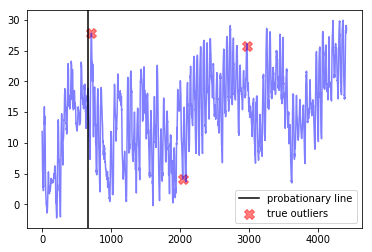




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1193, 1194]


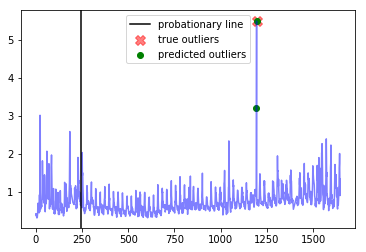




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


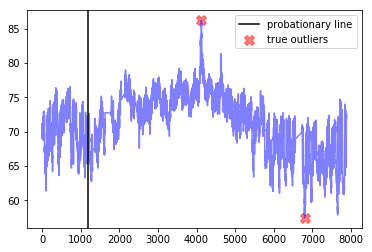




--- all_data_gift_certificates ---
Corresponding window precision:  0.25
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  6
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [2320, 4286, 4963, 4986, 4992, 6137, 6505, 6650, 8157, 8323, 8324]


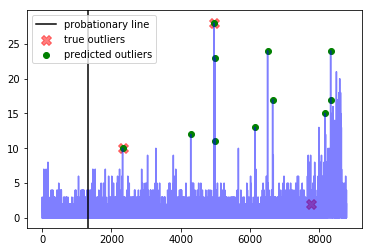




--- nyc_taxi ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  5


Outlier indices as determined by best window threshold:  []


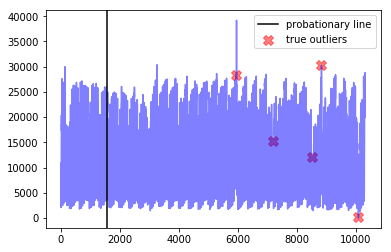




--- exchange-2_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  0.5
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [977]


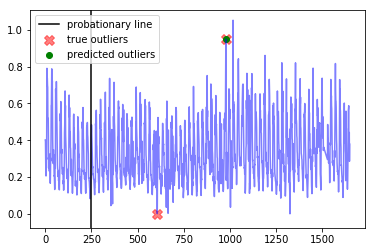




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


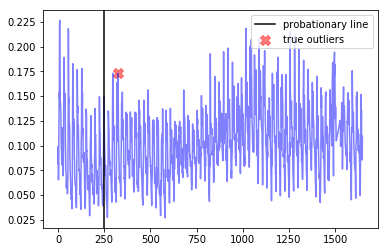




--- international-airline-passengers ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [100]


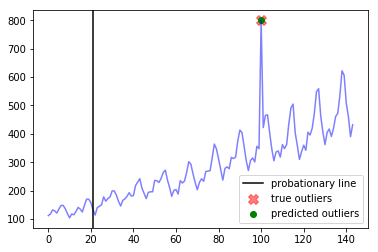




--- exchange-3_cpc_results ---
Corresponding window precision:  0.75
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [322, 323, 466, 467, 1041, 1194]


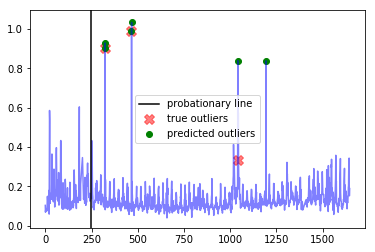

------------
False Positive Weight:  0.1
	 Minimum number of mistakes : 9.4
	 Corresponding window overall recall : 0.782608695652174
	 Corresponding window overall precision : 0.23684210526315788
	 Corresponding window overall F score : 0.3636363636363636
	 Best window threshold : 0.9996
False Positive Weight:  0.2
	 Minimum number of mistakes : 14.8
	 Corresponding window overall recall : 0.782608695652174
	 Corresponding window overall precision : 0.23684210526315788
	 Corresponding window overall F score : 0.3636363636363636
	 Best window threshold : 0.9996
False Positive Weight:  0.3
	 Minimum number of mistakes : 16.1
	 Corresponding window overall recall : 0.391304347826087
	 Corresponding window overall precision : 0.5294117647058824
	 Corresponding window overall F score : 0.45
	 Best window threshold : 1.0
False Positive Weight:  0.6
	 Minimum number of mistakes : 18.200000000000003
	 Corresponding window overall recall : 0.391304347826087
	 Corresponding window overall preci

In [20]:
end_results = {}
for weight_fp in weight_fp_list:  
    print("---------weight_fp=" + str(weight_fp) + ", weight_fn=1----------")
    weight_result = adclasses.pretty_print_results(ad_dict, anomaly_scores_dict, true_outlier_indices_dict, weight_fp=weight_fp, weight_fn=1)
    end_results[weight_fp] = weight_result

print("------------")
adclasses.pretty_print_end_results(end_results)

# RNN Results

In [14]:
anomaly_scores_dict = {}

for dataset_name in dataset_name_list:
    output_dict_rnn = joblib.load("anomaly_scores/RNN/" + dataset_name)
    anomaly_scores_dict[dataset_name] = output_dict_rnn["Anomaly Scores"]

In [15]:
adclasses.precision_recall_curve_info(anomaly_scores_dict, true_outlier_indices_dict)

{0.1: {'precision': 0.11538461538461539, 'recall': 1.0},
 0.2: {'precision': 0.11538461538461539, 'recall': 1.0},
 0.3: {'precision': 0.11538461538461539, 'recall': 1.0},
 0.4: {'precision': 0.11538461538461539, 'recall': 1.0},
 0.5: {'precision': 0.11538461538461539, 'recall': 1.0},
 0.6: {'precision': 0.11538461538461539, 'recall': 1.0},
 0.7: {'precision': 0.11538461538461539, 'recall': 1.0},
 0.8: {'precision': 0.11538461538461539, 'recall': 1.0},
 0.9: {'precision': 0.12, 'recall': 1.0},
 1.0: {'precision': 0.2, 'recall': 0.3333333333333333}}

---------weight_fp=0.1, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  13.3
Best window threshold:  1.0
Corresponding window overall precision:  0.4583333333333333
Corresponding window overall recall:  0.4782608695652174
Corresponding window overall F score:  0.4680851063829787



--- exchange-3_cpc_results ---
Corresponding window precision:  0.6666666666666666
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [325, 326, 327, 1019, 1020, 1021, 1022, 1023, 1024, 1025, 1042, 1043, 1044, 1045, 1046, 1047, 1048, 1049, 1056, 1057, 1058, 1059, 1060]


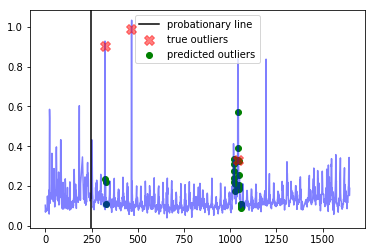




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [1487, 1488, 1489]


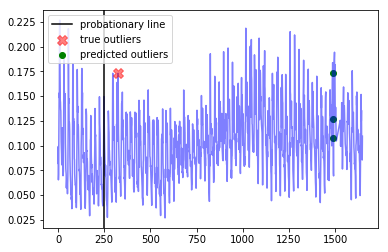




--- nyc_taxi ---
Corresponding window precision:  0.75
Corresponding window recall:  0.6
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [5956, 5957, 5958, 5959, 5960, 5961, 5962, 5972, 8836, 8837, 8838, 8839, 9271, 10068, 10069, 10070, 10071, 10072, 10073, 10074, 10097, 10098, 10099]


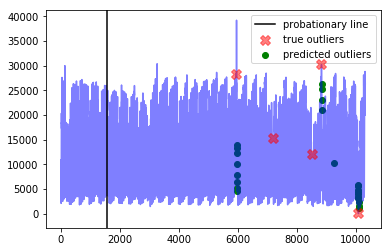




--- exchange-2_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


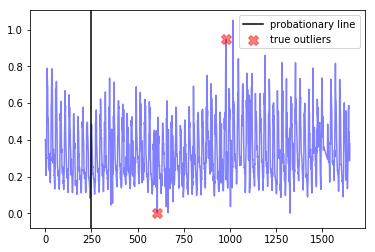




--- international-airline-passengers ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


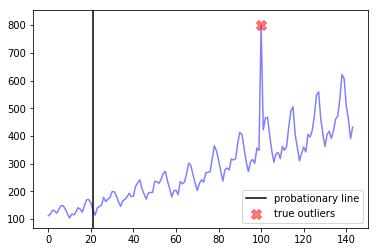




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1195, 1196, 1197, 1198, 1199]


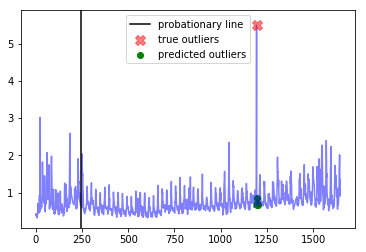




--- elb_request_count_8c0756 ---
Corresponding window precision:  0.6666666666666666
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [787, 788, 790, 791, 793, 1980, 1981, 1982, 3691, 3692, 3693, 3694, 3695, 3696]


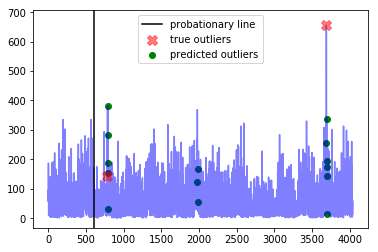




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.5
Corresponding window recall:  0.5
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [4125, 4126, 4127, 4128, 5992, 5994, 5995, 5996, 5997]


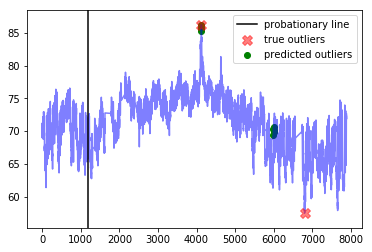




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.2
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  4
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [721, 722, 798, 799, 1638, 1639, 3147, 3448, 3449, 3450, 3451]


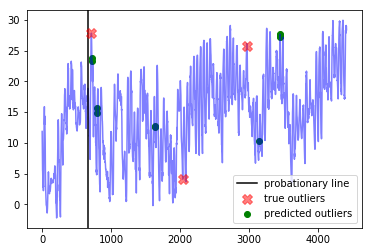




--- all_data_gift_certificates ---
Corresponding window precision:  0.2
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  4
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [4964, 4965, 4966, 4967, 4968, 4987, 4988, 4989, 4990, 4991, 6506, 6507, 6508, 6509, 6510, 7990, 8325, 8326, 8327, 8328, 8329]


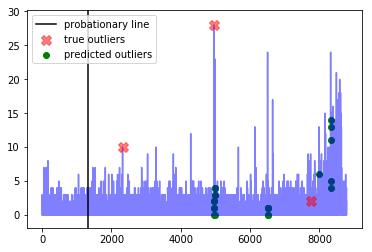

---------weight_fp=0.2, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  14.600000000000001
Best window threshold:  1.0
Corresponding window overall precision:  0.4583333333333333
Corresponding window overall recall:  0.4782608695652174
Corresponding window overall F score:  0.4680851063829787



--- exchange-3_cpc_results ---
Corresponding window precision:  0.6666666666666666
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [325, 326, 327, 1019, 1020, 1021, 1022, 1023, 1024, 1025, 1042, 1043, 1044, 1045, 1046, 1047, 1048, 1049, 1056, 1057, 1058, 1059, 1060]


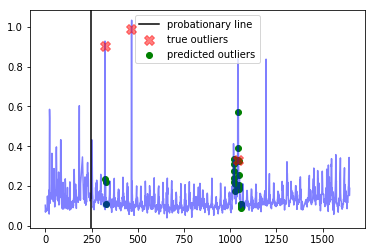




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [1487, 1488, 1489]


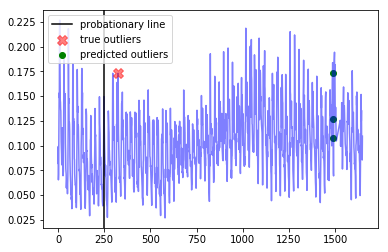




--- nyc_taxi ---
Corresponding window precision:  0.75
Corresponding window recall:  0.6
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [5956, 5957, 5958, 5959, 5960, 5961, 5962, 5972, 8836, 8837, 8838, 8839, 9271, 10068, 10069, 10070, 10071, 10072, 10073, 10074, 10097, 10098, 10099]


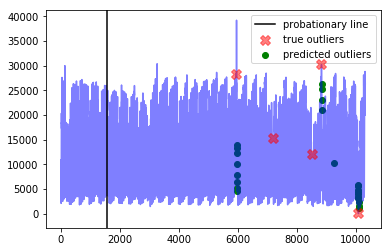




--- exchange-2_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


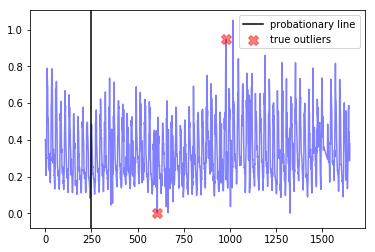




--- international-airline-passengers ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


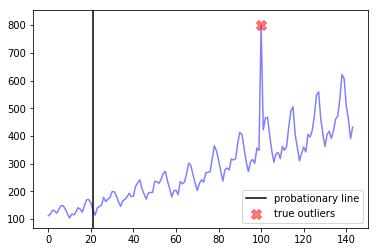




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1195, 1196, 1197, 1198, 1199]


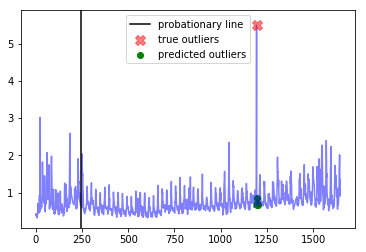




--- elb_request_count_8c0756 ---
Corresponding window precision:  0.6666666666666666
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [787, 788, 790, 791, 793, 1980, 1981, 1982, 3691, 3692, 3693, 3694, 3695, 3696]


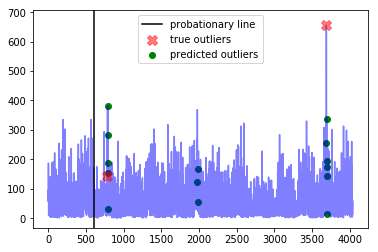




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.5
Corresponding window recall:  0.5
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [4125, 4126, 4127, 4128, 5992, 5994, 5995, 5996, 5997]


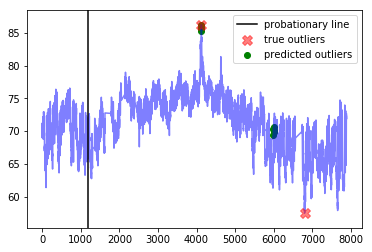




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.2
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  4
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [721, 722, 798, 799, 1638, 1639, 3147, 3448, 3449, 3450, 3451]


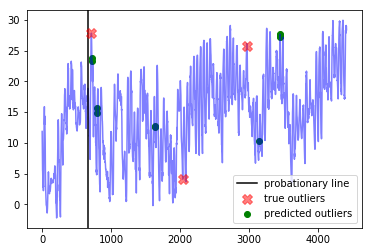




--- all_data_gift_certificates ---
Corresponding window precision:  0.2
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  4
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [4964, 4965, 4966, 4967, 4968, 4987, 4988, 4989, 4990, 4991, 6506, 6507, 6508, 6509, 6510, 7990, 8325, 8326, 8327, 8328, 8329]


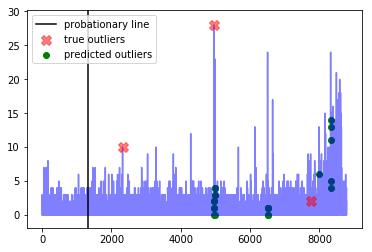

---------weight_fp=0.3, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  15.900000000000002
Best window threshold:  1.0
Corresponding window overall precision:  0.4583333333333333
Corresponding window overall recall:  0.4782608695652174
Corresponding window overall F score:  0.4680851063829787



--- exchange-3_cpc_results ---
Corresponding window precision:  0.6666666666666666
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [325, 326, 327, 1019, 1020, 1021, 1022, 1023, 1024, 1025, 1042, 1043, 1044, 1045, 1046, 1047, 1048, 1049, 1056, 1057, 1058, 1059, 1060]


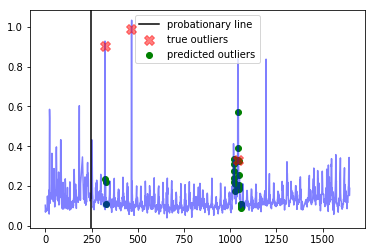




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [1487, 1488, 1489]


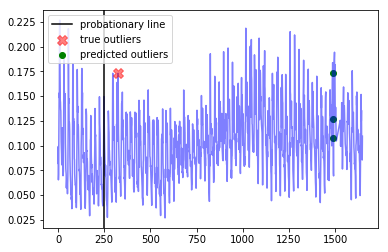




--- nyc_taxi ---
Corresponding window precision:  0.75
Corresponding window recall:  0.6
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [5956, 5957, 5958, 5959, 5960, 5961, 5962, 5972, 8836, 8837, 8838, 8839, 9271, 10068, 10069, 10070, 10071, 10072, 10073, 10074, 10097, 10098, 10099]


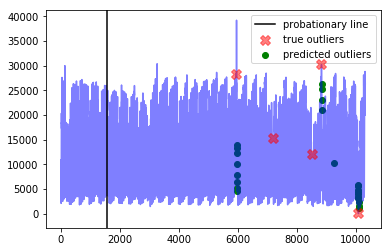




--- exchange-2_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


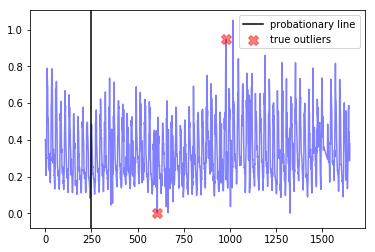




--- international-airline-passengers ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


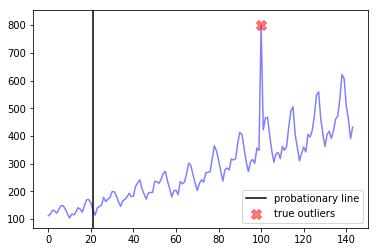




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1195, 1196, 1197, 1198, 1199]


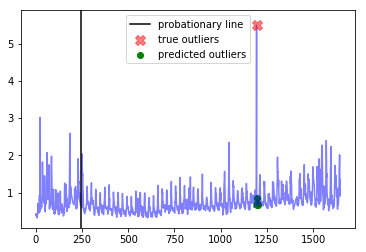




--- elb_request_count_8c0756 ---
Corresponding window precision:  0.6666666666666666
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [787, 788, 790, 791, 793, 1980, 1981, 1982, 3691, 3692, 3693, 3694, 3695, 3696]


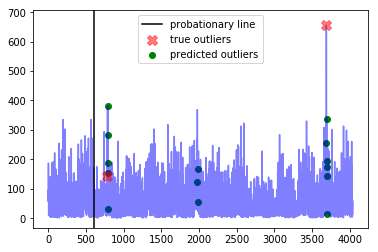




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.5
Corresponding window recall:  0.5
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [4125, 4126, 4127, 4128, 5992, 5994, 5995, 5996, 5997]


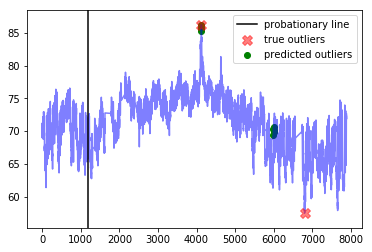




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.2
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  4
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [721, 722, 798, 799, 1638, 1639, 3147, 3448, 3449, 3450, 3451]


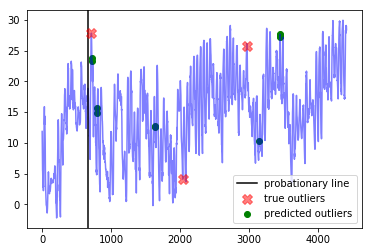




--- all_data_gift_certificates ---
Corresponding window precision:  0.2
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  4
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [4964, 4965, 4966, 4967, 4968, 4987, 4988, 4989, 4990, 4991, 6506, 6507, 6508, 6509, 6510, 7990, 8325, 8326, 8327, 8328, 8329]


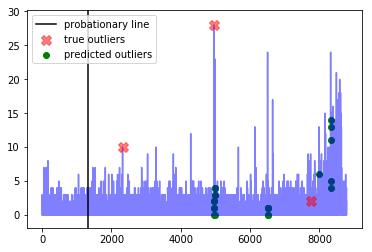

---------weight_fp=0.4, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  17.2
Best window threshold:  1.0
Corresponding window overall precision:  0.4583333333333333
Corresponding window overall recall:  0.4782608695652174
Corresponding window overall F score:  0.4680851063829787



--- exchange-3_cpc_results ---
Corresponding window precision:  0.6666666666666666
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [325, 326, 327, 1019, 1020, 1021, 1022, 1023, 1024, 1025, 1042, 1043, 1044, 1045, 1046, 1047, 1048, 1049, 1056, 1057, 1058, 1059, 1060]


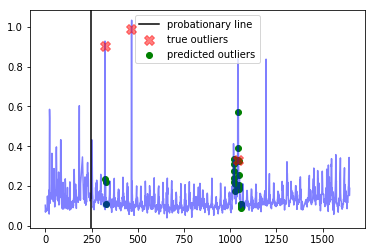




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [1487, 1488, 1489]


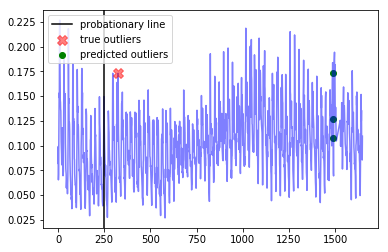




--- nyc_taxi ---
Corresponding window precision:  0.75
Corresponding window recall:  0.6
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [5956, 5957, 5958, 5959, 5960, 5961, 5962, 5972, 8836, 8837, 8838, 8839, 9271, 10068, 10069, 10070, 10071, 10072, 10073, 10074, 10097, 10098, 10099]


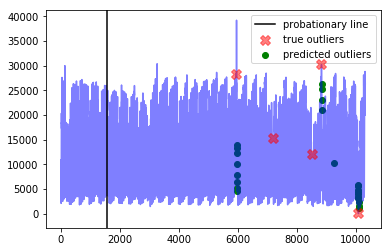




--- exchange-2_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


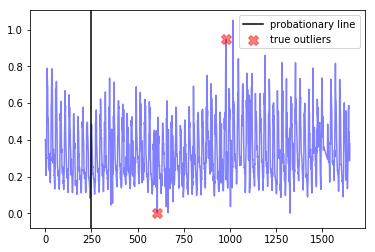




--- international-airline-passengers ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


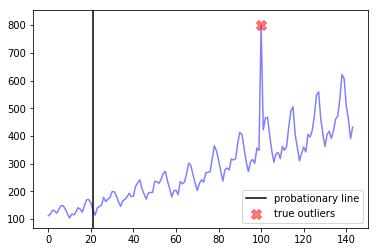




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1195, 1196, 1197, 1198, 1199]


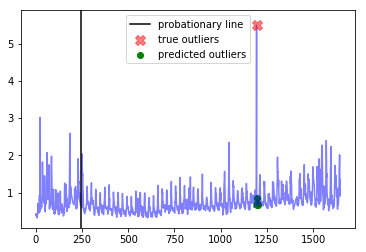




--- elb_request_count_8c0756 ---
Corresponding window precision:  0.6666666666666666
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [787, 788, 790, 791, 793, 1980, 1981, 1982, 3691, 3692, 3693, 3694, 3695, 3696]


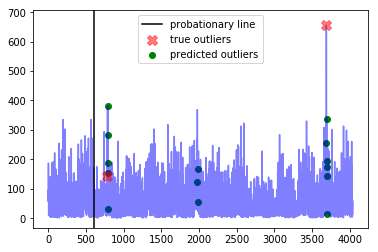




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.5
Corresponding window recall:  0.5
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [4125, 4126, 4127, 4128, 5992, 5994, 5995, 5996, 5997]


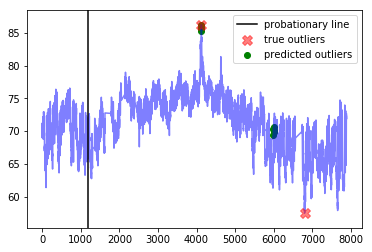




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.2
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  4
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [721, 722, 798, 799, 1638, 1639, 3147, 3448, 3449, 3450, 3451]


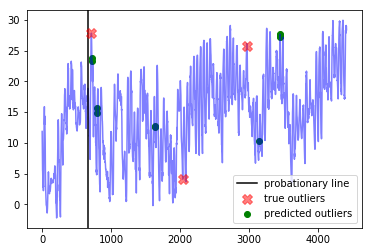




--- all_data_gift_certificates ---
Corresponding window precision:  0.2
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  4
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [4964, 4965, 4966, 4967, 4968, 4987, 4988, 4989, 4990, 4991, 6506, 6507, 6508, 6509, 6510, 7990, 8325, 8326, 8327, 8328, 8329]


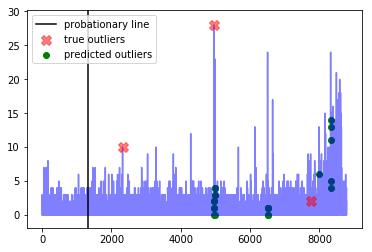

---------weight_fp=0.5, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  18.5
Best window threshold:  1.0
Corresponding window overall precision:  0.4583333333333333
Corresponding window overall recall:  0.4782608695652174
Corresponding window overall F score:  0.4680851063829787



--- exchange-3_cpc_results ---
Corresponding window precision:  0.6666666666666666
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [325, 326, 327, 1019, 1020, 1021, 1022, 1023, 1024, 1025, 1042, 1043, 1044, 1045, 1046, 1047, 1048, 1049, 1056, 1057, 1058, 1059, 1060]


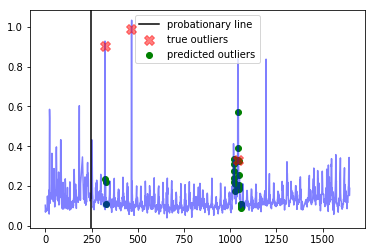




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [1487, 1488, 1489]


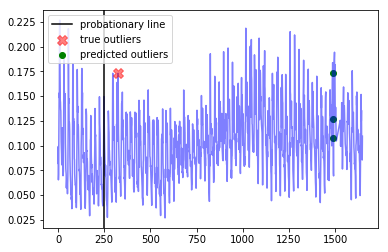




--- nyc_taxi ---
Corresponding window precision:  0.75
Corresponding window recall:  0.6
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [5956, 5957, 5958, 5959, 5960, 5961, 5962, 5972, 8836, 8837, 8838, 8839, 9271, 10068, 10069, 10070, 10071, 10072, 10073, 10074, 10097, 10098, 10099]


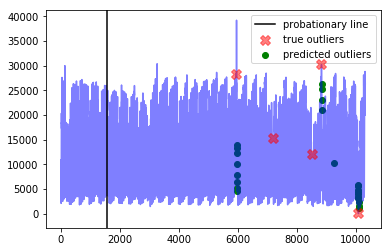




--- exchange-2_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


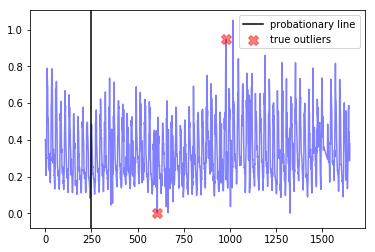




--- international-airline-passengers ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


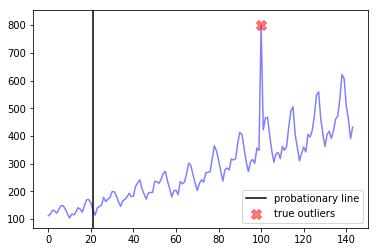




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1195, 1196, 1197, 1198, 1199]


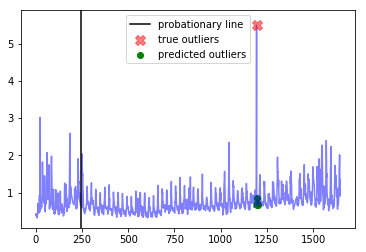




--- elb_request_count_8c0756 ---
Corresponding window precision:  0.6666666666666666
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [787, 788, 790, 791, 793, 1980, 1981, 1982, 3691, 3692, 3693, 3694, 3695, 3696]


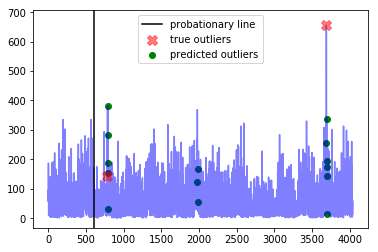




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.5
Corresponding window recall:  0.5
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [4125, 4126, 4127, 4128, 5992, 5994, 5995, 5996, 5997]


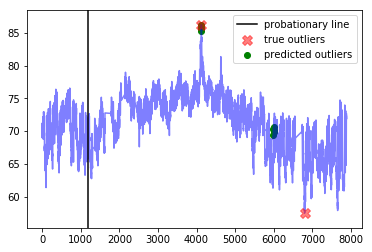




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.2
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  4
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [721, 722, 798, 799, 1638, 1639, 3147, 3448, 3449, 3450, 3451]


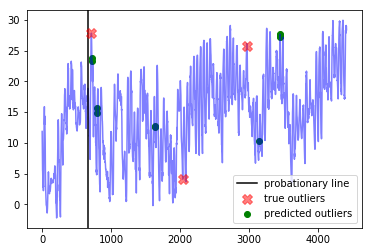




--- all_data_gift_certificates ---
Corresponding window precision:  0.2
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  4
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [4964, 4965, 4966, 4967, 4968, 4987, 4988, 4989, 4990, 4991, 6506, 6507, 6508, 6509, 6510, 7990, 8325, 8326, 8327, 8328, 8329]


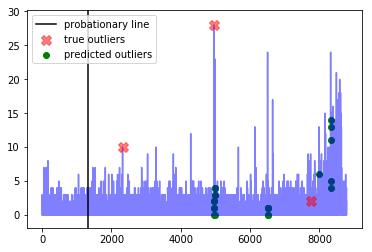

---------weight_fp=0.6, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  19.8
Best window threshold:  1.0
Corresponding window overall precision:  0.4583333333333333
Corresponding window overall recall:  0.4782608695652174
Corresponding window overall F score:  0.4680851063829787



--- exchange-3_cpc_results ---
Corresponding window precision:  0.6666666666666666
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [325, 326, 327, 1019, 1020, 1021, 1022, 1023, 1024, 1025, 1042, 1043, 1044, 1045, 1046, 1047, 1048, 1049, 1056, 1057, 1058, 1059, 1060]


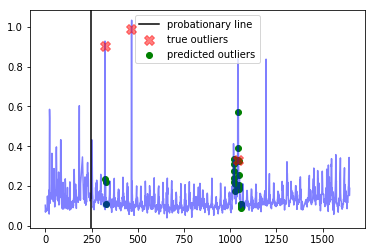




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [1487, 1488, 1489]


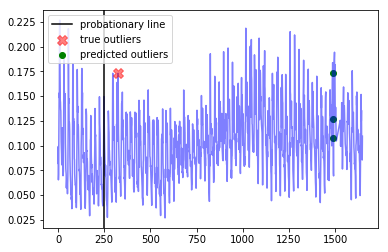




--- nyc_taxi ---
Corresponding window precision:  0.75
Corresponding window recall:  0.6
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [5956, 5957, 5958, 5959, 5960, 5961, 5962, 5972, 8836, 8837, 8838, 8839, 9271, 10068, 10069, 10070, 10071, 10072, 10073, 10074, 10097, 10098, 10099]


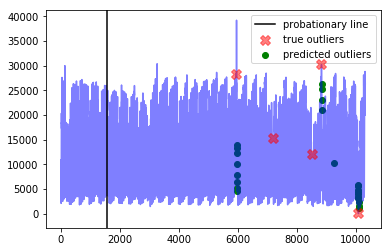




--- exchange-2_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


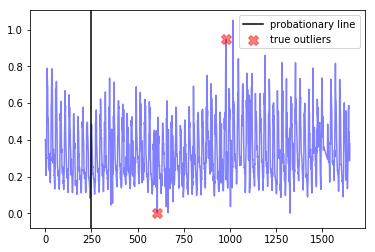




--- international-airline-passengers ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


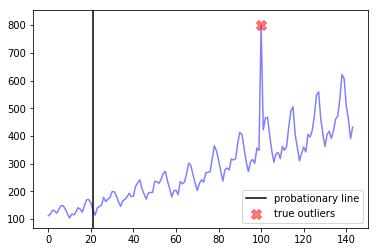




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1195, 1196, 1197, 1198, 1199]


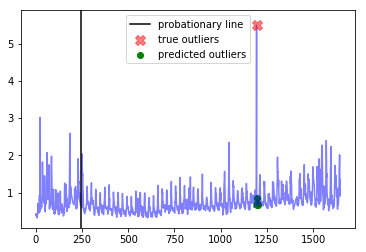




--- elb_request_count_8c0756 ---
Corresponding window precision:  0.6666666666666666
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [787, 788, 790, 791, 793, 1980, 1981, 1982, 3691, 3692, 3693, 3694, 3695, 3696]


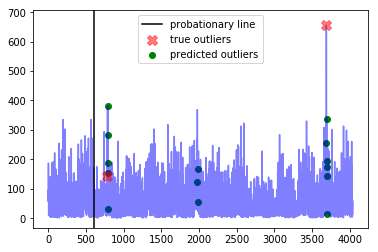




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.5
Corresponding window recall:  0.5
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [4125, 4126, 4127, 4128, 5992, 5994, 5995, 5996, 5997]


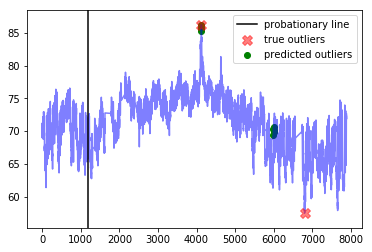




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.2
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  4
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [721, 722, 798, 799, 1638, 1639, 3147, 3448, 3449, 3450, 3451]


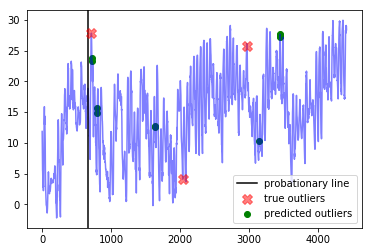




--- all_data_gift_certificates ---
Corresponding window precision:  0.2
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  4
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [4964, 4965, 4966, 4967, 4968, 4987, 4988, 4989, 4990, 4991, 6506, 6507, 6508, 6509, 6510, 7990, 8325, 8326, 8327, 8328, 8329]


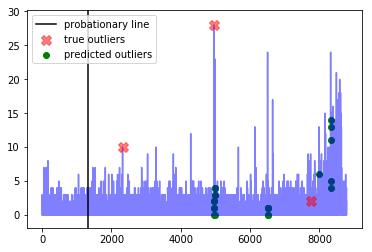

---------weight_fp=0.7, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  21.099999999999998
Best window threshold:  1.0
Corresponding window overall precision:  0.4583333333333333
Corresponding window overall recall:  0.4782608695652174
Corresponding window overall F score:  0.4680851063829787



--- exchange-3_cpc_results ---
Corresponding window precision:  0.6666666666666666
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [325, 326, 327, 1019, 1020, 1021, 1022, 1023, 1024, 1025, 1042, 1043, 1044, 1045, 1046, 1047, 1048, 1049, 1056, 1057, 1058, 1059, 1060]


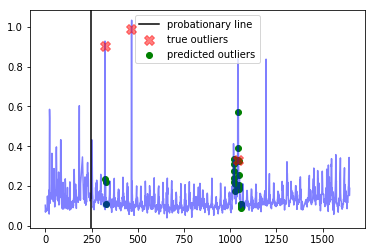




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [1487, 1488, 1489]


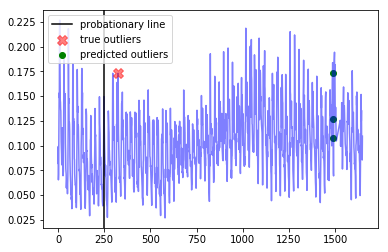




--- nyc_taxi ---
Corresponding window precision:  0.75
Corresponding window recall:  0.6
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [5956, 5957, 5958, 5959, 5960, 5961, 5962, 5972, 8836, 8837, 8838, 8839, 9271, 10068, 10069, 10070, 10071, 10072, 10073, 10074, 10097, 10098, 10099]


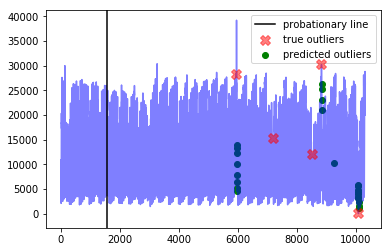




--- exchange-2_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


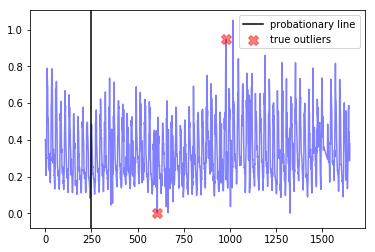




--- international-airline-passengers ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


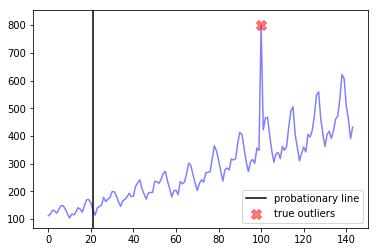




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1195, 1196, 1197, 1198, 1199]


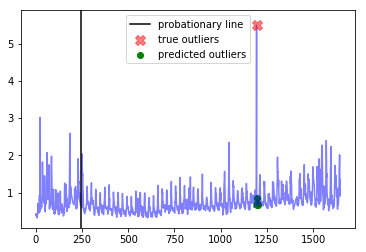




--- elb_request_count_8c0756 ---
Corresponding window precision:  0.6666666666666666
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [787, 788, 790, 791, 793, 1980, 1981, 1982, 3691, 3692, 3693, 3694, 3695, 3696]


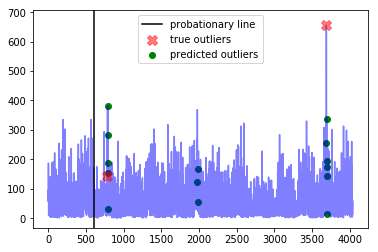




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.5
Corresponding window recall:  0.5
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [4125, 4126, 4127, 4128, 5992, 5994, 5995, 5996, 5997]


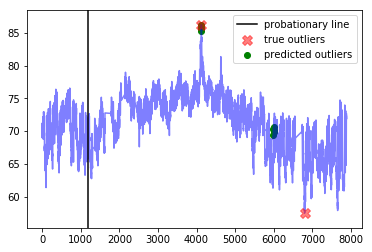




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.2
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  4
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [721, 722, 798, 799, 1638, 1639, 3147, 3448, 3449, 3450, 3451]


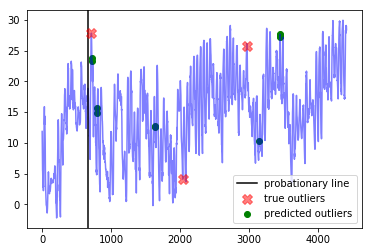




--- all_data_gift_certificates ---
Corresponding window precision:  0.2
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  4
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [4964, 4965, 4966, 4967, 4968, 4987, 4988, 4989, 4990, 4991, 6506, 6507, 6508, 6509, 6510, 7990, 8325, 8326, 8327, 8328, 8329]


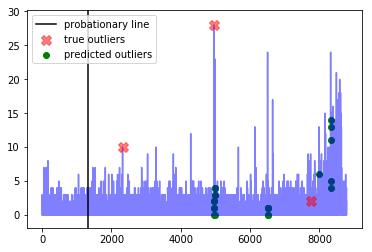

---------weight_fp=0.8, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  22.400000000000002
Best window threshold:  1.0
Corresponding window overall precision:  0.4583333333333333
Corresponding window overall recall:  0.4782608695652174
Corresponding window overall F score:  0.4680851063829787



--- exchange-3_cpc_results ---
Corresponding window precision:  0.6666666666666666
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [325, 326, 327, 1019, 1020, 1021, 1022, 1023, 1024, 1025, 1042, 1043, 1044, 1045, 1046, 1047, 1048, 1049, 1056, 1057, 1058, 1059, 1060]


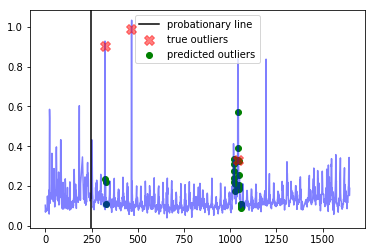




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [1487, 1488, 1489]


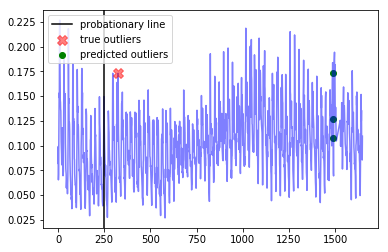




--- nyc_taxi ---
Corresponding window precision:  0.75
Corresponding window recall:  0.6
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [5956, 5957, 5958, 5959, 5960, 5961, 5962, 5972, 8836, 8837, 8838, 8839, 9271, 10068, 10069, 10070, 10071, 10072, 10073, 10074, 10097, 10098, 10099]


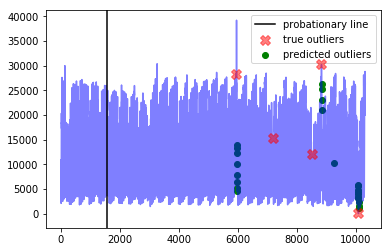




--- exchange-2_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


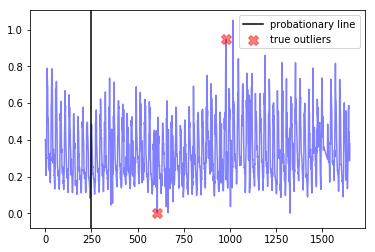




--- international-airline-passengers ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


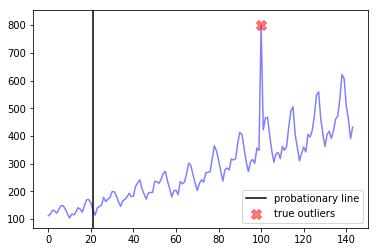




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1195, 1196, 1197, 1198, 1199]


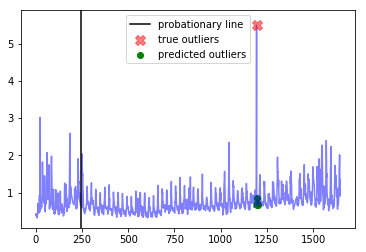




--- elb_request_count_8c0756 ---
Corresponding window precision:  0.6666666666666666
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [787, 788, 790, 791, 793, 1980, 1981, 1982, 3691, 3692, 3693, 3694, 3695, 3696]


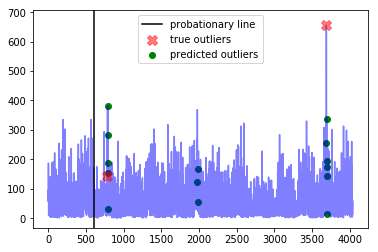




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.5
Corresponding window recall:  0.5
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [4125, 4126, 4127, 4128, 5992, 5994, 5995, 5996, 5997]


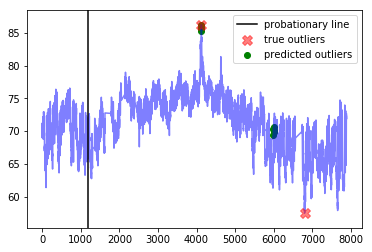




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.2
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  4
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [721, 722, 798, 799, 1638, 1639, 3147, 3448, 3449, 3450, 3451]


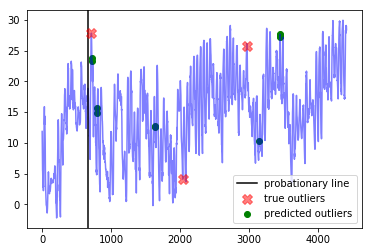




--- all_data_gift_certificates ---
Corresponding window precision:  0.2
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  4
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [4964, 4965, 4966, 4967, 4968, 4987, 4988, 4989, 4990, 4991, 6506, 6507, 6508, 6509, 6510, 7990, 8325, 8326, 8327, 8328, 8329]


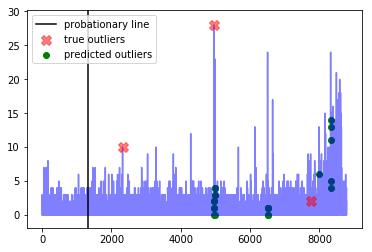

---------weight_fp=0.9, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  23.700000000000003
Best window threshold:  1.0
Corresponding window overall precision:  0.4583333333333333
Corresponding window overall recall:  0.4782608695652174
Corresponding window overall F score:  0.4680851063829787



--- exchange-3_cpc_results ---
Corresponding window precision:  0.6666666666666666
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [325, 326, 327, 1019, 1020, 1021, 1022, 1023, 1024, 1025, 1042, 1043, 1044, 1045, 1046, 1047, 1048, 1049, 1056, 1057, 1058, 1059, 1060]


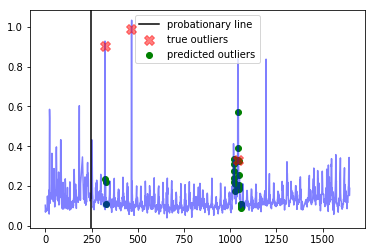




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [1487, 1488, 1489]


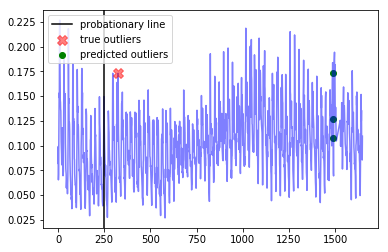




--- nyc_taxi ---
Corresponding window precision:  0.75
Corresponding window recall:  0.6
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [5956, 5957, 5958, 5959, 5960, 5961, 5962, 5972, 8836, 8837, 8838, 8839, 9271, 10068, 10069, 10070, 10071, 10072, 10073, 10074, 10097, 10098, 10099]


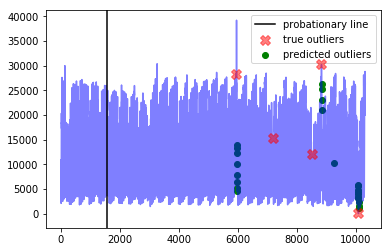




--- exchange-2_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


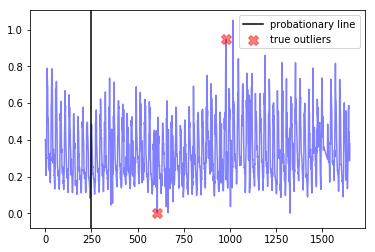




--- international-airline-passengers ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


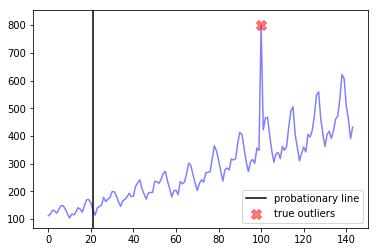




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1195, 1196, 1197, 1198, 1199]


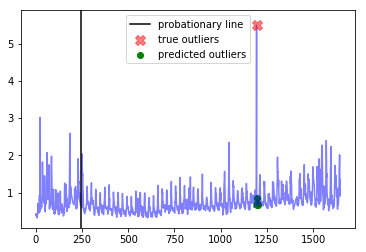




--- elb_request_count_8c0756 ---
Corresponding window precision:  0.6666666666666666
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [787, 788, 790, 791, 793, 1980, 1981, 1982, 3691, 3692, 3693, 3694, 3695, 3696]


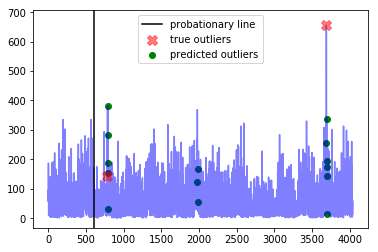




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.5
Corresponding window recall:  0.5
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [4125, 4126, 4127, 4128, 5992, 5994, 5995, 5996, 5997]


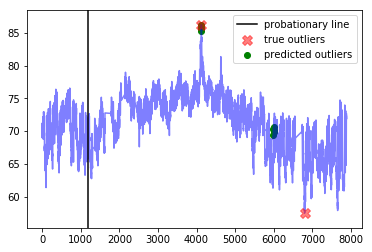




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.2
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  4
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [721, 722, 798, 799, 1638, 1639, 3147, 3448, 3449, 3450, 3451]


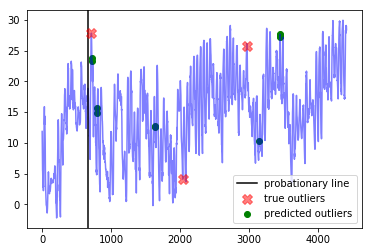




--- all_data_gift_certificates ---
Corresponding window precision:  0.2
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  4
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [4964, 4965, 4966, 4967, 4968, 4987, 4988, 4989, 4990, 4991, 6506, 6507, 6508, 6509, 6510, 7990, 8325, 8326, 8327, 8328, 8329]


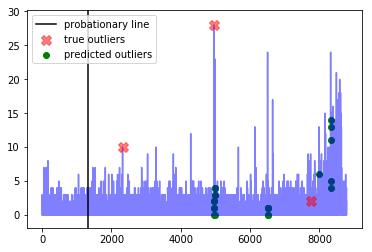

---------weight_fp=1.0, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  25.0
Best window threshold:  1.0
Corresponding window overall precision:  0.4583333333333333
Corresponding window overall recall:  0.4782608695652174
Corresponding window overall F score:  0.4680851063829787



--- exchange-3_cpc_results ---
Corresponding window precision:  0.6666666666666666
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [325, 326, 327, 1019, 1020, 1021, 1022, 1023, 1024, 1025, 1042, 1043, 1044, 1045, 1046, 1047, 1048, 1049, 1056, 1057, 1058, 1059, 1060]


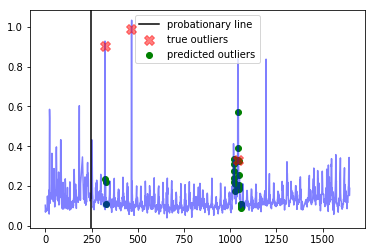




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [1487, 1488, 1489]


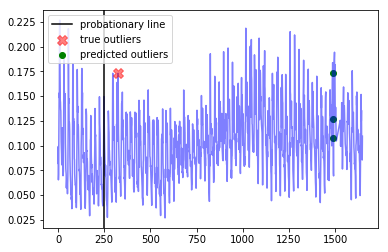




--- nyc_taxi ---
Corresponding window precision:  0.75
Corresponding window recall:  0.6
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [5956, 5957, 5958, 5959, 5960, 5961, 5962, 5972, 8836, 8837, 8838, 8839, 9271, 10068, 10069, 10070, 10071, 10072, 10073, 10074, 10097, 10098, 10099]


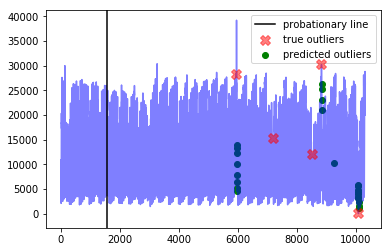




--- exchange-2_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


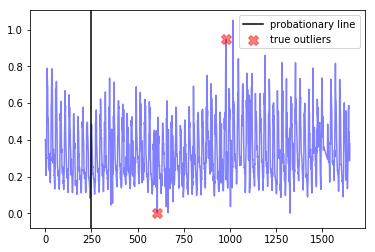




--- international-airline-passengers ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


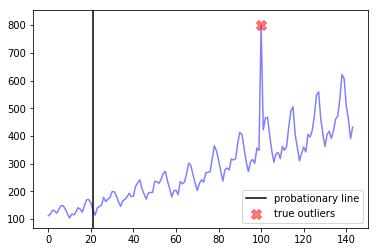




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1195, 1196, 1197, 1198, 1199]


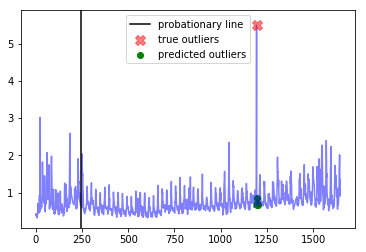




--- elb_request_count_8c0756 ---
Corresponding window precision:  0.6666666666666666
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [787, 788, 790, 791, 793, 1980, 1981, 1982, 3691, 3692, 3693, 3694, 3695, 3696]


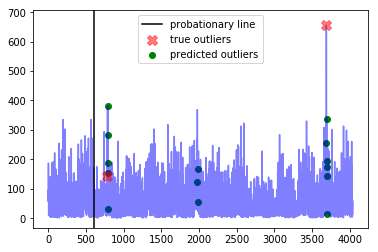




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.5
Corresponding window recall:  0.5
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [4125, 4126, 4127, 4128, 5992, 5994, 5995, 5996, 5997]


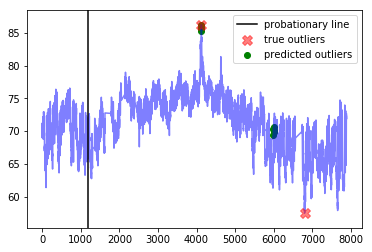




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.2
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  4
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [721, 722, 798, 799, 1638, 1639, 3147, 3448, 3449, 3450, 3451]


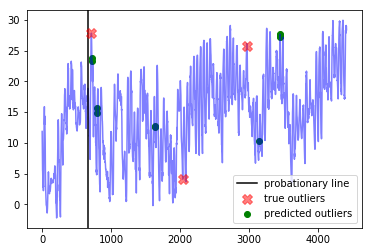




--- all_data_gift_certificates ---
Corresponding window precision:  0.2
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  4
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [4964, 4965, 4966, 4967, 4968, 4987, 4988, 4989, 4990, 4991, 6506, 6507, 6508, 6509, 6510, 7990, 8325, 8326, 8327, 8328, 8329]


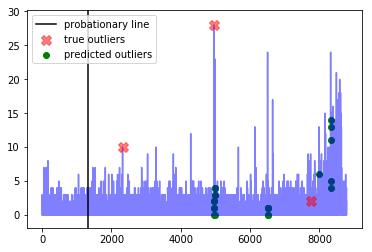

------------
False Positive Weight:  0.1
	 Minimum number of mistakes : 13.3
	 Best window threshold : 1.0
	 Corresponding window overall recall : 0.4782608695652174
	 Corresponding window overall F score : 0.4680851063829787
	 Corresponding window overall precision : 0.4583333333333333
False Positive Weight:  0.2
	 Minimum number of mistakes : 14.600000000000001
	 Best window threshold : 1.0
	 Corresponding window overall recall : 0.4782608695652174
	 Corresponding window overall F score : 0.4680851063829787
	 Corresponding window overall precision : 0.4583333333333333
False Positive Weight:  0.3
	 Minimum number of mistakes : 15.900000000000002
	 Best window threshold : 1.0
	 Corresponding window overall recall : 0.4782608695652174
	 Corresponding window overall F score : 0.4680851063829787
	 Corresponding window overall precision : 0.4583333333333333
False Positive Weight:  0.6
	 Minimum number of mistakes : 19.8
	 Best window threshold : 1.0
	 Corresponding window overall recall : 

In [16]:
end_results = {}
for weight_fp in weight_fp_list:  
    print("---------weight_fp=" + str(weight_fp) + ", weight_fn=1----------")
    weight_result = adclasses.pretty_print_results(ad_dict, anomaly_scores_dict, true_outlier_indices_dict, weight_fp=weight_fp, weight_fn=1)
    end_results[weight_fp] = weight_result

print("------------")
adclasses.pretty_print_end_results(end_results)

# Twitter AD Results

In [24]:
anomaly_scores_dict = {}

for dataset_name in dataset_name_list:
    output_dict_twitter = joblib.load("anomaly_scores/Twitter/" + dataset_name)
    anomaly_scores_dict[dataset_name] = output_dict_twitter["Anomaly Scores"]

---------weight_fp=0.1, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  16.1
Best window threshold:  0.0001
Corresponding window overall precision:  0.75
Corresponding window overall recall:  0.2608695652173913
Corresponding window overall F score:  0.3870967741935483



--- elb_request_count_8c0756 ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [792, 3691]


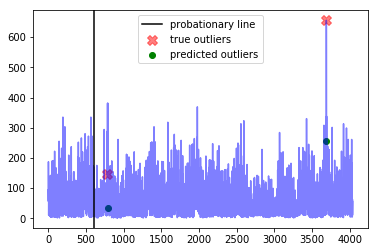




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


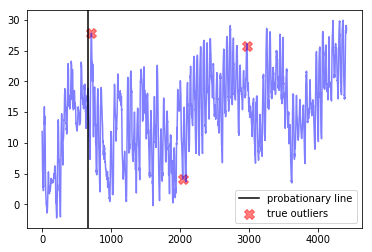




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1194, 1195]


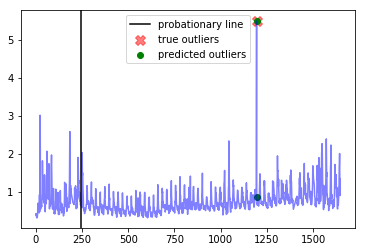




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


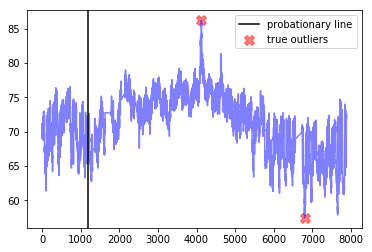




--- all_data_gift_certificates ---
Corresponding window precision:  0.5
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [4964, 6506]


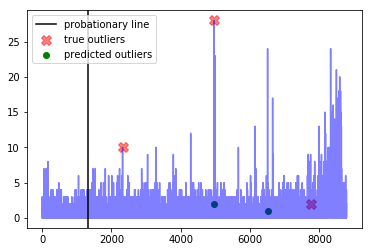




--- nyc_taxi ---
Corresponding window precision:  1.0
Corresponding window recall:  0.2
Corresponding window false positives:  0
Corresponding window false negatives:  4


Outlier indices as determined by best window threshold:  [5955, 5956]


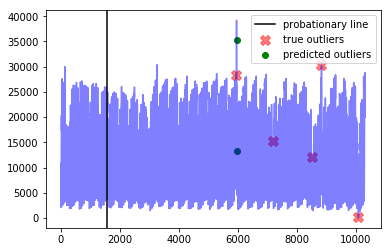




--- exchange-2_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  0.5
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [978]


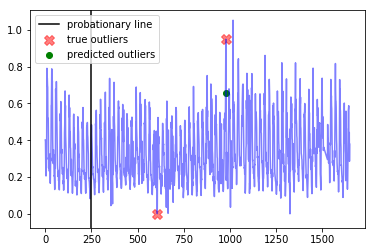




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


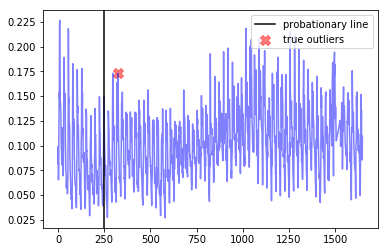




--- international-airline-passengers ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


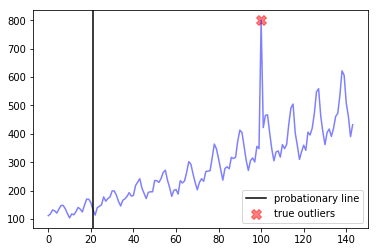




--- exchange-3_cpc_results ---
Corresponding window precision:  1.0
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [467, 468]


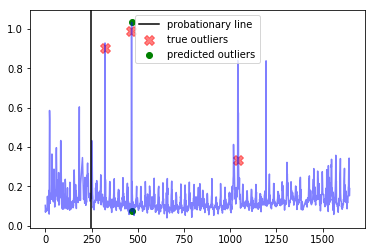

---------weight_fp=0.2, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  16.2
Best window threshold:  0.0001
Corresponding window overall precision:  0.75
Corresponding window overall recall:  0.2608695652173913
Corresponding window overall F score:  0.3870967741935483



--- elb_request_count_8c0756 ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [792, 3691]


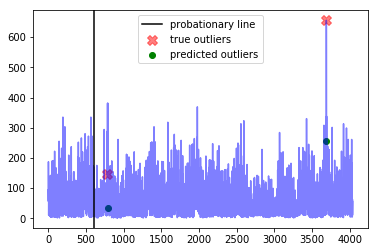




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


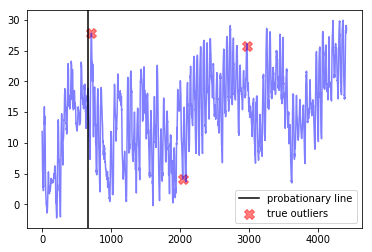




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1194, 1195]


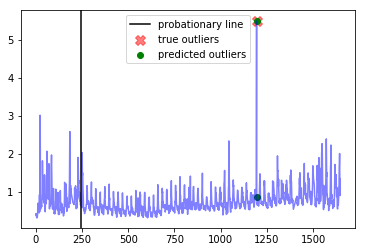




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


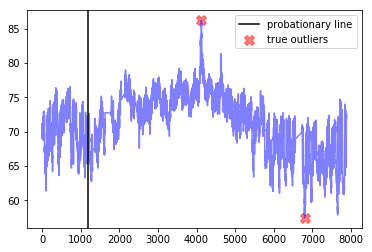




--- all_data_gift_certificates ---
Corresponding window precision:  0.5
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [4964, 6506]


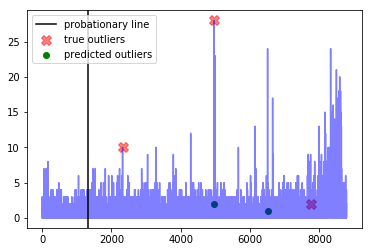




--- nyc_taxi ---
Corresponding window precision:  1.0
Corresponding window recall:  0.2
Corresponding window false positives:  0
Corresponding window false negatives:  4


Outlier indices as determined by best window threshold:  [5955, 5956]


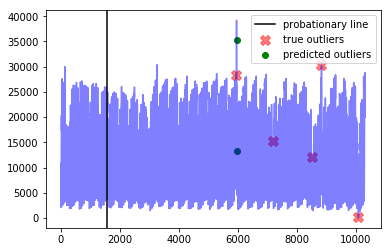




--- exchange-2_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  0.5
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [978]


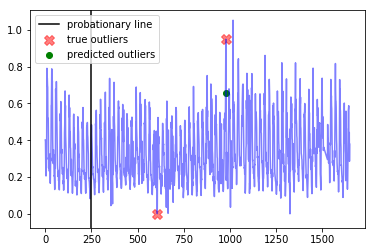




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


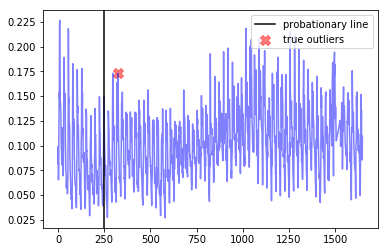




--- international-airline-passengers ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


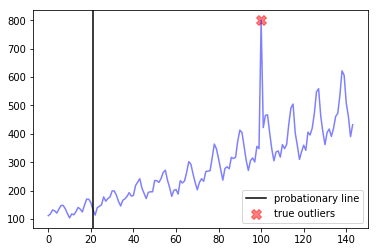




--- exchange-3_cpc_results ---
Corresponding window precision:  1.0
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [467, 468]


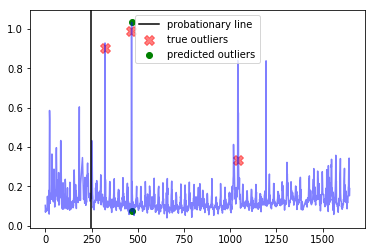

---------weight_fp=0.3, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  16.3
Best window threshold:  0.0001
Corresponding window overall precision:  0.75
Corresponding window overall recall:  0.2608695652173913
Corresponding window overall F score:  0.3870967741935483



--- elb_request_count_8c0756 ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [792, 3691]


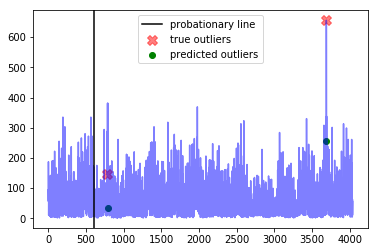




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


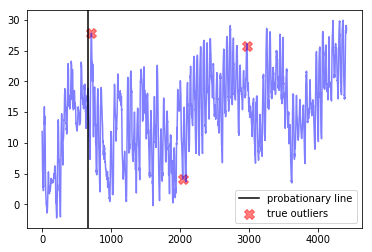




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1194, 1195]


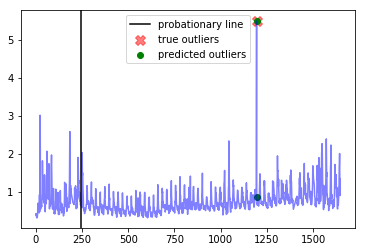




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


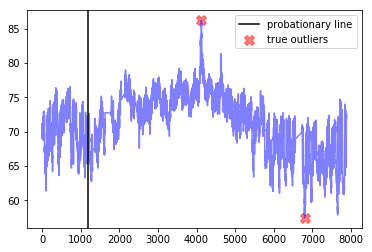




--- all_data_gift_certificates ---
Corresponding window precision:  0.5
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [4964, 6506]


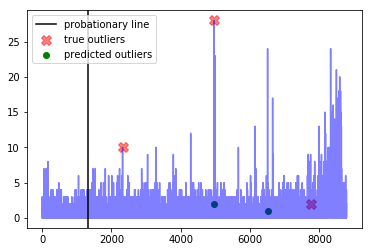




--- nyc_taxi ---
Corresponding window precision:  1.0
Corresponding window recall:  0.2
Corresponding window false positives:  0
Corresponding window false negatives:  4


Outlier indices as determined by best window threshold:  [5955, 5956]


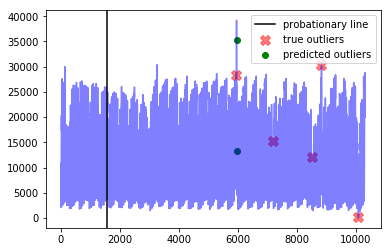




--- exchange-2_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  0.5
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [978]


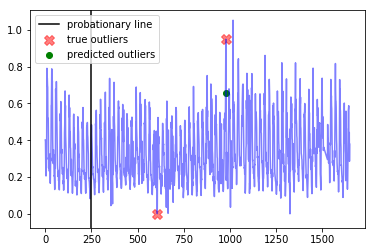




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


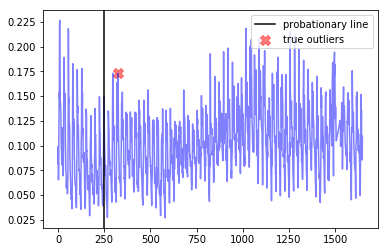




--- international-airline-passengers ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


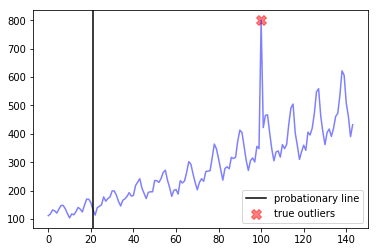




--- exchange-3_cpc_results ---
Corresponding window precision:  1.0
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [467, 468]


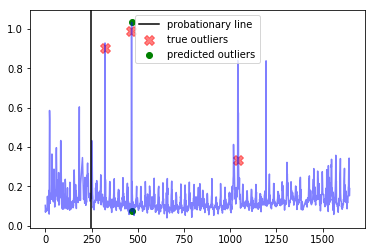

---------weight_fp=0.4, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  16.4
Best window threshold:  0.0001
Corresponding window overall precision:  0.75
Corresponding window overall recall:  0.2608695652173913
Corresponding window overall F score:  0.3870967741935483



--- elb_request_count_8c0756 ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [792, 3691]


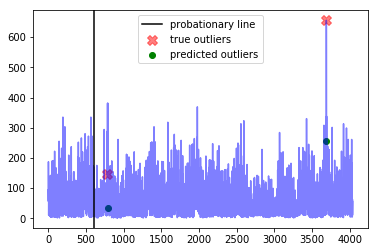




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


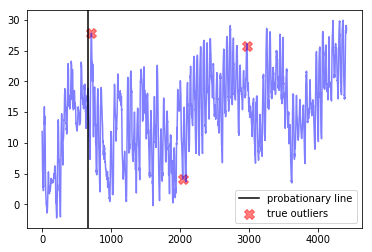




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1194, 1195]


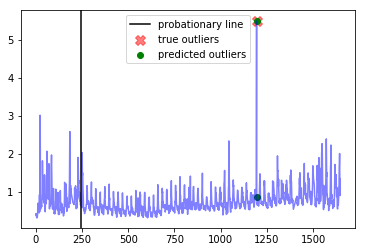




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


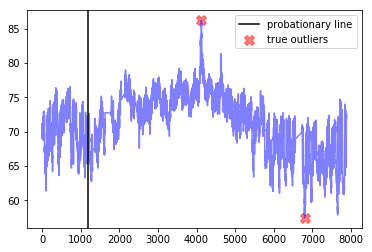




--- all_data_gift_certificates ---
Corresponding window precision:  0.5
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [4964, 6506]


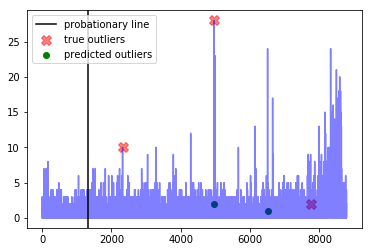




--- nyc_taxi ---
Corresponding window precision:  1.0
Corresponding window recall:  0.2
Corresponding window false positives:  0
Corresponding window false negatives:  4


Outlier indices as determined by best window threshold:  [5955, 5956]


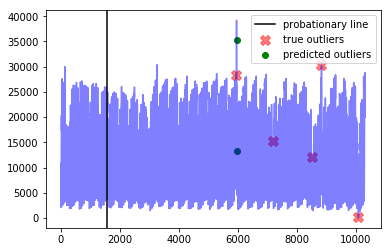




--- exchange-2_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  0.5
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [978]


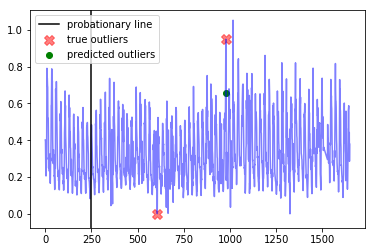




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


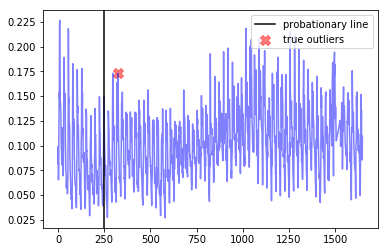




--- international-airline-passengers ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


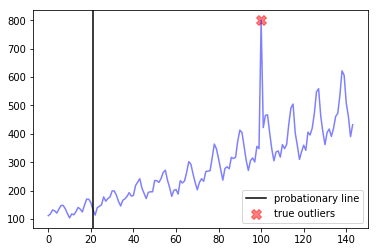




--- exchange-3_cpc_results ---
Corresponding window precision:  1.0
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [467, 468]


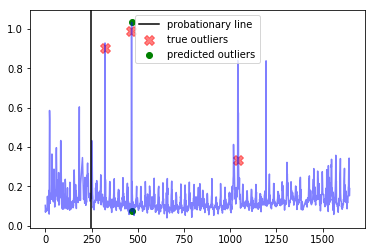

---------weight_fp=0.5, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  16.5
Best window threshold:  0.0001
Corresponding window overall precision:  0.75
Corresponding window overall recall:  0.2608695652173913
Corresponding window overall F score:  0.3870967741935483



--- elb_request_count_8c0756 ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [792, 3691]


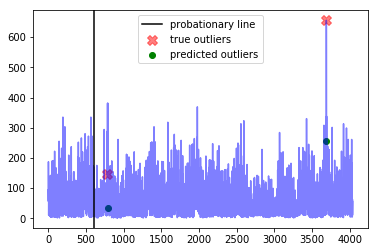




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


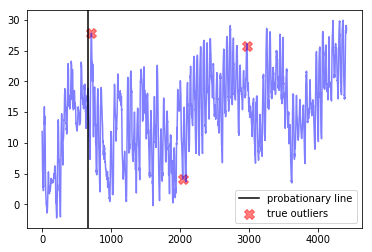




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1194, 1195]


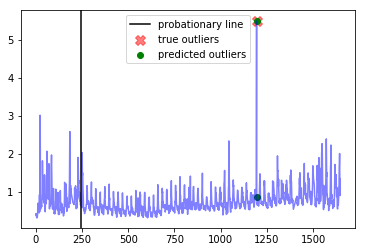




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


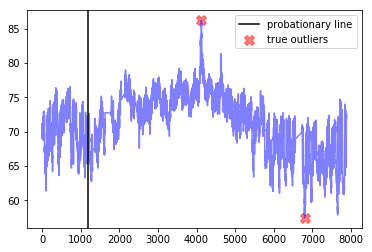




--- all_data_gift_certificates ---
Corresponding window precision:  0.5
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [4964, 6506]


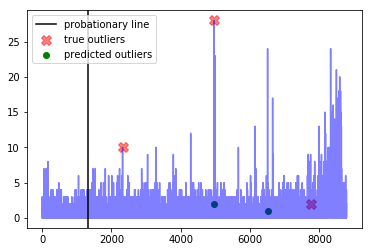




--- nyc_taxi ---
Corresponding window precision:  1.0
Corresponding window recall:  0.2
Corresponding window false positives:  0
Corresponding window false negatives:  4


Outlier indices as determined by best window threshold:  [5955, 5956]


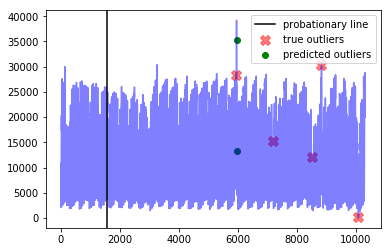




--- exchange-2_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  0.5
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [978]


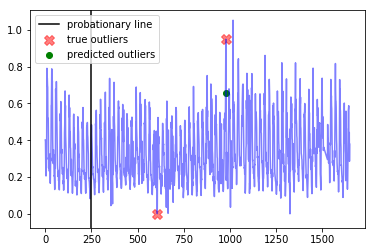




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


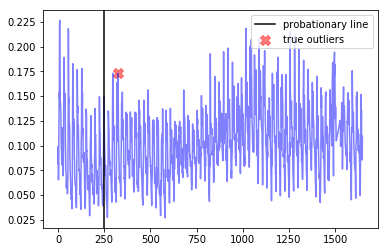




--- international-airline-passengers ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


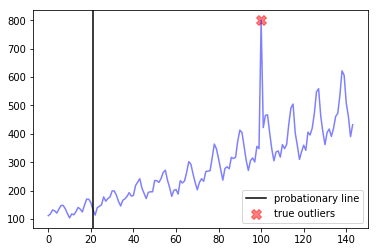




--- exchange-3_cpc_results ---
Corresponding window precision:  1.0
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [467, 468]


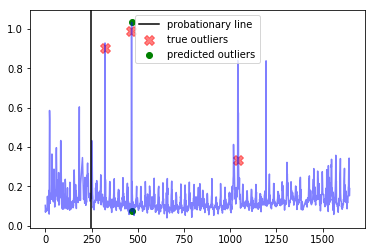

---------weight_fp=0.6, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  16.6
Best window threshold:  0.0001
Corresponding window overall precision:  0.75
Corresponding window overall recall:  0.2608695652173913
Corresponding window overall F score:  0.3870967741935483



--- elb_request_count_8c0756 ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [792, 3691]


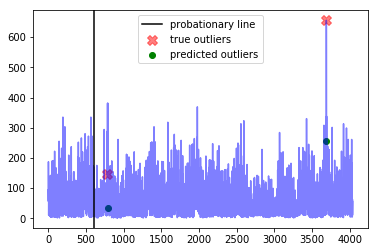




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


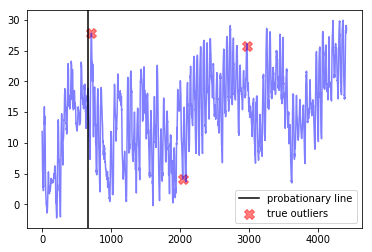




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1194, 1195]


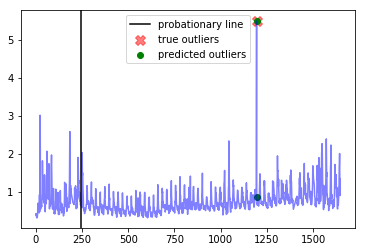




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


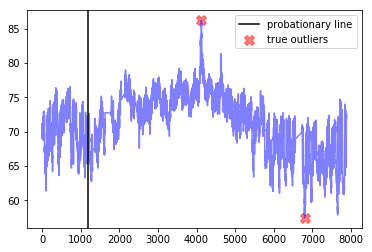




--- all_data_gift_certificates ---
Corresponding window precision:  0.5
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [4964, 6506]


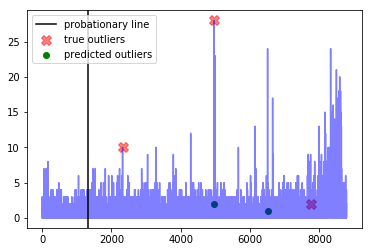




--- nyc_taxi ---
Corresponding window precision:  1.0
Corresponding window recall:  0.2
Corresponding window false positives:  0
Corresponding window false negatives:  4


Outlier indices as determined by best window threshold:  [5955, 5956]


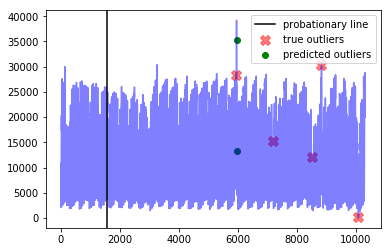




--- exchange-2_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  0.5
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [978]


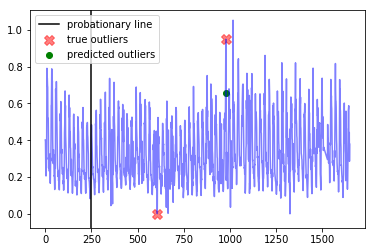




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


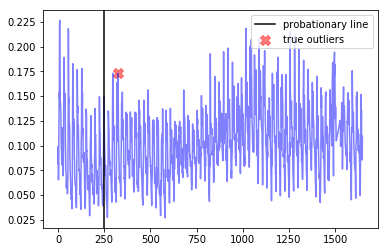




--- international-airline-passengers ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


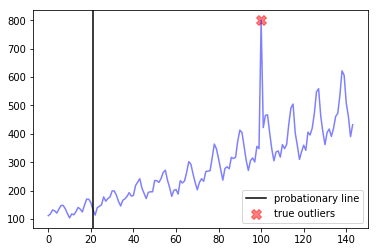




--- exchange-3_cpc_results ---
Corresponding window precision:  1.0
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [467, 468]


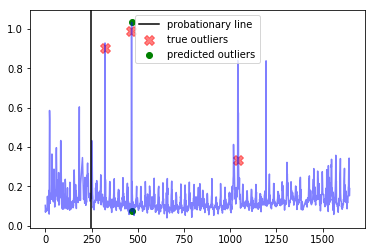

---------weight_fp=0.7, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  16.7
Best window threshold:  0.0001
Corresponding window overall precision:  0.75
Corresponding window overall recall:  0.2608695652173913
Corresponding window overall F score:  0.3870967741935483



--- elb_request_count_8c0756 ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [792, 3691]


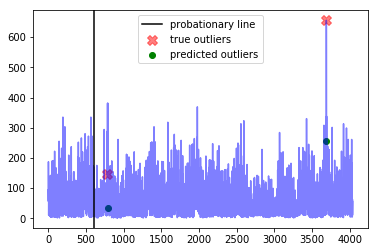




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


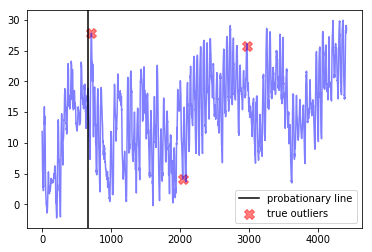




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1194, 1195]


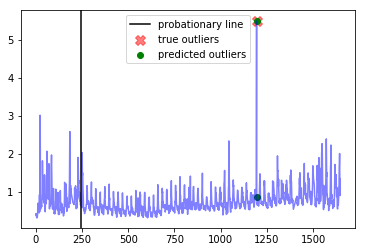




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


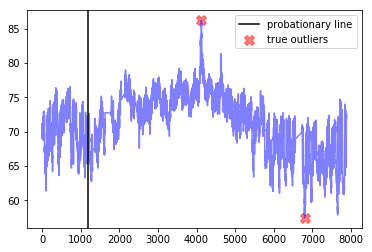




--- all_data_gift_certificates ---
Corresponding window precision:  0.5
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [4964, 6506]


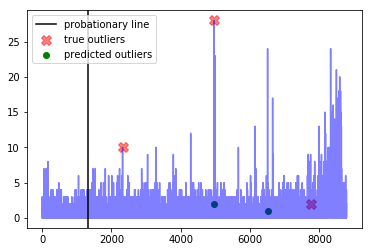




--- nyc_taxi ---
Corresponding window precision:  1.0
Corresponding window recall:  0.2
Corresponding window false positives:  0
Corresponding window false negatives:  4


Outlier indices as determined by best window threshold:  [5955, 5956]


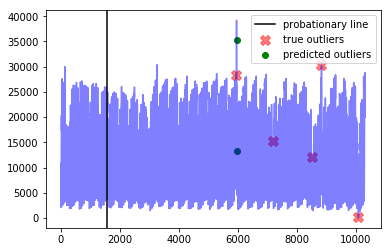




--- exchange-2_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  0.5
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [978]


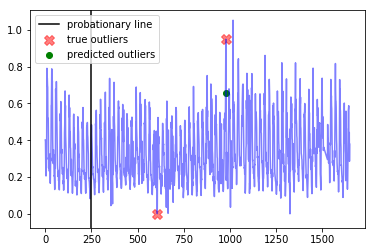




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


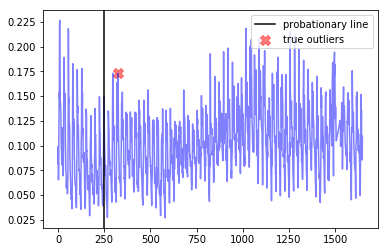




--- international-airline-passengers ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


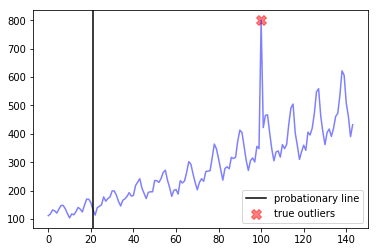




--- exchange-3_cpc_results ---
Corresponding window precision:  1.0
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [467, 468]


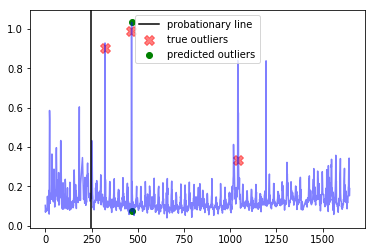

---------weight_fp=0.8, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  16.8
Best window threshold:  0.0001
Corresponding window overall precision:  0.75
Corresponding window overall recall:  0.2608695652173913
Corresponding window overall F score:  0.3870967741935483



--- elb_request_count_8c0756 ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [792, 3691]


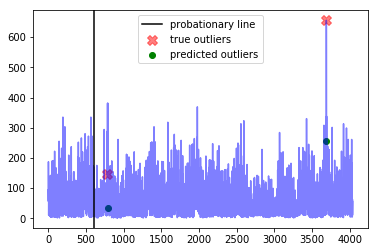




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


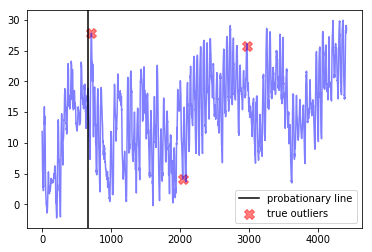




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1194, 1195]


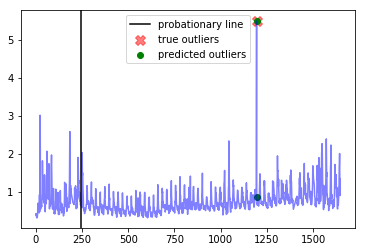




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


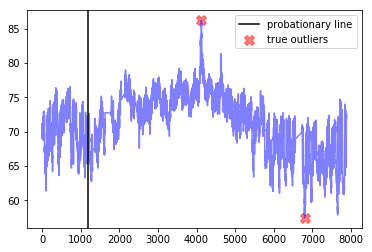




--- all_data_gift_certificates ---
Corresponding window precision:  0.5
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [4964, 6506]


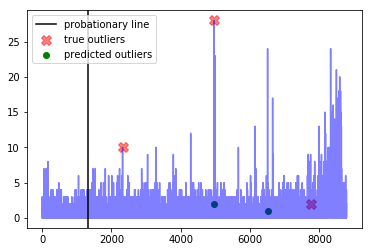




--- nyc_taxi ---
Corresponding window precision:  1.0
Corresponding window recall:  0.2
Corresponding window false positives:  0
Corresponding window false negatives:  4


Outlier indices as determined by best window threshold:  [5955, 5956]


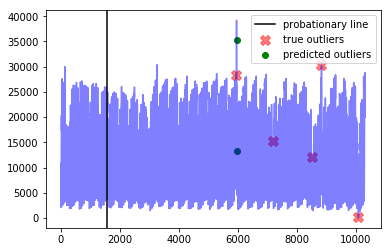




--- exchange-2_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  0.5
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [978]


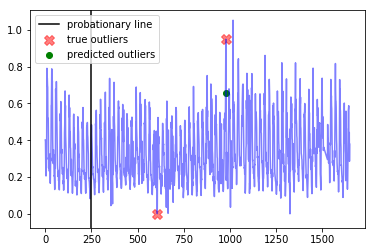




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


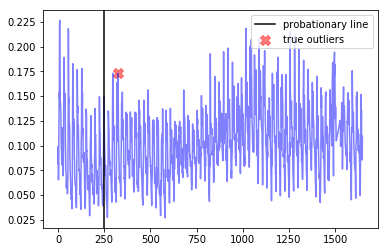




--- international-airline-passengers ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


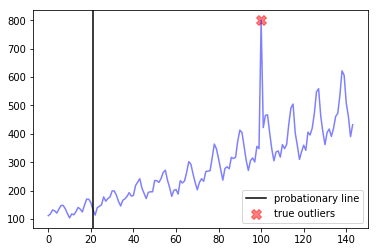




--- exchange-3_cpc_results ---
Corresponding window precision:  1.0
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [467, 468]


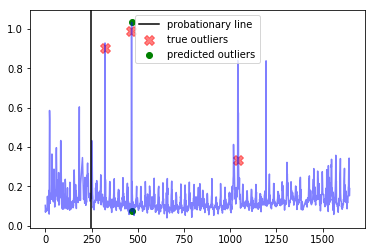

---------weight_fp=0.9, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  16.9
Best window threshold:  0.0001
Corresponding window overall precision:  0.75
Corresponding window overall recall:  0.2608695652173913
Corresponding window overall F score:  0.3870967741935483



--- elb_request_count_8c0756 ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [792, 3691]


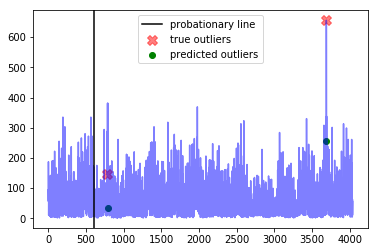




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


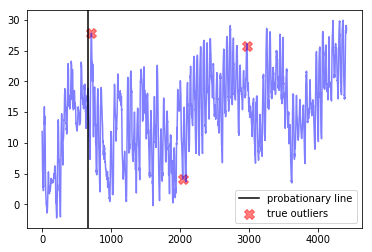




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1194, 1195]


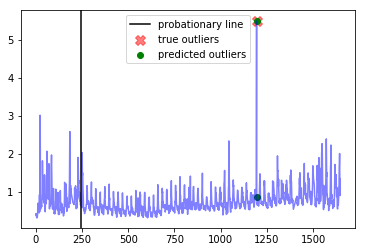




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


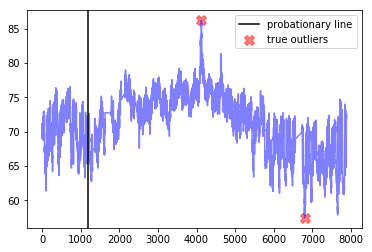




--- all_data_gift_certificates ---
Corresponding window precision:  0.5
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [4964, 6506]


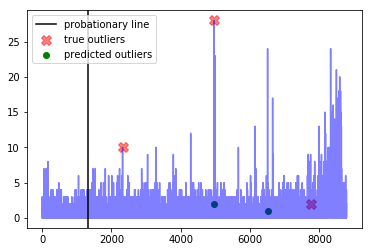




--- nyc_taxi ---
Corresponding window precision:  1.0
Corresponding window recall:  0.2
Corresponding window false positives:  0
Corresponding window false negatives:  4


Outlier indices as determined by best window threshold:  [5955, 5956]


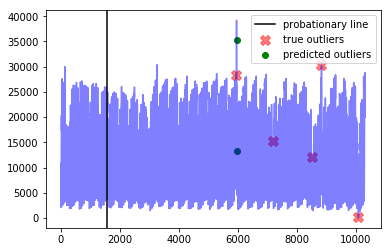




--- exchange-2_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  0.5
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [978]


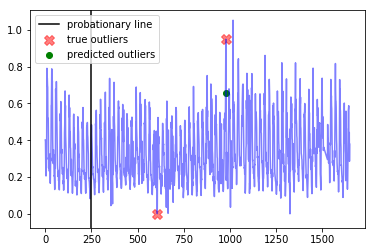




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


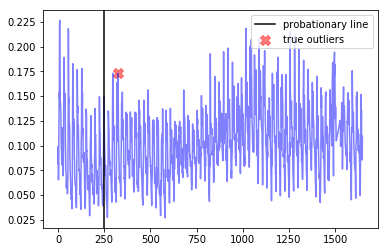




--- international-airline-passengers ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


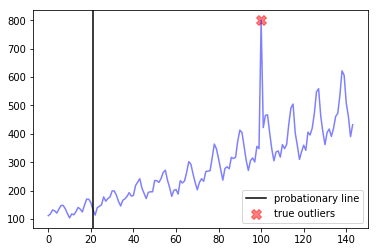




--- exchange-3_cpc_results ---
Corresponding window precision:  1.0
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [467, 468]


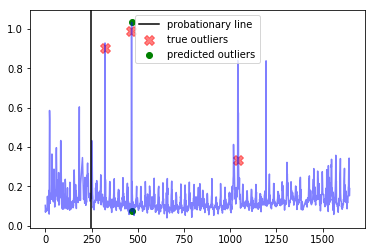

---------weight_fp=1.0, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  17.0
Best window threshold:  0.0001
Corresponding window overall precision:  0.75
Corresponding window overall recall:  0.2608695652173913
Corresponding window overall F score:  0.3870967741935483



--- elb_request_count_8c0756 ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [792, 3691]


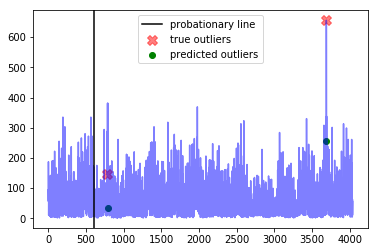




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


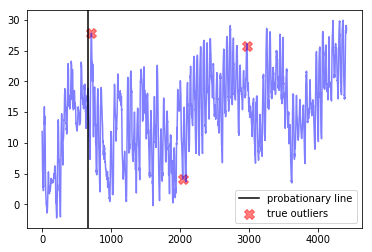




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1194, 1195]


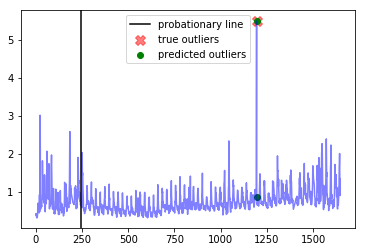




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


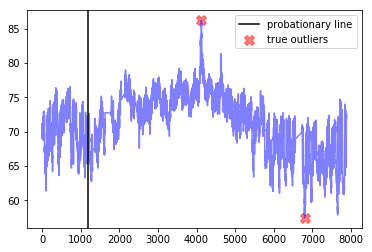




--- all_data_gift_certificates ---
Corresponding window precision:  0.5
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [4964, 6506]


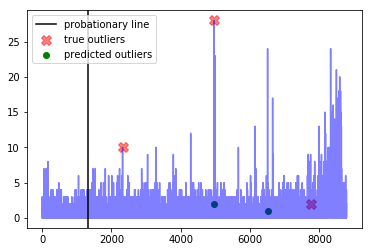




--- nyc_taxi ---
Corresponding window precision:  1.0
Corresponding window recall:  0.2
Corresponding window false positives:  0
Corresponding window false negatives:  4


Outlier indices as determined by best window threshold:  [5955, 5956]


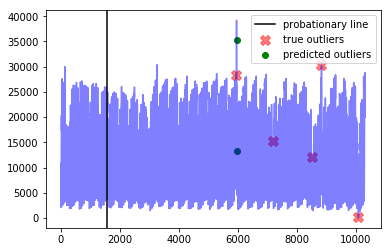




--- exchange-2_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  0.5
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [978]


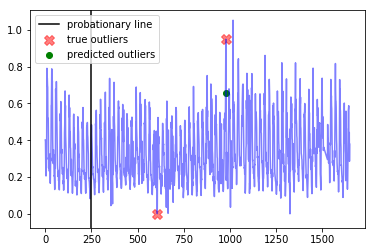




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


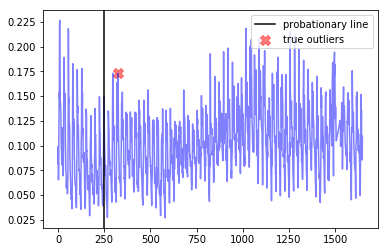




--- international-airline-passengers ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


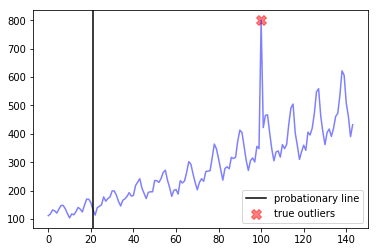




--- exchange-3_cpc_results ---
Corresponding window precision:  1.0
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [467, 468]


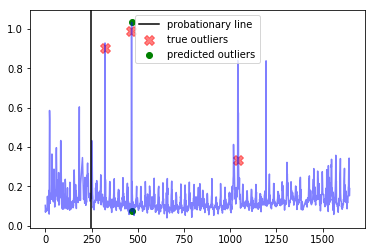

------------
False Positive Weight:  0.1
	 Minimum number of mistakes : 16.1
	 Corresponding window overall recall : 0.2608695652173913
	 Corresponding window overall precision : 0.75
	 Corresponding window overall F score : 0.3870967741935483
	 Best window threshold : 0.0001
False Positive Weight:  0.2
	 Minimum number of mistakes : 16.2
	 Corresponding window overall recall : 0.2608695652173913
	 Corresponding window overall precision : 0.75
	 Corresponding window overall F score : 0.3870967741935483
	 Best window threshold : 0.0001
False Positive Weight:  0.3
	 Minimum number of mistakes : 16.3
	 Corresponding window overall recall : 0.2608695652173913
	 Corresponding window overall precision : 0.75
	 Corresponding window overall F score : 0.3870967741935483
	 Best window threshold : 0.0001
False Positive Weight:  0.6
	 Minimum number of mistakes : 16.6
	 Corresponding window overall recall : 0.2608695652173913
	 Corresponding window overall precision : 0.75
	 Corresponding window o

In [25]:
end_results = {}
for weight_fp in weight_fp_list:  
    print("---------weight_fp=" + str(weight_fp) + ", weight_fn=1----------")
    weight_result = adclasses.pretty_print_results(ad_dict, anomaly_scores_dict, true_outlier_indices_dict, weight_fp=weight_fp, weight_fn=1)
    end_results[weight_fp] = weight_result

print("------------")
adclasses.pretty_print_end_results(end_results)

# HTM Results 

everything except for international-airline-passengers

In [26]:
htm_dataset_name_list = ["nyc_taxi",
                         "exchange-2_cpm_results",
                         "exchange-3_cpm_results",
                         "all_data_gift_certificates",
                         "elb_request_count_8c0756",
                         "FARM_Bowling-Green-5-S_Warren",
                         "exchange-2_cpc_results",
                         "exchange-3_cpc_results",
                         "ambient_temperature_system_failure"]

htm_ad_dict = {}
for dataset_name in htm_dataset_name_list:
    htm_ad_dict[dataset_name] = ad_dict[dataset_name]
    
htm_true_outlier_indices_dict = {}
for dataset_name in htm_dataset_name_list:
    htm_true_outlier_indices_dict[dataset_name] = true_outlier_indices_dict[dataset_name]

In [27]:
anomaly_scores_dict = {}

for dataset_name in htm_dataset_name_list:
    output_dict_htm = joblib.load("anomaly_scores/HTM/" + dataset_name)
    anomaly_scores_dict[dataset_name] = output_dict_htm["Anomaly Scores"]

In [28]:
adclasses.precision_recall_curve_info(anomaly_scores_dict, htm_true_outlier_indices_dict)

{0.1: {'precision': 0.2222222222222222, 'recall': 0.6666666666666666},
 0.2: {'precision': 0.5, 'recall': 0.6666666666666666},
 0.3: {'precision': 0.5, 'recall': 0.6666666666666666},
 0.4: {'precision': 0.5, 'recall': 0.3333333333333333},
 0.5: {'precision': 1.0, 'recall': 0.3333333333333333},
 0.6: {'precision': 1.0, 'recall': 0.3333333333333333},
 0.7: {'precision': 1.0, 'recall': 0.3333333333333333},
 0.8: {'precision': 0.0, 'recall': 0.0},
 0.9: {'precision': 0.0, 'recall': 0.0},
 1.0: {'precision': 0.0, 'recall': 0.0}}

---------weight_fp=0.1, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  8.400000000000002
Best window threshold:  0.4663
Corresponding window overall precision:  0.3902439024390244
Corresponding window overall recall:  0.7619047619047619
Corresponding window overall F score:  0.5161290322580646



--- elb_request_count_8c0756 ---
Corresponding window precision:  0.5
Corresponding window recall:  1.0
Corresponding window false positives:  2
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [787, 1407, 1979, 1983, 3668, 3692, 3768]


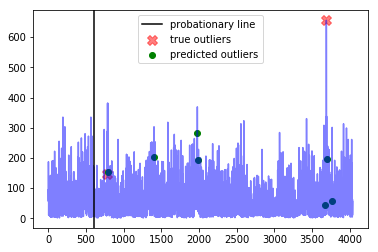




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.5
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [713, 2303]


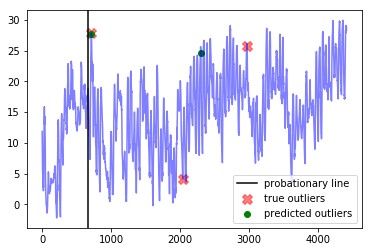




--- exchange-3_cpm_results ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  1.0
Corresponding window false positives:  2
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1046, 1049, 1050, 1193, 1532, 1554, 1574, 1575, 1576, 1577, 1578]


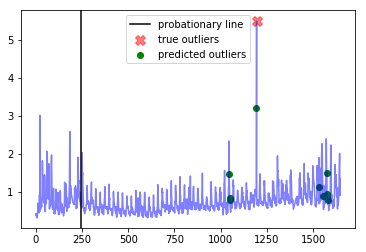




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.4
Corresponding window recall:  1.0
Corresponding window false positives:  3
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [2039, 2156, 3556, 4101, 4123, 6792, 6793, 6794, 7657]


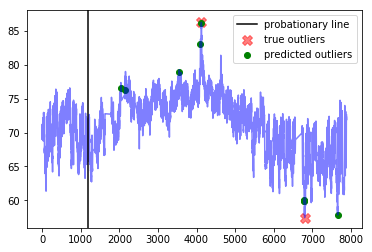




--- all_data_gift_certificates ---
Corresponding window precision:  0.23076923076923078
Corresponding window recall:  1.0
Corresponding window false positives:  10
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [2321, 2872, 3043, 4287, 4962, 4987, 5663, 6138, 6506, 6651, 6670, 7680, 7687, 7872, 7986, 8016, 8065, 8157, 8180, 8324, 8346, 8347, 8376, 8378, 8598]


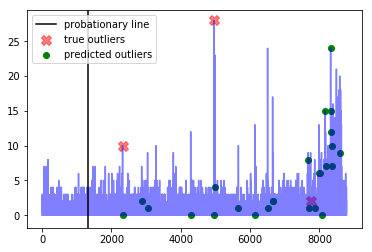




--- nyc_taxi ---
Corresponding window precision:  0.7142857142857143
Corresponding window recall:  1.0
Corresponding window false positives:  2
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [3250, 3251, 3263, 5929, 5955, 7193, 7608, 8523, 8835, 10062, 10105]


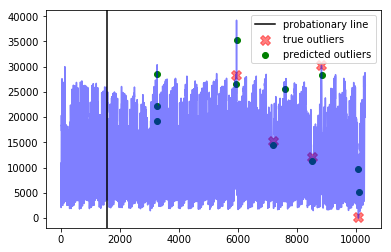




--- exchange-2_cpm_results ---
Corresponding window precision:  0.5
Corresponding window recall:  0.5
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [979, 986, 1105]


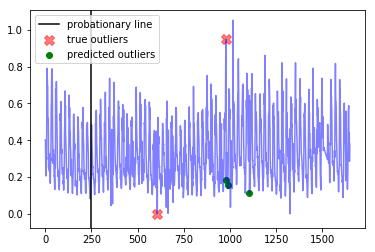




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  3
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [654, 655, 656, 1046, 1486]


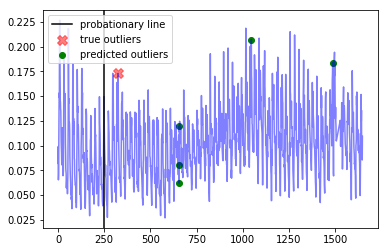




--- exchange-3_cpc_results ---
Corresponding window precision:  1.0
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [1022, 1023, 1043]


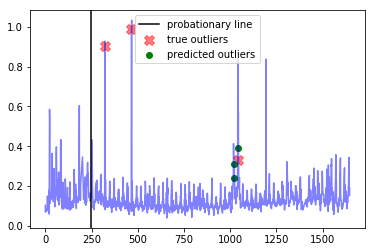

---------weight_fp=0.2, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  10.8
Best window threshold:  0.4663
Corresponding window overall precision:  0.3902439024390244
Corresponding window overall recall:  0.7619047619047619
Corresponding window overall F score:  0.5161290322580646



--- elb_request_count_8c0756 ---
Corresponding window precision:  0.5
Corresponding window recall:  1.0
Corresponding window false positives:  2
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [787, 1407, 1979, 1983, 3668, 3692, 3768]


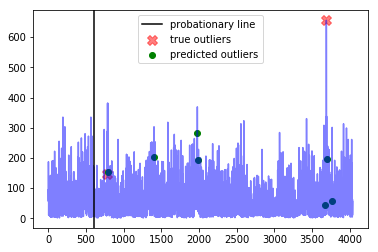




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.5
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [713, 2303]


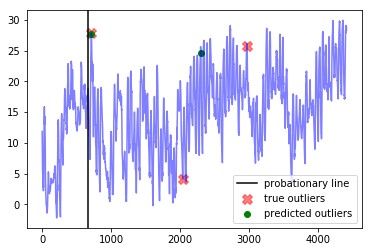




--- exchange-3_cpm_results ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  1.0
Corresponding window false positives:  2
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1046, 1049, 1050, 1193, 1532, 1554, 1574, 1575, 1576, 1577, 1578]


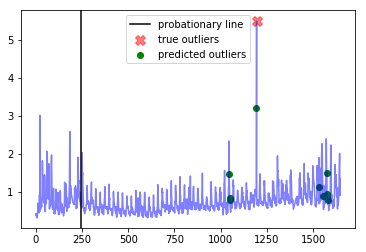




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.4
Corresponding window recall:  1.0
Corresponding window false positives:  3
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [2039, 2156, 3556, 4101, 4123, 6792, 6793, 6794, 7657]


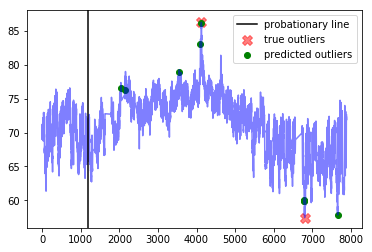




--- all_data_gift_certificates ---
Corresponding window precision:  0.23076923076923078
Corresponding window recall:  1.0
Corresponding window false positives:  10
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [2321, 2872, 3043, 4287, 4962, 4987, 5663, 6138, 6506, 6651, 6670, 7680, 7687, 7872, 7986, 8016, 8065, 8157, 8180, 8324, 8346, 8347, 8376, 8378, 8598]


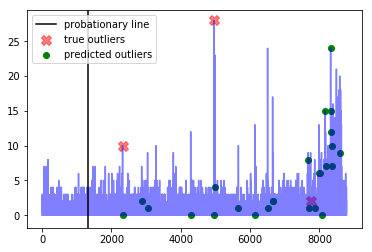




--- nyc_taxi ---
Corresponding window precision:  0.7142857142857143
Corresponding window recall:  1.0
Corresponding window false positives:  2
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [3250, 3251, 3263, 5929, 5955, 7193, 7608, 8523, 8835, 10062, 10105]


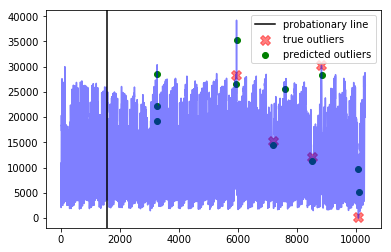




--- exchange-2_cpm_results ---
Corresponding window precision:  0.5
Corresponding window recall:  0.5
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [979, 986, 1105]


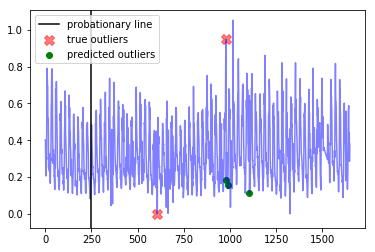




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  3
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [654, 655, 656, 1046, 1486]


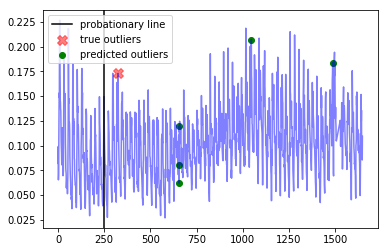




--- exchange-3_cpc_results ---
Corresponding window precision:  1.0
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [1022, 1023, 1043]


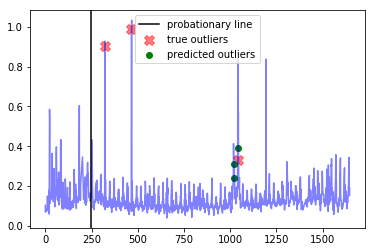

---------weight_fp=0.3, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  13.200000000000001
Best window threshold:  0.4663
Corresponding window overall precision:  0.3902439024390244
Corresponding window overall recall:  0.7619047619047619
Corresponding window overall F score:  0.5161290322580646



--- elb_request_count_8c0756 ---
Corresponding window precision:  0.5
Corresponding window recall:  1.0
Corresponding window false positives:  2
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [787, 1407, 1979, 1983, 3668, 3692, 3768]


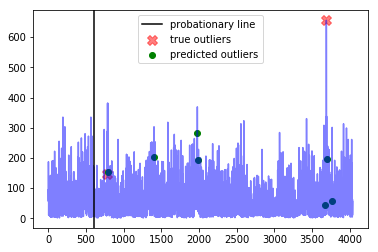




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.5
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [713, 2303]


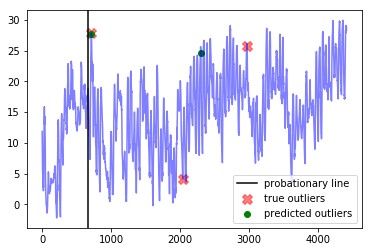




--- exchange-3_cpm_results ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  1.0
Corresponding window false positives:  2
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1046, 1049, 1050, 1193, 1532, 1554, 1574, 1575, 1576, 1577, 1578]


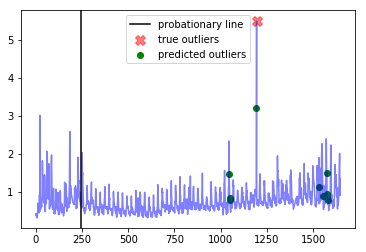




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.4
Corresponding window recall:  1.0
Corresponding window false positives:  3
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [2039, 2156, 3556, 4101, 4123, 6792, 6793, 6794, 7657]


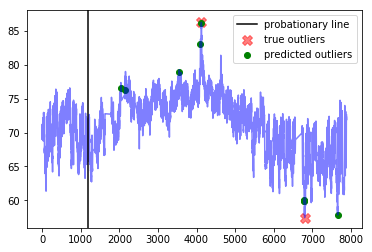




--- all_data_gift_certificates ---
Corresponding window precision:  0.23076923076923078
Corresponding window recall:  1.0
Corresponding window false positives:  10
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [2321, 2872, 3043, 4287, 4962, 4987, 5663, 6138, 6506, 6651, 6670, 7680, 7687, 7872, 7986, 8016, 8065, 8157, 8180, 8324, 8346, 8347, 8376, 8378, 8598]


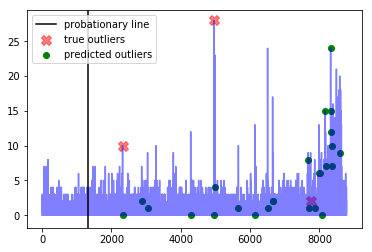




--- nyc_taxi ---
Corresponding window precision:  0.7142857142857143
Corresponding window recall:  1.0
Corresponding window false positives:  2
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [3250, 3251, 3263, 5929, 5955, 7193, 7608, 8523, 8835, 10062, 10105]


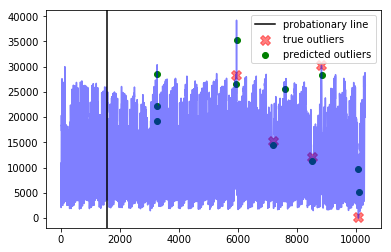




--- exchange-2_cpm_results ---
Corresponding window precision:  0.5
Corresponding window recall:  0.5
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [979, 986, 1105]


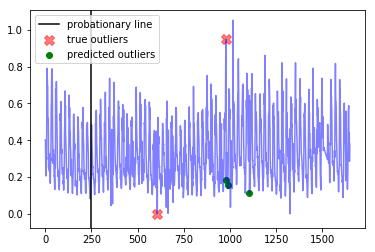




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  3
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [654, 655, 656, 1046, 1486]


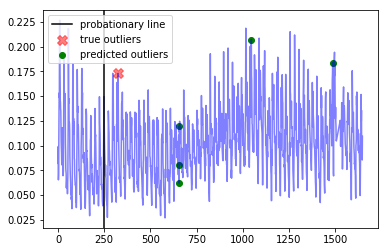




--- exchange-3_cpc_results ---
Corresponding window precision:  1.0
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [1022, 1023, 1043]


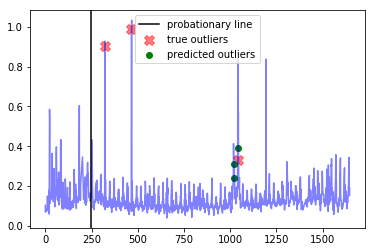

---------weight_fp=0.4, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  15.600000000000001
Best window threshold:  0.4663
Corresponding window overall precision:  0.3902439024390244
Corresponding window overall recall:  0.7619047619047619
Corresponding window overall F score:  0.5161290322580646



--- elb_request_count_8c0756 ---
Corresponding window precision:  0.5
Corresponding window recall:  1.0
Corresponding window false positives:  2
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [787, 1407, 1979, 1983, 3668, 3692, 3768]


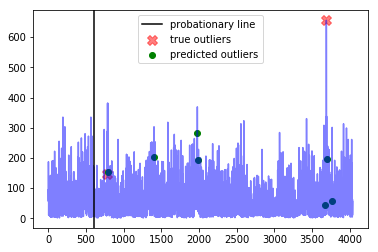




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.5
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [713, 2303]


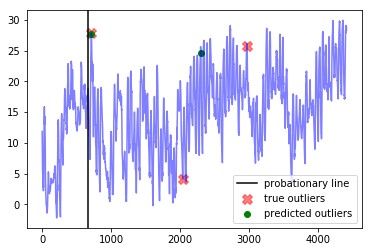




--- exchange-3_cpm_results ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  1.0
Corresponding window false positives:  2
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1046, 1049, 1050, 1193, 1532, 1554, 1574, 1575, 1576, 1577, 1578]


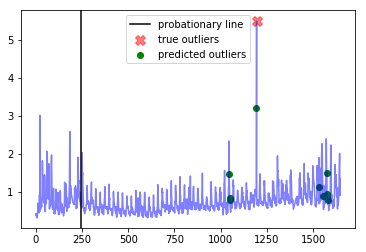




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.4
Corresponding window recall:  1.0
Corresponding window false positives:  3
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [2039, 2156, 3556, 4101, 4123, 6792, 6793, 6794, 7657]


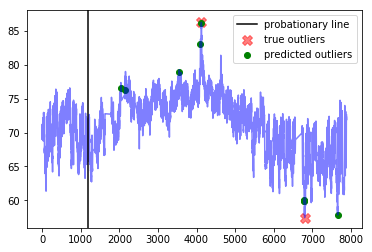




--- all_data_gift_certificates ---
Corresponding window precision:  0.23076923076923078
Corresponding window recall:  1.0
Corresponding window false positives:  10
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [2321, 2872, 3043, 4287, 4962, 4987, 5663, 6138, 6506, 6651, 6670, 7680, 7687, 7872, 7986, 8016, 8065, 8157, 8180, 8324, 8346, 8347, 8376, 8378, 8598]


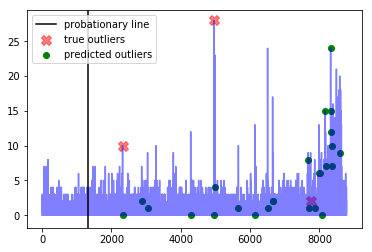




--- nyc_taxi ---
Corresponding window precision:  0.7142857142857143
Corresponding window recall:  1.0
Corresponding window false positives:  2
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [3250, 3251, 3263, 5929, 5955, 7193, 7608, 8523, 8835, 10062, 10105]


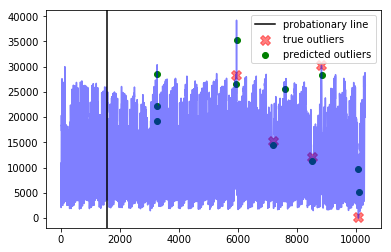




--- exchange-2_cpm_results ---
Corresponding window precision:  0.5
Corresponding window recall:  0.5
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [979, 986, 1105]


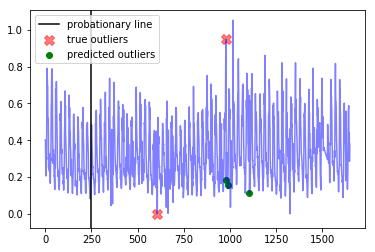




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  3
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [654, 655, 656, 1046, 1486]


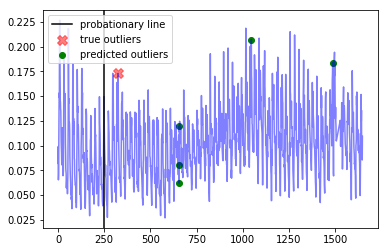




--- exchange-3_cpc_results ---
Corresponding window precision:  1.0
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [1022, 1023, 1043]


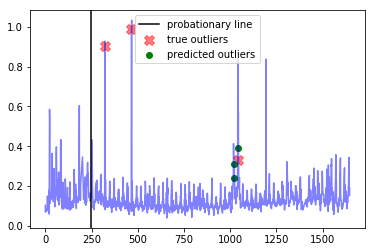

---------weight_fp=0.5, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  18.0
Best window threshold:  0.4663
Corresponding window overall precision:  0.3902439024390244
Corresponding window overall recall:  0.7619047619047619
Corresponding window overall F score:  0.5161290322580646



--- elb_request_count_8c0756 ---
Corresponding window precision:  0.5
Corresponding window recall:  1.0
Corresponding window false positives:  2
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [787, 1407, 1979, 1983, 3668, 3692, 3768]


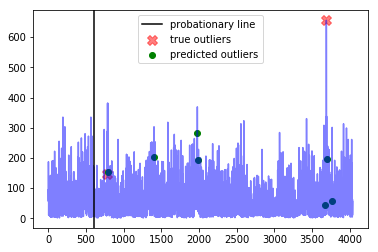




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.5
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [713, 2303]


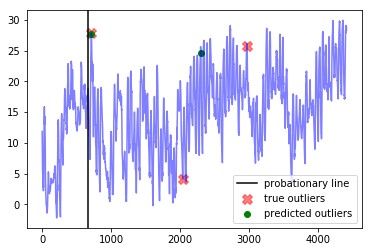




--- exchange-3_cpm_results ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  1.0
Corresponding window false positives:  2
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1046, 1049, 1050, 1193, 1532, 1554, 1574, 1575, 1576, 1577, 1578]


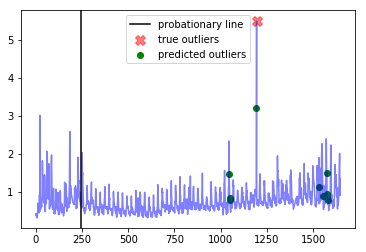




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.4
Corresponding window recall:  1.0
Corresponding window false positives:  3
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [2039, 2156, 3556, 4101, 4123, 6792, 6793, 6794, 7657]


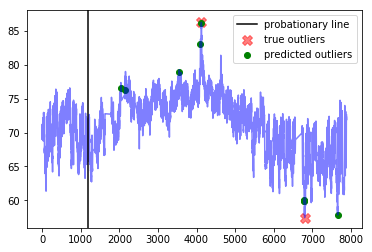




--- all_data_gift_certificates ---
Corresponding window precision:  0.23076923076923078
Corresponding window recall:  1.0
Corresponding window false positives:  10
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [2321, 2872, 3043, 4287, 4962, 4987, 5663, 6138, 6506, 6651, 6670, 7680, 7687, 7872, 7986, 8016, 8065, 8157, 8180, 8324, 8346, 8347, 8376, 8378, 8598]


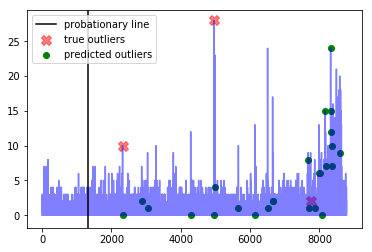




--- nyc_taxi ---
Corresponding window precision:  0.7142857142857143
Corresponding window recall:  1.0
Corresponding window false positives:  2
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [3250, 3251, 3263, 5929, 5955, 7193, 7608, 8523, 8835, 10062, 10105]


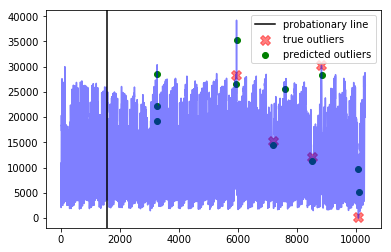




--- exchange-2_cpm_results ---
Corresponding window precision:  0.5
Corresponding window recall:  0.5
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [979, 986, 1105]


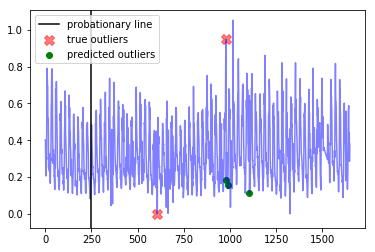




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  3
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [654, 655, 656, 1046, 1486]


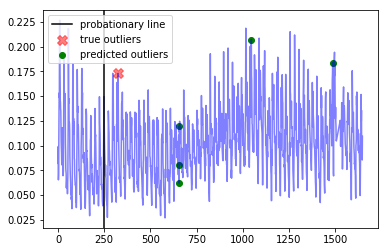




--- exchange-3_cpc_results ---
Corresponding window precision:  1.0
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [1022, 1023, 1043]


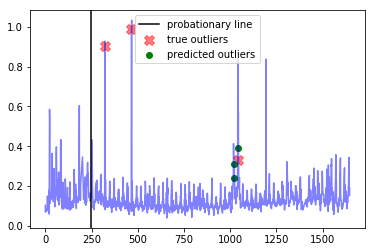

---------weight_fp=0.6, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  19.6
Best window threshold:  0.8455
Corresponding window overall precision:  0.75
Corresponding window overall recall:  0.14285714285714285
Corresponding window overall F score:  0.24



--- elb_request_count_8c0756 ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


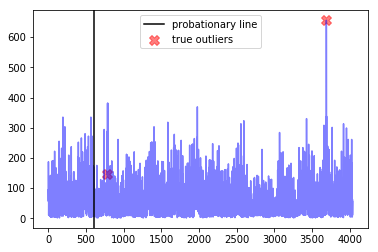




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


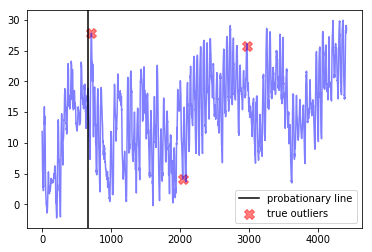




--- exchange-3_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


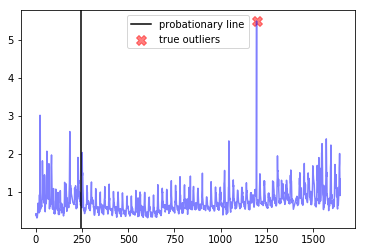




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


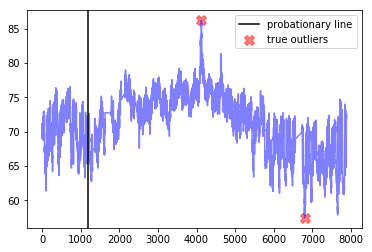




--- all_data_gift_certificates ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


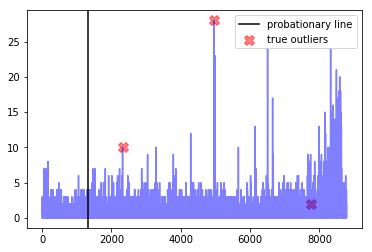




--- nyc_taxi ---
Corresponding window precision:  0.75
Corresponding window recall:  0.6
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [5955, 7608, 8523, 8835]


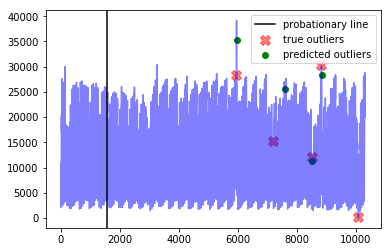




--- exchange-2_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


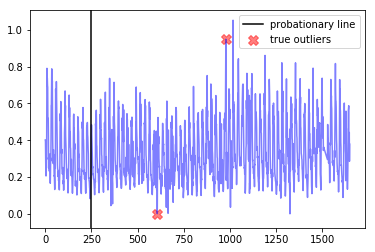




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


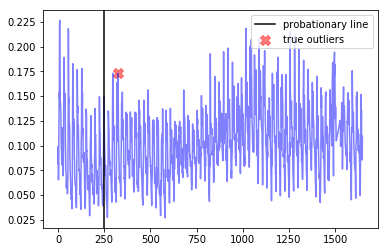




--- exchange-3_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


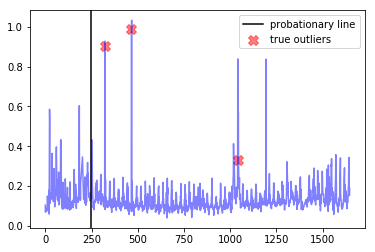

---------weight_fp=0.7, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  19.7
Best window threshold:  0.8455
Corresponding window overall precision:  0.75
Corresponding window overall recall:  0.14285714285714285
Corresponding window overall F score:  0.24



--- elb_request_count_8c0756 ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


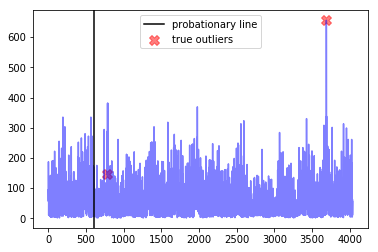




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


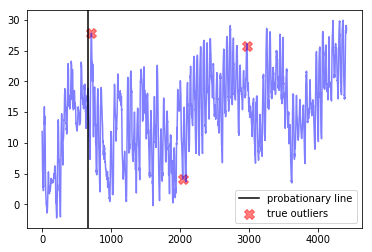




--- exchange-3_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


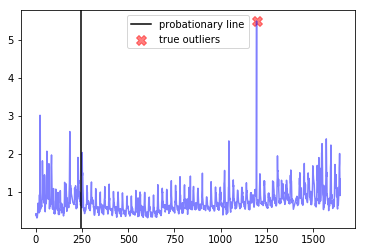




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


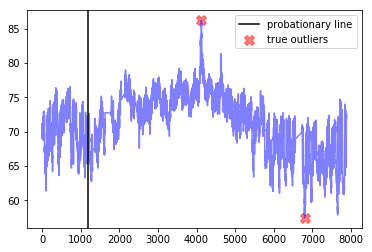




--- all_data_gift_certificates ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


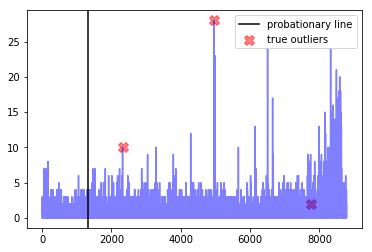




--- nyc_taxi ---
Corresponding window precision:  0.75
Corresponding window recall:  0.6
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [5955, 7608, 8523, 8835]


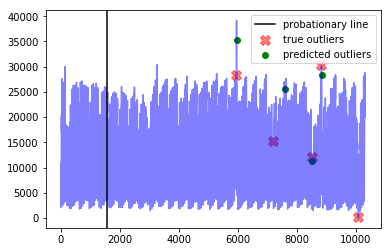




--- exchange-2_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


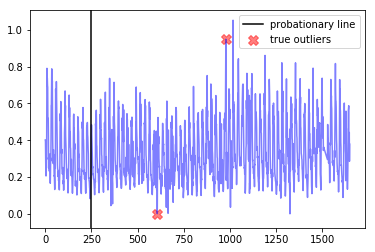




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


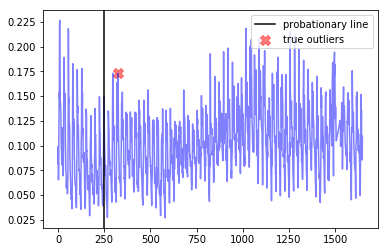




--- exchange-3_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


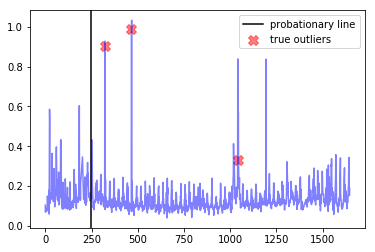

---------weight_fp=0.8, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  19.8
Best window threshold:  0.8455
Corresponding window overall precision:  0.75
Corresponding window overall recall:  0.14285714285714285
Corresponding window overall F score:  0.24



--- elb_request_count_8c0756 ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


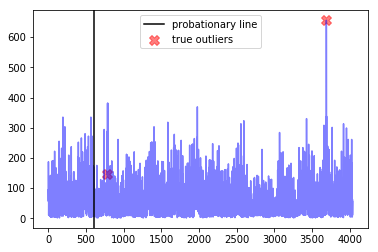




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


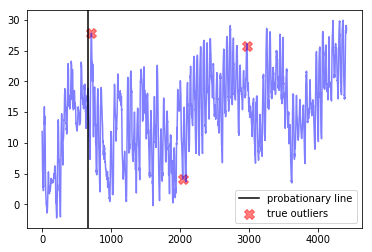




--- exchange-3_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


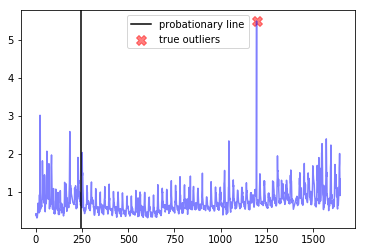




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


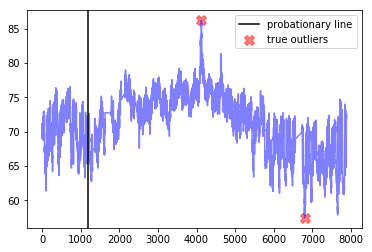




--- all_data_gift_certificates ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


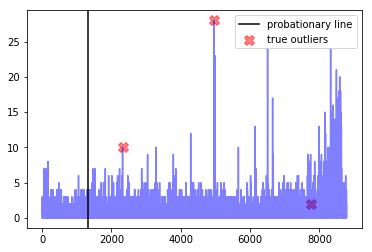




--- nyc_taxi ---
Corresponding window precision:  0.75
Corresponding window recall:  0.6
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [5955, 7608, 8523, 8835]


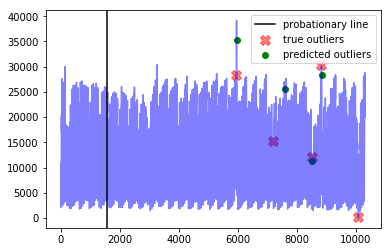




--- exchange-2_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


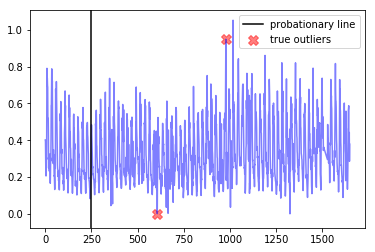




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


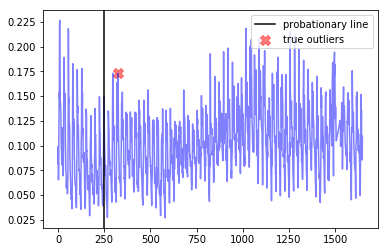




--- exchange-3_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


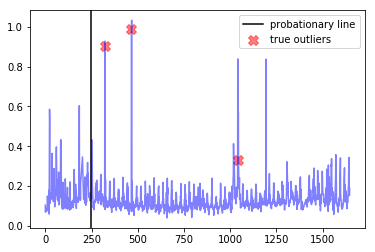

---------weight_fp=0.9, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  19.9
Best window threshold:  0.8455
Corresponding window overall precision:  0.75
Corresponding window overall recall:  0.14285714285714285
Corresponding window overall F score:  0.24



--- elb_request_count_8c0756 ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


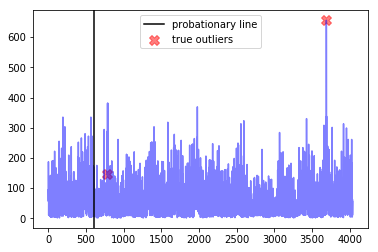




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


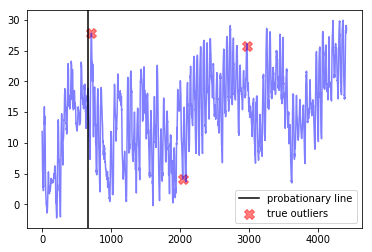




--- exchange-3_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


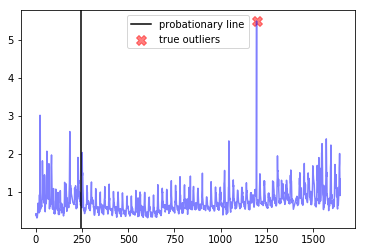




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


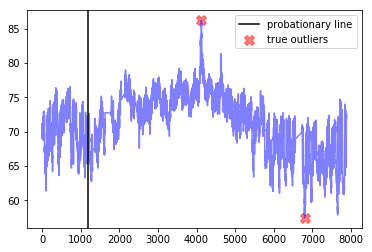




--- all_data_gift_certificates ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


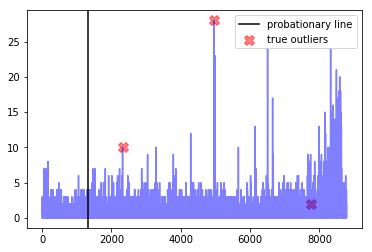




--- nyc_taxi ---
Corresponding window precision:  0.75
Corresponding window recall:  0.6
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [5955, 7608, 8523, 8835]


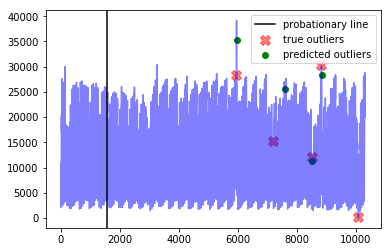




--- exchange-2_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


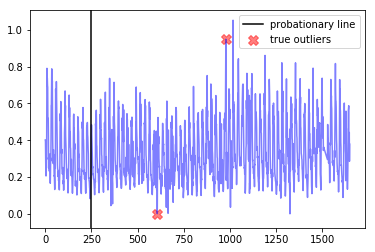




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


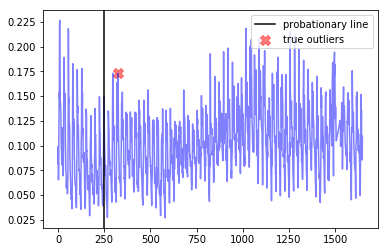




--- exchange-3_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


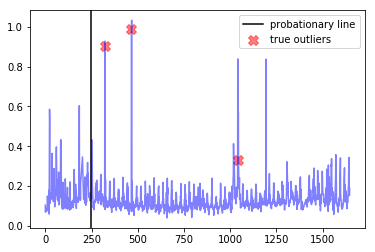

---------weight_fp=1.0, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  20.0
Best window threshold:  0.8455
Corresponding window overall precision:  0.75
Corresponding window overall recall:  0.14285714285714285
Corresponding window overall F score:  0.24



--- elb_request_count_8c0756 ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


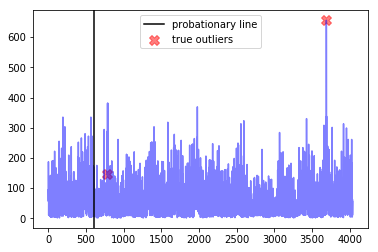




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


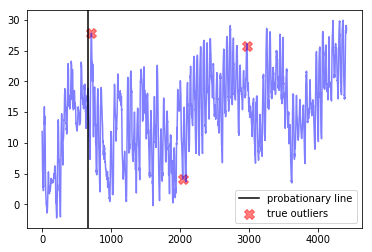




--- exchange-3_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


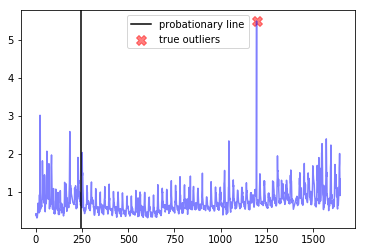




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


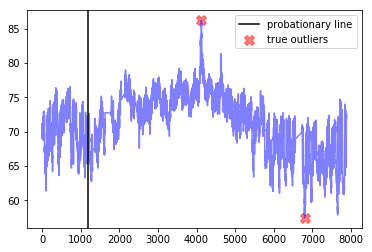




--- all_data_gift_certificates ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


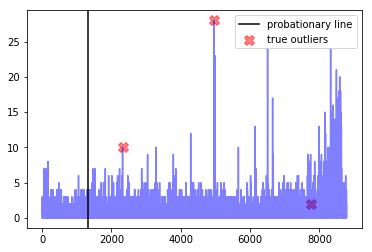




--- nyc_taxi ---
Corresponding window precision:  0.75
Corresponding window recall:  0.6
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [5955, 7608, 8523, 8835]


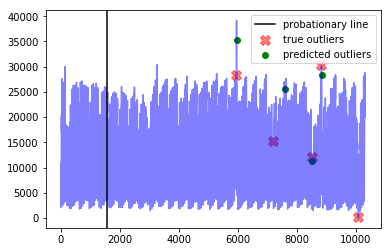




--- exchange-2_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


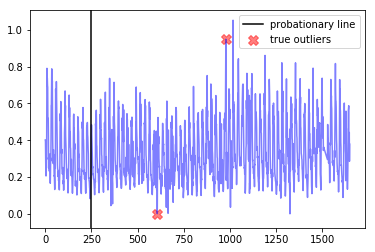




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


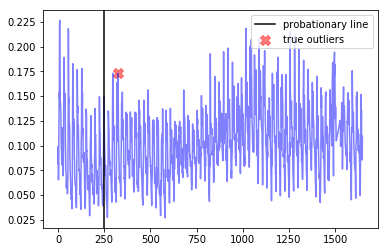




--- exchange-3_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


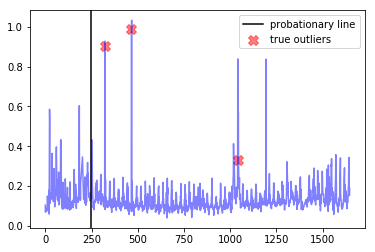

------------
False Positive Weight:  0.1
	 Minimum number of mistakes : 8.400000000000002
	 Corresponding window overall recall : 0.7619047619047619
	 Corresponding window overall precision : 0.3902439024390244
	 Corresponding window overall F score : 0.5161290322580646
	 Best window threshold : 0.4663
False Positive Weight:  0.2
	 Minimum number of mistakes : 10.8
	 Corresponding window overall recall : 0.7619047619047619
	 Corresponding window overall precision : 0.3902439024390244
	 Corresponding window overall F score : 0.5161290322580646
	 Best window threshold : 0.4663
False Positive Weight:  0.3
	 Minimum number of mistakes : 13.200000000000001
	 Corresponding window overall recall : 0.7619047619047619
	 Corresponding window overall precision : 0.3902439024390244
	 Corresponding window overall F score : 0.5161290322580646
	 Best window threshold : 0.4663
False Positive Weight:  0.6
	 Minimum number of mistakes : 19.6
	 Corresponding window overall recall : 0.14285714285714285
	 

In [29]:
end_results = {}
for weight_fp in weight_fp_list:  
    print("---------weight_fp=" + str(weight_fp) + ", weight_fn=1----------")
    weight_result = adclasses.pretty_print_results(htm_ad_dict, anomaly_scores_dict, htm_true_outlier_indices_dict, weight_fp=weight_fp, weight_fn=1)
    end_results[weight_fp] = weight_result

print("------------")
adclasses.pretty_print_end_results(end_results)

# Donut Results

everything except for international-airline-passengers

In [30]:
donut_dataset_name_list = ["nyc_taxi",
                           "exchange-2_cpm_results",
                           "exchange-3_cpm_results",
                           "all_data_gift_certificates",
                           "elb_request_count_8c0756",
                           "FARM_Bowling-Green-5-S_Warren",
                           "exchange-2_cpc_results",
                           "exchange-3_cpc_results",
                           "ambient_temperature_system_failure"]

donut_ad_dict = {}
for dataset_name in donut_dataset_name_list:
    donut_ad_dict[dataset_name] = ad_dict[dataset_name]
    
donut_true_outlier_indices_dict = {}
for dataset_name in donut_dataset_name_list:
    donut_true_outlier_indices_dict[dataset_name] = true_outlier_indices_dict[dataset_name]

In [31]:
anomaly_scores_dict = {}

for dataset_name in donut_dataset_name_list:
    output_dict_htm = joblib.load("anomaly_scores/Donut/" + dataset_name)
    anomaly_scores_dict[dataset_name] = output_dict_htm["Anomaly Scores"]

In [32]:
adclasses.precision_recall_curve_info(anomaly_scores_dict, donut_true_outlier_indices_dict)

{0.1: {'precision': 0.11538461538461539, 'recall': 1.0},
 0.2: {'precision': 0.11538461538461539, 'recall': 1.0},
 0.3: {'precision': 0.11538461538461539, 'recall': 1.0},
 0.4: {'precision': 0.11538461538461539, 'recall': 1.0},
 0.5: {'precision': 0.11538461538461539, 'recall': 1.0},
 0.6: {'precision': 0.3333333333333333, 'recall': 1.0},
 0.7: {'precision': 0.42857142857142855, 'recall': 1.0},
 0.8: {'precision': 0.42857142857142855, 'recall': 1.0},
 0.9: {'precision': 0.6, 'recall': 1.0},
 1.0: {'precision': 0.75, 'recall': 1.0}}

---------weight_fp=0.1, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  11.2
Best window threshold:  1.0
Corresponding window overall precision:  0.3076923076923077
Corresponding window overall recall:  0.5714285714285714
Corresponding window overall F score:  0.4



--- elb_request_count_8c0756 ---
Corresponding window precision:  0.2857142857142857
Corresponding window recall:  1.0
Corresponding window false positives:  5
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [786, 791, 1586, 1978, 2556, 2595, 3069, 3427, 3658, 3690, 3693]


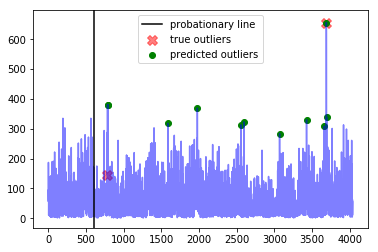




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


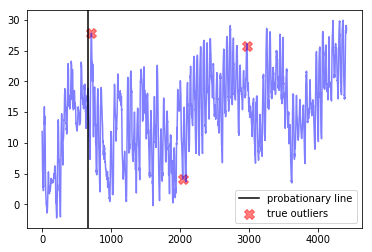




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1193, 1194]


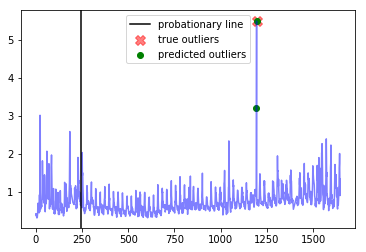




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.6666666666666666
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [4100, 4101, 4102, 4103, 4104, 4105, 4106, 4107, 4108, 4109, 4110, 4112, 4113, 4120, 4121, 4122, 4123, 4124, 4125, 4126, 4127, 4128, 4129, 4131, 5905, 5906, 5907, 5908, 5909, 5910, 5911, 5912, 5913, 6798]


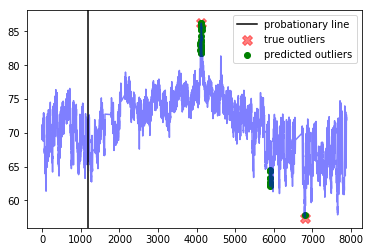




--- all_data_gift_certificates ---
Corresponding window precision:  0.2
Corresponding window recall:  1.0
Corresponding window false positives:  12
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1423, 1518, 1521, 1615, 2320, 2791, 2871, 2886, 3029, 3053, 3059, 3123, 3196, 3340, 4253, 4286, 4963, 4986, 4998, 5000, 5020, 5049, 5072, 6137, 6505, 6517, 6650, 6707, 7760, 7782, 7881, 7997, 8001, 8021, 8022, 8023, 8027, 8048, 8071, 8072, 8073, 8074, 8075, 8094, 8096, 8097, 8098, 8099, 8168, 8191, 8192, 8193, 8216, 8240, 8241, 8264, 8265, 8287, 8288, 8289, 8290, 8311, 8313, 8335, 8336, 8337, 8338, 8339, 8358, 8359, 8360, 8361, 8362, 8363, 8382, 8383, 8384, 8385, 8386, 8387, 8388, 8405, 8406, 8407, 8408, 8409, 8410, 8411, 8504, 8505, 8528, 8529, 8552, 8553, 8575, 8576, 8577, 8598, 8599, 8600, 8601, 8623, 8624]


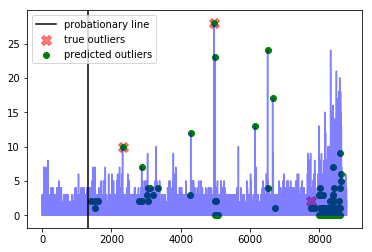




--- nyc_taxi ---
Corresponding window precision:  0.5
Corresponding window recall:  0.2
Corresponding window false positives:  1
Corresponding window false negatives:  4


Outlier indices as determined by best window threshold:  [3582, 3583, 10064, 10065, 10066, 10067, 10097, 10098, 10099, 10100, 10101, 10102, 10103, 10104, 10105, 10106, 10107, 10108, 10109]


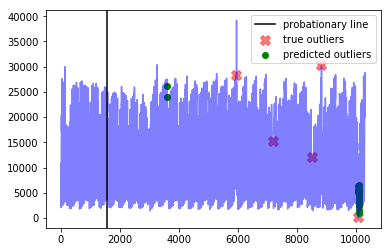




--- exchange-2_cpm_results ---
Corresponding window precision:  0.5
Corresponding window recall:  0.5
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [977, 1016, 1045]


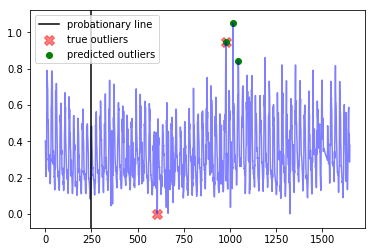




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [1016, 1046, 1088]


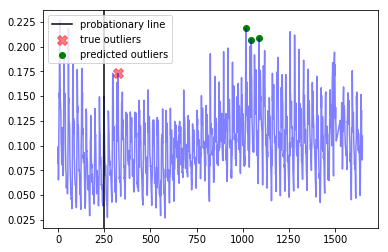




--- exchange-3_cpc_results ---
Corresponding window precision:  0.75
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [322, 323, 466, 467, 1041, 1194]


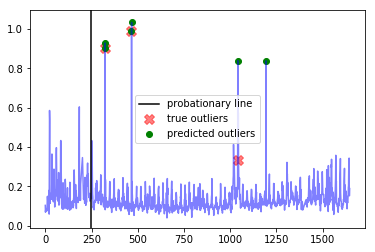

---------weight_fp=0.2, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  13.399999999999999
Best window threshold:  1.0
Corresponding window overall precision:  0.3076923076923077
Corresponding window overall recall:  0.5714285714285714
Corresponding window overall F score:  0.4



--- elb_request_count_8c0756 ---
Corresponding window precision:  0.2857142857142857
Corresponding window recall:  1.0
Corresponding window false positives:  5
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [786, 791, 1586, 1978, 2556, 2595, 3069, 3427, 3658, 3690, 3693]


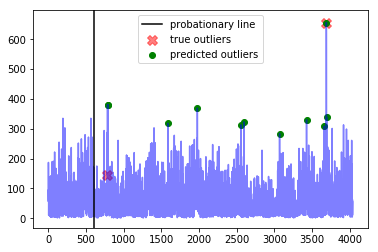




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


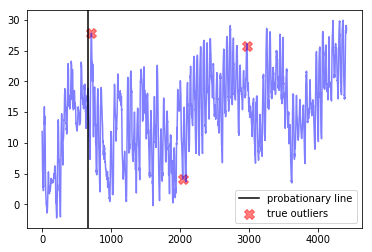




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1193, 1194]


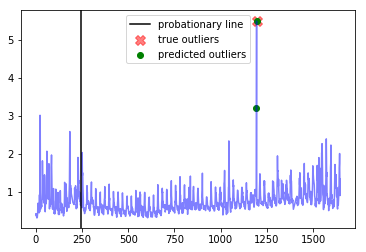




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.6666666666666666
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [4100, 4101, 4102, 4103, 4104, 4105, 4106, 4107, 4108, 4109, 4110, 4112, 4113, 4120, 4121, 4122, 4123, 4124, 4125, 4126, 4127, 4128, 4129, 4131, 5905, 5906, 5907, 5908, 5909, 5910, 5911, 5912, 5913, 6798]


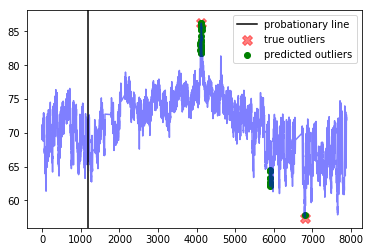




--- all_data_gift_certificates ---
Corresponding window precision:  0.2
Corresponding window recall:  1.0
Corresponding window false positives:  12
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1423, 1518, 1521, 1615, 2320, 2791, 2871, 2886, 3029, 3053, 3059, 3123, 3196, 3340, 4253, 4286, 4963, 4986, 4998, 5000, 5020, 5049, 5072, 6137, 6505, 6517, 6650, 6707, 7760, 7782, 7881, 7997, 8001, 8021, 8022, 8023, 8027, 8048, 8071, 8072, 8073, 8074, 8075, 8094, 8096, 8097, 8098, 8099, 8168, 8191, 8192, 8193, 8216, 8240, 8241, 8264, 8265, 8287, 8288, 8289, 8290, 8311, 8313, 8335, 8336, 8337, 8338, 8339, 8358, 8359, 8360, 8361, 8362, 8363, 8382, 8383, 8384, 8385, 8386, 8387, 8388, 8405, 8406, 8407, 8408, 8409, 8410, 8411, 8504, 8505, 8528, 8529, 8552, 8553, 8575, 8576, 8577, 8598, 8599, 8600, 8601, 8623, 8624]


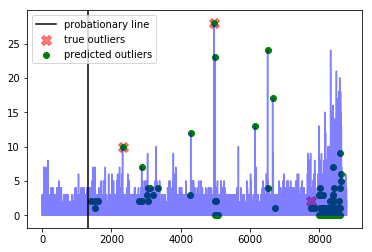




--- nyc_taxi ---
Corresponding window precision:  0.5
Corresponding window recall:  0.2
Corresponding window false positives:  1
Corresponding window false negatives:  4


Outlier indices as determined by best window threshold:  [3582, 3583, 10064, 10065, 10066, 10067, 10097, 10098, 10099, 10100, 10101, 10102, 10103, 10104, 10105, 10106, 10107, 10108, 10109]


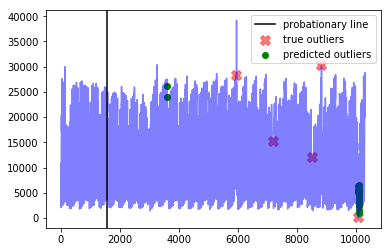




--- exchange-2_cpm_results ---
Corresponding window precision:  0.5
Corresponding window recall:  0.5
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [977, 1016, 1045]


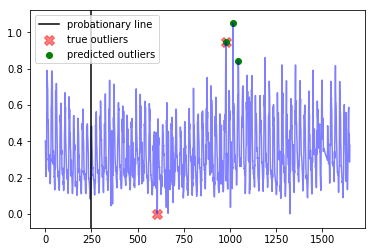




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [1016, 1046, 1088]


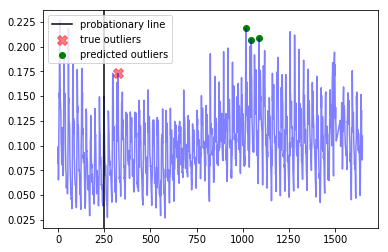




--- exchange-3_cpc_results ---
Corresponding window precision:  0.75
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [322, 323, 466, 467, 1041, 1194]


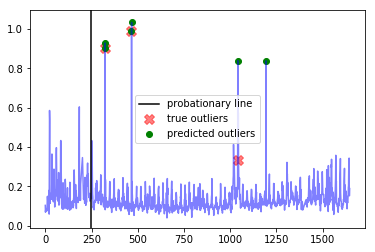

---------weight_fp=0.3, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  15.600000000000001
Best window threshold:  1.0
Corresponding window overall precision:  0.3076923076923077
Corresponding window overall recall:  0.5714285714285714
Corresponding window overall F score:  0.4



--- elb_request_count_8c0756 ---
Corresponding window precision:  0.2857142857142857
Corresponding window recall:  1.0
Corresponding window false positives:  5
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [786, 791, 1586, 1978, 2556, 2595, 3069, 3427, 3658, 3690, 3693]


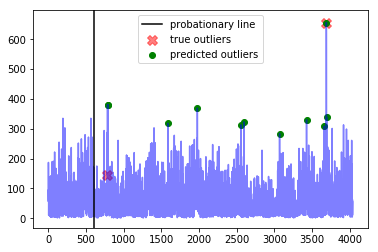




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


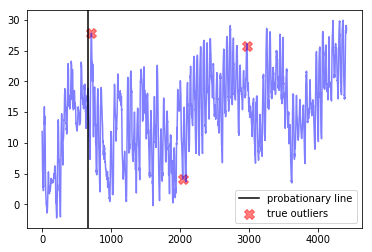




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1193, 1194]


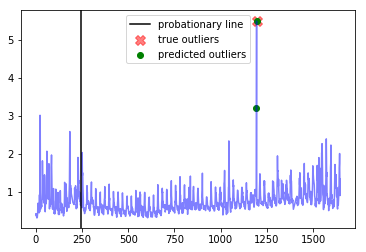




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.6666666666666666
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [4100, 4101, 4102, 4103, 4104, 4105, 4106, 4107, 4108, 4109, 4110, 4112, 4113, 4120, 4121, 4122, 4123, 4124, 4125, 4126, 4127, 4128, 4129, 4131, 5905, 5906, 5907, 5908, 5909, 5910, 5911, 5912, 5913, 6798]


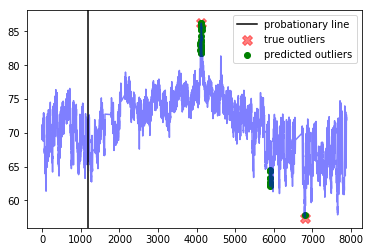




--- all_data_gift_certificates ---
Corresponding window precision:  0.2
Corresponding window recall:  1.0
Corresponding window false positives:  12
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1423, 1518, 1521, 1615, 2320, 2791, 2871, 2886, 3029, 3053, 3059, 3123, 3196, 3340, 4253, 4286, 4963, 4986, 4998, 5000, 5020, 5049, 5072, 6137, 6505, 6517, 6650, 6707, 7760, 7782, 7881, 7997, 8001, 8021, 8022, 8023, 8027, 8048, 8071, 8072, 8073, 8074, 8075, 8094, 8096, 8097, 8098, 8099, 8168, 8191, 8192, 8193, 8216, 8240, 8241, 8264, 8265, 8287, 8288, 8289, 8290, 8311, 8313, 8335, 8336, 8337, 8338, 8339, 8358, 8359, 8360, 8361, 8362, 8363, 8382, 8383, 8384, 8385, 8386, 8387, 8388, 8405, 8406, 8407, 8408, 8409, 8410, 8411, 8504, 8505, 8528, 8529, 8552, 8553, 8575, 8576, 8577, 8598, 8599, 8600, 8601, 8623, 8624]


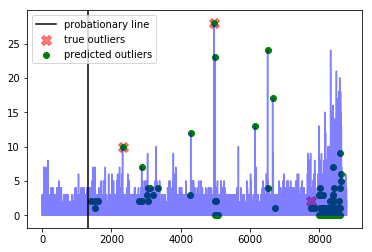




--- nyc_taxi ---
Corresponding window precision:  0.5
Corresponding window recall:  0.2
Corresponding window false positives:  1
Corresponding window false negatives:  4


Outlier indices as determined by best window threshold:  [3582, 3583, 10064, 10065, 10066, 10067, 10097, 10098, 10099, 10100, 10101, 10102, 10103, 10104, 10105, 10106, 10107, 10108, 10109]


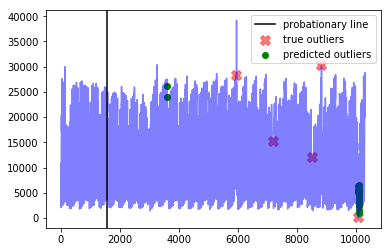




--- exchange-2_cpm_results ---
Corresponding window precision:  0.5
Corresponding window recall:  0.5
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [977, 1016, 1045]


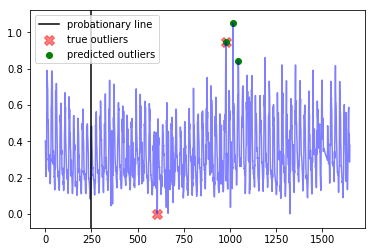




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [1016, 1046, 1088]


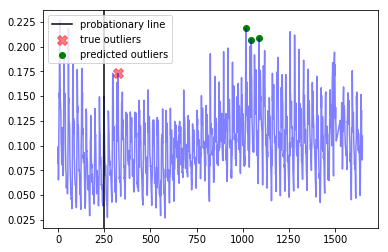




--- exchange-3_cpc_results ---
Corresponding window precision:  0.75
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [322, 323, 466, 467, 1041, 1194]


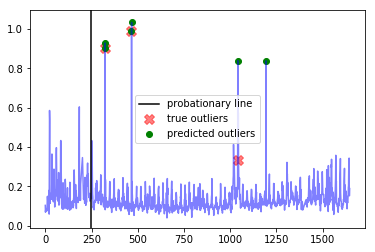

---------weight_fp=0.4, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  17.799999999999997
Best window threshold:  1.0
Corresponding window overall precision:  0.3076923076923077
Corresponding window overall recall:  0.5714285714285714
Corresponding window overall F score:  0.4



--- elb_request_count_8c0756 ---
Corresponding window precision:  0.2857142857142857
Corresponding window recall:  1.0
Corresponding window false positives:  5
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [786, 791, 1586, 1978, 2556, 2595, 3069, 3427, 3658, 3690, 3693]


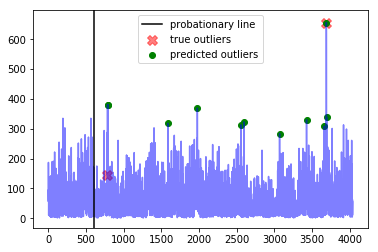




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


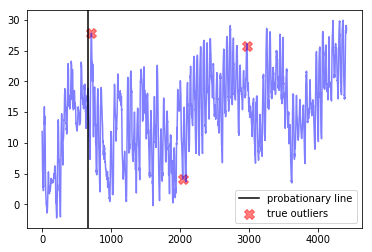




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1193, 1194]


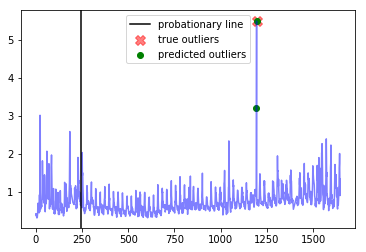




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.6666666666666666
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [4100, 4101, 4102, 4103, 4104, 4105, 4106, 4107, 4108, 4109, 4110, 4112, 4113, 4120, 4121, 4122, 4123, 4124, 4125, 4126, 4127, 4128, 4129, 4131, 5905, 5906, 5907, 5908, 5909, 5910, 5911, 5912, 5913, 6798]


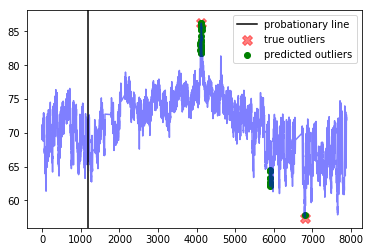




--- all_data_gift_certificates ---
Corresponding window precision:  0.2
Corresponding window recall:  1.0
Corresponding window false positives:  12
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1423, 1518, 1521, 1615, 2320, 2791, 2871, 2886, 3029, 3053, 3059, 3123, 3196, 3340, 4253, 4286, 4963, 4986, 4998, 5000, 5020, 5049, 5072, 6137, 6505, 6517, 6650, 6707, 7760, 7782, 7881, 7997, 8001, 8021, 8022, 8023, 8027, 8048, 8071, 8072, 8073, 8074, 8075, 8094, 8096, 8097, 8098, 8099, 8168, 8191, 8192, 8193, 8216, 8240, 8241, 8264, 8265, 8287, 8288, 8289, 8290, 8311, 8313, 8335, 8336, 8337, 8338, 8339, 8358, 8359, 8360, 8361, 8362, 8363, 8382, 8383, 8384, 8385, 8386, 8387, 8388, 8405, 8406, 8407, 8408, 8409, 8410, 8411, 8504, 8505, 8528, 8529, 8552, 8553, 8575, 8576, 8577, 8598, 8599, 8600, 8601, 8623, 8624]


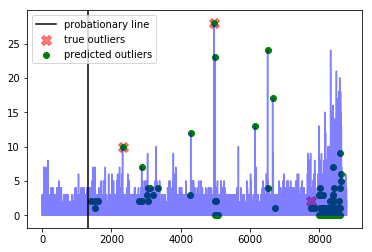




--- nyc_taxi ---
Corresponding window precision:  0.5
Corresponding window recall:  0.2
Corresponding window false positives:  1
Corresponding window false negatives:  4


Outlier indices as determined by best window threshold:  [3582, 3583, 10064, 10065, 10066, 10067, 10097, 10098, 10099, 10100, 10101, 10102, 10103, 10104, 10105, 10106, 10107, 10108, 10109]


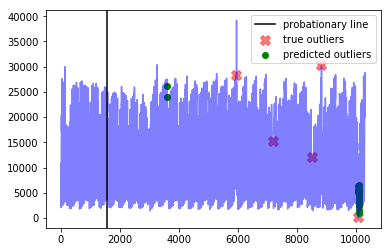




--- exchange-2_cpm_results ---
Corresponding window precision:  0.5
Corresponding window recall:  0.5
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [977, 1016, 1045]


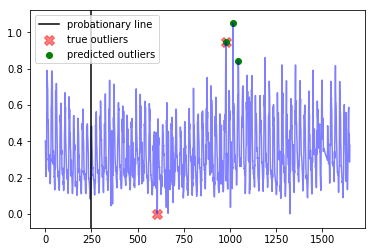




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [1016, 1046, 1088]


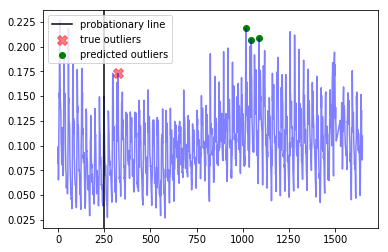




--- exchange-3_cpc_results ---
Corresponding window precision:  0.75
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [322, 323, 466, 467, 1041, 1194]


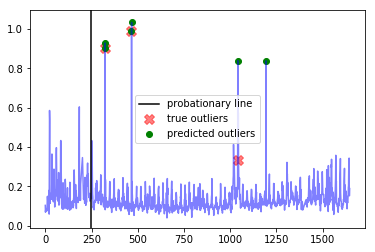

---------weight_fp=0.5, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  20.0
Best window threshold:  1.0
Corresponding window overall precision:  0.3076923076923077
Corresponding window overall recall:  0.5714285714285714
Corresponding window overall F score:  0.4



--- elb_request_count_8c0756 ---
Corresponding window precision:  0.2857142857142857
Corresponding window recall:  1.0
Corresponding window false positives:  5
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [786, 791, 1586, 1978, 2556, 2595, 3069, 3427, 3658, 3690, 3693]


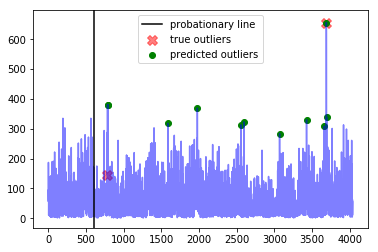




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


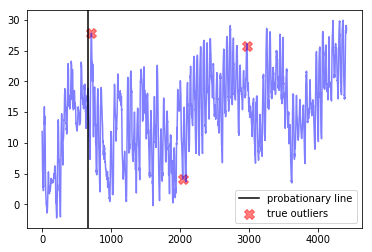




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1193, 1194]


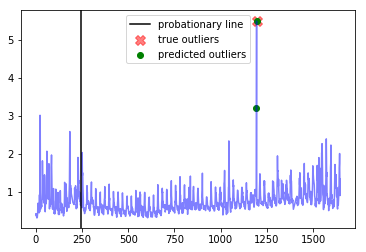




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.6666666666666666
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [4100, 4101, 4102, 4103, 4104, 4105, 4106, 4107, 4108, 4109, 4110, 4112, 4113, 4120, 4121, 4122, 4123, 4124, 4125, 4126, 4127, 4128, 4129, 4131, 5905, 5906, 5907, 5908, 5909, 5910, 5911, 5912, 5913, 6798]


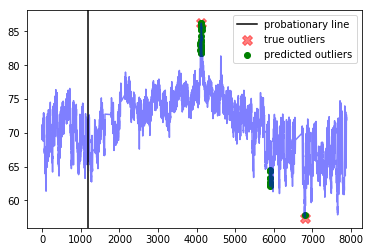




--- all_data_gift_certificates ---
Corresponding window precision:  0.2
Corresponding window recall:  1.0
Corresponding window false positives:  12
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1423, 1518, 1521, 1615, 2320, 2791, 2871, 2886, 3029, 3053, 3059, 3123, 3196, 3340, 4253, 4286, 4963, 4986, 4998, 5000, 5020, 5049, 5072, 6137, 6505, 6517, 6650, 6707, 7760, 7782, 7881, 7997, 8001, 8021, 8022, 8023, 8027, 8048, 8071, 8072, 8073, 8074, 8075, 8094, 8096, 8097, 8098, 8099, 8168, 8191, 8192, 8193, 8216, 8240, 8241, 8264, 8265, 8287, 8288, 8289, 8290, 8311, 8313, 8335, 8336, 8337, 8338, 8339, 8358, 8359, 8360, 8361, 8362, 8363, 8382, 8383, 8384, 8385, 8386, 8387, 8388, 8405, 8406, 8407, 8408, 8409, 8410, 8411, 8504, 8505, 8528, 8529, 8552, 8553, 8575, 8576, 8577, 8598, 8599, 8600, 8601, 8623, 8624]


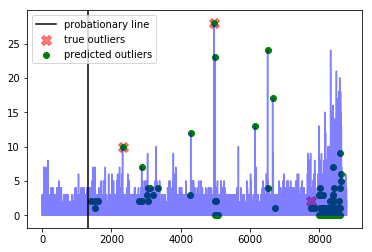




--- nyc_taxi ---
Corresponding window precision:  0.5
Corresponding window recall:  0.2
Corresponding window false positives:  1
Corresponding window false negatives:  4


Outlier indices as determined by best window threshold:  [3582, 3583, 10064, 10065, 10066, 10067, 10097, 10098, 10099, 10100, 10101, 10102, 10103, 10104, 10105, 10106, 10107, 10108, 10109]


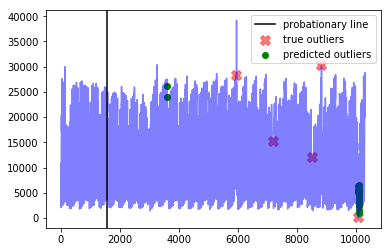




--- exchange-2_cpm_results ---
Corresponding window precision:  0.5
Corresponding window recall:  0.5
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [977, 1016, 1045]


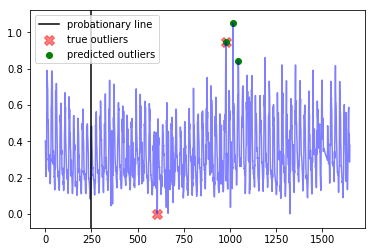




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [1016, 1046, 1088]


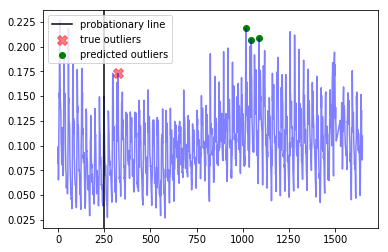




--- exchange-3_cpc_results ---
Corresponding window precision:  0.75
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [322, 323, 466, 467, 1041, 1194]


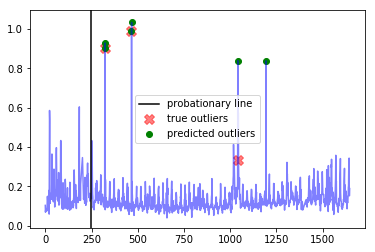

---------weight_fp=0.6, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  22.200000000000003
Best window threshold:  1.0
Corresponding window overall precision:  0.3076923076923077
Corresponding window overall recall:  0.5714285714285714
Corresponding window overall F score:  0.4



--- elb_request_count_8c0756 ---
Corresponding window precision:  0.2857142857142857
Corresponding window recall:  1.0
Corresponding window false positives:  5
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [786, 791, 1586, 1978, 2556, 2595, 3069, 3427, 3658, 3690, 3693]


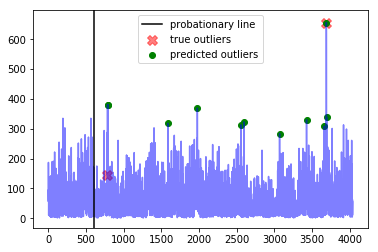




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


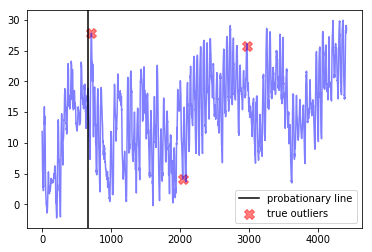




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1193, 1194]


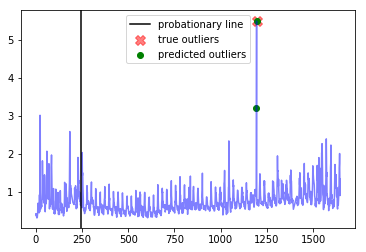




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.6666666666666666
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [4100, 4101, 4102, 4103, 4104, 4105, 4106, 4107, 4108, 4109, 4110, 4112, 4113, 4120, 4121, 4122, 4123, 4124, 4125, 4126, 4127, 4128, 4129, 4131, 5905, 5906, 5907, 5908, 5909, 5910, 5911, 5912, 5913, 6798]


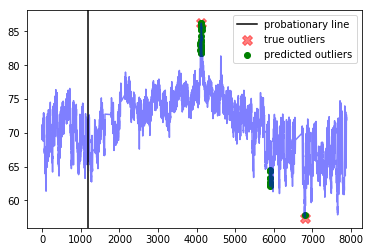




--- all_data_gift_certificates ---
Corresponding window precision:  0.2
Corresponding window recall:  1.0
Corresponding window false positives:  12
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1423, 1518, 1521, 1615, 2320, 2791, 2871, 2886, 3029, 3053, 3059, 3123, 3196, 3340, 4253, 4286, 4963, 4986, 4998, 5000, 5020, 5049, 5072, 6137, 6505, 6517, 6650, 6707, 7760, 7782, 7881, 7997, 8001, 8021, 8022, 8023, 8027, 8048, 8071, 8072, 8073, 8074, 8075, 8094, 8096, 8097, 8098, 8099, 8168, 8191, 8192, 8193, 8216, 8240, 8241, 8264, 8265, 8287, 8288, 8289, 8290, 8311, 8313, 8335, 8336, 8337, 8338, 8339, 8358, 8359, 8360, 8361, 8362, 8363, 8382, 8383, 8384, 8385, 8386, 8387, 8388, 8405, 8406, 8407, 8408, 8409, 8410, 8411, 8504, 8505, 8528, 8529, 8552, 8553, 8575, 8576, 8577, 8598, 8599, 8600, 8601, 8623, 8624]


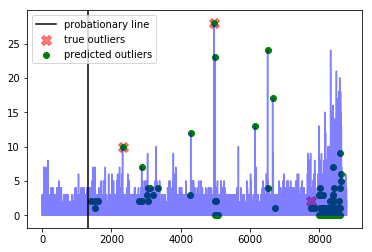




--- nyc_taxi ---
Corresponding window precision:  0.5
Corresponding window recall:  0.2
Corresponding window false positives:  1
Corresponding window false negatives:  4


Outlier indices as determined by best window threshold:  [3582, 3583, 10064, 10065, 10066, 10067, 10097, 10098, 10099, 10100, 10101, 10102, 10103, 10104, 10105, 10106, 10107, 10108, 10109]


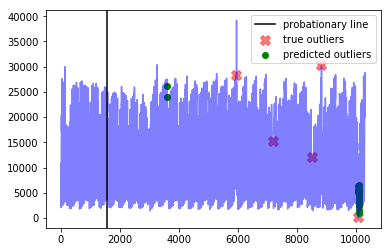




--- exchange-2_cpm_results ---
Corresponding window precision:  0.5
Corresponding window recall:  0.5
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [977, 1016, 1045]


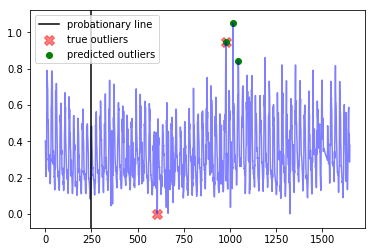




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [1016, 1046, 1088]


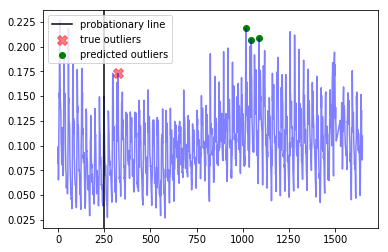




--- exchange-3_cpc_results ---
Corresponding window precision:  0.75
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [322, 323, 466, 467, 1041, 1194]


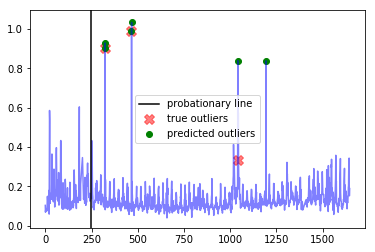

---------weight_fp=0.7, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  24.399999999999995
Best window threshold:  1.0
Corresponding window overall precision:  0.3076923076923077
Corresponding window overall recall:  0.5714285714285714
Corresponding window overall F score:  0.4



--- elb_request_count_8c0756 ---
Corresponding window precision:  0.2857142857142857
Corresponding window recall:  1.0
Corresponding window false positives:  5
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [786, 791, 1586, 1978, 2556, 2595, 3069, 3427, 3658, 3690, 3693]


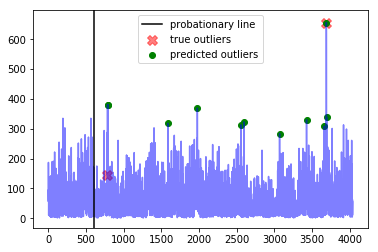




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


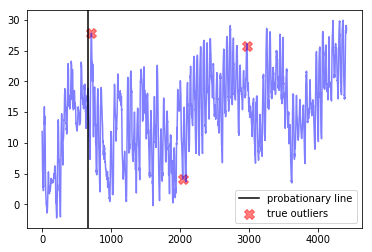




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1193, 1194]


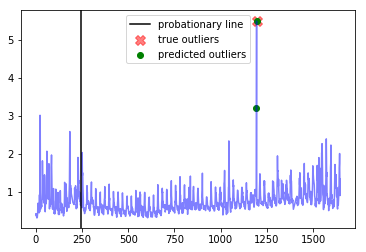




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.6666666666666666
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [4100, 4101, 4102, 4103, 4104, 4105, 4106, 4107, 4108, 4109, 4110, 4112, 4113, 4120, 4121, 4122, 4123, 4124, 4125, 4126, 4127, 4128, 4129, 4131, 5905, 5906, 5907, 5908, 5909, 5910, 5911, 5912, 5913, 6798]


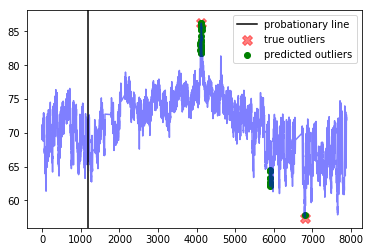




--- all_data_gift_certificates ---
Corresponding window precision:  0.2
Corresponding window recall:  1.0
Corresponding window false positives:  12
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1423, 1518, 1521, 1615, 2320, 2791, 2871, 2886, 3029, 3053, 3059, 3123, 3196, 3340, 4253, 4286, 4963, 4986, 4998, 5000, 5020, 5049, 5072, 6137, 6505, 6517, 6650, 6707, 7760, 7782, 7881, 7997, 8001, 8021, 8022, 8023, 8027, 8048, 8071, 8072, 8073, 8074, 8075, 8094, 8096, 8097, 8098, 8099, 8168, 8191, 8192, 8193, 8216, 8240, 8241, 8264, 8265, 8287, 8288, 8289, 8290, 8311, 8313, 8335, 8336, 8337, 8338, 8339, 8358, 8359, 8360, 8361, 8362, 8363, 8382, 8383, 8384, 8385, 8386, 8387, 8388, 8405, 8406, 8407, 8408, 8409, 8410, 8411, 8504, 8505, 8528, 8529, 8552, 8553, 8575, 8576, 8577, 8598, 8599, 8600, 8601, 8623, 8624]


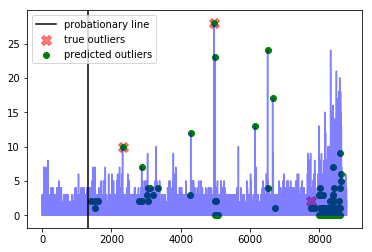




--- nyc_taxi ---
Corresponding window precision:  0.5
Corresponding window recall:  0.2
Corresponding window false positives:  1
Corresponding window false negatives:  4


Outlier indices as determined by best window threshold:  [3582, 3583, 10064, 10065, 10066, 10067, 10097, 10098, 10099, 10100, 10101, 10102, 10103, 10104, 10105, 10106, 10107, 10108, 10109]


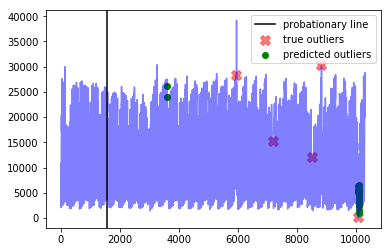




--- exchange-2_cpm_results ---
Corresponding window precision:  0.5
Corresponding window recall:  0.5
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [977, 1016, 1045]


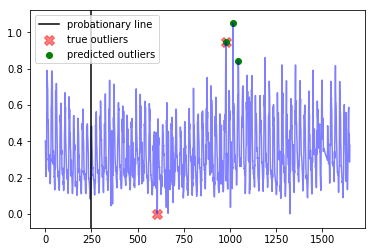




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [1016, 1046, 1088]


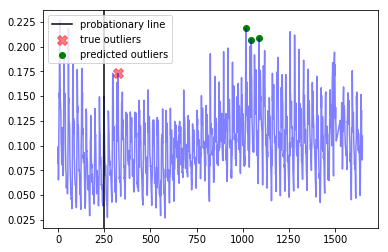




--- exchange-3_cpc_results ---
Corresponding window precision:  0.75
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [322, 323, 466, 467, 1041, 1194]


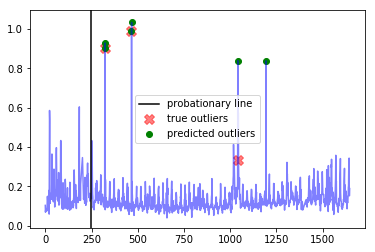

---------weight_fp=0.8, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  26.600000000000005
Best window threshold:  1.0
Corresponding window overall precision:  0.3076923076923077
Corresponding window overall recall:  0.5714285714285714
Corresponding window overall F score:  0.4



--- elb_request_count_8c0756 ---
Corresponding window precision:  0.2857142857142857
Corresponding window recall:  1.0
Corresponding window false positives:  5
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [786, 791, 1586, 1978, 2556, 2595, 3069, 3427, 3658, 3690, 3693]


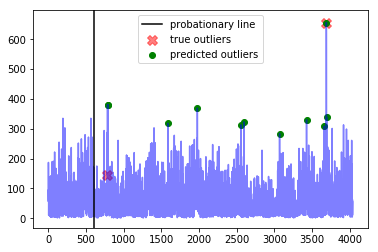




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


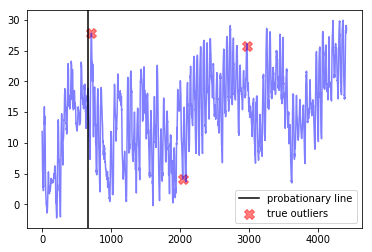




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1193, 1194]


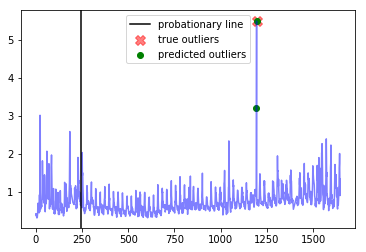




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.6666666666666666
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [4100, 4101, 4102, 4103, 4104, 4105, 4106, 4107, 4108, 4109, 4110, 4112, 4113, 4120, 4121, 4122, 4123, 4124, 4125, 4126, 4127, 4128, 4129, 4131, 5905, 5906, 5907, 5908, 5909, 5910, 5911, 5912, 5913, 6798]


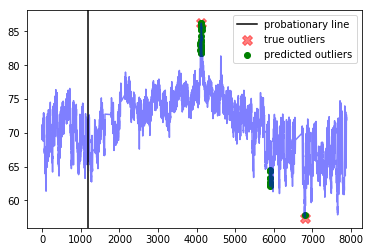




--- all_data_gift_certificates ---
Corresponding window precision:  0.2
Corresponding window recall:  1.0
Corresponding window false positives:  12
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1423, 1518, 1521, 1615, 2320, 2791, 2871, 2886, 3029, 3053, 3059, 3123, 3196, 3340, 4253, 4286, 4963, 4986, 4998, 5000, 5020, 5049, 5072, 6137, 6505, 6517, 6650, 6707, 7760, 7782, 7881, 7997, 8001, 8021, 8022, 8023, 8027, 8048, 8071, 8072, 8073, 8074, 8075, 8094, 8096, 8097, 8098, 8099, 8168, 8191, 8192, 8193, 8216, 8240, 8241, 8264, 8265, 8287, 8288, 8289, 8290, 8311, 8313, 8335, 8336, 8337, 8338, 8339, 8358, 8359, 8360, 8361, 8362, 8363, 8382, 8383, 8384, 8385, 8386, 8387, 8388, 8405, 8406, 8407, 8408, 8409, 8410, 8411, 8504, 8505, 8528, 8529, 8552, 8553, 8575, 8576, 8577, 8598, 8599, 8600, 8601, 8623, 8624]


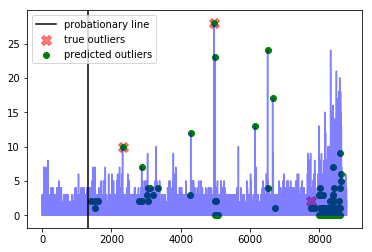




--- nyc_taxi ---
Corresponding window precision:  0.5
Corresponding window recall:  0.2
Corresponding window false positives:  1
Corresponding window false negatives:  4


Outlier indices as determined by best window threshold:  [3582, 3583, 10064, 10065, 10066, 10067, 10097, 10098, 10099, 10100, 10101, 10102, 10103, 10104, 10105, 10106, 10107, 10108, 10109]


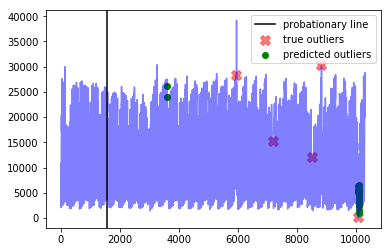




--- exchange-2_cpm_results ---
Corresponding window precision:  0.5
Corresponding window recall:  0.5
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [977, 1016, 1045]


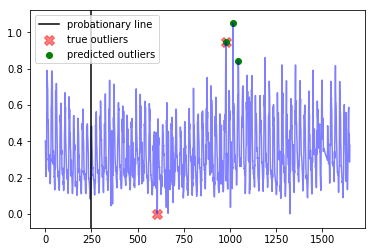




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [1016, 1046, 1088]


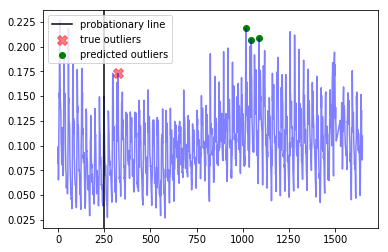




--- exchange-3_cpc_results ---
Corresponding window precision:  0.75
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [322, 323, 466, 467, 1041, 1194]


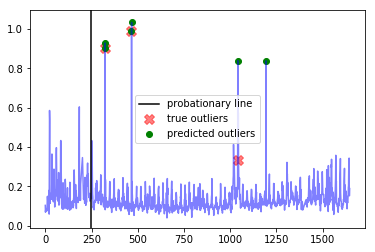

---------weight_fp=0.9, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  28.799999999999997
Best window threshold:  1.0
Corresponding window overall precision:  0.3076923076923077
Corresponding window overall recall:  0.5714285714285714
Corresponding window overall F score:  0.4



--- elb_request_count_8c0756 ---
Corresponding window precision:  0.2857142857142857
Corresponding window recall:  1.0
Corresponding window false positives:  5
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [786, 791, 1586, 1978, 2556, 2595, 3069, 3427, 3658, 3690, 3693]


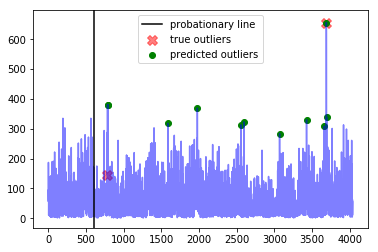




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


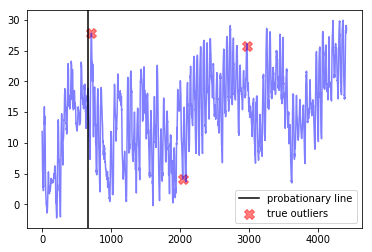




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1193, 1194]


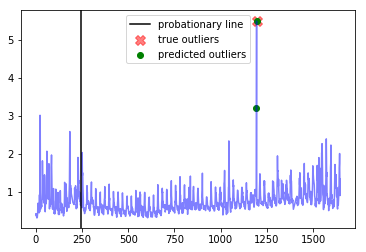




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.6666666666666666
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [4100, 4101, 4102, 4103, 4104, 4105, 4106, 4107, 4108, 4109, 4110, 4112, 4113, 4120, 4121, 4122, 4123, 4124, 4125, 4126, 4127, 4128, 4129, 4131, 5905, 5906, 5907, 5908, 5909, 5910, 5911, 5912, 5913, 6798]


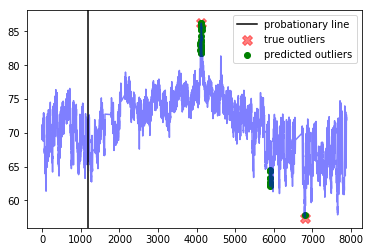




--- all_data_gift_certificates ---
Corresponding window precision:  0.2
Corresponding window recall:  1.0
Corresponding window false positives:  12
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1423, 1518, 1521, 1615, 2320, 2791, 2871, 2886, 3029, 3053, 3059, 3123, 3196, 3340, 4253, 4286, 4963, 4986, 4998, 5000, 5020, 5049, 5072, 6137, 6505, 6517, 6650, 6707, 7760, 7782, 7881, 7997, 8001, 8021, 8022, 8023, 8027, 8048, 8071, 8072, 8073, 8074, 8075, 8094, 8096, 8097, 8098, 8099, 8168, 8191, 8192, 8193, 8216, 8240, 8241, 8264, 8265, 8287, 8288, 8289, 8290, 8311, 8313, 8335, 8336, 8337, 8338, 8339, 8358, 8359, 8360, 8361, 8362, 8363, 8382, 8383, 8384, 8385, 8386, 8387, 8388, 8405, 8406, 8407, 8408, 8409, 8410, 8411, 8504, 8505, 8528, 8529, 8552, 8553, 8575, 8576, 8577, 8598, 8599, 8600, 8601, 8623, 8624]


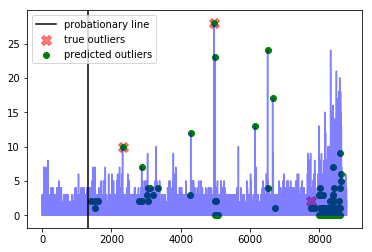




--- nyc_taxi ---
Corresponding window precision:  0.5
Corresponding window recall:  0.2
Corresponding window false positives:  1
Corresponding window false negatives:  4


Outlier indices as determined by best window threshold:  [3582, 3583, 10064, 10065, 10066, 10067, 10097, 10098, 10099, 10100, 10101, 10102, 10103, 10104, 10105, 10106, 10107, 10108, 10109]


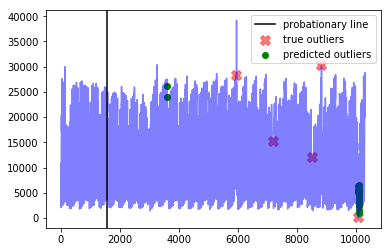




--- exchange-2_cpm_results ---
Corresponding window precision:  0.5
Corresponding window recall:  0.5
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [977, 1016, 1045]


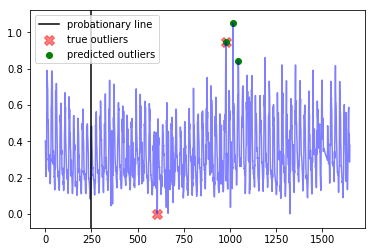




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [1016, 1046, 1088]


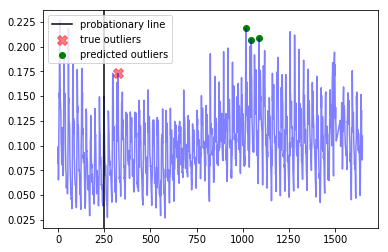




--- exchange-3_cpc_results ---
Corresponding window precision:  0.75
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [322, 323, 466, 467, 1041, 1194]


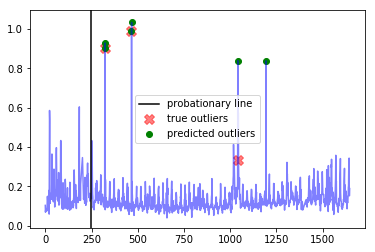

---------weight_fp=1.0, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  31.0
Best window threshold:  1.0
Corresponding window overall precision:  0.3076923076923077
Corresponding window overall recall:  0.5714285714285714
Corresponding window overall F score:  0.4



--- elb_request_count_8c0756 ---
Corresponding window precision:  0.2857142857142857
Corresponding window recall:  1.0
Corresponding window false positives:  5
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [786, 791, 1586, 1978, 2556, 2595, 3069, 3427, 3658, 3690, 3693]


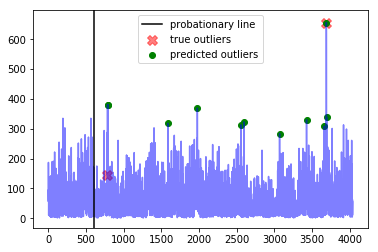




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


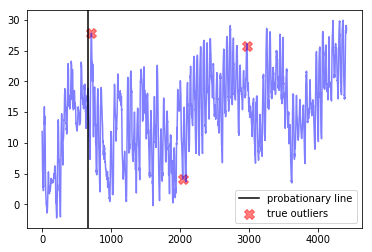




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1193, 1194]


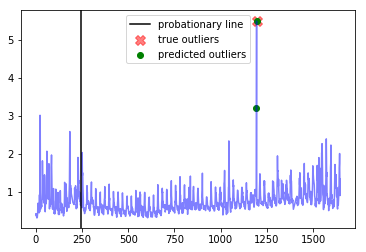




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.6666666666666666
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [4100, 4101, 4102, 4103, 4104, 4105, 4106, 4107, 4108, 4109, 4110, 4112, 4113, 4120, 4121, 4122, 4123, 4124, 4125, 4126, 4127, 4128, 4129, 4131, 5905, 5906, 5907, 5908, 5909, 5910, 5911, 5912, 5913, 6798]


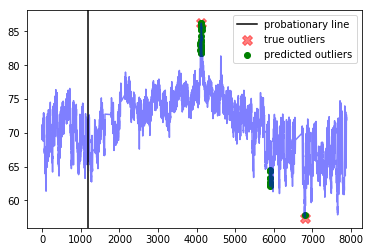




--- all_data_gift_certificates ---
Corresponding window precision:  0.2
Corresponding window recall:  1.0
Corresponding window false positives:  12
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1423, 1518, 1521, 1615, 2320, 2791, 2871, 2886, 3029, 3053, 3059, 3123, 3196, 3340, 4253, 4286, 4963, 4986, 4998, 5000, 5020, 5049, 5072, 6137, 6505, 6517, 6650, 6707, 7760, 7782, 7881, 7997, 8001, 8021, 8022, 8023, 8027, 8048, 8071, 8072, 8073, 8074, 8075, 8094, 8096, 8097, 8098, 8099, 8168, 8191, 8192, 8193, 8216, 8240, 8241, 8264, 8265, 8287, 8288, 8289, 8290, 8311, 8313, 8335, 8336, 8337, 8338, 8339, 8358, 8359, 8360, 8361, 8362, 8363, 8382, 8383, 8384, 8385, 8386, 8387, 8388, 8405, 8406, 8407, 8408, 8409, 8410, 8411, 8504, 8505, 8528, 8529, 8552, 8553, 8575, 8576, 8577, 8598, 8599, 8600, 8601, 8623, 8624]


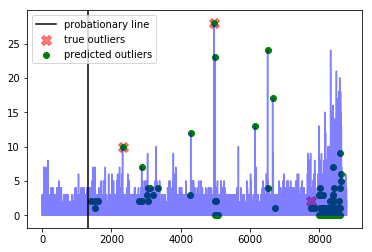




--- nyc_taxi ---
Corresponding window precision:  0.5
Corresponding window recall:  0.2
Corresponding window false positives:  1
Corresponding window false negatives:  4


Outlier indices as determined by best window threshold:  [3582, 3583, 10064, 10065, 10066, 10067, 10097, 10098, 10099, 10100, 10101, 10102, 10103, 10104, 10105, 10106, 10107, 10108, 10109]


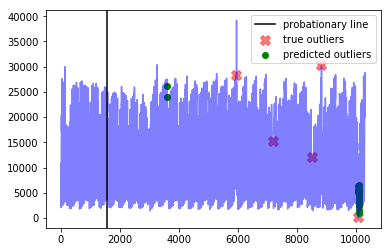




--- exchange-2_cpm_results ---
Corresponding window precision:  0.5
Corresponding window recall:  0.5
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [977, 1016, 1045]


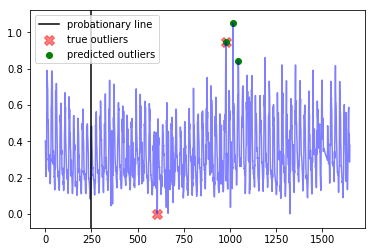




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [1016, 1046, 1088]


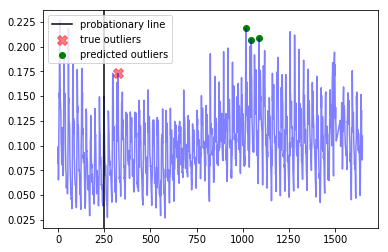




--- exchange-3_cpc_results ---
Corresponding window precision:  0.75
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [322, 323, 466, 467, 1041, 1194]


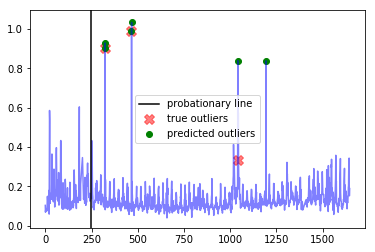

------------
False Positive Weight:  0.1
	 Minimum number of mistakes : 11.2
	 Corresponding window overall recall : 0.5714285714285714
	 Corresponding window overall precision : 0.3076923076923077
	 Corresponding window overall F score : 0.4
	 Best window threshold : 1.0
False Positive Weight:  0.2
	 Minimum number of mistakes : 13.399999999999999
	 Corresponding window overall recall : 0.5714285714285714
	 Corresponding window overall precision : 0.3076923076923077
	 Corresponding window overall F score : 0.4
	 Best window threshold : 1.0
False Positive Weight:  0.3
	 Minimum number of mistakes : 15.600000000000001
	 Corresponding window overall recall : 0.5714285714285714
	 Corresponding window overall precision : 0.3076923076923077
	 Corresponding window overall F score : 0.4
	 Best window threshold : 1.0
False Positive Weight:  0.6
	 Minimum number of mistakes : 22.200000000000003
	 Corresponding window overall recall : 0.5714285714285714
	 Corresponding window overall precision :

In [33]:
end_results = {}
for weight_fp in weight_fp_list:  
    print("---------weight_fp=" + str(weight_fp) + ", weight_fn=1----------")
    weight_result = adclasses.pretty_print_results(donut_ad_dict, anomaly_scores_dict, donut_true_outlier_indices_dict, weight_fp=weight_fp, weight_fn=1)
    end_results[weight_fp] = weight_result

print("------------")
adclasses.pretty_print_end_results(end_results)

# STL Residual Results

In [37]:
anomaly_scores_dict = {}

for dataset_name in dataset_name_list:
    output_dict_htm = joblib.load("anomaly_scores/stl/" + dataset_name)
    anomaly_scores_dict[dataset_name] = output_dict_htm["Anomaly Scores"]

In [38]:
adclasses.precision_recall_curve_info(anomaly_scores_dict, true_outlier_indices_dict)

{0.1: {'precision': 0.11538461538461539, 'recall': 1.0},
 0.2: {'precision': 0.11538461538461539, 'recall': 1.0},
 0.3: {'precision': 0.11538461538461539, 'recall': 1.0},
 0.4: {'precision': 0.11538461538461539, 'recall': 1.0},
 0.5: {'precision': 0.11538461538461539, 'recall': 1.0},
 0.6: {'precision': 0.11538461538461539, 'recall': 1.0},
 0.7: {'precision': 0.11538461538461539, 'recall': 1.0},
 0.8: {'precision': 0.12, 'recall': 1.0},
 0.9: {'precision': 0.15789473684210525, 'recall': 1.0},
 1.0: {'precision': 0.6666666666666666, 'recall': 0.6666666666666666}}

---------weight_fp=0.1, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  10.7
Best window threshold:  0.9999
Corresponding window overall precision:  0.22666666666666666
Corresponding window overall recall:  0.7391304347826086
Corresponding window overall F score:  0.346938775510204



--- elb_request_count_8c0756 ---
Corresponding window precision:  0.25
Corresponding window recall:  1.0
Corresponding window false positives:  6
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [741, 786, 790, 791, 1586, 2556, 2595, 3069, 3327, 3405, 3427, 3455, 3658, 3690, 3978]


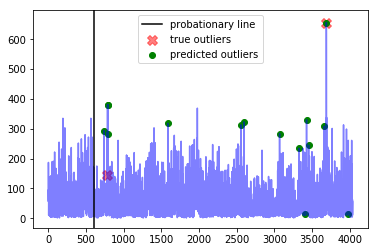




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  [3574]


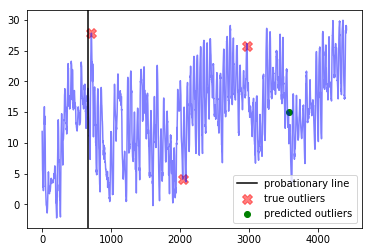




--- exchange-3_cpm_results ---
Corresponding window precision:  0.2
Corresponding window recall:  1.0
Corresponding window false positives:  4
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [251, 836, 1044, 1146, 1169, 1170, 1193, 1194, 1217, 1218, 1307, 1531, 1536]


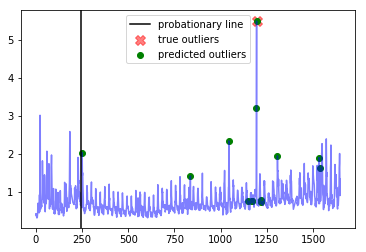




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.4
Corresponding window recall:  1.0
Corresponding window false positives:  3
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [2518, 4123, 4149, 4628, 6749, 6751, 6752, 7649, 7669, 7671, 7673, 7674, 7790]


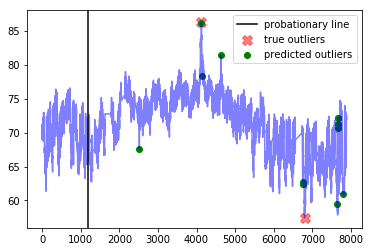




--- all_data_gift_certificates ---
Corresponding window precision:  0.13636363636363635
Corresponding window recall:  1.0
Corresponding window false positives:  19
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1318, 1462, 1487, 1505, 1531, 1634, 1702, 1770, 1822, 1918, 2009, 2059, 2157, 2176, 2233, 2296, 2304, 2320, 2344, 2471, 2514, 2871, 2974, 3042, 3281, 3785, 3810, 3855, 4262, 4286, 4367, 4516, 4939, 4946, 4961, 4962, 4963, 4985, 4986, 4987, 4992, 5010, 5011, 5016, 5662, 6137, 6161, 6164, 6167, 6375, 6457, 6471, 6481, 6505, 6529, 6626, 6650, 6669, 6674, 7677, 7680, 7744, 7746, 7818, 7838, 7847, 7864, 7871, 7985, 7989, 7993, 7995, 8011, 8012, 8017, 8060, 8134, 8153, 8157, 8162, 8175, 8177, 8228, 8303, 8324, 8393, 8467, 8491, 8511, 8512]


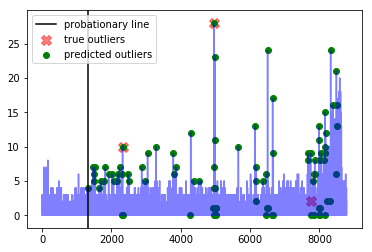




--- nyc_taxi ---
Corresponding window precision:  0.375
Corresponding window recall:  0.6
Corresponding window false positives:  5
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [3266, 3279, 3280, 3615, 5282, 5908, 5954, 5955, 6002, 6003, 7647, 8833, 8834, 8835, 8836, 8837, 8838, 8839, 8840, 10000, 10047, 10048, 10049]


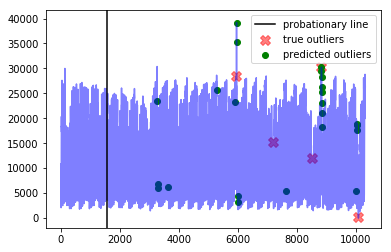




--- exchange-2_cpm_results ---
Corresponding window precision:  0.18181818181818182
Corresponding window recall:  1.0
Corresponding window false positives:  9
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [323, 355, 360, 365, 424, 601, 640, 664, 665, 801, 802, 899, 923, 951, 968, 976, 977, 978, 1002, 1016, 1103, 1104, 1521, 1522]


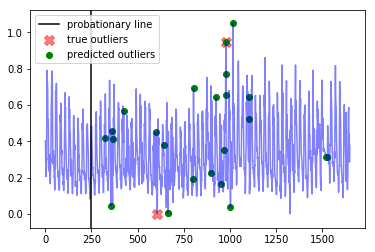




--- exchange-2_cpc_results ---
Corresponding window precision:  0.14285714285714285
Corresponding window recall:  1.0
Corresponding window false positives:  6
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [317, 325, 438, 824, 1016, 1142, 1306, 1354, 1484, 1485, 1486, 1515]


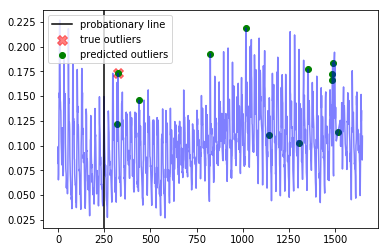




--- international-airline-passengers ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  1.0
Corresponding window false positives:  2
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [76, 88, 100, 112]


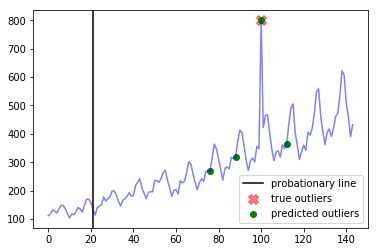




--- exchange-3_cpc_results ---
Corresponding window precision:  0.6
Corresponding window recall:  1.0
Corresponding window false positives:  2
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [298, 322, 323, 466, 467, 1041, 1044, 1193, 1194, 1619]


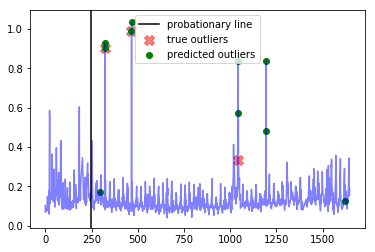

---------weight_fp=0.2, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  16.4
Best window threshold:  0.9999
Corresponding window overall precision:  0.22666666666666666
Corresponding window overall recall:  0.7391304347826086
Corresponding window overall F score:  0.346938775510204



--- elb_request_count_8c0756 ---
Corresponding window precision:  0.25
Corresponding window recall:  1.0
Corresponding window false positives:  6
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [741, 786, 790, 791, 1586, 2556, 2595, 3069, 3327, 3405, 3427, 3455, 3658, 3690, 3978]


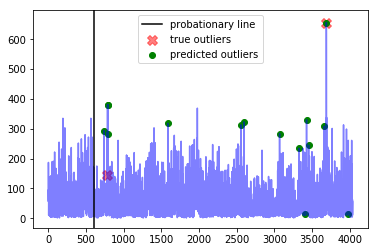




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  [3574]


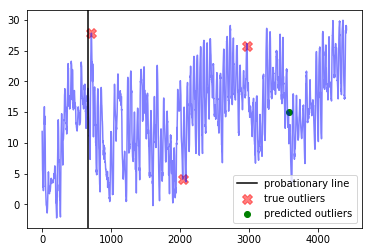




--- exchange-3_cpm_results ---
Corresponding window precision:  0.2
Corresponding window recall:  1.0
Corresponding window false positives:  4
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [251, 836, 1044, 1146, 1169, 1170, 1193, 1194, 1217, 1218, 1307, 1531, 1536]


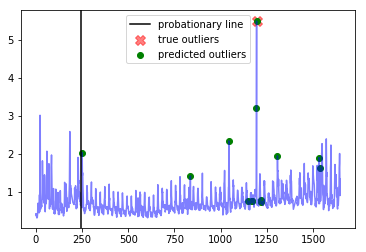




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.4
Corresponding window recall:  1.0
Corresponding window false positives:  3
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [2518, 4123, 4149, 4628, 6749, 6751, 6752, 7649, 7669, 7671, 7673, 7674, 7790]


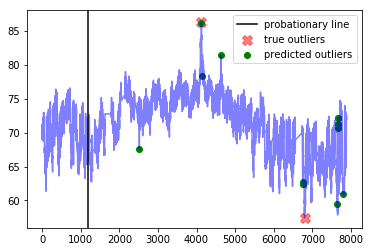




--- all_data_gift_certificates ---
Corresponding window precision:  0.13636363636363635
Corresponding window recall:  1.0
Corresponding window false positives:  19
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1318, 1462, 1487, 1505, 1531, 1634, 1702, 1770, 1822, 1918, 2009, 2059, 2157, 2176, 2233, 2296, 2304, 2320, 2344, 2471, 2514, 2871, 2974, 3042, 3281, 3785, 3810, 3855, 4262, 4286, 4367, 4516, 4939, 4946, 4961, 4962, 4963, 4985, 4986, 4987, 4992, 5010, 5011, 5016, 5662, 6137, 6161, 6164, 6167, 6375, 6457, 6471, 6481, 6505, 6529, 6626, 6650, 6669, 6674, 7677, 7680, 7744, 7746, 7818, 7838, 7847, 7864, 7871, 7985, 7989, 7993, 7995, 8011, 8012, 8017, 8060, 8134, 8153, 8157, 8162, 8175, 8177, 8228, 8303, 8324, 8393, 8467, 8491, 8511, 8512]


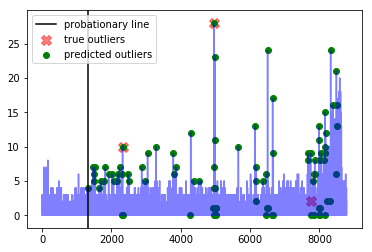




--- nyc_taxi ---
Corresponding window precision:  0.375
Corresponding window recall:  0.6
Corresponding window false positives:  5
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [3266, 3279, 3280, 3615, 5282, 5908, 5954, 5955, 6002, 6003, 7647, 8833, 8834, 8835, 8836, 8837, 8838, 8839, 8840, 10000, 10047, 10048, 10049]


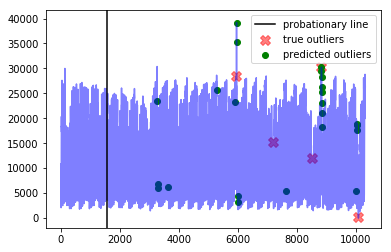




--- exchange-2_cpm_results ---
Corresponding window precision:  0.18181818181818182
Corresponding window recall:  1.0
Corresponding window false positives:  9
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [323, 355, 360, 365, 424, 601, 640, 664, 665, 801, 802, 899, 923, 951, 968, 976, 977, 978, 1002, 1016, 1103, 1104, 1521, 1522]


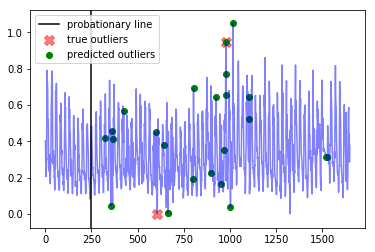




--- exchange-2_cpc_results ---
Corresponding window precision:  0.14285714285714285
Corresponding window recall:  1.0
Corresponding window false positives:  6
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [317, 325, 438, 824, 1016, 1142, 1306, 1354, 1484, 1485, 1486, 1515]


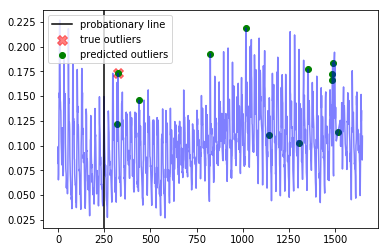




--- international-airline-passengers ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  1.0
Corresponding window false positives:  2
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [76, 88, 100, 112]


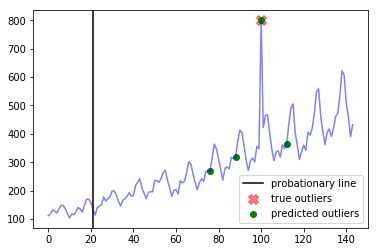




--- exchange-3_cpc_results ---
Corresponding window precision:  0.6
Corresponding window recall:  1.0
Corresponding window false positives:  2
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [298, 322, 323, 466, 467, 1041, 1044, 1193, 1194, 1619]


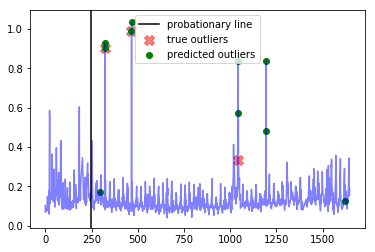

---------weight_fp=0.3, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  18.1
Best window threshold:  1.0
Corresponding window overall precision:  0.5714285714285714
Corresponding window overall recall:  0.34782608695652173
Corresponding window overall F score:  0.4324324324324324



--- elb_request_count_8c0756 ---
Corresponding window precision:  1.0
Corresponding window recall:  0.5
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [3690]


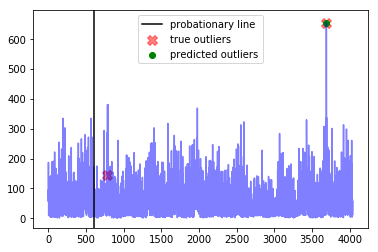




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


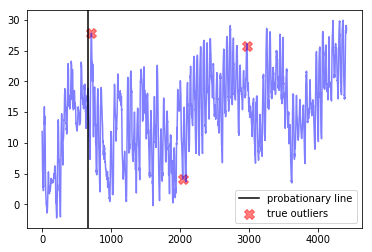




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1170, 1193, 1194, 1218]


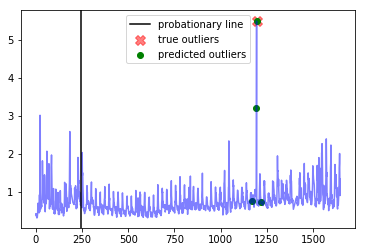




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


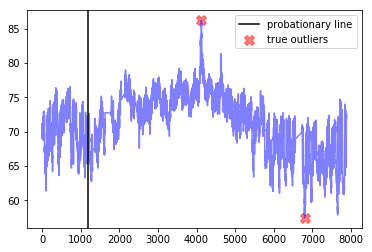




--- all_data_gift_certificates ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  4
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [2320, 4286, 4939, 4962, 4963, 4986, 4992, 6137, 6505, 6650]


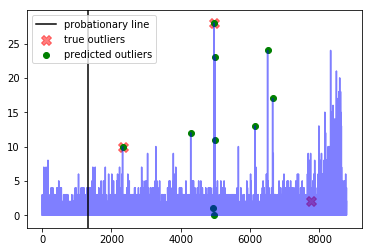




--- nyc_taxi ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  5


Outlier indices as determined by best window threshold:  []


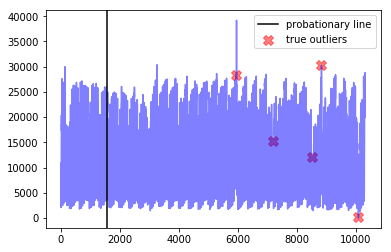




--- exchange-2_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [1016]


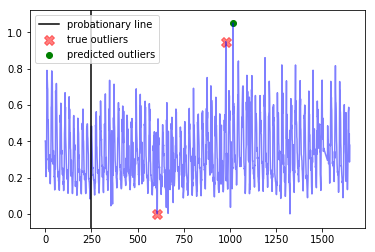




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


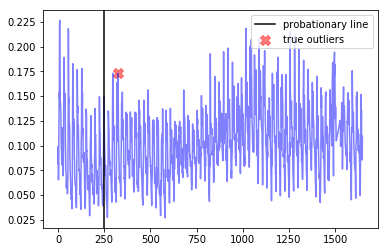




--- international-airline-passengers ---
Corresponding window precision:  0.5
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [76, 88, 100]


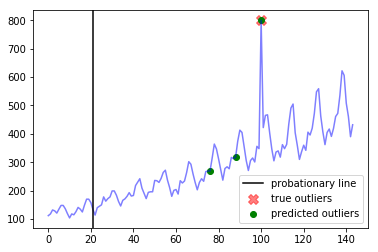




--- exchange-3_cpc_results ---
Corresponding window precision:  0.6666666666666666
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [322, 323, 466, 467, 1194]


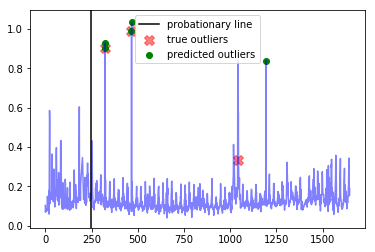

---------weight_fp=0.4, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  18.799999999999997
Best window threshold:  1.0
Corresponding window overall precision:  0.5714285714285714
Corresponding window overall recall:  0.34782608695652173
Corresponding window overall F score:  0.4324324324324324



--- elb_request_count_8c0756 ---
Corresponding window precision:  1.0
Corresponding window recall:  0.5
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [3690]


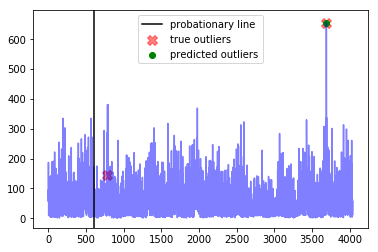




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


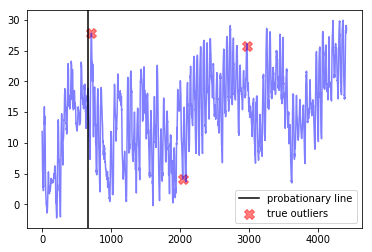




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1170, 1193, 1194, 1218]


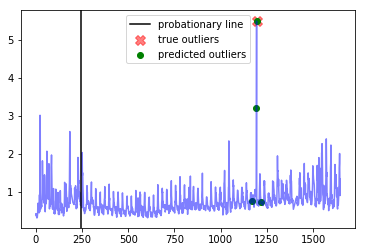




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


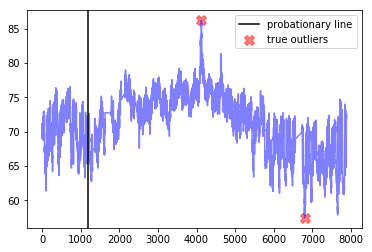




--- all_data_gift_certificates ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  4
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [2320, 4286, 4939, 4962, 4963, 4986, 4992, 6137, 6505, 6650]


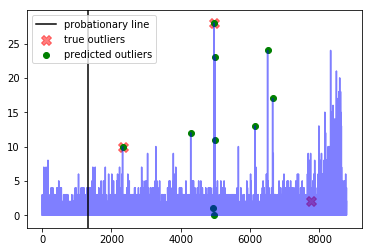




--- nyc_taxi ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  5


Outlier indices as determined by best window threshold:  []


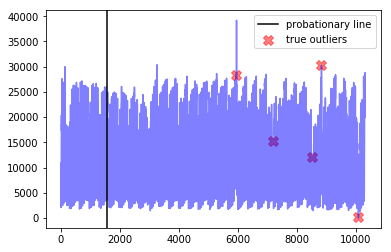




--- exchange-2_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [1016]


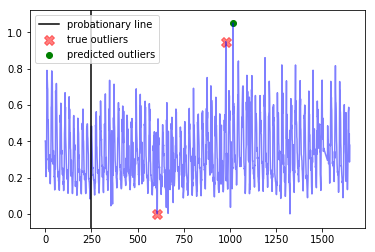




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


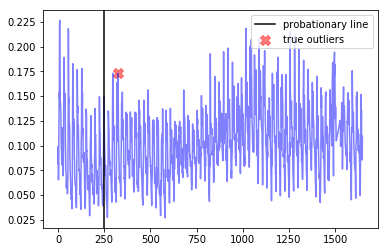




--- international-airline-passengers ---
Corresponding window precision:  0.5
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [76, 88, 100]


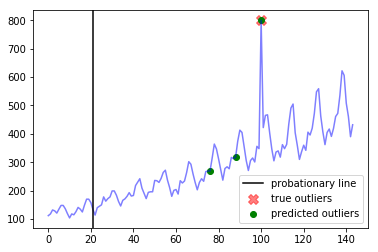




--- exchange-3_cpc_results ---
Corresponding window precision:  0.6666666666666666
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [322, 323, 466, 467, 1194]


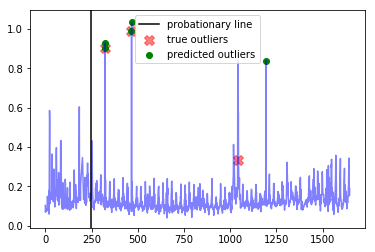

---------weight_fp=0.5, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  19.5
Best window threshold:  1.0
Corresponding window overall precision:  0.5714285714285714
Corresponding window overall recall:  0.34782608695652173
Corresponding window overall F score:  0.4324324324324324



--- elb_request_count_8c0756 ---
Corresponding window precision:  1.0
Corresponding window recall:  0.5
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [3690]


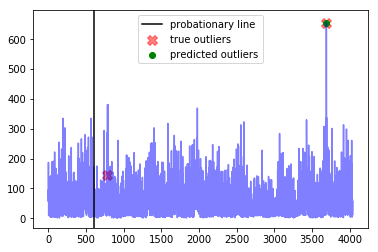




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


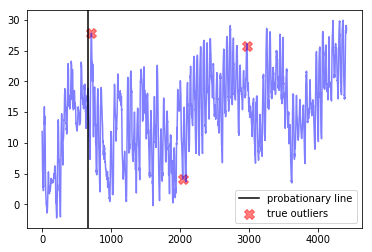




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1170, 1193, 1194, 1218]


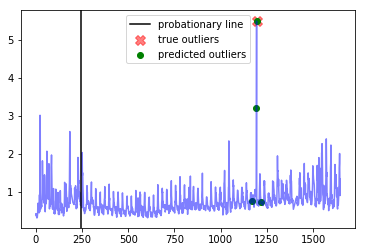




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


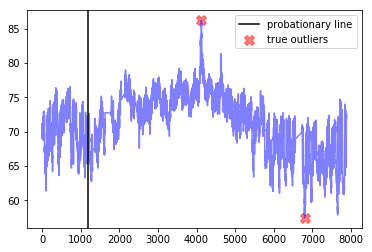




--- all_data_gift_certificates ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  4
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [2320, 4286, 4939, 4962, 4963, 4986, 4992, 6137, 6505, 6650]


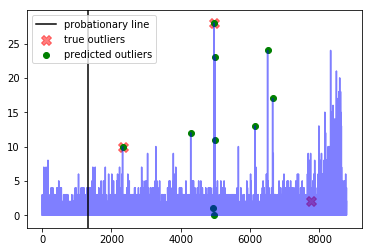




--- nyc_taxi ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  5


Outlier indices as determined by best window threshold:  []


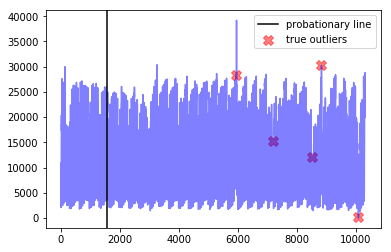




--- exchange-2_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [1016]


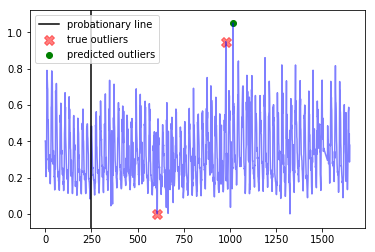




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


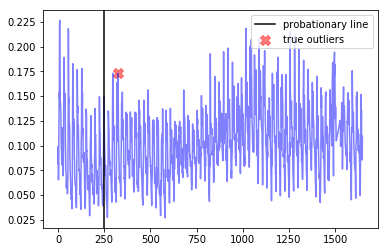




--- international-airline-passengers ---
Corresponding window precision:  0.5
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [76, 88, 100]


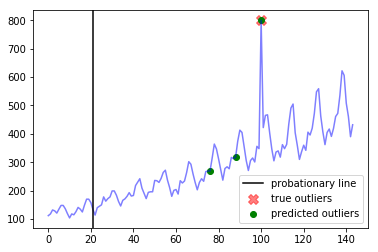




--- exchange-3_cpc_results ---
Corresponding window precision:  0.6666666666666666
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [322, 323, 466, 467, 1194]


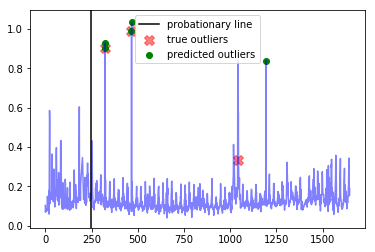

---------weight_fp=0.6, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  20.200000000000003
Best window threshold:  1.0
Corresponding window overall precision:  0.5714285714285714
Corresponding window overall recall:  0.34782608695652173
Corresponding window overall F score:  0.4324324324324324



--- elb_request_count_8c0756 ---
Corresponding window precision:  1.0
Corresponding window recall:  0.5
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [3690]


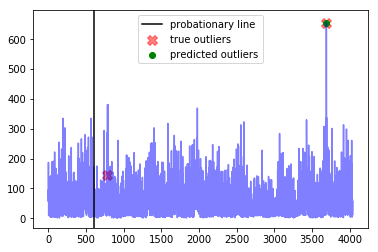




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


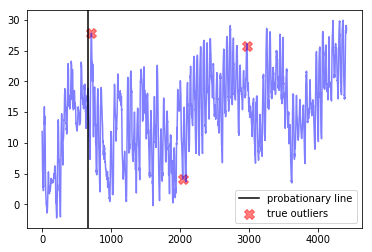




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1170, 1193, 1194, 1218]


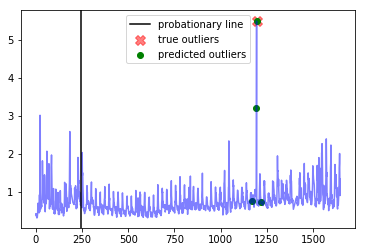




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


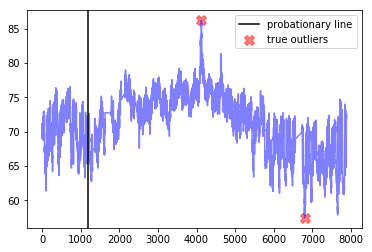




--- all_data_gift_certificates ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  4
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [2320, 4286, 4939, 4962, 4963, 4986, 4992, 6137, 6505, 6650]


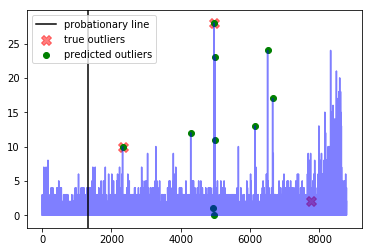




--- nyc_taxi ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  5


Outlier indices as determined by best window threshold:  []


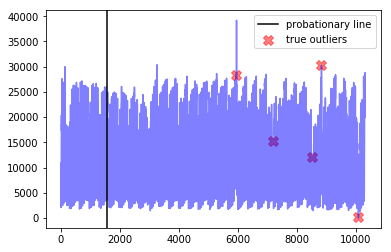




--- exchange-2_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [1016]


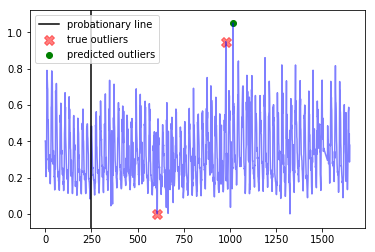




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


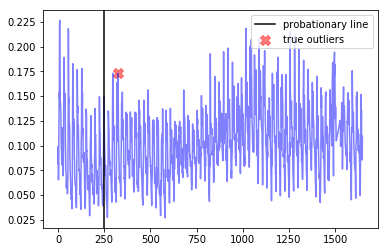




--- international-airline-passengers ---
Corresponding window precision:  0.5
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [76, 88, 100]


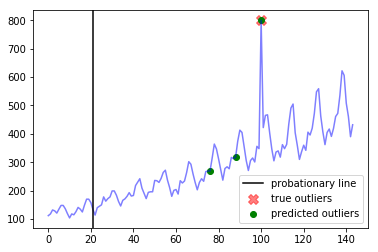




--- exchange-3_cpc_results ---
Corresponding window precision:  0.6666666666666666
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [322, 323, 466, 467, 1194]


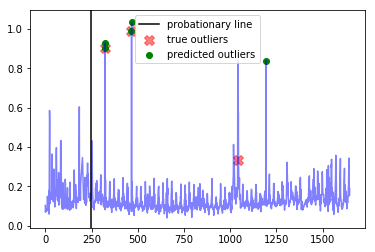

---------weight_fp=0.7, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  20.9
Best window threshold:  1.0
Corresponding window overall precision:  0.5714285714285714
Corresponding window overall recall:  0.34782608695652173
Corresponding window overall F score:  0.4324324324324324



--- elb_request_count_8c0756 ---
Corresponding window precision:  1.0
Corresponding window recall:  0.5
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [3690]


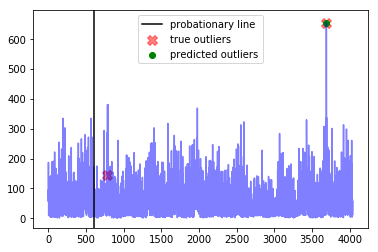




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


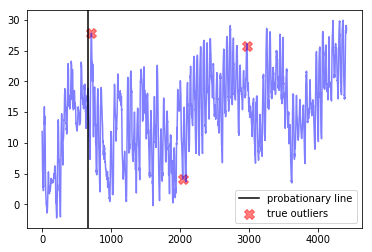




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1170, 1193, 1194, 1218]


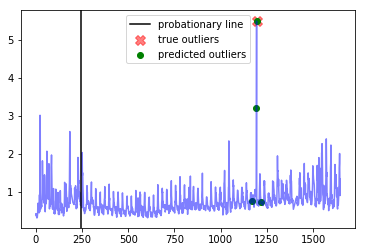




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


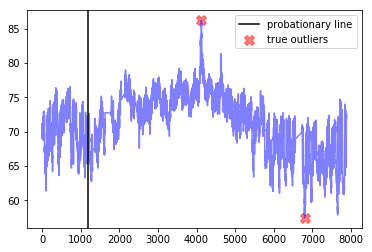




--- all_data_gift_certificates ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  4
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [2320, 4286, 4939, 4962, 4963, 4986, 4992, 6137, 6505, 6650]


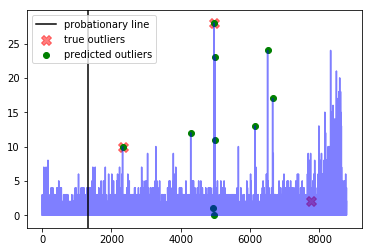




--- nyc_taxi ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  5


Outlier indices as determined by best window threshold:  []


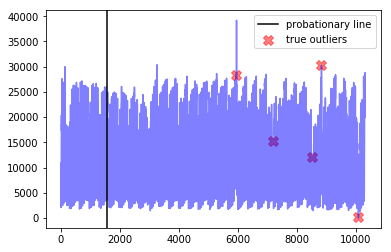




--- exchange-2_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [1016]


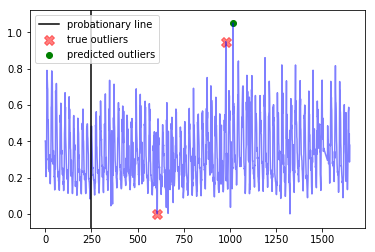




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


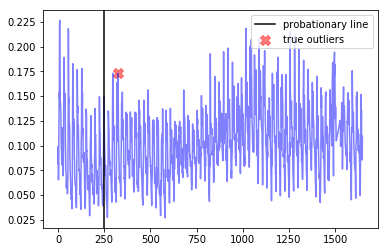




--- international-airline-passengers ---
Corresponding window precision:  0.5
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [76, 88, 100]


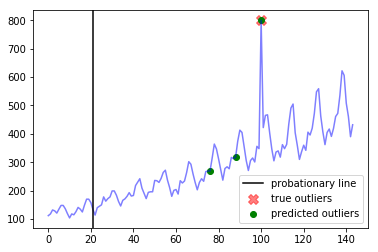




--- exchange-3_cpc_results ---
Corresponding window precision:  0.6666666666666666
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [322, 323, 466, 467, 1194]


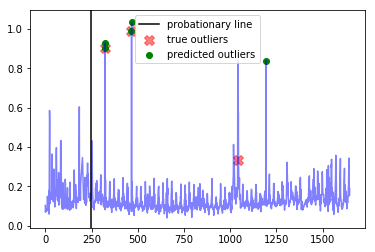

---------weight_fp=0.8, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  21.6
Best window threshold:  1.0
Corresponding window overall precision:  0.5714285714285714
Corresponding window overall recall:  0.34782608695652173
Corresponding window overall F score:  0.4324324324324324



--- elb_request_count_8c0756 ---
Corresponding window precision:  1.0
Corresponding window recall:  0.5
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [3690]


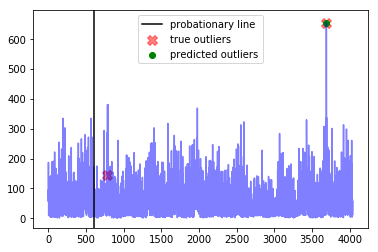




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


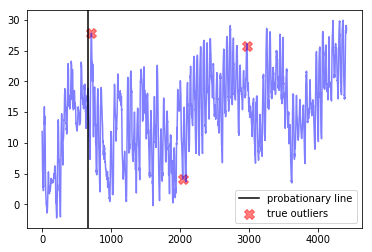




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1170, 1193, 1194, 1218]


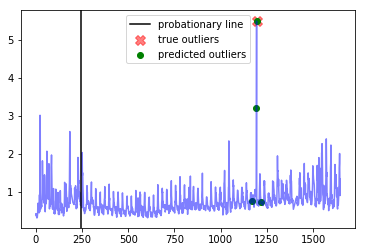




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


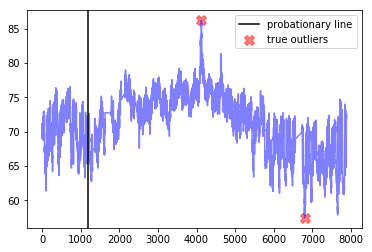




--- all_data_gift_certificates ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  4
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [2320, 4286, 4939, 4962, 4963, 4986, 4992, 6137, 6505, 6650]


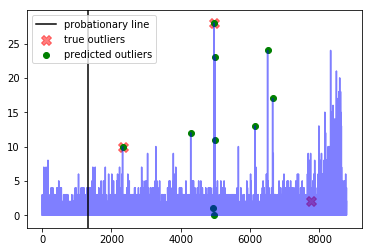




--- nyc_taxi ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  5


Outlier indices as determined by best window threshold:  []


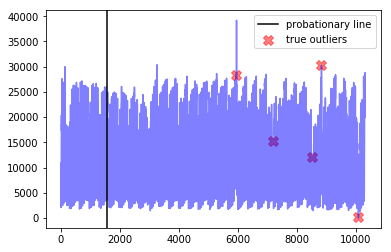




--- exchange-2_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [1016]


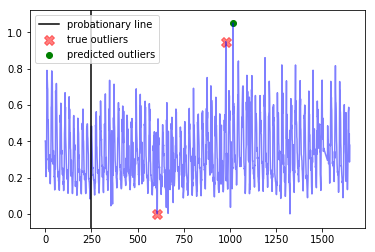




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


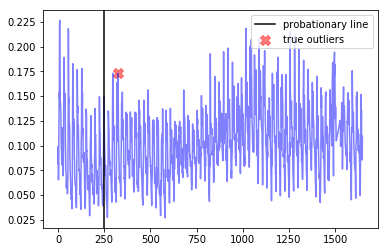




--- international-airline-passengers ---
Corresponding window precision:  0.5
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [76, 88, 100]


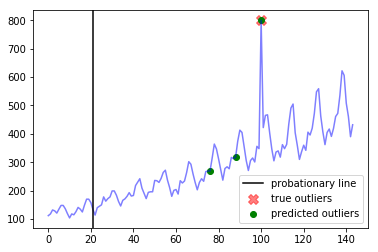




--- exchange-3_cpc_results ---
Corresponding window precision:  0.6666666666666666
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [322, 323, 466, 467, 1194]


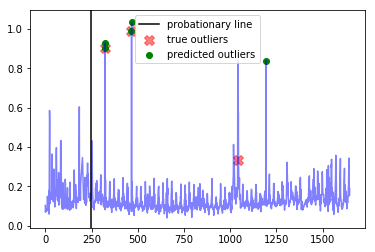

---------weight_fp=0.9, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  22.299999999999997
Best window threshold:  1.0
Corresponding window overall precision:  0.5714285714285714
Corresponding window overall recall:  0.34782608695652173
Corresponding window overall F score:  0.4324324324324324



--- elb_request_count_8c0756 ---
Corresponding window precision:  1.0
Corresponding window recall:  0.5
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [3690]


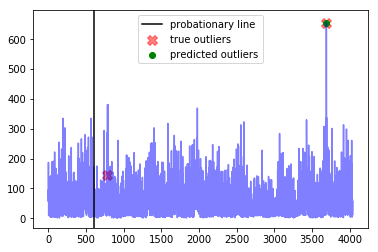




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


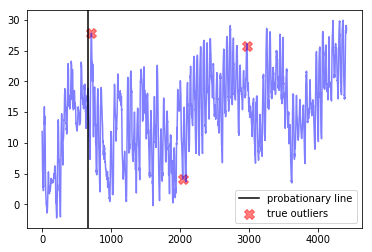




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1170, 1193, 1194, 1218]


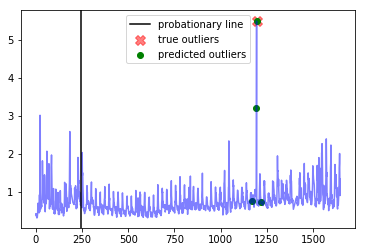




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


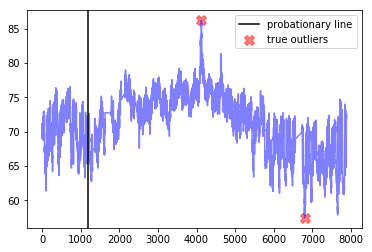




--- all_data_gift_certificates ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  4
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [2320, 4286, 4939, 4962, 4963, 4986, 4992, 6137, 6505, 6650]


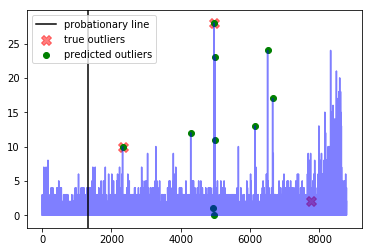




--- nyc_taxi ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  5


Outlier indices as determined by best window threshold:  []


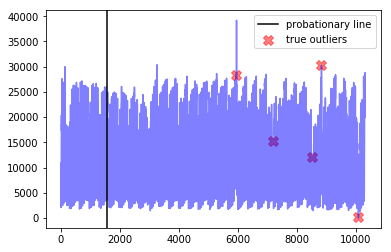




--- exchange-2_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [1016]


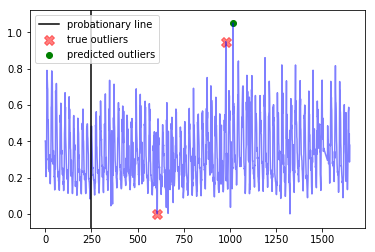




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


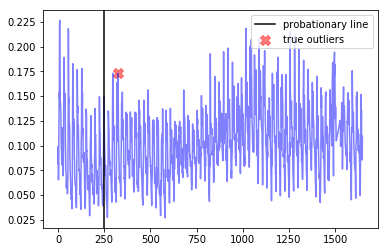




--- international-airline-passengers ---
Corresponding window precision:  0.5
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [76, 88, 100]


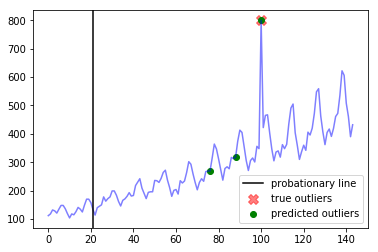




--- exchange-3_cpc_results ---
Corresponding window precision:  0.6666666666666666
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [322, 323, 466, 467, 1194]


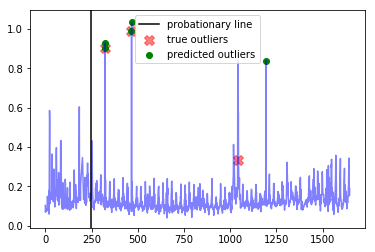

---------weight_fp=1.0, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  23.0
Best window threshold:  1.0
Corresponding window overall precision:  0.5714285714285714
Corresponding window overall recall:  0.34782608695652173
Corresponding window overall F score:  0.4324324324324324



--- elb_request_count_8c0756 ---
Corresponding window precision:  1.0
Corresponding window recall:  0.5
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [3690]


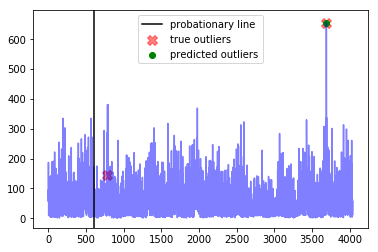




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


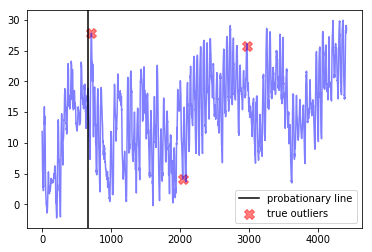




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1170, 1193, 1194, 1218]


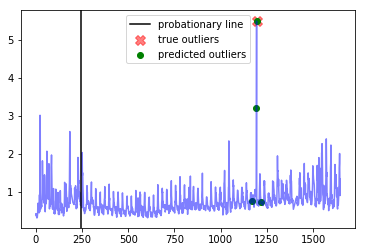




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


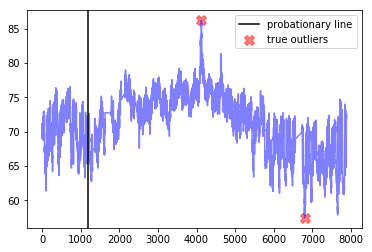




--- all_data_gift_certificates ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  4
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [2320, 4286, 4939, 4962, 4963, 4986, 4992, 6137, 6505, 6650]


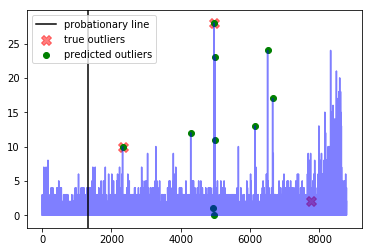




--- nyc_taxi ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  5


Outlier indices as determined by best window threshold:  []


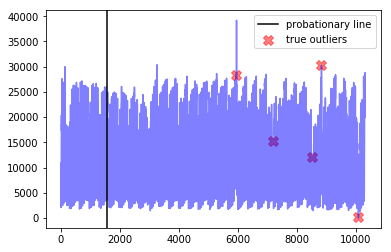




--- exchange-2_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [1016]


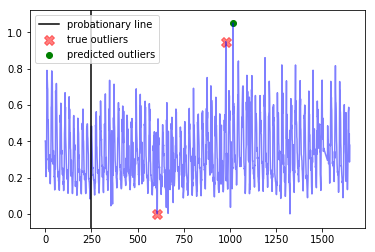




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


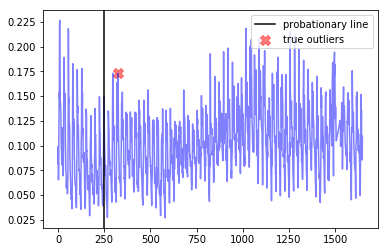




--- international-airline-passengers ---
Corresponding window precision:  0.5
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [76, 88, 100]


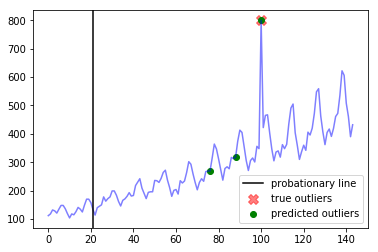




--- exchange-3_cpc_results ---
Corresponding window precision:  0.6666666666666666
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [322, 323, 466, 467, 1194]


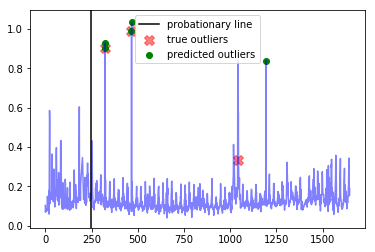

------------
False Positive Weight:  0.1
	 Minimum number of mistakes : 10.7
	 Corresponding window overall recall : 0.7391304347826086
	 Corresponding window overall precision : 0.22666666666666666
	 Corresponding window overall F score : 0.346938775510204
	 Best window threshold : 0.9999
False Positive Weight:  0.2
	 Minimum number of mistakes : 16.4
	 Corresponding window overall recall : 0.7391304347826086
	 Corresponding window overall precision : 0.22666666666666666
	 Corresponding window overall F score : 0.346938775510204
	 Best window threshold : 0.9999
False Positive Weight:  0.3
	 Minimum number of mistakes : 18.1
	 Corresponding window overall recall : 0.34782608695652173
	 Corresponding window overall precision : 0.5714285714285714
	 Corresponding window overall F score : 0.4324324324324324
	 Best window threshold : 1.0
False Positive Weight:  0.6
	 Minimum number of mistakes : 20.200000000000003
	 Corresponding window overall recall : 0.34782608695652173
	 Corresponding w

In [39]:
end_results = {}
for weight_fp in weight_fp_list:  
    print("---------weight_fp=" + str(weight_fp) + ", weight_fn=1----------")
    weight_result = adclasses.pretty_print_results(ad_dict, anomaly_scores_dict, true_outlier_indices_dict, weight_fp=weight_fp, weight_fn=1)
    end_results[weight_fp] = weight_result

print("------------")
adclasses.pretty_print_end_results(end_results)

# windowed gaussian Results

In [40]:
anomaly_scores_dict = {}

for dataset_name in dataset_name_list:
    output_dict_htm = joblib.load("anomaly_scores/windowed_gaussian/" + dataset_name)
    anomaly_scores_dict[dataset_name] = output_dict_htm["Anomaly Scores"]

In [41]:
adclasses.precision_recall_curve_info(anomaly_scores_dict, true_outlier_indices_dict)

{0.1: {'precision': 0.11538461538461539, 'recall': 1.0},
 0.2: {'precision': 0.11538461538461539, 'recall': 1.0},
 0.3: {'precision': 0.11538461538461539, 'recall': 1.0},
 0.4: {'precision': 0.11538461538461539, 'recall': 1.0},
 0.5: {'precision': 0.11538461538461539, 'recall': 1.0},
 0.6: {'precision': 0.11538461538461539, 'recall': 1.0},
 0.7: {'precision': 0.11538461538461539, 'recall': 1.0},
 0.8: {'precision': 0.12, 'recall': 1.0},
 0.9: {'precision': 0.23076923076923078, 'recall': 1.0},
 1.0: {'precision': 0.75, 'recall': 1.0}}

---------weight_fp=0.1, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  13.8
Best window threshold:  0.9795
Corresponding window overall precision:  0.145985401459854
Corresponding window overall recall:  0.8695652173913043
Corresponding window overall F score:  0.25



--- elb_request_count_8c0756 ---
Corresponding window precision:  0.125
Corresponding window recall:  1.0
Corresponding window false positives:  14
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [741, 783, 786, 788, 789, 790, 791, 842, 926, 1038, 1042, 1045, 1056, 1066, 1070, 1087, 1140, 1217, 1300, 1307, 1312, 1321, 1322, 1323, 1342, 1359, 1361, 1374, 1388, 1395, 1400, 1403, 1406, 1407, 1418, 1454, 1506, 1526, 1585, 1586, 1604, 1633, 1634, 1664, 1671, 1672, 1679, 1687, 1690, 1691, 1700, 1702, 1729, 1763, 1783, 1846, 1856, 1876, 1909, 1912, 1914, 1929, 1938, 1955, 1956, 1973, 1977, 1978, 1979, 1983, 1993, 2020, 2092, 2138, 2144, 2176,

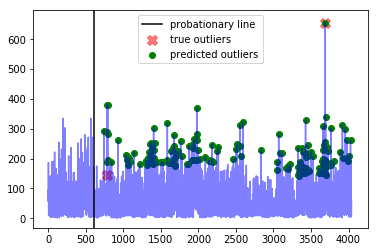




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.08333333333333333
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  11
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [708, 709, 710, 711, 712, 713, 714, 715, 716, 717, 718, 1605, 1606, 1607, 2197, 2198, 2199, 2200, 2201, 2202, 2203, 2204, 2205, 2206, 2207, 2208, 2245, 2246, 2247, 2248, 2249, 2250, 2251, 2252, 2253, 2254, 2291, 2292, 2293, 2294, 2295, 2296, 2297, 2298, 2299, 2300, 2301, 2302, 2303, 2304, 2337, 2338, 2339, 2340, 2341, 2342, 2343, 2344, 2345, 2346, 2347, 2348, 2349, 2350, 2351, 2386, 2387, 2388, 2389, 2390, 2391, 2392, 2393, 2394, 2395, 2396, 2434, 2435, 2436, 2437, 2438, 2439, 2440, 2441, 2442, 2443, 2681, 2682, 2683, 2684, 2685, 2720, 2721, 2722, 2723, 2724, 2725, 2726, 2727, 2728, 2729, 2730, 2731, 2732, 3093, 3094, 3134, 3135, 3136, 3137, 3138, 3139, 3140, 3189, 3254, 3255, 3256, 3257, 3258, 3259, 3604,

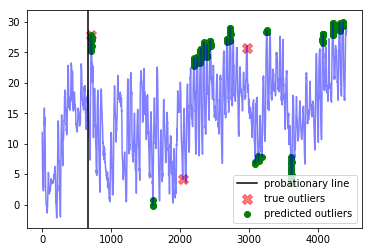




--- exchange-3_cpm_results ---
Corresponding window precision:  0.14285714285714285
Corresponding window recall:  1.0
Corresponding window false positives:  6
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [251, 780, 836, 901, 948, 1020, 1021, 1022, 1044, 1045, 1046, 1068, 1139, 1193, 1194, 1211, 1212, 1235, 1237, 1281, 1306, 1307, 1308, 1309, 1310, 1313, 1329, 1356, 1377, 1379, 1380, 1382, 1426, 1428, 1450, 1452, 1473, 1474, 1475, 1477, 1498, 1499, 1500, 1501, 1502, 1521, 1522, 1524, 1531, 1536, 1544, 1545, 1546, 1547, 1548, 1549, 1550, 1569, 1570, 1571, 1572, 1573, 1574, 1594, 1595, 1596, 1597, 1617, 1618, 1641, 1642, 1643]


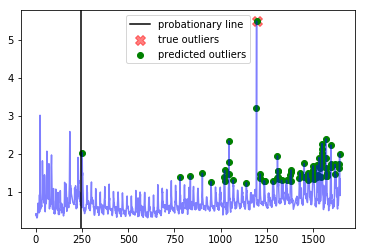




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.13333333333333333
Corresponding window recall:  1.0
Corresponding window false positives:  13
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1254, 1255, 1256, 1257, 1258, 1260, 1261, 1262, 1263, 1264, 1265, 1266, 1269, 1270, 1271, 1272, 1274, 1275, 1276, 1277, 1278, 1279, 1280, 1300, 1303, 2010, 2013, 2014, 2015, 2017, 2032, 2034, 2035, 2036, 2037, 2038, 2039, 2040, 2041, 2042, 2043, 2044, 2045, 2046, 2049, 2051, 2153, 2154, 2155, 2157, 2158, 2159, 2160, 2161, 2162, 2163, 2164, 2166, 2167, 2168, 2170, 2173, 2174, 2175, 2176, 2177, 2179, 2181, 2182, 2183, 2185, 2187, 2206, 2207, 2210, 2211, 2212, 2221, 2255, 3025, 3247, 3255, 3270, 3274, 3275, 3276, 3279, 3283, 3294, 3296, 3297, 3298, 3299, 3355, 3357, 3358, 3359, 3360, 3503, 3504, 3507, 3508, 3509, 3510, 3527, 3529, 3530, 3532, 3533, 3535, 3552, 3553, 3554, 3555, 3556, 3557, 3558, 3559, 3562, 3564, 3566

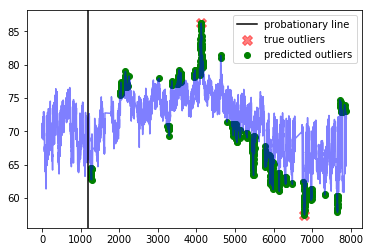




--- all_data_gift_certificates ---
Corresponding window precision:  0.12
Corresponding window recall:  1.0
Corresponding window false positives:  22
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1318, 1323, 1338, 1343, 1348, 1385, 1386, 1409, 1435, 1438, 1439, 1441, 1461, 1462, 1465, 1481, 1483, 1487, 1489, 1505, 1506, 1508, 1531, 1532, 1537, 1581, 1600, 1601, 1627, 1634, 1636, 1662, 1679, 1686, 1700, 1701, 1702, 1723, 1770, 1795, 1797, 1816, 1820, 1822, 1841, 1914, 1918, 1919, 1935, 1967, 1988, 2009, 2059, 2104, 2106, 2111, 2130, 2134, 2153, 2157, 2175, 2176, 2199, 2201, 2233, 2271, 2276, 2304, 2320, 2324, 2325, 2354, 2368, 2392, 2443, 2469, 2470, 2471, 2475, 2488, 2491, 2514, 2539, 2564, 2587, 2612, 2631, 2637, 2656, 2666, 2667, 2681, 2682, 2705, 2733, 2753, 2777, 2778, 2803, 2807, 2825, 2826, 2848, 2851, 2852, 2871, 2894, 2899, 2905, 2931, 2945, 2949, 2972, 2974, 2995, 3013, 3014, 3015, 3016, 3024, 3029, 3041, 3042, 3045, 304

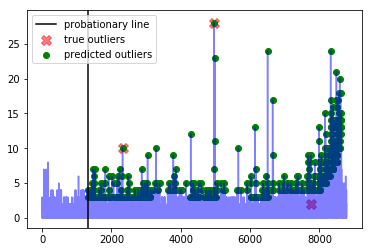




--- nyc_taxi ---
Corresponding window precision:  0.4444444444444444
Corresponding window recall:  0.8
Corresponding window false positives:  5
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [3031, 3206, 3261, 3262, 3263, 5954, 5955, 8507, 8554, 8833, 8834, 8835, 9254, 9255, 9302, 9304, 9309, 9310, 9311, 9591, 10078, 10079, 10080, 10081, 10082, 10083, 10084, 10085, 10086, 10087, 10088, 10089, 10090, 10091, 10092, 10093, 10094, 10095, 10096]


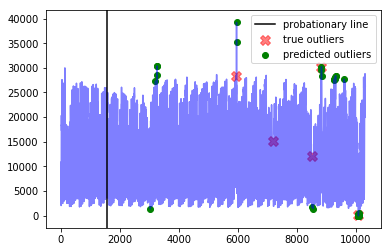




--- exchange-2_cpm_results ---
Corresponding window precision:  0.11764705882352941
Corresponding window recall:  1.0
Corresponding window false positives:  15
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [325, 348, 372, 492, 514, 606, 664, 665, 802, 876, 896, 900, 923, 976, 977, 978, 994, 996, 1016, 1042, 1043, 1044, 1045, 1046, 1067, 1068, 1069, 1070, 1091, 1095, 1104, 1115, 1116, 1117, 1118, 1137, 1162, 1185, 1188, 1189, 1212, 1213, 1256, 1280, 1281, 1282, 1286, 1305, 1324, 1354, 1379, 1426, 1449, 1496, 1497, 1498, 1545, 1570, 1593, 1595]


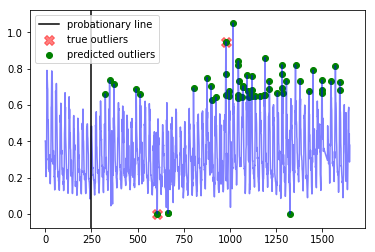




--- exchange-2_cpc_results ---
Corresponding window precision:  0.14285714285714285
Corresponding window recall:  1.0
Corresponding window false positives:  6
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [296, 325, 680, 824, 825, 848, 872, 896, 920, 944, 951, 975, 992, 993, 1016, 1017, 1021, 1039, 1040, 1041, 1044, 1045, 1046, 1047, 1048, 1062, 1063, 1064, 1070, 1087, 1088, 1094, 1095, 1111, 1112, 1117, 1118, 1160, 1184, 1189, 1213, 1232, 1256, 1280, 1281, 1304, 1305, 1329, 1352, 1354, 1400, 1485, 1486, 1487, 1494, 1495, 1496, 1497, 1498, 1592]


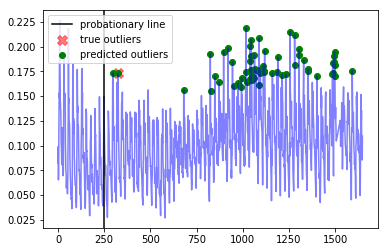




--- international-airline-passengers ---
Corresponding window precision:  0.1111111111111111
Corresponding window recall:  1.0
Corresponding window false positives:  8
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [26, 30, 31, 41, 42, 43, 50, 51, 53, 54, 55, 65, 66, 67, 77, 78, 79, 80, 89, 90, 91, 92, 100, 101, 102, 103, 104, 113, 114, 115, 116, 122, 123, 124, 125, 126, 127, 128, 129, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143]


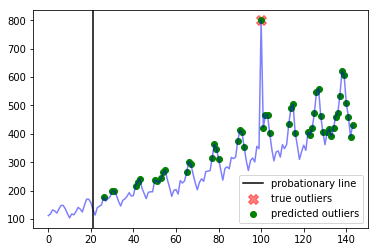




--- exchange-3_cpc_results ---
Corresponding window precision:  0.2727272727272727
Corresponding window recall:  1.0
Corresponding window false positives:  8
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [251, 322, 323, 466, 467, 1018, 1019, 1022, 1041, 1042, 1043, 1044, 1045, 1193, 1194, 1307, 1452, 1473, 1498, 1522, 1531, 1536, 1546, 1547, 1548, 1549, 1570, 1571, 1572, 1594, 1595, 1596, 1617, 1618, 1641, 1642, 1643]


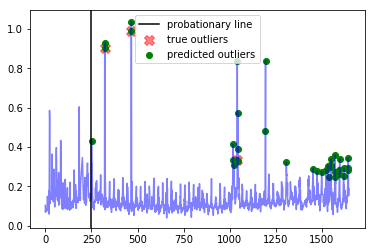

---------weight_fp=0.2, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  17.4
Best window threshold:  1.0
Corresponding window overall precision:  0.4375
Corresponding window overall recall:  0.30434782608695654
Corresponding window overall F score:  0.358974358974359



--- elb_request_count_8c0756 ---
Corresponding window precision:  1.0
Corresponding window recall:  0.5
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [3690]


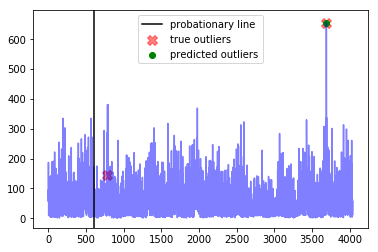




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


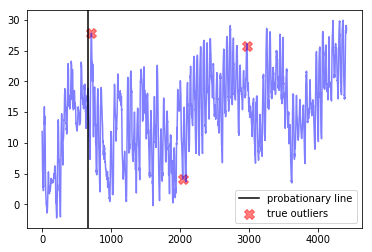




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1193, 1194]


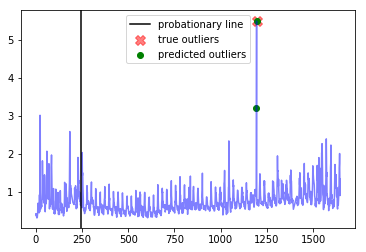




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


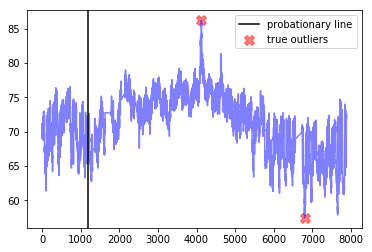




--- all_data_gift_certificates ---
Corresponding window precision:  0.25
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  6
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [2320, 4286, 4963, 4986, 4992, 6137, 6505, 6650, 7985, 8157, 8324]


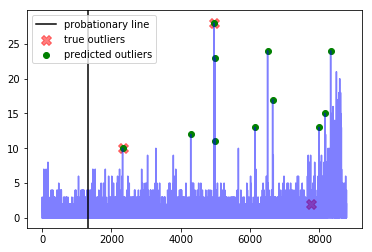




--- nyc_taxi ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  5


Outlier indices as determined by best window threshold:  []


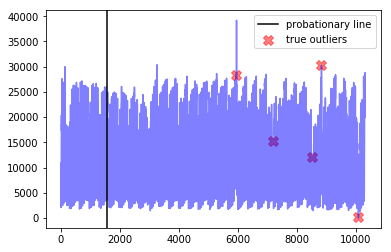




--- exchange-2_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


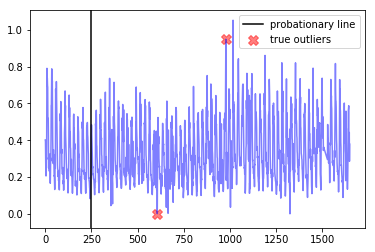




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


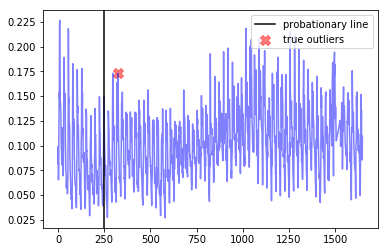




--- international-airline-passengers ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


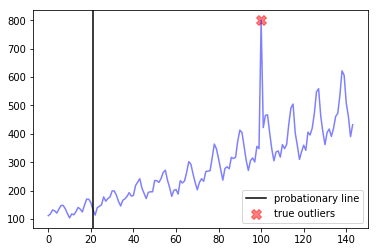




--- exchange-3_cpc_results ---
Corresponding window precision:  0.75
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [322, 323, 466, 467, 1041, 1194]


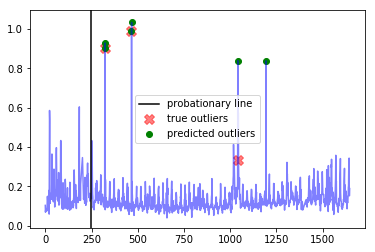

---------weight_fp=0.3, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  18.1
Best window threshold:  1.0
Corresponding window overall precision:  0.4375
Corresponding window overall recall:  0.30434782608695654
Corresponding window overall F score:  0.358974358974359



--- elb_request_count_8c0756 ---
Corresponding window precision:  1.0
Corresponding window recall:  0.5
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [3690]


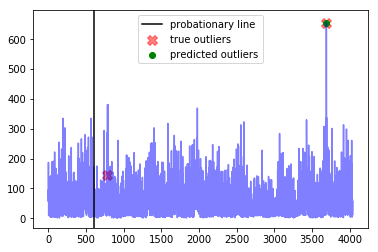




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


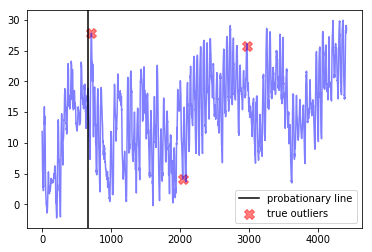




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1193, 1194]


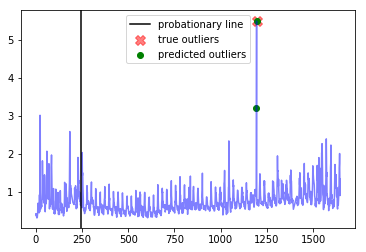




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


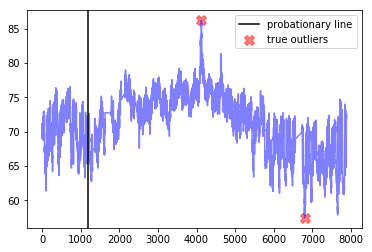




--- all_data_gift_certificates ---
Corresponding window precision:  0.25
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  6
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [2320, 4286, 4963, 4986, 4992, 6137, 6505, 6650, 7985, 8157, 8324]


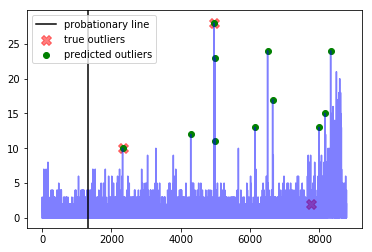




--- nyc_taxi ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  5


Outlier indices as determined by best window threshold:  []


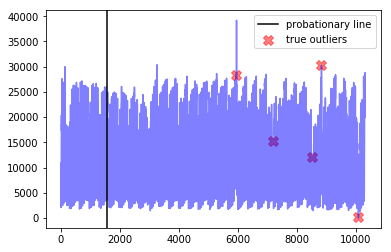




--- exchange-2_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


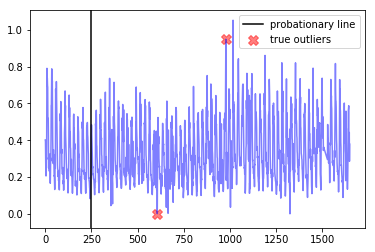




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


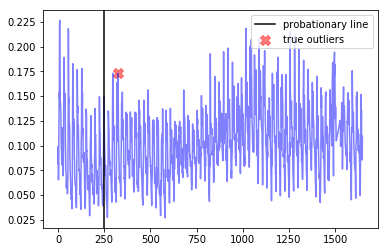




--- international-airline-passengers ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


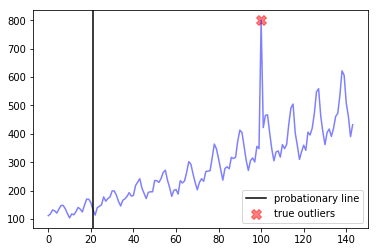




--- exchange-3_cpc_results ---
Corresponding window precision:  0.75
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [322, 323, 466, 467, 1041, 1194]


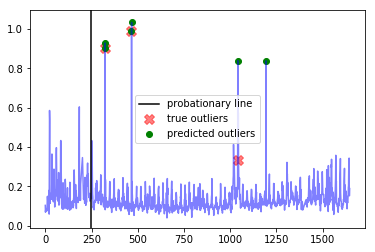

---------weight_fp=0.4, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  18.799999999999997
Best window threshold:  1.0
Corresponding window overall precision:  0.4375
Corresponding window overall recall:  0.30434782608695654
Corresponding window overall F score:  0.358974358974359



--- elb_request_count_8c0756 ---
Corresponding window precision:  1.0
Corresponding window recall:  0.5
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [3690]


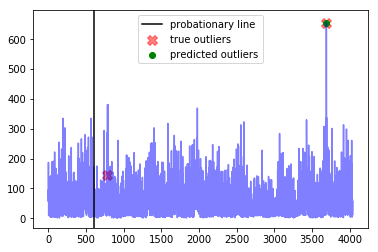




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


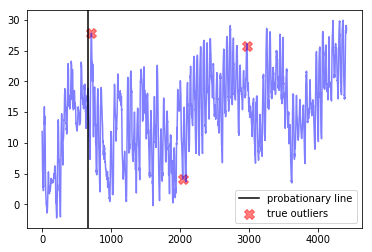




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1193, 1194]


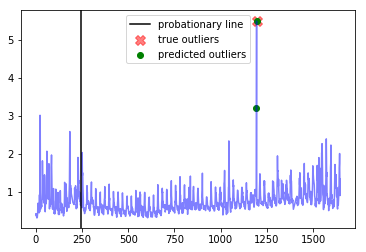




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


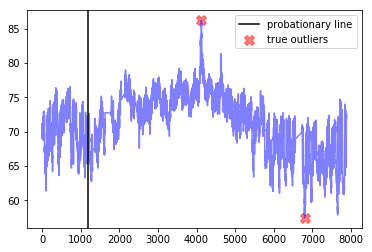




--- all_data_gift_certificates ---
Corresponding window precision:  0.25
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  6
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [2320, 4286, 4963, 4986, 4992, 6137, 6505, 6650, 7985, 8157, 8324]


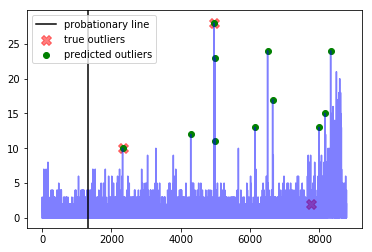




--- nyc_taxi ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  5


Outlier indices as determined by best window threshold:  []


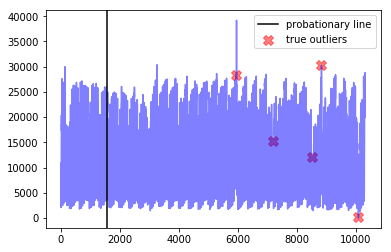




--- exchange-2_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


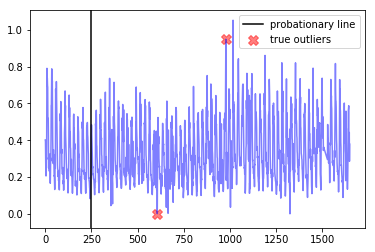




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


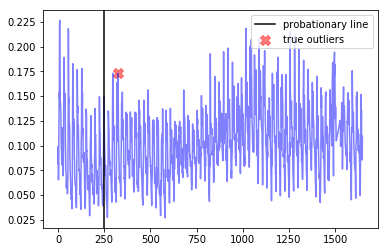




--- international-airline-passengers ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


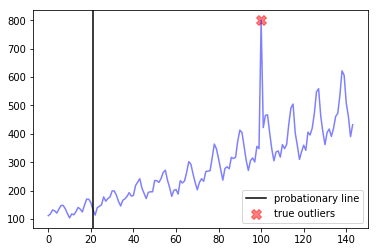




--- exchange-3_cpc_results ---
Corresponding window precision:  0.75
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [322, 323, 466, 467, 1041, 1194]


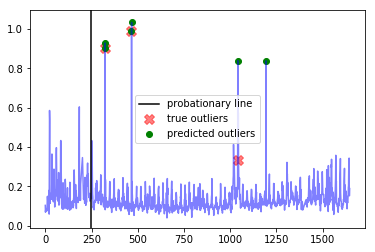

---------weight_fp=0.5, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  19.5
Best window threshold:  1.0
Corresponding window overall precision:  0.4375
Corresponding window overall recall:  0.30434782608695654
Corresponding window overall F score:  0.358974358974359



--- elb_request_count_8c0756 ---
Corresponding window precision:  1.0
Corresponding window recall:  0.5
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [3690]


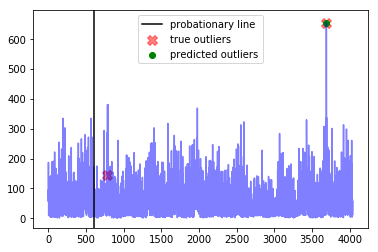




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


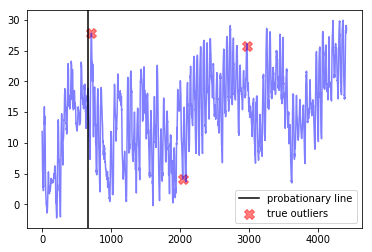




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1193, 1194]


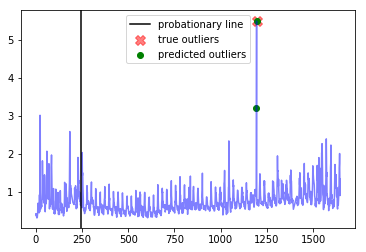




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


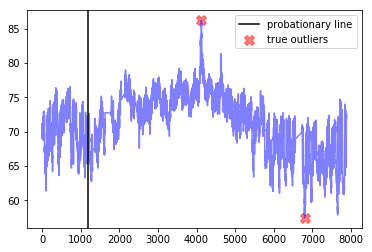




--- all_data_gift_certificates ---
Corresponding window precision:  0.25
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  6
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [2320, 4286, 4963, 4986, 4992, 6137, 6505, 6650, 7985, 8157, 8324]


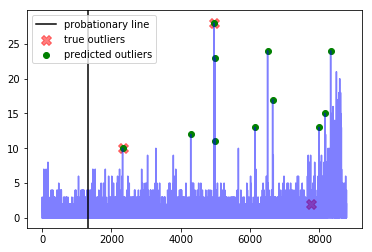




--- nyc_taxi ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  5


Outlier indices as determined by best window threshold:  []


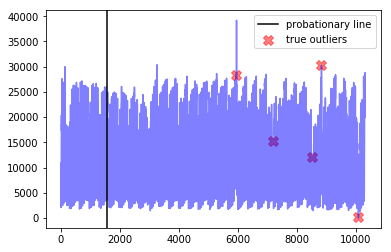




--- exchange-2_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


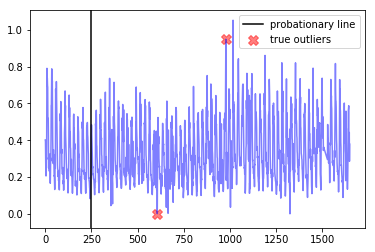




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


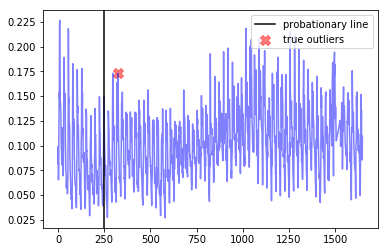




--- international-airline-passengers ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


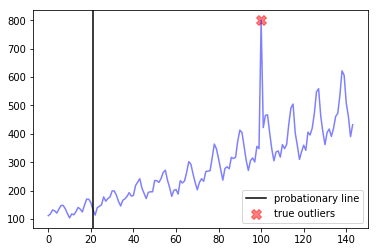




--- exchange-3_cpc_results ---
Corresponding window precision:  0.75
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [322, 323, 466, 467, 1041, 1194]


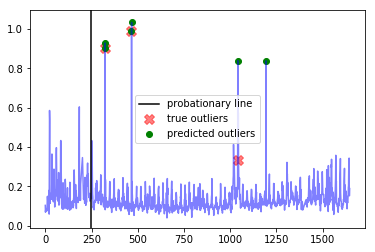

---------weight_fp=0.6, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  20.200000000000003
Best window threshold:  1.0
Corresponding window overall precision:  0.4375
Corresponding window overall recall:  0.30434782608695654
Corresponding window overall F score:  0.358974358974359



--- elb_request_count_8c0756 ---
Corresponding window precision:  1.0
Corresponding window recall:  0.5
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [3690]


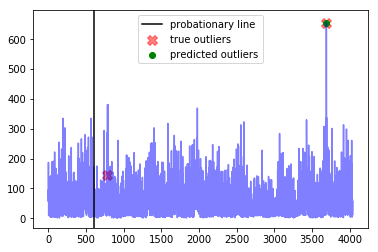




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


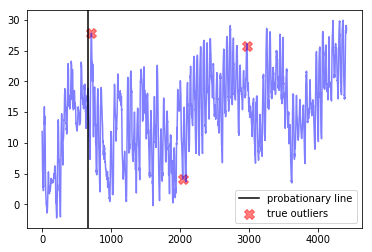




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1193, 1194]


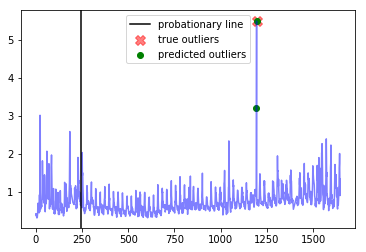




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


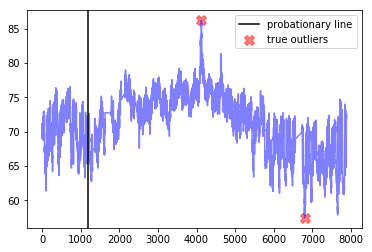




--- all_data_gift_certificates ---
Corresponding window precision:  0.25
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  6
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [2320, 4286, 4963, 4986, 4992, 6137, 6505, 6650, 7985, 8157, 8324]


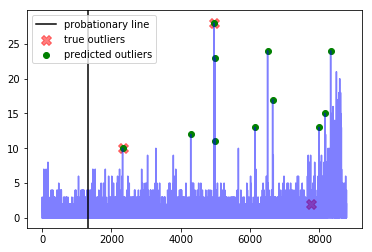




--- nyc_taxi ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  5


Outlier indices as determined by best window threshold:  []


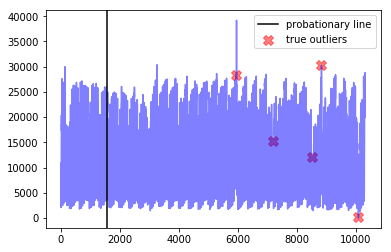




--- exchange-2_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


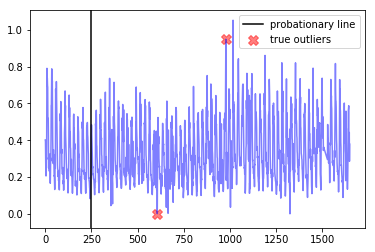




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


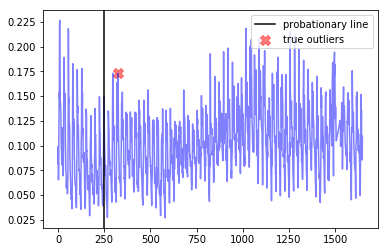




--- international-airline-passengers ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


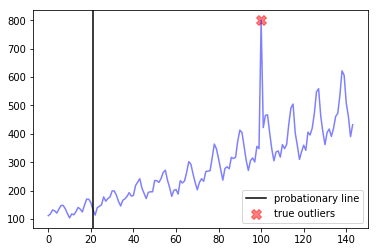




--- exchange-3_cpc_results ---
Corresponding window precision:  0.75
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [322, 323, 466, 467, 1041, 1194]


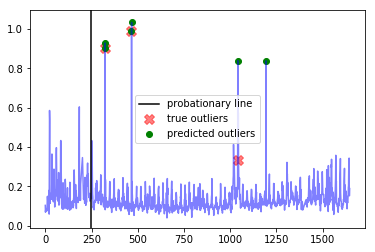

---------weight_fp=0.7, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  20.9
Best window threshold:  1.0
Corresponding window overall precision:  0.4375
Corresponding window overall recall:  0.30434782608695654
Corresponding window overall F score:  0.358974358974359



--- elb_request_count_8c0756 ---
Corresponding window precision:  1.0
Corresponding window recall:  0.5
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [3690]


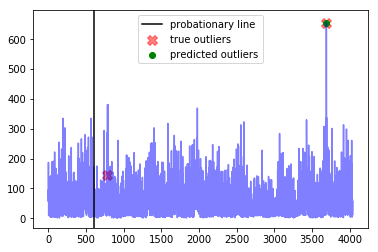




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


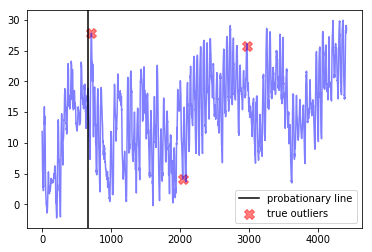




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1193, 1194]


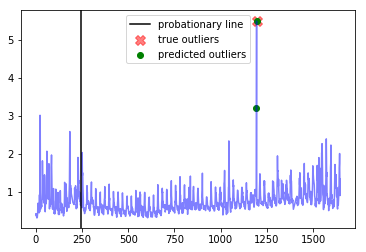




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


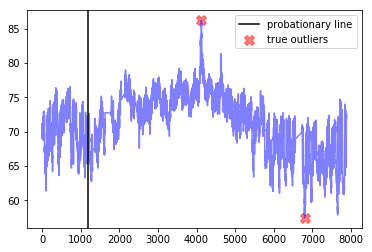




--- all_data_gift_certificates ---
Corresponding window precision:  0.25
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  6
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [2320, 4286, 4963, 4986, 4992, 6137, 6505, 6650, 7985, 8157, 8324]


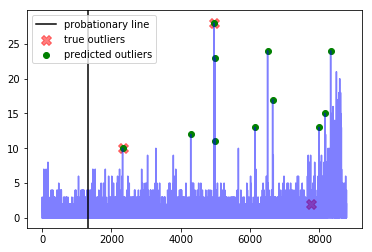




--- nyc_taxi ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  5


Outlier indices as determined by best window threshold:  []


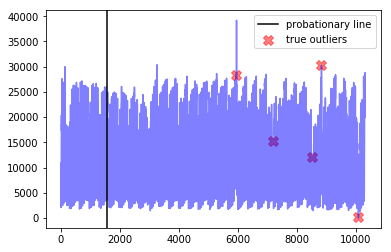




--- exchange-2_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


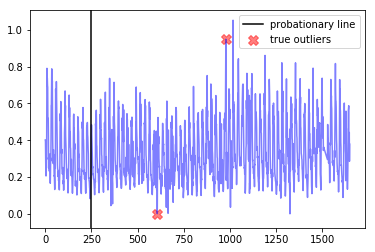




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


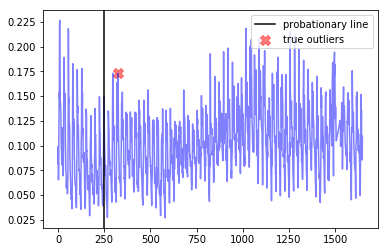




--- international-airline-passengers ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


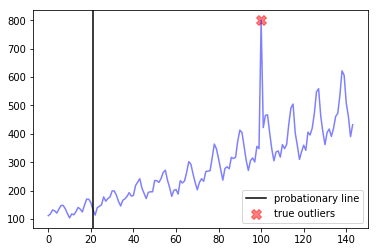




--- exchange-3_cpc_results ---
Corresponding window precision:  0.75
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [322, 323, 466, 467, 1041, 1194]


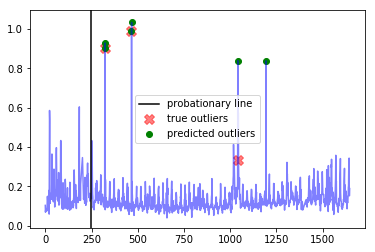

---------weight_fp=0.8, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  21.6
Best window threshold:  1.0
Corresponding window overall precision:  0.4375
Corresponding window overall recall:  0.30434782608695654
Corresponding window overall F score:  0.358974358974359



--- elb_request_count_8c0756 ---
Corresponding window precision:  1.0
Corresponding window recall:  0.5
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [3690]


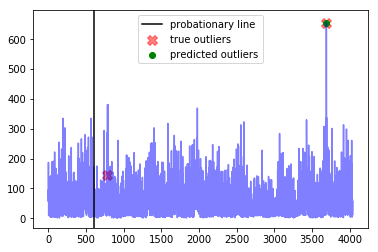




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


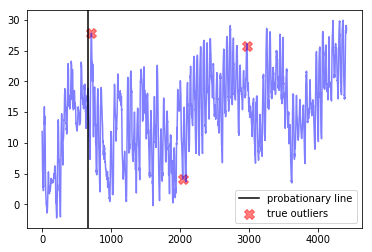




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1193, 1194]


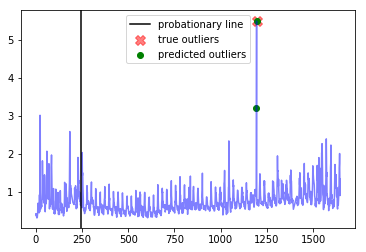




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


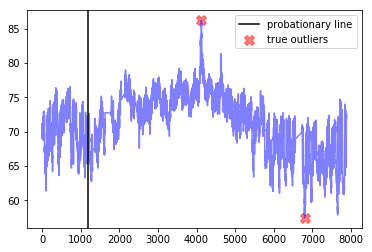




--- all_data_gift_certificates ---
Corresponding window precision:  0.25
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  6
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [2320, 4286, 4963, 4986, 4992, 6137, 6505, 6650, 7985, 8157, 8324]


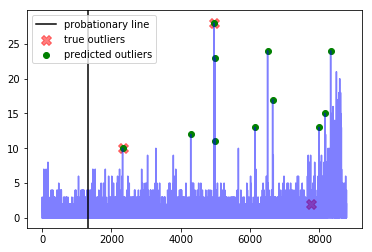




--- nyc_taxi ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  5


Outlier indices as determined by best window threshold:  []


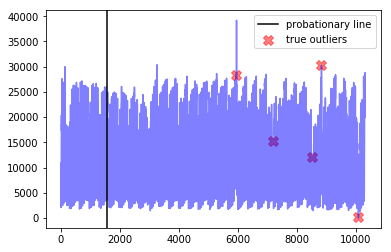




--- exchange-2_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


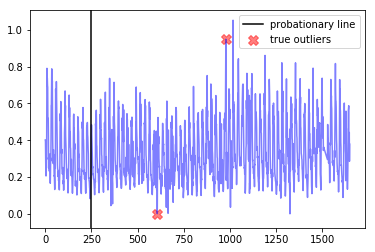




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


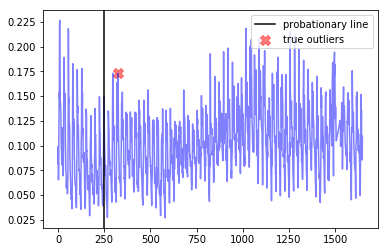




--- international-airline-passengers ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


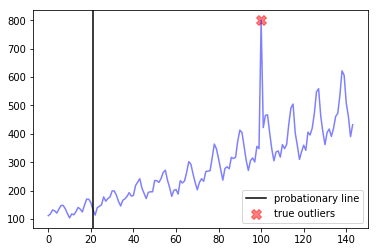




--- exchange-3_cpc_results ---
Corresponding window precision:  0.75
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [322, 323, 466, 467, 1041, 1194]


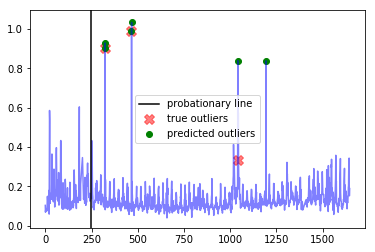

---------weight_fp=0.9, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  22.299999999999997
Best window threshold:  1.0
Corresponding window overall precision:  0.4375
Corresponding window overall recall:  0.30434782608695654
Corresponding window overall F score:  0.358974358974359



--- elb_request_count_8c0756 ---
Corresponding window precision:  1.0
Corresponding window recall:  0.5
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [3690]


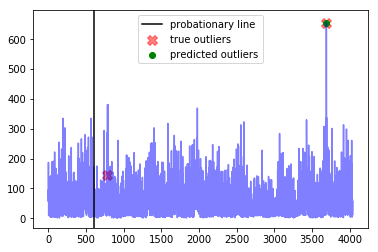




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


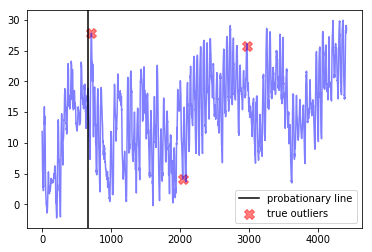




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1193, 1194]


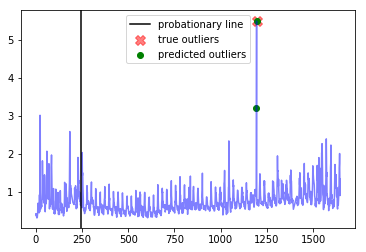




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


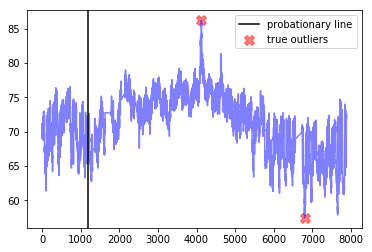




--- all_data_gift_certificates ---
Corresponding window precision:  0.25
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  6
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [2320, 4286, 4963, 4986, 4992, 6137, 6505, 6650, 7985, 8157, 8324]


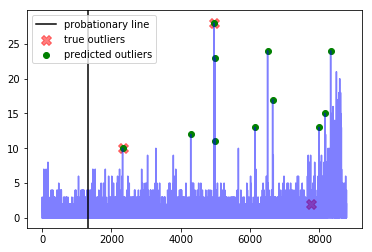




--- nyc_taxi ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  5


Outlier indices as determined by best window threshold:  []


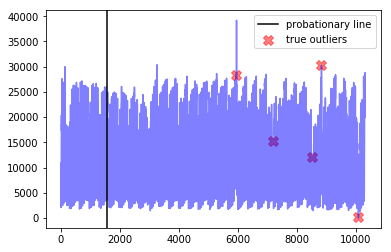




--- exchange-2_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


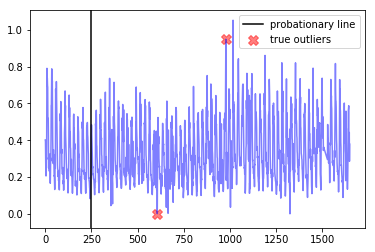




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


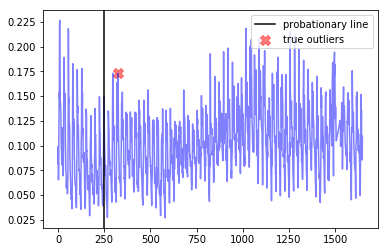




--- international-airline-passengers ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


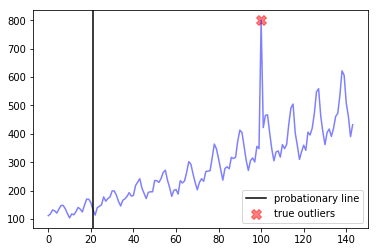




--- exchange-3_cpc_results ---
Corresponding window precision:  0.75
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [322, 323, 466, 467, 1041, 1194]


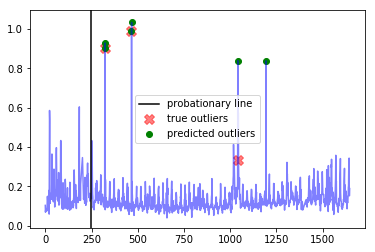

---------weight_fp=1.0, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  23.0
Best window threshold:  1.0
Corresponding window overall precision:  0.4375
Corresponding window overall recall:  0.30434782608695654
Corresponding window overall F score:  0.358974358974359



--- elb_request_count_8c0756 ---
Corresponding window precision:  1.0
Corresponding window recall:  0.5
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [3690]


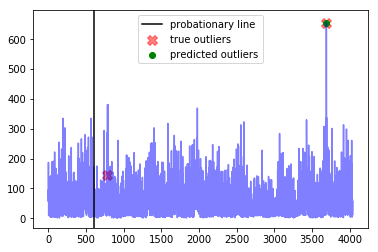




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


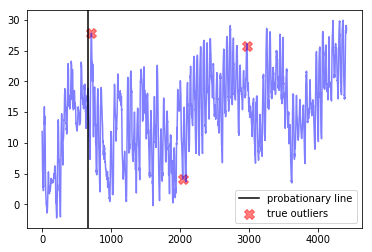




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1193, 1194]


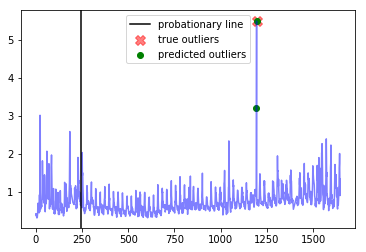




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


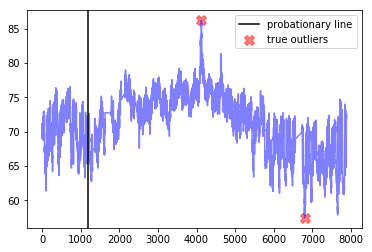




--- all_data_gift_certificates ---
Corresponding window precision:  0.25
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  6
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [2320, 4286, 4963, 4986, 4992, 6137, 6505, 6650, 7985, 8157, 8324]


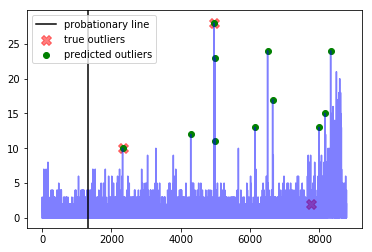




--- nyc_taxi ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  5


Outlier indices as determined by best window threshold:  []


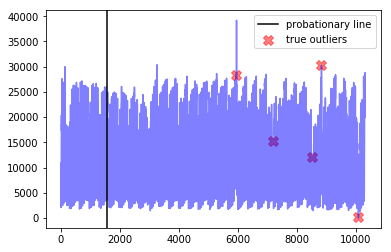




--- exchange-2_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


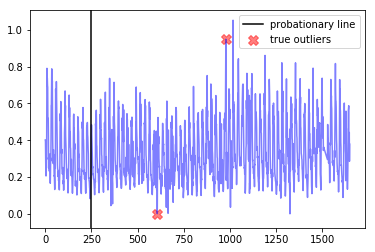




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


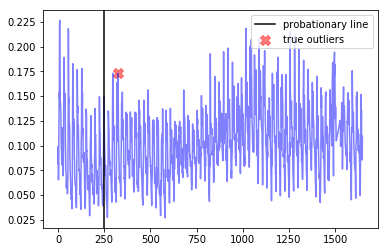




--- international-airline-passengers ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


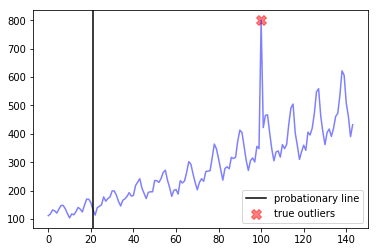




--- exchange-3_cpc_results ---
Corresponding window precision:  0.75
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [322, 323, 466, 467, 1041, 1194]


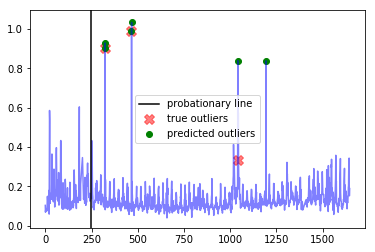

------------
False Positive Weight:  0.1
	 Minimum number of mistakes : 13.8
	 Corresponding window overall recall : 0.8695652173913043
	 Corresponding window overall precision : 0.145985401459854
	 Corresponding window overall F score : 0.25
	 Best window threshold : 0.9795
False Positive Weight:  0.2
	 Minimum number of mistakes : 17.4
	 Corresponding window overall recall : 0.30434782608695654
	 Corresponding window overall precision : 0.4375
	 Corresponding window overall F score : 0.358974358974359
	 Best window threshold : 1.0
False Positive Weight:  0.3
	 Minimum number of mistakes : 18.1
	 Corresponding window overall recall : 0.30434782608695654
	 Corresponding window overall precision : 0.4375
	 Corresponding window overall F score : 0.358974358974359
	 Best window threshold : 1.0
False Positive Weight:  0.6
	 Minimum number of mistakes : 20.200000000000003
	 Corresponding window overall recall : 0.30434782608695654
	 Corresponding window overall precision : 0.4375
	 Correspo

In [42]:
end_results = {}
for weight_fp in weight_fp_list:  
    print("---------weight_fp=" + str(weight_fp) + ", weight_fn=1----------")
    weight_result = adclasses.pretty_print_results(ad_dict, anomaly_scores_dict, true_outlier_indices_dict, weight_fp=weight_fp, weight_fn=1)
    end_results[weight_fp] = weight_result

print("------------")
adclasses.pretty_print_end_results(end_results)

# HOTSAX Results

In [43]:
anomaly_scores_dict = {}

for dataset_name in dataset_name_list:
    output_dict_htm = joblib.load("anomaly_scores/hotsax/" + dataset_name)
    anomaly_scores_dict[dataset_name] = output_dict_htm["Anomaly Scores"]

In [44]:
adclasses.precision_recall_curve_info(anomaly_scores_dict, true_outlier_indices_dict)

{0.1: {'precision': 0.0, 'recall': 0.0},
 0.2: {'precision': 0.0, 'recall': 0.0},
 0.3: {'precision': 0.0, 'recall': 0.0},
 0.4: {'precision': 0.0, 'recall': 0.0},
 0.5: {'precision': 0.0, 'recall': 0.0},
 0.6: {'precision': 0.0, 'recall': 0.0},
 0.7: {'precision': 0.0, 'recall': 0.0},
 0.8: {'precision': 0.0, 'recall': 0.0},
 0.9: {'precision': 0.0, 'recall': 0.0},
 1.0: {'precision': 0.0, 'recall': 0.0}}

---------weight_fp=0.1, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  17.800000000000004
Best window threshold:  0.0
Corresponding window overall precision:  0.11442786069651742
Corresponding window overall recall:  1.0
Corresponding window overall F score:  0.20535714285714285



--- elb_request_count_8c0756 ---
Corresponding window precision:  0.11764705882352941
Corresponding window recall:  1.0
Corresponding window false positives:  15
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [606, 607, 608, 609, 610, 611, 612, 613, 614, 615, 616, 617, 618, 619, 620, 621, 622, 623, 624, 625, 626, 627, 628, 629, 630, 631, 632, 633, 634, 635, 636, 637, 638, 639, 640, 641, 642, 643, 644, 645, 646, 647, 648, 649, 650, 651, 652, 653, 654, 655, 656, 657, 658, 659, 660, 661, 662, 663, 664, 665, 666, 667, 668, 669, 670, 671, 672, 673, 674, 675, 676, 677, 678, 679, 680, 681, 682, 683, 684, 685, 686, 687, 688, 689,

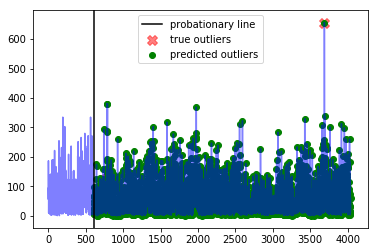




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.11538461538461539
Corresponding window recall:  1.0
Corresponding window false positives:  23
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [662, 663, 664, 665, 666, 667, 668, 669, 670, 671, 672, 673, 674, 675, 676, 677, 678, 679, 680, 681, 682, 683, 684, 685, 686, 687, 688, 689, 690, 691, 692, 693, 694, 695, 696, 697, 698, 699, 700, 701, 702, 703, 704, 705, 706, 707, 708, 709, 710, 711, 712, 713, 714, 715, 716, 717, 718, 719, 720, 721, 722, 723, 724, 725, 726, 727, 728, 729, 730, 731, 732, 733, 734, 735, 736, 737, 738, 739, 740, 741, 742, 743, 744, 745, 746, 747, 748, 749, 750, 751, 752, 753, 754, 755, 756, 757, 758, 759, 760, 761, 762, 763, 764, 765, 766, 767, 768, 769, 770, 771, 772, 773, 774, 775, 776, 777, 778, 779, 780, 781, 782, 783, 784, 785, 786, 787, 788, 789, 790, 791, 792, 793, 794, 795, 796, 797, 798, 799, 800, 801, 802, 803, 804, 805, 806, 807,

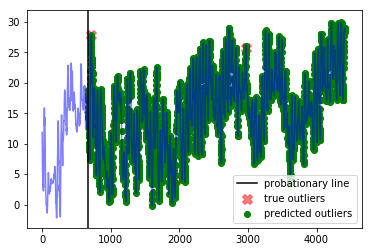




--- exchange-3_cpm_results ---
Corresponding window precision:  0.1111111111111111
Corresponding window recall:  1.0
Corresponding window false positives:  8
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [247, 248, 249, 250, 251, 252, 253, 254, 255, 256, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278, 279, 280, 281, 282, 283, 284, 285, 286, 287, 288, 289, 290, 291, 292, 293, 294, 295, 296, 297, 298, 299, 300, 301, 302, 303, 304, 305, 306, 307, 308, 309, 310, 311, 312, 313, 314, 315, 316, 317, 318, 319, 320, 321, 322, 323, 324, 325, 326, 327, 328, 329, 330, 331, 332, 333, 334, 335, 336, 337, 338, 339, 340, 341, 342, 343, 344, 345, 346, 347, 348, 349, 350, 351, 352, 353, 354, 355, 356, 357, 358, 359, 360, 361, 362, 363, 364, 365, 366, 367, 368, 369, 370, 371, 372, 373, 374, 375, 376, 377, 378, 379, 380, 381, 382, 383, 384, 385, 386, 387, 388, 389, 390, 391, 392, 393, 394

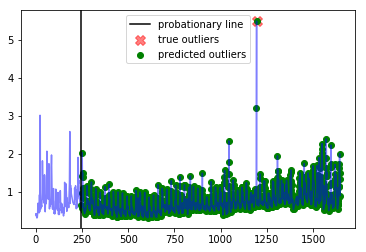




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.1111111111111111
Corresponding window recall:  1.0
Corresponding window false positives:  16
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1183, 1184, 1185, 1186, 1187, 1188, 1189, 1190, 1191, 1192, 1193, 1194, 1195, 1196, 1197, 1198, 1199, 1200, 1201, 1202, 1203, 1204, 1205, 1206, 1207, 1208, 1209, 1210, 1211, 1212, 1213, 1214, 1215, 1216, 1217, 1218, 1219, 1220, 1221, 1222, 1223, 1224, 1225, 1226, 1227, 1228, 1229, 1230, 1231, 1232, 1233, 1234, 1235, 1236, 1237, 1238, 1239, 1240, 1241, 1242, 1243, 1244, 1245, 1246, 1247, 1248, 1249, 1250, 1251, 1252, 1253, 1254, 1255, 1256, 1257, 1258, 1259, 1260, 1261, 1262, 1263, 1264, 1265, 1266, 1267, 1268, 1269, 1270, 1271, 1272, 1273, 1274, 1275, 1276, 1277, 1278, 1279, 1280, 1281, 1282, 1283, 1284, 1285, 1286, 1287, 1288, 1289, 1290, 1291, 1292, 1293, 1294, 1295, 1296, 1297, 1298, 1299, 1300, 1301, 1302, 1303,

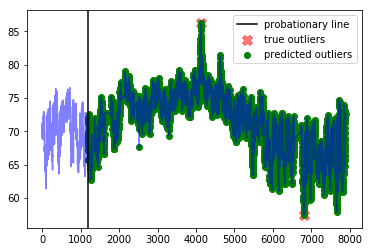




--- all_data_gift_certificates ---
Corresponding window precision:  0.11538461538461539
Corresponding window recall:  1.0
Corresponding window false positives:  23
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1317, 1318, 1319, 1320, 1321, 1322, 1323, 1324, 1325, 1326, 1327, 1328, 1329, 1330, 1331, 1332, 1333, 1334, 1335, 1336, 1337, 1338, 1339, 1340, 1341, 1342, 1343, 1344, 1345, 1346, 1347, 1348, 1349, 1350, 1351, 1352, 1353, 1354, 1355, 1356, 1357, 1358, 1359, 1360, 1361, 1362, 1363, 1364, 1365, 1366, 1367, 1368, 1369, 1370, 1371, 1372, 1373, 1374, 1375, 1376, 1377, 1378, 1379, 1380, 1381, 1382, 1383, 1384, 1385, 1386, 1387, 1388, 1389, 1390, 1391, 1392, 1393, 1394, 1395, 1396, 1397, 1398, 1399, 1400, 1401, 1402, 1403, 1404, 1405, 1406, 1407, 1408, 1409, 1410, 1411, 1412, 1413, 1414, 1415, 1416, 1417, 1418, 1419, 1420, 1421, 1422, 1423, 1424, 1425, 1426, 1427, 1428, 1429, 1430, 1431, 1432, 1433, 1434, 1435, 1436, 1437, 1438, 

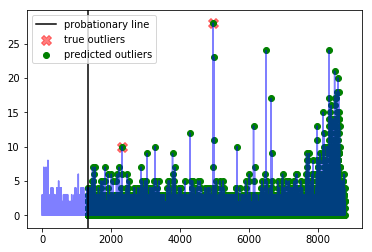




--- nyc_taxi ---
Corresponding window precision:  0.11627906976744186
Corresponding window recall:  1.0
Corresponding window false positives:  38
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1548, 1549, 1550, 1551, 1552, 1553, 1554, 1555, 1556, 1557, 1558, 1559, 1560, 1561, 1562, 1563, 1564, 1565, 1566, 1567, 1568, 1569, 1570, 1571, 1572, 1573, 1574, 1575, 1576, 1577, 1578, 1579, 1580, 1581, 1582, 1583, 1584, 1585, 1586, 1587, 1588, 1589, 1590, 1591, 1592, 1593, 1594, 1595, 1596, 1597, 1598, 1599, 1600, 1601, 1602, 1603, 1604, 1605, 1606, 1607, 1608, 1609, 1610, 1611, 1612, 1613, 1614, 1615, 1616, 1617, 1618, 1619, 1620, 1621, 1622, 1623, 1624, 1625, 1626, 1627, 1628, 1629, 1630, 1631, 1632, 1633, 1634, 1635, 1636, 1637, 1638, 1639, 1640, 1641, 1642, 1643, 1644, 1645, 1646, 1647, 1648, 1649, 1650, 1651, 1652, 1653, 1654, 1655, 1656, 1657, 1658, 1659, 1660, 1661, 1662, 1663, 1664, 1665, 1666, 1667, 1668, 1669, 1670, 1671, 1672, 

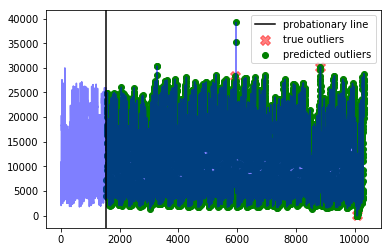




--- exchange-2_cpm_results ---
Corresponding window precision:  0.1111111111111111
Corresponding window recall:  1.0
Corresponding window false positives:  16
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [247, 248, 249, 250, 251, 252, 253, 254, 255, 256, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278, 279, 280, 281, 282, 283, 284, 285, 286, 287, 288, 289, 290, 291, 292, 293, 294, 295, 296, 297, 298, 299, 300, 301, 302, 303, 304, 305, 306, 307, 308, 309, 310, 311, 312, 313, 314, 315, 316, 317, 318, 319, 320, 321, 322, 323, 324, 325, 326, 327, 328, 329, 330, 331, 332, 333, 334, 335, 336, 337, 338, 339, 340, 341, 342, 343, 344, 345, 346, 347, 348, 349, 350, 351, 352, 353, 354, 355, 356, 357, 358, 359, 360, 361, 362, 363, 364, 365, 366, 367, 368, 369, 370, 371, 372, 373, 374, 375, 376, 377, 378, 379, 380, 381, 382, 383, 384, 385, 386, 387, 388, 389, 390, 391, 392, 393, 39

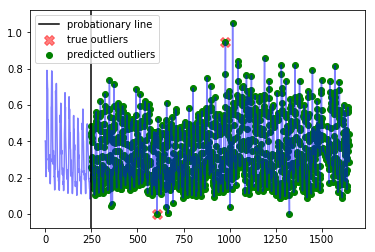




--- exchange-2_cpc_results ---
Corresponding window precision:  0.1111111111111111
Corresponding window recall:  1.0
Corresponding window false positives:  8
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [247, 248, 249, 250, 251, 252, 253, 254, 255, 256, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278, 279, 280, 281, 282, 283, 284, 285, 286, 287, 288, 289, 290, 291, 292, 293, 294, 295, 296, 297, 298, 299, 300, 301, 302, 303, 304, 305, 306, 307, 308, 309, 310, 311, 312, 313, 314, 315, 316, 317, 318, 319, 320, 321, 322, 323, 324, 325, 326, 327, 328, 329, 330, 331, 332, 333, 334, 335, 336, 337, 338, 339, 340, 341, 342, 343, 344, 345, 346, 347, 348, 349, 350, 351, 352, 353, 354, 355, 356, 357, 358, 359, 360, 361, 362, 363, 364, 365, 366, 367, 368, 369, 370, 371, 372, 373, 374, 375, 376, 377, 378, 379, 380, 381, 382, 383, 384, 385, 386, 387, 388, 389, 390, 391, 392, 393, 394

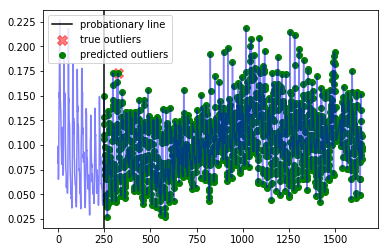




--- international-airline-passengers ---
Corresponding window precision:  0.1111111111111111
Corresponding window recall:  1.0
Corresponding window false positives:  8
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143]


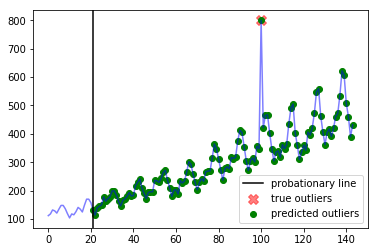




--- exchange-3_cpc_results ---
Corresponding window precision:  0.11538461538461539
Corresponding window recall:  1.0
Corresponding window false positives:  23
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [247, 248, 249, 250, 251, 252, 253, 254, 255, 256, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278, 279, 280, 281, 282, 283, 284, 285, 286, 287, 288, 289, 290, 291, 292, 293, 294, 295, 296, 297, 298, 299, 300, 301, 302, 303, 304, 305, 306, 307, 308, 309, 310, 311, 312, 313, 314, 315, 316, 317, 318, 319, 320, 321, 322, 323, 324, 325, 326, 327, 328, 329, 330, 331, 332, 333, 334, 335, 336, 337, 338, 339, 340, 341, 342, 343, 344, 345, 346, 347, 348, 349, 350, 351, 352, 353, 354, 355, 356, 357, 358, 359, 360, 361, 362, 363, 364, 365, 366, 367, 368, 369, 370, 371, 372, 373, 374, 375, 376, 377, 378, 379, 380, 381, 382, 383, 384, 385, 386, 387, 388, 389, 390, 391, 392, 393, 3

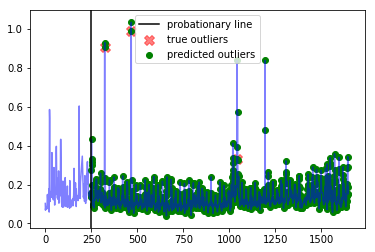

---------weight_fp=0.2, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  21.199999999999996
Best window threshold:  0.0001
Corresponding window overall precision:  0.35714285714285715
Corresponding window overall recall:  0.21739130434782608
Corresponding window overall F score:  0.27027027027027023



--- elb_request_count_8c0756 ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [1890]


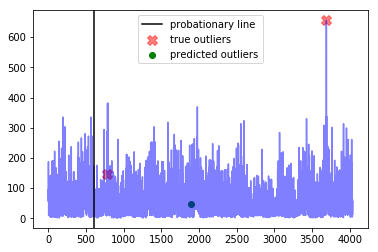




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  [1102]


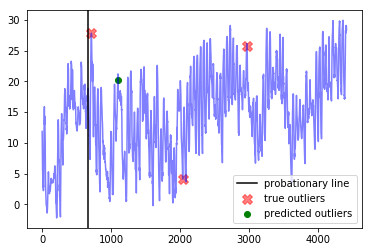




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1193]


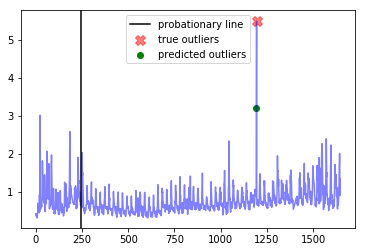




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  2
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [2196, 6693]


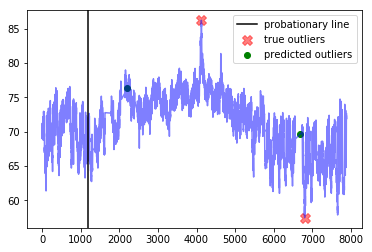




--- all_data_gift_certificates ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  [6255]


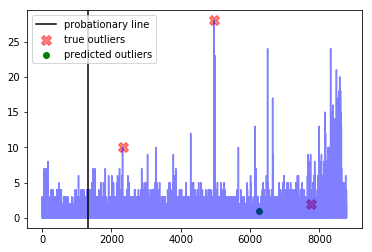




--- nyc_taxi ---
Corresponding window precision:  1.0
Corresponding window recall:  0.4
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  [5910, 10099]


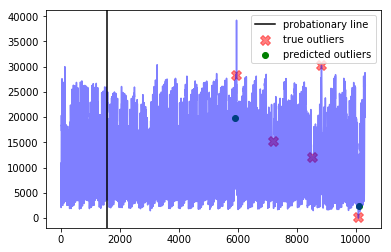




--- exchange-2_cpm_results ---
Corresponding window precision:  0.5
Corresponding window recall:  0.5
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [942, 1493]


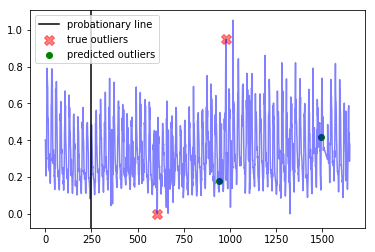




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  2
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [863, 1475]


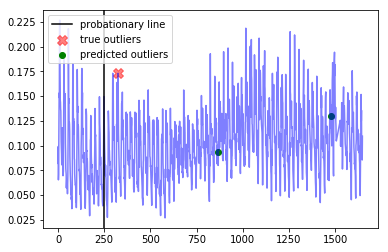




--- international-airline-passengers ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  2
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [36, 87]


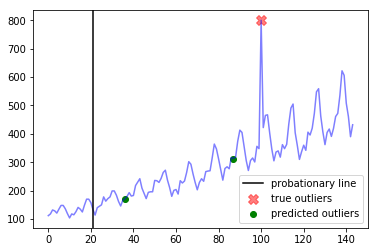




--- exchange-3_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  [966]


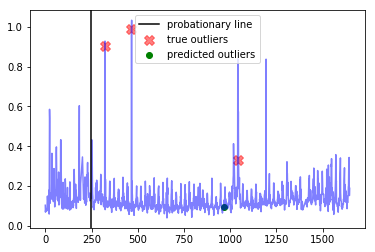

---------weight_fp=0.3, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  22.300000000000004
Best window threshold:  0.0001
Corresponding window overall precision:  0.35714285714285715
Corresponding window overall recall:  0.21739130434782608
Corresponding window overall F score:  0.27027027027027023



--- elb_request_count_8c0756 ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [1890]


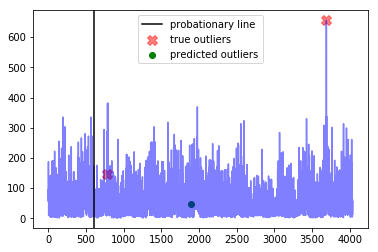




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  [1102]


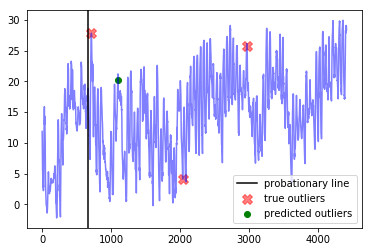




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1193]


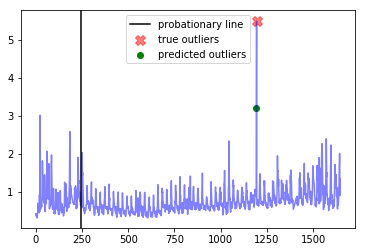




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  2
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [2196, 6693]


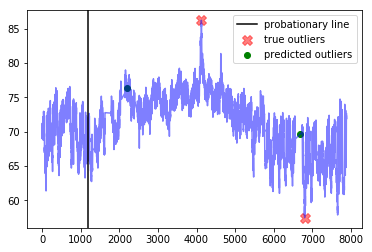




--- all_data_gift_certificates ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  [6255]


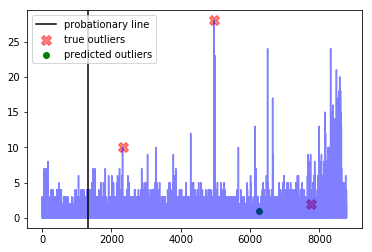




--- nyc_taxi ---
Corresponding window precision:  1.0
Corresponding window recall:  0.4
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  [5910, 10099]


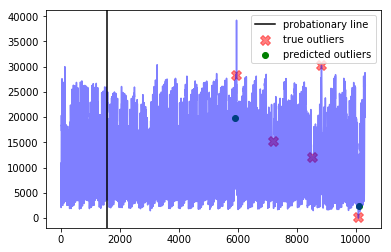




--- exchange-2_cpm_results ---
Corresponding window precision:  0.5
Corresponding window recall:  0.5
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [942, 1493]


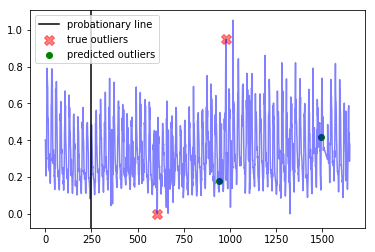




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  2
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [863, 1475]


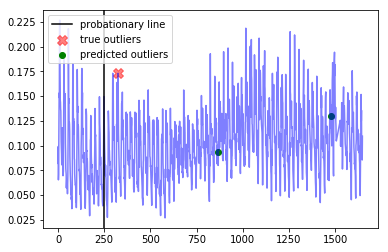




--- international-airline-passengers ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  2
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [36, 87]


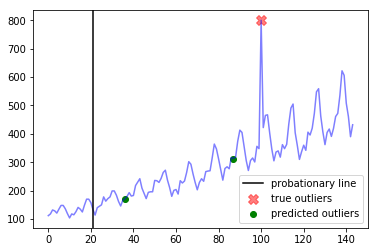




--- exchange-3_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  [966]


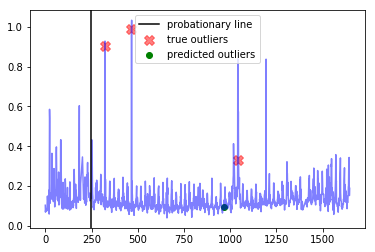

---------weight_fp=0.4, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  23.4
Best window threshold:  0.0001
Corresponding window overall precision:  0.35714285714285715
Corresponding window overall recall:  0.21739130434782608
Corresponding window overall F score:  0.27027027027027023



--- elb_request_count_8c0756 ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [1890]


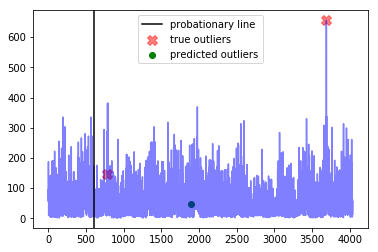




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  [1102]


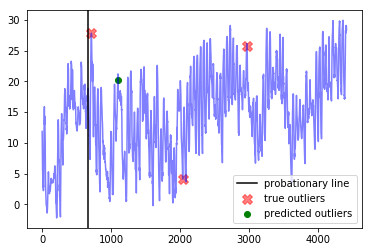




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1193]


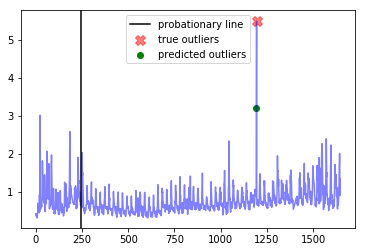




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  2
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [2196, 6693]


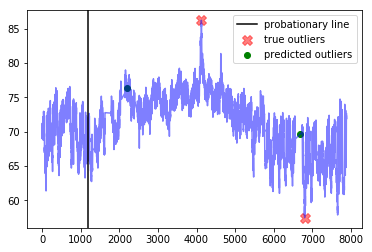




--- all_data_gift_certificates ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  [6255]


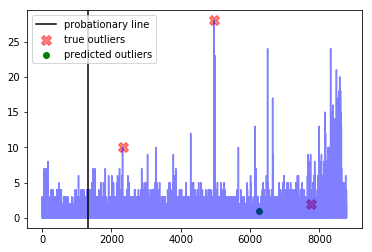




--- nyc_taxi ---
Corresponding window precision:  1.0
Corresponding window recall:  0.4
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  [5910, 10099]


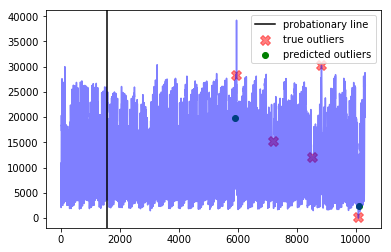




--- exchange-2_cpm_results ---
Corresponding window precision:  0.5
Corresponding window recall:  0.5
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [942, 1493]


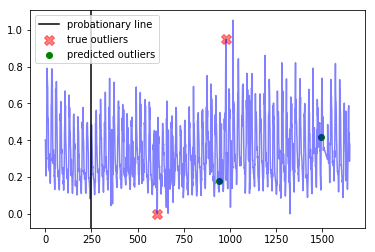




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  2
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [863, 1475]


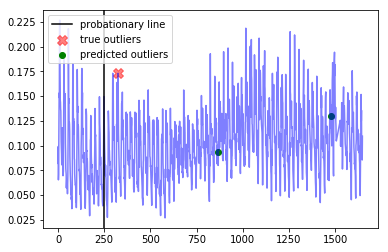




--- international-airline-passengers ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  2
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [36, 87]


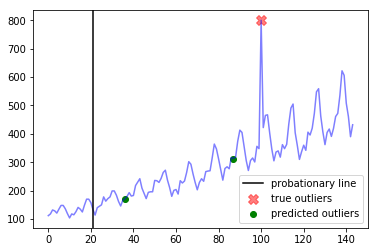




--- exchange-3_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  [966]


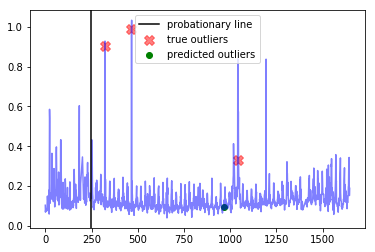

---------weight_fp=0.5, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  24.5
Best window threshold:  0.0001
Corresponding window overall precision:  0.35714285714285715
Corresponding window overall recall:  0.21739130434782608
Corresponding window overall F score:  0.27027027027027023



--- elb_request_count_8c0756 ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [1890]


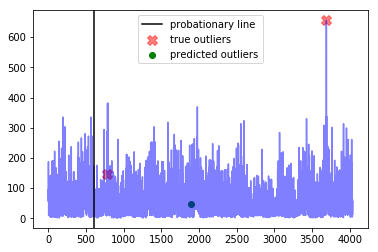




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  [1102]


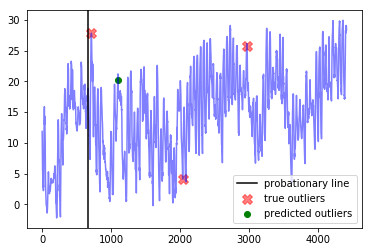




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1193]


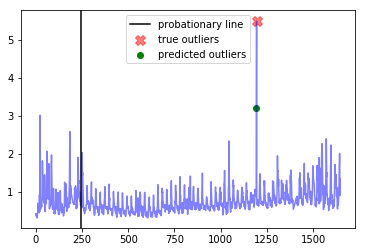




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  2
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [2196, 6693]


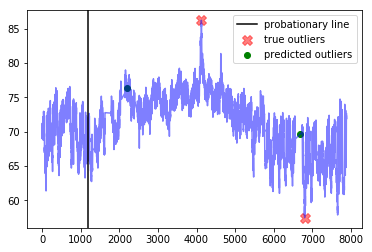




--- all_data_gift_certificates ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  [6255]


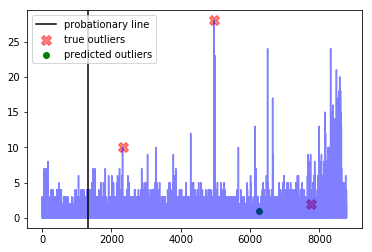




--- nyc_taxi ---
Corresponding window precision:  1.0
Corresponding window recall:  0.4
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  [5910, 10099]


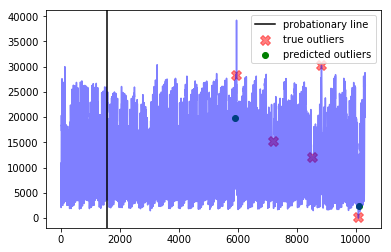




--- exchange-2_cpm_results ---
Corresponding window precision:  0.5
Corresponding window recall:  0.5
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [942, 1493]


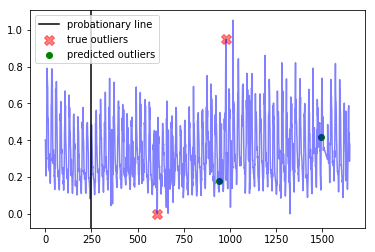




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  2
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [863, 1475]


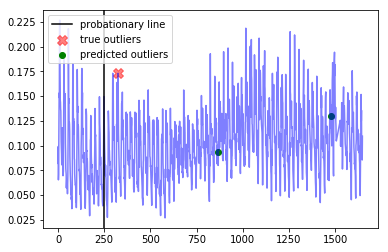




--- international-airline-passengers ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  2
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [36, 87]


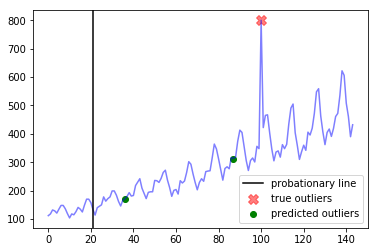




--- exchange-3_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  [966]


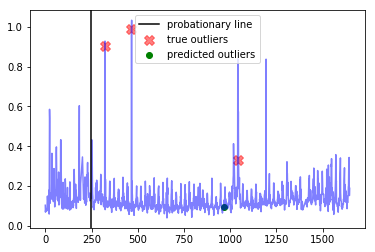

---------weight_fp=0.6, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  25.6
Best window threshold:  0.0001
Corresponding window overall precision:  0.35714285714285715
Corresponding window overall recall:  0.21739130434782608
Corresponding window overall F score:  0.27027027027027023



--- elb_request_count_8c0756 ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [1890]


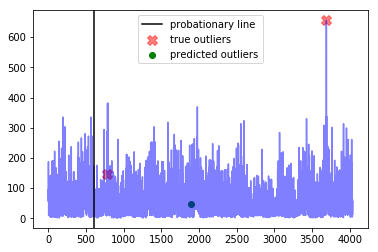




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  [1102]


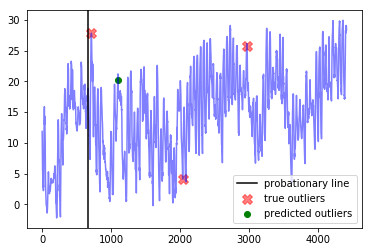




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1193]


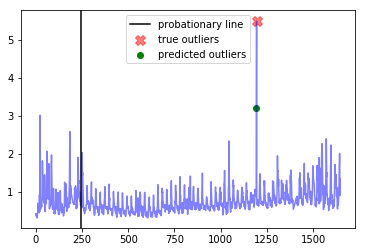




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  2
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [2196, 6693]


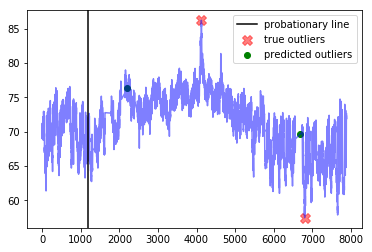




--- all_data_gift_certificates ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  [6255]


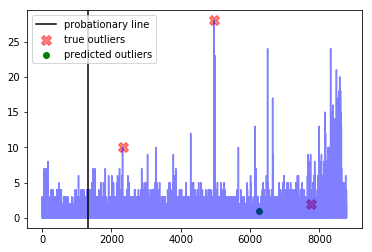




--- nyc_taxi ---
Corresponding window precision:  1.0
Corresponding window recall:  0.4
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  [5910, 10099]


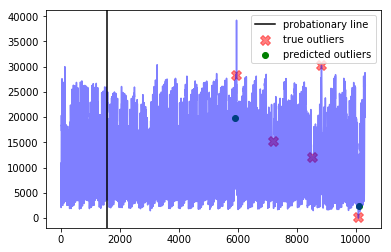




--- exchange-2_cpm_results ---
Corresponding window precision:  0.5
Corresponding window recall:  0.5
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [942, 1493]


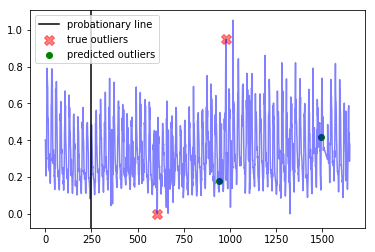




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  2
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [863, 1475]


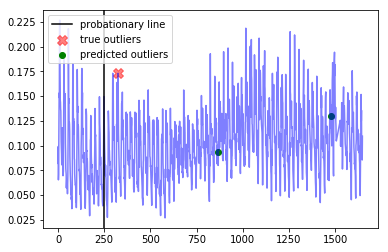




--- international-airline-passengers ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  2
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [36, 87]


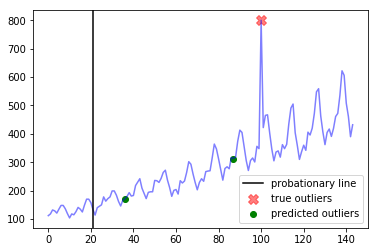




--- exchange-3_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  [966]


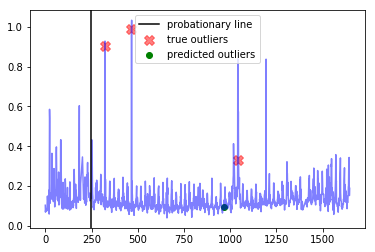

---------weight_fp=0.7, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  26.699999999999996
Best window threshold:  0.0001
Corresponding window overall precision:  0.35714285714285715
Corresponding window overall recall:  0.21739130434782608
Corresponding window overall F score:  0.27027027027027023



--- elb_request_count_8c0756 ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [1890]


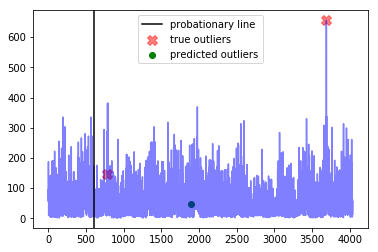




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  [1102]


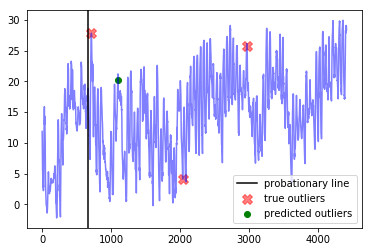




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1193]


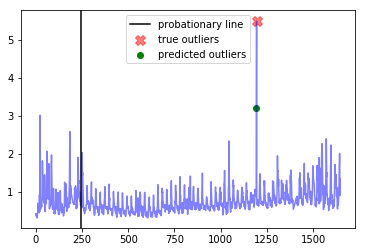




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  2
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [2196, 6693]


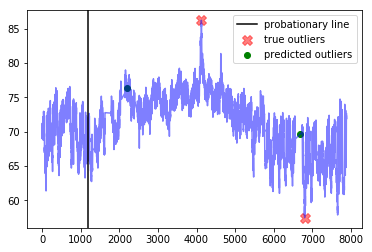




--- all_data_gift_certificates ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  [6255]


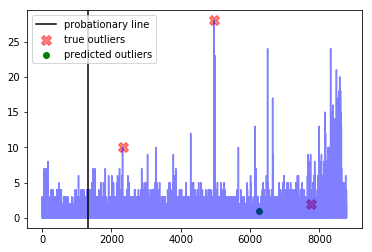




--- nyc_taxi ---
Corresponding window precision:  1.0
Corresponding window recall:  0.4
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  [5910, 10099]


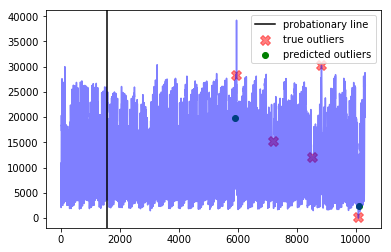




--- exchange-2_cpm_results ---
Corresponding window precision:  0.5
Corresponding window recall:  0.5
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [942, 1493]


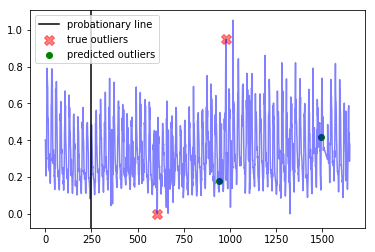




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  2
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [863, 1475]


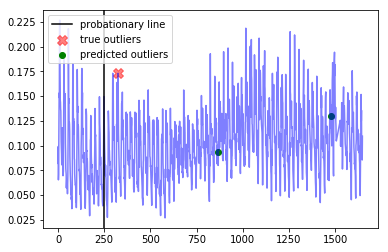




--- international-airline-passengers ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  2
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [36, 87]


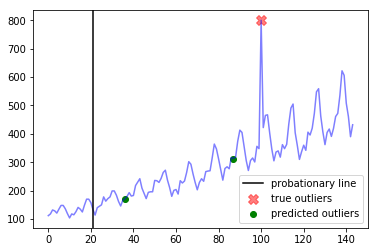




--- exchange-3_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  [966]


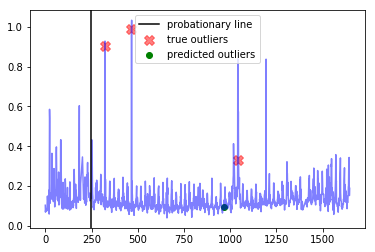

---------weight_fp=0.8, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  27.800000000000004
Best window threshold:  0.0001
Corresponding window overall precision:  0.35714285714285715
Corresponding window overall recall:  0.21739130434782608
Corresponding window overall F score:  0.27027027027027023



--- elb_request_count_8c0756 ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [1890]


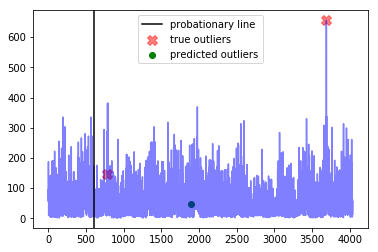




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  [1102]


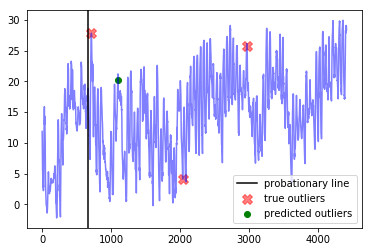




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1193]


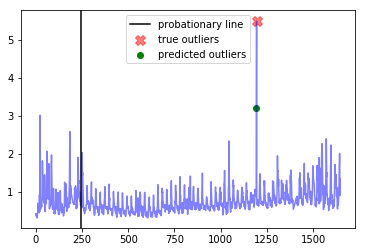




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  2
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [2196, 6693]


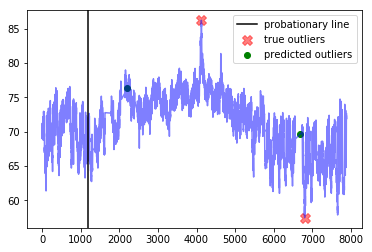




--- all_data_gift_certificates ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  [6255]


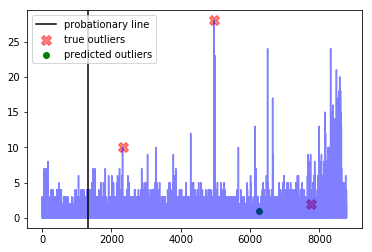




--- nyc_taxi ---
Corresponding window precision:  1.0
Corresponding window recall:  0.4
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  [5910, 10099]


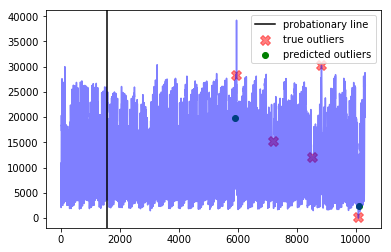




--- exchange-2_cpm_results ---
Corresponding window precision:  0.5
Corresponding window recall:  0.5
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [942, 1493]


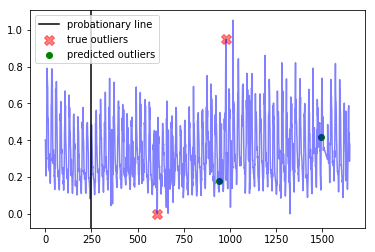




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  2
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [863, 1475]


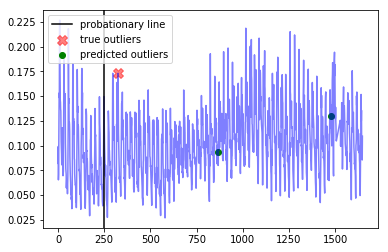




--- international-airline-passengers ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  2
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [36, 87]


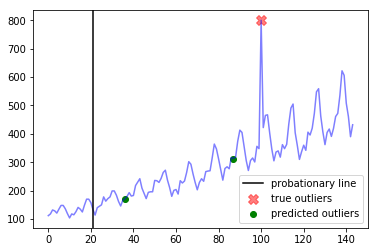




--- exchange-3_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  [966]


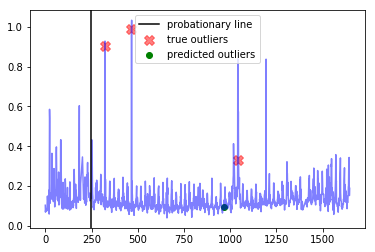

---------weight_fp=0.9, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  28.9
Best window threshold:  0.0001
Corresponding window overall precision:  0.35714285714285715
Corresponding window overall recall:  0.21739130434782608
Corresponding window overall F score:  0.27027027027027023



--- elb_request_count_8c0756 ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [1890]


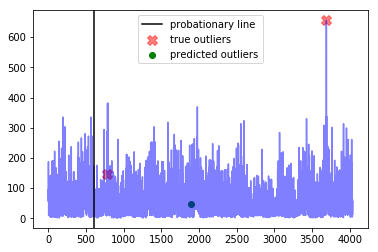




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  [1102]


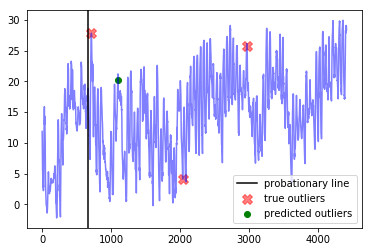




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1193]


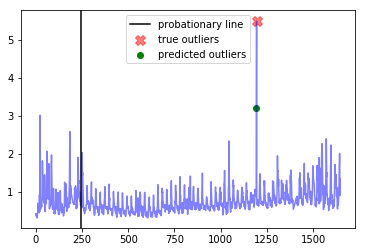




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  2
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [2196, 6693]


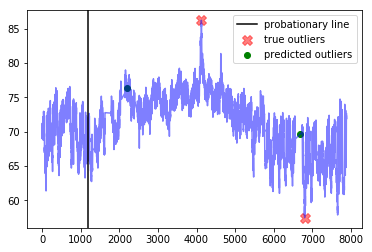




--- all_data_gift_certificates ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  [6255]


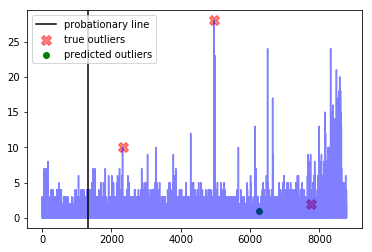




--- nyc_taxi ---
Corresponding window precision:  1.0
Corresponding window recall:  0.4
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  [5910, 10099]


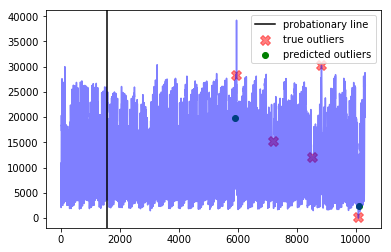




--- exchange-2_cpm_results ---
Corresponding window precision:  0.5
Corresponding window recall:  0.5
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [942, 1493]


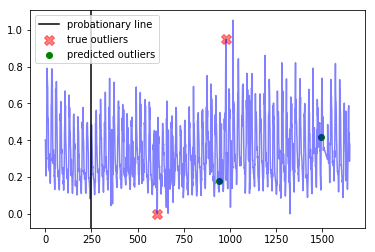




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  2
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [863, 1475]


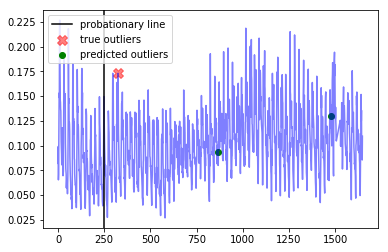




--- international-airline-passengers ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  2
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [36, 87]


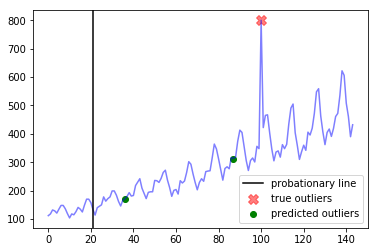




--- exchange-3_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  [966]


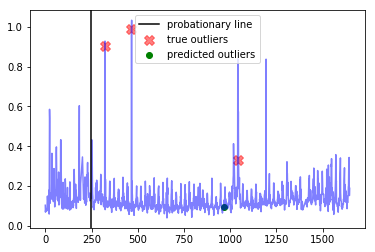

---------weight_fp=1.0, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  30.0
Best window threshold:  0.0001
Corresponding window overall precision:  0.35714285714285715
Corresponding window overall recall:  0.21739130434782608
Corresponding window overall F score:  0.27027027027027023



--- elb_request_count_8c0756 ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [1890]


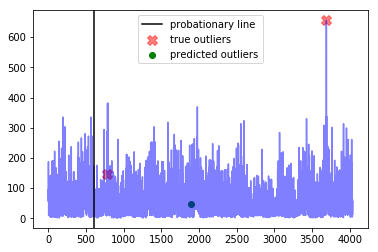




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  [1102]


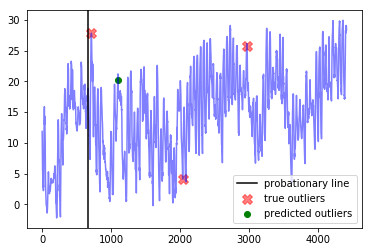




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1193]


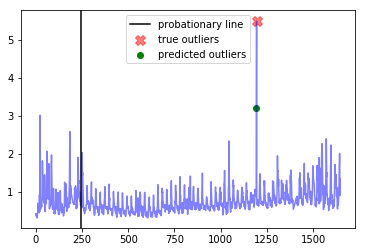




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  2
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [2196, 6693]


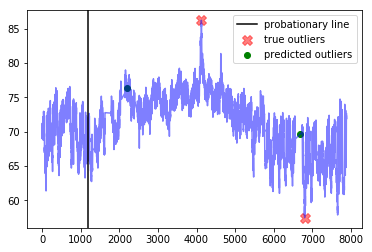




--- all_data_gift_certificates ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  [6255]


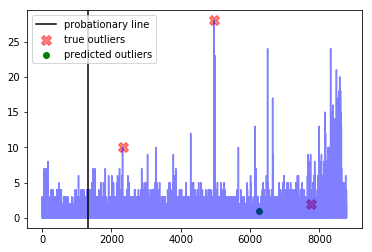




--- nyc_taxi ---
Corresponding window precision:  1.0
Corresponding window recall:  0.4
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  [5910, 10099]


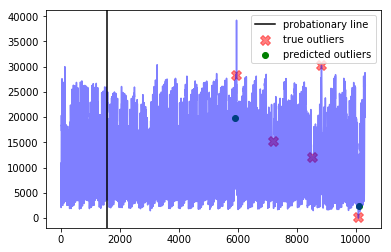




--- exchange-2_cpm_results ---
Corresponding window precision:  0.5
Corresponding window recall:  0.5
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [942, 1493]


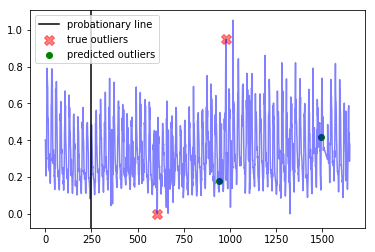




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  2
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [863, 1475]


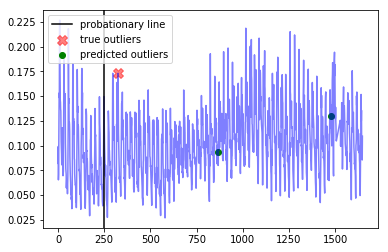




--- international-airline-passengers ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  2
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [36, 87]


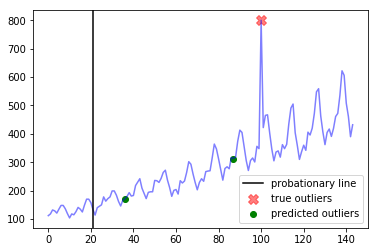




--- exchange-3_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  [966]


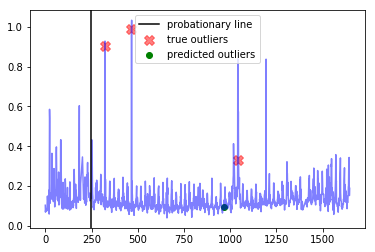

------------
False Positive Weight:  0.1
	 Minimum number of mistakes : 17.800000000000004
	 Corresponding window overall recall : 1.0
	 Corresponding window overall precision : 0.11442786069651742
	 Corresponding window overall F score : 0.20535714285714285
	 Best window threshold : 0.0
False Positive Weight:  0.2
	 Minimum number of mistakes : 21.199999999999996
	 Corresponding window overall recall : 0.21739130434782608
	 Corresponding window overall precision : 0.35714285714285715
	 Corresponding window overall F score : 0.27027027027027023
	 Best window threshold : 0.0001
False Positive Weight:  0.3
	 Minimum number of mistakes : 22.300000000000004
	 Corresponding window overall recall : 0.21739130434782608
	 Corresponding window overall precision : 0.35714285714285715
	 Corresponding window overall F score : 0.27027027027027023
	 Best window threshold : 0.0001
False Positive Weight:  0.6
	 Minimum number of mistakes : 25.6
	 Corresponding window overall recall : 0.217391304347826

In [45]:
end_results = {}
for weight_fp in weight_fp_list:  
    print("---------weight_fp=" + str(weight_fp) + ", weight_fn=1----------")
    weight_result = adclasses.pretty_print_results(ad_dict, anomaly_scores_dict, true_outlier_indices_dict, weight_fp=weight_fp, weight_fn=1)
    end_results[weight_fp] = weight_result

print("------------")
adclasses.pretty_print_end_results(end_results)

# NAB Score

    1. make a python 2.7 virtual environment
    2. pip install pandas
    3. git clone NAB
    4. pip install . in NAB

To obtain NAB scores for every method on the seasonal datasets, we must do the following:

# Have a new dataset?

1. add the new dataset csv with timestamp, value in respective folder in data folder. no missing time steps allowed

2. add the point anomaly dates to combined_labels.json in labels folder

3. add the anomaly windows to combined_windows.json  (start and end dates)

4. in results/null, include null_datasetname.csv with timestamp, value, label, and anomaly_score (all .5). You can just use the adclasses.create_result_csv function and delete irrelevant columns and fill anomaly_score with all .5s

WARNING: Some datasets we use are already in NAB, but they have missing time steps. Replace the dataset csv in the data folder with a prefilled version as the anomaly scores we use assume no missing time steps. You can just use the adclasses.create_result_csv function and delete irrelevant columns

In [46]:
dataset_name = "FARM_Bowling-Green-5-S_Warren"
path = "data/" + dataset_name + ".csv"

data = pd.read_csv(path,header=0)
start_date = data["UTME"].values[0]
end_date = data["UTME"].values[-1]
print("Start date: ", start_date)
print("\nEnd date: ", end_date)
narrowed = []
for item in data["TAIR"].values:
    if not math.isnan(item):
        narrowed.append(item)
print("\nMedian:  ",np.median(narrowed), "\n")
print(data["TAIR"].describe())
display(data.head())

data["UTME"] = pd.to_datetime(data["UTME"],format="%Y-%m-%d %H:%M:%S UTC")
del data["NET"]
del data["STID"]
tair_data = pd.DataFrame({"UTME":data["UTME"],"TAIR":data["TAIR"]})
tair_data.set_index("UTME",inplace=True)
missing = tair_data[tair_data['TAIR'].isnull()].index
print("\n # of missing time steps using old granularity: ",len(missing))
tair_data = tair_data.interpolate()

resampled_tair_data = tair_data.resample('30Min', how={'TAIR': np.mean})

def round_2(num):
    return round(num,2)

resampled_tair_data["TAIR"]=resampled_tair_data["TAIR"].apply(round_2)

renamed_resampled_tair_data = pd.DataFrame({"timestamp": resampled_tair_data.index, "value":resampled_tair_data["TAIR"]})

data = renamed_resampled_tair_data

start_date = data["timestamp"].values[0]
end_date = data["timestamp"].values[-1]
print("Start date: ", start_date)
print("End date: ", end_date)


data["timestamp"] = pd.to_datetime(data["timestamp"], 
                                   format="%Y-%m-%d %H:%M:%S")

print("Missing time stamps: \n", adclasses.find_missing_time_steps(start_date, end_date, 
                                                                   '30min', data))

# if you want to use a method that cannot take missing time steps
# into account, you need to fill in the missing time steps yourself
# this function also removes duplicates
print("Fill Missing Time Steps with Interpolation")
data = adclasses.fill_missing_time_steps(start_date, end_date, '30min', data, method="linear")

ad = adclasses.UnivariateAnomalyDetection(dataframe=data, 
                                          timestep="30min", 
                                          dateformat="%Y-%m-%d %H:%M:%S", 
                                          name=dataset_name)
print("Length: ", ad.get_length())
print("Time step size: ", ad.get_timestep())
print("Start Date: ", start_date)
print("End Date: ", end_date)
print("Date Format: ", ad.get_dateformat())
true_outlier_dates = ["2016-03-15 21:00:00",
                      "2016-04-12 11:30:00",
                      "2016-05-01 21:30:00"]

d = timedelta(minutes=30)
for outlier_date in true_outlier_dates:
    print(adclasses.get_window_ends(outlier_date, 
                                    ad.get_length(), 
                                    len(true_outlier_dates), 
                                    ad.get_dateformat(), d))

Start date:  2016-03-01 00:00:00 UTC

End date:  2016-05-31 23:55:00 UTC

Median:   15.455 

count    26465.000000
mean        14.830008
std          6.676933
min         -2.490000
25%         10.198000
50%         15.455000
75%         19.325000
max         30.304000
Name: TAIR, dtype: float64


,NET,STID,UTME,TAIR,RELH,TDPT,WSPD,WDIR,WSMX,WDMX,SRAD,PRCP
0,KYMN,FARM,2016-03-01 00:00:00 UTC,12.886,40.8,-0.14,1.15,183.9,1.31,180.0,0.33,0.0
1,KYMN,FARM,2016-03-01 00:05:00 UTC,13.217,40.8,0.18,1.02,196.8,1.11,192.3,0.17,0.0
2,KYMN,FARM,2016-03-01 00:10:00 UTC,12.901,41.5,0.10,0.82,211.2,0.92,202.8,0.17,0.0
3,KYMN,FARM,2016-03-01 00:15:00 UTC,11.200,48.2,0.63,0.73,220.5,0.92,220.4,0.00,0.0
4,KYMN,FARM,2016-03-01 00:20:00 UTC,10.414,49.8,0.37,0.44,220.5,0.69,220.5,0.00,0.0



 # of missing time steps using old granularity:  19
Start date:  2016-03-01T00:00:00.000000000
End date:  2016-05-31T23:30:00.000000000
Missing time stamps: 
 DatetimeIndex([], dtype='datetime64[ns]', freq='30T')
Fill Missing Time Steps with Interpolation
Length:  4416
Time step size:  30min
Start Date:  2016-03-01T00:00:00.000000000
End Date:  2016-05-31T23:30:00.000000000
Date Format:  %Y-%m-%d %H:%M:%S
(Timestamp('2016-03-14 08:30:00'), Timestamp('2016-03-17 09:30:00'))
(Timestamp('2016-04-10 23:00:00'), Timestamp('2016-04-14 00:00:00'))
(Timestamp('2016-04-30 09:00:00'), Timestamp('2016-05-03 10:00:00'))


# For every anomaly detection method "method_name" and dataset "dataset_name", do the following:

0. clear up previous NAB/results/

1. $ python scripts/create_new_detector.py --detector method_name

this creates the method_name folder in results folder with a bunch of datasets folders that are empty. delete the irrelevant ones

2. for every characteristic relevant dataset, create csvs with columns like so: timestamp, value, anomaly_score, label. place in appropriate locations in results/method_name/

3. replace datasets with prefill

4. $ python run.py -d method_name --optimize --score --normalize

WARNING: HAVE TO MAKE CHANGE TO NAB function convertAnomalyScoresToDetections in util.py bc it will think values are strings

In [17]:
prepath="/pathtonab/NAB/results/"

# STL Resid

In [48]:
folder="selfCreate"
method_name = "stl"
dataset_name = "FARM_Bowling-Green-5-S_Warren"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "30min"
true_outlier_dates = ["2016-03-15 21:00:00",
                      "2016-04-12 11:30:00",
                      "2016-05-01 21:30:00"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realKnownCause"
method_name = "stl"
dataset_name = "nyc_taxi"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "30min"
true_outlier_dates = ["2014-11-01 19:00:00",
                      "2014-11-27 15:30:00",
                      "2014-12-25 15:00:00",
                      "2015-01-01 01:00:00",
                      "2015-01-27 00:00:00"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realAdExchange"
method_name = "stl"
dataset_name = "exchange-2_cpm_results"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2011-07-26 06:00:01",
                      "2011-08-10 17:00:01"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realAdExchange"
method_name = "stl"
dataset_name = "exchange-3_cpm_results"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2011-08-19 18:15:01"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="selfCreate"
method_name = "stl"
dataset_name = "all_data_gift_certificates"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2016-04-06 16:00:00",
                      "2016-07-25 19:00:00",
                      "2016-11-19 20:00:00"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realAWSCloudwatch"
method_name = "stl"
dataset_name = "elb_request_count_8c0756"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "5min"
true_outlier_dates = ["2014-04-12 17:24:00",
                      "2014-04-22 19:34:00"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realAdExchange"
method_name = "stl"
dataset_name = "exchange-2_cpc_results"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2011-07-14 13:00:01"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realAdExchange"
method_name = "stl"
dataset_name = "exchange-3_cpc_results"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2011-07-14 10:15:01",
                      "2011-07-20 10:15:01",
                      "2011-08-13 10:15:01"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="selfCreate"
method_name = "stl"
dataset_name = "international-airline-passengers"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1MS"
true_outlier_dates = ["1957-05"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realKnownCause"
method_name = "stl"
dataset_name = "ambient_temperature_system_failure"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2013-12-22 20:00:00",
                      "2014-04-13 09:00:00"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###

Duplicate records found: 
                        value
timestamp                    
2011-08-24 12:00:01  0.408490
2011-08-24 12:00:01  0.461745
Removing duplicates and keeping:  
                       value
timestamp                   
2011-08-24 12:00:01  0.40849
Duplicate records found: 
                        value
timestamp                    
2011-08-24 12:00:01  0.131250
2011-08-24 12:00:01  0.119453
Removing duplicates and keeping:  
                       value
timestamp                   
2011-08-24 12:00:01  0.13125


# SARIMA




In [49]:
folder="realAdExchange"
method_name = "SARIMA_all"
dataset_name = "exchange-2_cpm_results"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2011-07-26 06:00:01",
                      "2011-08-10 17:00:01"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realAdExchange"
method_name = "SARIMA_all"
dataset_name = "exchange-3_cpm_results"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2011-08-19 18:15:01"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="selfCreate"
method_name = "SARIMA_all"
dataset_name = "all_data_gift_certificates"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2016-04-06 16:00:00",
                      "2016-07-25 19:00:00",
                      "2016-11-19 20:00:00"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realAdExchange"
method_name = "SARIMA_all"
dataset_name = "exchange-2_cpc_results"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2011-07-14 13:00:01"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realAdExchange"
method_name = "SARIMA_all"
dataset_name = "exchange-3_cpc_results"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2011-07-14 10:15:01",
                      "2011-07-20 10:15:01",
                      "2011-08-13 10:15:01"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="selfCreate"
method_name = "SARIMA_all"
dataset_name = "international-airline-passengers"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1MS"
true_outlier_dates = ["1957-05"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realKnownCause"
method_name = "SARIMA_all"
dataset_name = "ambient_temperature_system_failure"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2013-12-22 20:00:00",
                      "2014-04-13 09:00:00"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###

Duplicate records found: 
                        value
timestamp                    
2011-08-24 12:00:01  0.408490
2011-08-24 12:00:01  0.461745
Removing duplicates and keeping:  
                       value
timestamp                   
2011-08-24 12:00:01  0.40849
Duplicate records found: 
                        value
timestamp                    
2011-08-24 12:00:01  0.131250
2011-08-24 12:00:01  0.119453
Removing duplicates and keeping:  
                       value
timestamp                   
2011-08-24 12:00:01  0.13125


# Prophet


In [50]:
folder="selfCreate"
method_name = "Prophet"
dataset_name = "FARM_Bowling-Green-5-S_Warren"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "30min"
true_outlier_dates = ["2016-03-15 21:00:00",
                      "2016-04-12 11:30:00",
                      "2016-05-01 21:30:00"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realKnownCause"
method_name = "Prophet"
dataset_name = "nyc_taxi"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "30min"
true_outlier_dates = ["2014-11-01 19:00:00",
                      "2014-11-27 15:30:00",
                      "2014-12-25 15:00:00",
                      "2015-01-01 01:00:00",
                      "2015-01-27 00:00:00"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realAdExchange"
method_name = "Prophet"
dataset_name = "exchange-2_cpm_results"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2011-07-26 06:00:01",
                      "2011-08-10 17:00:01"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realAdExchange"
method_name = "Prophet"
dataset_name = "exchange-3_cpm_results"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2011-08-19 18:15:01"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="selfCreate"
method_name = "Prophet"
dataset_name = "all_data_gift_certificates"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2016-04-06 16:00:00",
                      "2016-07-25 19:00:00",
                      "2016-11-19 20:00:00"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realAWSCloudwatch"
method_name = "Prophet"
dataset_name = "elb_request_count_8c0756"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "5min"
true_outlier_dates = ["2014-04-12 17:24:00",
                      "2014-04-22 19:34:00"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realAdExchange"
method_name = "Prophet"
dataset_name = "exchange-2_cpc_results"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2011-07-14 13:00:01"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realAdExchange"
method_name = "Prophet"
dataset_name = "exchange-3_cpc_results"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2011-07-14 10:15:01",
                      "2011-07-20 10:15:01",
                      "2011-08-13 10:15:01"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="selfCreate"
method_name = "Prophet"
dataset_name = "international-airline-passengers"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1MS"
true_outlier_dates = ["1957-05"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realKnownCause"
method_name = "Prophet"
dataset_name = "ambient_temperature_system_failure"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2013-12-22 20:00:00",
                      "2014-04-13 09:00:00"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###

Duplicate records found: 
                        value
timestamp                    
2011-08-24 12:00:01  0.408490
2011-08-24 12:00:01  0.461745
Removing duplicates and keeping:  
                       value
timestamp                   
2011-08-24 12:00:01  0.40849
Duplicate records found: 
                        value
timestamp                    
2011-08-24 12:00:01  0.131250
2011-08-24 12:00:01  0.119453
Removing duplicates and keeping:  
                       value
timestamp                   
2011-08-24 12:00:01  0.13125


# RNN


In [18]:
folder="selfCreate"
method_name = "RNN"
dataset_name = "FARM_Bowling-Green-5-S_Warren"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "30min"
true_outlier_dates = ["2016-03-15 21:00:00",
                      "2016-04-12 11:30:00",
                      "2016-05-01 21:30:00"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realKnownCause"
method_name = "RNN"
dataset_name = "nyc_taxi"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "30min"
true_outlier_dates = ["2014-11-01 19:00:00",
                      "2014-11-27 15:30:00",
                      "2014-12-25 15:00:00",
                      "2015-01-01 01:00:00",
                      "2015-01-27 00:00:00"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realAdExchange"
method_name = "RNN"
dataset_name = "exchange-2_cpm_results"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2011-07-26 06:00:01",
                      "2011-08-10 17:00:01"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realAdExchange"
method_name = "RNN"
dataset_name = "exchange-3_cpm_results"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2011-08-19 18:15:01"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="selfCreate"
method_name = "RNN"
dataset_name = "all_data_gift_certificates"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2016-04-06 16:00:00",
                      "2016-07-25 19:00:00",
                      "2016-11-19 20:00:00"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realAWSCloudwatch"
method_name = "RNN"
dataset_name = "elb_request_count_8c0756"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "5min"
true_outlier_dates = ["2014-04-12 17:24:00",
                      "2014-04-22 19:34:00"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realAdExchange"
method_name = "RNN"
dataset_name = "exchange-2_cpc_results"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2011-07-14 13:00:01"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realAdExchange"
method_name = "RNN"
dataset_name = "exchange-3_cpc_results"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2011-07-14 10:15:01",
                      "2011-07-20 10:15:01",
                      "2011-08-13 10:15:01"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="selfCreate"
method_name = "RNN"
dataset_name = "international-airline-passengers"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1MS"
true_outlier_dates = ["1957-05"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realKnownCause"
method_name = "RNN"
dataset_name = "ambient_temperature_system_failure"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2013-12-22 20:00:00",
                      "2014-04-13 09:00:00"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###

Duplicate records found: 
                        value
timestamp                    
2011-08-24 12:00:01  0.408490
2011-08-24 12:00:01  0.461745
Removing duplicates and keeping:  
                       value
timestamp                   
2011-08-24 12:00:01  0.40849
Duplicate records found: 
                        value
timestamp                    
2011-08-24 12:00:01  0.131250
2011-08-24 12:00:01  0.119453
Removing duplicates and keeping:  
                       value
timestamp                   
2011-08-24 12:00:01  0.13125


# HTM


In [52]:
folder="selfCreate"
method_name = "HTM"
dataset_name = "FARM_Bowling-Green-5-S_Warren"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "30min"
true_outlier_dates = ["2016-03-15 21:00:00",
                      "2016-04-12 11:30:00",
                      "2016-05-01 21:30:00"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realKnownCause"
method_name = "HTM"
dataset_name = "nyc_taxi"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "30min"
true_outlier_dates = ["2014-11-01 19:00:00",
                      "2014-11-27 15:30:00",
                      "2014-12-25 15:00:00",
                      "2015-01-01 01:00:00",
                      "2015-01-27 00:00:00"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realAdExchange"
method_name = "HTM"
dataset_name = "exchange-2_cpm_results"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2011-07-26 06:00:01",
                      "2011-08-10 17:00:01"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realAdExchange"
method_name = "HTM"
dataset_name = "exchange-3_cpm_results"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2011-08-19 18:15:01"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="selfCreate"
method_name = "HTM"
dataset_name = "all_data_gift_certificates"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2016-04-06 16:00:00",
                      "2016-07-25 19:00:00",
                      "2016-11-19 20:00:00"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realAWSCloudwatch"
method_name = "HTM"
dataset_name = "elb_request_count_8c0756"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "5min"
true_outlier_dates = ["2014-04-12 17:24:00",
                      "2014-04-22 19:34:00"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realAdExchange"
method_name = "HTM"
dataset_name = "exchange-2_cpc_results"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2011-07-14 13:00:01"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realAdExchange"
method_name = "HTM"
dataset_name = "exchange-3_cpc_results"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2011-07-14 10:15:01",
                      "2011-07-20 10:15:01",
                      "2011-08-13 10:15:01"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realKnownCause"
method_name = "HTM"
dataset_name = "ambient_temperature_system_failure"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2013-12-22 20:00:00",
                      "2014-04-13 09:00:00"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###

Duplicate records found: 
                        value
timestamp                    
2011-08-24 12:00:01  0.408490
2011-08-24 12:00:01  0.461745
Removing duplicates and keeping:  
                       value
timestamp                   
2011-08-24 12:00:01  0.40849
Duplicate records found: 
                        value
timestamp                    
2011-08-24 12:00:01  0.131250
2011-08-24 12:00:01  0.119453
Removing duplicates and keeping:  
                       value
timestamp                   
2011-08-24 12:00:01  0.13125


# Donut


In [53]:
folder="selfCreate"
method_name = "Donut"
dataset_name = "FARM_Bowling-Green-5-S_Warren"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "30min"
true_outlier_dates = ["2016-03-15 21:00:00",
                      "2016-04-12 11:30:00",
                      "2016-05-01 21:30:00"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realKnownCause"
method_name = "Donut"
dataset_name = "nyc_taxi"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "30min"
true_outlier_dates = ["2014-11-01 19:00:00",
                      "2014-11-27 15:30:00",
                      "2014-12-25 15:00:00",
                      "2015-01-01 01:00:00",
                      "2015-01-27 00:00:00"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realAdExchange"
method_name = "Donut"
dataset_name = "exchange-2_cpm_results"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2011-07-26 06:00:01",
                      "2011-08-10 17:00:01"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realAdExchange"
method_name = "Donut"
dataset_name = "exchange-3_cpm_results"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2011-08-19 18:15:01"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="selfCreate"
method_name = "Donut"
dataset_name = "all_data_gift_certificates"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2016-04-06 16:00:00",
                      "2016-07-25 19:00:00",
                      "2016-11-19 20:00:00"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realAWSCloudwatch"
method_name = "Donut"
dataset_name = "elb_request_count_8c0756"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "5min"
true_outlier_dates = ["2014-04-12 17:24:00",
                      "2014-04-22 19:34:00"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realAdExchange"
method_name = "Donut"
dataset_name = "exchange-2_cpc_results"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2011-07-14 13:00:01"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realAdExchange"
method_name = "Donut"
dataset_name = "exchange-3_cpc_results"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2011-07-14 10:15:01",
                      "2011-07-20 10:15:01",
                      "2011-08-13 10:15:01"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realKnownCause"
method_name = "Donut"
dataset_name = "ambient_temperature_system_failure"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2013-12-22 20:00:00",
                      "2014-04-13 09:00:00"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###

Duplicate records found: 
                        value
timestamp                    
2011-08-24 12:00:01  0.408490
2011-08-24 12:00:01  0.461745
Removing duplicates and keeping:  
                       value
timestamp                   
2011-08-24 12:00:01  0.40849
Duplicate records found: 
                        value
timestamp                    
2011-08-24 12:00:01  0.131250
2011-08-24 12:00:01  0.119453
Removing duplicates and keeping:  
                       value
timestamp                   
2011-08-24 12:00:01  0.13125


# Windowed Gaussian

In [55]:
folder="selfCreate"
method_name = "windowed_gaussian"
dataset_name = "FARM_Bowling-Green-5-S_Warren"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "30min"
true_outlier_dates = ["2016-03-15 21:00:00",
                      "2016-04-12 11:30:00",
                      "2016-05-01 21:30:00"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realKnownCause"
method_name = "windowed_gaussian"
dataset_name = "nyc_taxi"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "30min"
true_outlier_dates = ["2014-11-01 19:00:00",
                      "2014-11-27 15:30:00",
                      "2014-12-25 15:00:00",
                      "2015-01-01 01:00:00",
                      "2015-01-27 00:00:00"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realAdExchange"
method_name = "windowed_gaussian"
dataset_name = "exchange-2_cpm_results"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2011-07-26 06:00:01",
                      "2011-08-10 17:00:01"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realAdExchange"
method_name = "windowed_gaussian"
dataset_name = "exchange-3_cpm_results"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2011-08-19 18:15:01"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="selfCreate"
method_name = "windowed_gaussian"
dataset_name = "all_data_gift_certificates"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2016-04-06 16:00:00",
                      "2016-07-25 19:00:00",
                      "2016-11-19 20:00:00"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realAWSCloudwatch"
method_name = "windowed_gaussian"
dataset_name = "elb_request_count_8c0756"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "5min"
true_outlier_dates = ["2014-04-12 17:24:00",
                      "2014-04-22 19:34:00"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realAdExchange"
method_name = "windowed_gaussian"
dataset_name = "exchange-2_cpc_results"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2011-07-14 13:00:01"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realAdExchange"
method_name = "windowed_gaussian"
dataset_name = "exchange-3_cpc_results"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2011-07-14 10:15:01",
                      "2011-07-20 10:15:01",
                      "2011-08-13 10:15:01"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="selfCreate"
method_name = "windowed_gaussian"
dataset_name = "international-airline-passengers"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1MS"
true_outlier_dates = ["1957-05"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realKnownCause"
method_name = "windowed_gaussian"
dataset_name = "ambient_temperature_system_failure"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2013-12-22 20:00:00",
                      "2014-04-13 09:00:00"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###

Duplicate records found: 
                        value
timestamp                    
2011-08-24 12:00:01  0.408490
2011-08-24 12:00:01  0.461745
Removing duplicates and keeping:  
                       value
timestamp                   
2011-08-24 12:00:01  0.40849
Duplicate records found: 
                        value
timestamp                    
2011-08-24 12:00:01  0.131250
2011-08-24 12:00:01  0.119453
Removing duplicates and keeping:  
                       value
timestamp                   
2011-08-24 12:00:01  0.13125


# HOTSAX

In [56]:
folder="selfCreate"
method_name = "hotsax"
dataset_name = "FARM_Bowling-Green-5-S_Warren"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "30min"
true_outlier_dates = ["2016-03-15 21:00:00",
                      "2016-04-12 11:30:00",
                      "2016-05-01 21:30:00"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realKnownCause"
method_name = "hotsax"
dataset_name = "nyc_taxi"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "30min"
true_outlier_dates = ["2014-11-01 19:00:00",
                      "2014-11-27 15:30:00",
                      "2014-12-25 15:00:00",
                      "2015-01-01 01:00:00",
                      "2015-01-27 00:00:00"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realAdExchange"
method_name = "hotsax"
dataset_name = "exchange-2_cpm_results"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2011-07-26 06:00:01",
                      "2011-08-10 17:00:01"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realAdExchange"
method_name = "hotsax"
dataset_name = "exchange-3_cpm_results"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2011-08-19 18:15:01"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="selfCreate"
method_name = "hotsax"
dataset_name = "all_data_gift_certificates"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2016-04-06 16:00:00",
                      "2016-07-25 19:00:00",
                      "2016-11-19 20:00:00"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realAWSCloudwatch"
method_name = "hotsax"
dataset_name = "elb_request_count_8c0756"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "5min"
true_outlier_dates = ["2014-04-12 17:24:00",
                      "2014-04-22 19:34:00"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realAdExchange"
method_name = "hotsax"
dataset_name = "exchange-2_cpc_results"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2011-07-14 13:00:01"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realAdExchange"
method_name = "hotsax"
dataset_name = "exchange-3_cpc_results"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2011-07-14 10:15:01",
                      "2011-07-20 10:15:01",
                      "2011-08-13 10:15:01"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="selfCreate"
method_name = "hotsax"
dataset_name = "international-airline-passengers"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1MS"
true_outlier_dates = ["1957-05"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realKnownCause"
method_name = "hotsax"
dataset_name = "ambient_temperature_system_failure"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2013-12-22 20:00:00",
                      "2014-04-13 09:00:00"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###

Duplicate records found: 
                        value
timestamp                    
2011-08-24 12:00:01  0.408490
2011-08-24 12:00:01  0.461745
Removing duplicates and keeping:  
                       value
timestamp                   
2011-08-24 12:00:01  0.40849
Duplicate records found: 
                        value
timestamp                    
2011-08-24 12:00:01  0.131250
2011-08-24 12:00:01  0.119453
Removing duplicates and keeping:  
                       value
timestamp                   
2011-08-24 12:00:01  0.13125


# Twitter

In [57]:
folder="selfCreate"
method_name = "Twitter"
dataset_name = "FARM_Bowling-Green-5-S_Warren"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "30min"
true_outlier_dates = ["2016-03-15 21:00:00",
                      "2016-04-12 11:30:00",
                      "2016-05-01 21:30:00"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realKnownCause"
method_name = "Twitter"
dataset_name = "nyc_taxi"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "30min"
true_outlier_dates = ["2014-11-01 19:00:00",
                      "2014-11-27 15:30:00",
                      "2014-12-25 15:00:00",
                      "2015-01-01 01:00:00",
                      "2015-01-27 00:00:00"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realAdExchange"
method_name = "Twitter"
dataset_name = "exchange-2_cpm_results"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2011-07-26 06:00:01",
                      "2011-08-10 17:00:01"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realAdExchange"
method_name = "Twitter"
dataset_name = "exchange-3_cpm_results"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2011-08-19 18:15:01"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="selfCreate"
method_name = "Twitter"
dataset_name = "all_data_gift_certificates"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2016-04-06 16:00:00",
                      "2016-07-25 19:00:00",
                      "2016-11-19 20:00:00"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realAWSCloudwatch"
method_name = "Twitter"
dataset_name = "elb_request_count_8c0756"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "5min"
true_outlier_dates = ["2014-04-12 17:24:00",
                      "2014-04-22 19:34:00"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realAdExchange"
method_name = "Twitter"
dataset_name = "exchange-2_cpc_results"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2011-07-14 13:00:01"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realAdExchange"
method_name = "Twitter"
dataset_name = "exchange-3_cpc_results"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2011-07-14 10:15:01",
                      "2011-07-20 10:15:01",
                      "2011-08-13 10:15:01"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="selfCreate"
method_name = "Twitter"
dataset_name = "international-airline-passengers"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1MS"
true_outlier_dates = ["1957-05"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realKnownCause"
method_name = "Twitter"
dataset_name = "ambient_temperature_system_failure"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2013-12-22 20:00:00",
                      "2014-04-13 09:00:00"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###

Duplicate records found: 
                        value
timestamp                    
2011-08-24 12:00:01  0.408490
2011-08-24 12:00:01  0.461745
Removing duplicates and keeping:  
                       value
timestamp                   
2011-08-24 12:00:01  0.40849
Duplicate records found: 
                        value
timestamp                    
2011-08-24 12:00:01  0.131250
2011-08-24 12:00:01  0.119453
Removing duplicates and keeping:  
                       value
timestamp                   
2011-08-24 12:00:01  0.13125
